# Image Segmentation Task 1
#### Welcome to the first task of Image Segmentation. Image segmentation is the process of partitioning the image into a set of pixels representing an object. In this task, you will be introduced to the problem of image segmentation and programming pipeline involved in image segmentation.

In [1]:
#!wget http://host.robots.ox.ac.uk/pascal/VOC/voc2012/VOCtrainval_11-May-2012.tar
#!tar -xvf VOCtrainval_11-May-2012.tar

For the purpose of this task we will be using PASCAL VOC datset. The dataset contains a total of 2913 images with segmentation annotations. Code in the cell below will download the code and extract the dataset.

In [14]:
torch.manual_seed(999)

In [2]:
import numpy as np
from PIL import Image


_errstr = "Mode is unknown or incompatible with input array shape."


def bytescale(data, cmin=None, cmax=None, high=255, low=0):
    """
    Byte scales an array (image).
    Byte scaling means converting the input image to uint8 dtype and scaling
    the range to ``(low, high)`` (default 0-255).
    If the input image already has dtype uint8, no scaling is done.
    This function is only available if Python Imaging Library (PIL) is installed.
    Parameters
    ----------
    data : ndarray
        PIL image data array.
    cmin : scalar, optional
        Bias scaling of small values. Default is ``data.min()``.
    cmax : scalar, optional
        Bias scaling of large values. Default is ``data.max()``.
    high : scalar, optional
        Scale max value to `high`.  Default is 255.
    low : scalar, optional
        Scale min value to `low`.  Default is 0.
    Returns
    -------
    img_array : uint8 ndarray
        The byte-scaled array.
    Examples
    --------
    >>> from scipy.misc import bytescale
    >>> img = np.array([[ 91.06794177,   3.39058326,  84.4221549 ],
    ...                 [ 73.88003259,  80.91433048,   4.88878881],
    ...                 [ 51.53875334,  34.45808177,  27.5873488 ]])
    >>> bytescale(img)
    array([[255,   0, 236],
           [205, 225,   4],
           [140,  90,  70]], dtype=uint8)
    >>> bytescale(img, high=200, low=100)
    array([[200, 100, 192],
           [180, 188, 102],
           [155, 135, 128]], dtype=uint8)
    >>> bytescale(img, cmin=0, cmax=255)
    array([[91,  3, 84],
           [74, 81,  5],
           [52, 34, 28]], dtype=uint8)
    """
    if data.dtype == np.uint8:
        return data

    if high > 255:
        raise ValueError("`high` should be less than or equal to 255.")
    if low < 0:
        raise ValueError("`low` should be greater than or equal to 0.")
    if high < low:
        raise ValueError("`high` should be greater than or equal to `low`.")

    if cmin is None:
        cmin = data.min()
    if cmax is None:
        cmax = data.max()

    cscale = cmax - cmin
    if cscale < 0:
        raise ValueError("`cmax` should be larger than `cmin`.")
    elif cscale == 0:
        cscale = 1

    scale = float(high - low) / cscale
    bytedata = (data - cmin) * scale + low
    return (bytedata.clip(low, high) + 0.5).astype(np.uint8)


def toimage(arr, high=255, low=0, cmin=None, cmax=None, pal=None,
            mode=None, channel_axis=None):
    """Takes a numpy array and returns a PIL image.
    This function is only available if Python Imaging Library (PIL) is installed.
    The mode of the PIL image depends on the array shape and the `pal` and
    `mode` keywords.
    For 2-D arrays, if `pal` is a valid (N,3) byte-array giving the RGB values
    (from 0 to 255) then ``mode='P'``, otherwise ``mode='L'``, unless mode
    is given as 'F' or 'I' in which case a float and/or integer array is made.
    .. warning::
        This function uses `bytescale` under the hood to rescale images to use
        the full (0, 255) range if ``mode`` is one of ``None, 'L', 'P', 'l'``.
        It will also cast data for 2-D images to ``uint32`` for ``mode=None``
        (which is the default).
    Notes
    -----
    For 3-D arrays, the `channel_axis` argument tells which dimension of the
    array holds the channel data.
    For 3-D arrays if one of the dimensions is 3, the mode is 'RGB'
    by default or 'YCbCr' if selected.
    The numpy array must be either 2 dimensional or 3 dimensional.
    """
    data = np.asarray(arr)
    if np.iscomplexobj(data):
        raise ValueError("Cannot convert a complex-valued array.")
    shape = list(data.shape)
    valid = len(shape) == 2 or ((len(shape) == 3) and
                                ((3 in shape) or (4 in shape)))
    if not valid:
        raise ValueError("'arr' does not have a suitable array shape for "
                         "any mode.")
    if len(shape) == 2:
        shape = (shape[1], shape[0])  # columns show up first
        if mode == 'F':
            data32 = data.astype(np.float32)
            image = Image.frombytes(mode, shape, data32.tostring())
            return image
        if mode in [None, 'L', 'P']:
            bytedata = bytescale(data, high=high, low=low,
                                 cmin=cmin, cmax=cmax)
            image = Image.frombytes('L', shape, bytedata.tostring())
            if pal is not None:
                image.putpalette(np.asarray(pal, dtype=np.uint8).tostring())
                # Becomes a mode='P' automagically.
            elif mode == 'P':  # default gray-scale
                pal = (np.arange(0, 256, 1, dtype=np.uint8)[:, np.newaxis] *
                       np.ones((3,), dtype=np.uint8)[np.newaxis, :])
                image.putpalette(np.asarray(pal, dtype=np.uint8).tostring())
            return image
        if mode == '1':  # high input gives threshold for 1
            bytedata = (data > high)
            image = Image.frombytes('1', shape, bytedata.tostring())
            return image
        if cmin is None:
            cmin = np.amin(np.ravel(data))
        if cmax is None:
            cmax = np.amax(np.ravel(data))
        data = (data*1.0 - cmin)*(high - low)/(cmax - cmin) + low
        if mode == 'I':
            data32 = data.astype(np.uint32)
            image = Image.frombytes(mode, shape, data32.tostring())
        else:
            raise ValueError(_errstr)
        return image

    # if here then 3-d array with a 3 or a 4 in the shape length.
    # Check for 3 in datacube shape --- 'RGB' or 'YCbCr'
    if channel_axis is None:
        if (3 in shape):
            ca = np.flatnonzero(np.asarray(shape) == 3)[0]
        else:
            ca = np.flatnonzero(np.asarray(shape) == 4)
            if len(ca):
                ca = ca[0]
            else:
                raise ValueError("Could not find channel dimension.")
    else:
        ca = channel_axis

    numch = shape[ca]
    if numch not in [3, 4]:
        raise ValueError("Channel axis dimension is not valid.")

    bytedata = bytescale(data, high=high, low=low, cmin=cmin, cmax=cmax)
    if ca == 2:
        strdata = bytedata.tostring()
        shape = (shape[1], shape[0])
    elif ca == 1:
        strdata = np.transpose(bytedata, (0, 2, 1)).tostring()
        shape = (shape[2], shape[0])
    elif ca == 0:
        strdata = np.transpose(bytedata, (1, 2, 0)).tostring()
        shape = (shape[2], shape[1])
    if mode is None:
        if numch == 3:
            mode = 'RGB'
        else:
            mode = 'RGBA'

    if mode not in ['RGB', 'RGBA', 'YCbCr', 'CMYK']:
        raise ValueError(_errstr)

    if mode in ['RGB', 'YCbCr']:
        if numch != 3:
            raise ValueError("Invalid array shape for mode.")
    if mode in ['RGBA', 'CMYK']:
        if numch != 4:
            raise ValueError("Invalid array shape for mode.")

    # Here we know data and mode is correct
    image = Image.frombytes(mode, shape, strdata)
    return image

### 1.1 Loading the dataset

In [3]:
import os
from os.path import join as pjoin
import collections
import json
import torch
import imageio
import numpy as np
import scipy.misc as m
import scipy.io as io
import matplotlib.pyplot as plt
import glob

from PIL import Image
from tqdm import tqdm
from torch.utils import data
from torchvision import transforms

from torchvision.transforms import ToTensor



class pascalVOCDataset(data.Dataset):
    """Data loader for the Pascal VOC semantic segmentation dataset.

    Annotations from both the original VOC data (which consist of RGB images
    in which colours map to specific classes) and the SBD (Berkely) dataset
    (where annotations are stored as .mat files) are converted into a common
    `label_mask` format.  Under this format, each mask is an (M,N) array of
    integer values from 0 to 21, where 0 represents the background class.

    The label masks are stored in a new folder, called `pre_encoded`, which
    is added as a subdirectory of the `SegmentationClass` folder in the
    original Pascal VOC data layout.

    A total of five data splits are provided for working with the VOC data:
        train: The original VOC 2012 training data - 1464 images
        val: The original VOC 2012 validation data - 1449 images
        trainval: The combination of `train` and `val` - 2913 images
        train_aug: The unique images present in both the train split and
                   training images from SBD: - 8829 images (the unique members
                   of the result of combining lists of length 1464 and 8498)
        train_aug_val: The original VOC 2012 validation data minus the images
                   present in `train_aug` (This is done with the same logic as
                   the validation set used in FCN PAMI paper, but with VOC 2012
                   rather than VOC 2011) - 904 images
    """

    def __init__(
        self,
        root,
        sbd_path=None,
        split="train_aug",
        is_transform=False,
        img_size=512,
        augmentations=None,
        img_norm=True,
        test_mode=False,
    ):
        self.root = root
        self.sbd_path = sbd_path
        self.split = split
        self.is_transform = is_transform
        self.augmentations = augmentations
        self.img_norm = img_norm
        self.test_mode = test_mode
        self.n_classes = 21
        self.mean = np.array([104.00699, 116.66877, 122.67892])
        self.files = collections.defaultdict(list)
        self.img_size = img_size if isinstance(img_size, tuple) else (img_size, img_size)

        if not self.test_mode:
            for split in ["train", "val", "trainval"]:
                path = pjoin(self.root, "ImageSets/Segmentation", split + ".txt")
                file_list = tuple(open(path, "r"))
                file_list = [id_.rstrip() for id_ in file_list]
                self.files[split] = file_list
            self.setup_annotations()

        self.tf = transforms.Compose(
            [
                # add more trasnformations as you see fit
                transforms.ToTensor(),
                transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225]),
            ]
        )

    def __len__(self):
        return len(self.files[self.split])

    def __getitem__(self, index):
        im_name = self.files[self.split][index]
        im_path = pjoin(self.root, "JPEGImages", im_name + ".jpg")
        lbl_path = pjoin(self.root, "SegmentationClass/pre_encoded", im_name + ".png")
        im = Image.open(im_path)
        #lbl = ToTensor()(Image.open(lbl_path))
        lbl = Image.open(lbl_path)
        
        if self.augmentations is not None:
            im, lbl = self.augmentations(im, lbl)
        if self.is_transform:
            im, lbl = self.transform(im, lbl)
            
        #outputFeatures = []

        #for i in range(21):
        #    outputFeatures.append((lbl == i).float())
            
        outputTensor = torch.zeros((21, 512, 512), dtype=torch.float32)

        for i in range(21):
            outputTensor[i] = lbl == i
            
        
        return im,outputTensor#torch.stack(outputFeatures)# torch.clamp(lbl, max=20)

    def transform(self, img, lbl):
        if self.img_size == ("same", "same"):
            pass
        else:
            img = img.resize((self.img_size[0], self.img_size[1]))  # uint8 with RGB mode
            lbl = lbl.resize((self.img_size[0], self.img_size[1]), Image.NEAREST)
            
        img = self.tf(img)
        lbl = torch.from_numpy(np.array(lbl)).int()
        lbl[lbl == 255] = 0
        return img, lbl

    @staticmethod
    def get_pascal_labels():
        """Load the mapping that associates pascal classes with label colors

        Returns:
            np.ndarray with dimensions (21, 3)
        """
        return np.asarray(
            [
                [0, 0, 0],
                [128, 0, 0],
                [0, 128, 0],
                [128, 128, 0],
                [0, 0, 128],
                [128, 0, 128],
                [0, 128, 128],
                [128, 128, 128],
                [64, 0, 0],
                [192, 0, 0],
                [64, 128, 0],
                [192, 128, 0],
                [64, 0, 128],
                [192, 0, 128],
                [64, 128, 128],
                [192, 128, 128],
                [0, 64, 0],
                [128, 64, 0],
                [0, 192, 0],
                [128, 192, 0],
                [0, 64, 128],
            ]
        )

    @staticmethod
    def encode_segmap(mask):
        """Encode segmentation label images as pascal classes

        Args:
            mask (np.ndarray): raw segmentation label image of dimension
              (M, N, 3), in which the Pascal classes are encoded as colours.

        Returns:
            (np.ndarray): class map with dimensions (M,N), where the value at
            a given location is the integer denoting the class index.
        """
        
        mask = mask.astype(int)
        mask = mask[:, :, 0:3]
        label_mask = np.zeros((mask.shape[0], mask.shape[1]), dtype=np.int16)
        for ii, label in enumerate(pascalVOCDataset.get_pascal_labels()):
            label_mask[np.where(np.all(mask == label, axis=-1))] = ii
        label_mask = label_mask.astype(int)
        # print(np.unique(label_mask))
        return label_mask

    @staticmethod
    def decode_segmap(label_mask, plot=False):
        """Decode segmentation class labels into a color image

        Args:
            label_mask (np.ndarray): an (M,N) array of integer values denoting
              the class label at each spatial location.
            plot (bool, optional): whether to show the resulting color image
              in a figure.

        Returns:
            (np.ndarray, optional): the resulting decoded color image.
        """
        label_mask = (label_mask * 255).long()
        label_colours = torch.from_numpy(pascalVOCDataset.get_pascal_labels()).to(torch.int16)
        r = torch.zeros(label_mask.shape, dtype=torch.int16)
        g = torch.zeros(label_mask.shape, dtype=torch.int16)
        b = torch.zeros(label_mask.shape, dtype=torch.int16)
        for ll in range(0, 21):
            r[label_mask == ll] = label_colours[ll, 0]
            g[label_mask == ll] = label_colours[ll, 1]
            b[label_mask == ll] = label_colours[ll, 2]
        rgb = torch.zeros((3, label_mask.shape[0], label_mask.shape[1]))
        rgb[0, :, :] = r
        rgb[1, :, :] = g
        rgb[2, :, :] = b

        rgb /= 255

        if plot:
            plt.imshow(rgb)
            plt.show()
        else:
            return rgb

    def setup_annotations(self):
        """Sets up Berkley annotations by adding image indices to the
        `train_aug` split and pre-encode all segmentation labels into the
        common label_mask format (if this has not already been done). This
        function also defines the `train_aug` and `train_aug_val` data splits
        according to the description in the class docstring
        """
        sbd_path = self.sbd_path
        target_path = pjoin(self.root, "SegmentationClass/pre_encoded")
        if not os.path.exists(target_path):
            os.makedirs(target_path)
        train_aug = self.files["train"]

        # keep unique elements (stable)
        train_aug = [train_aug[i] for i in sorted(np.unique(train_aug, return_index=True)[1])]
        self.files["train_aug"] = train_aug
        set_diff = set(self.files["val"]) - set(train_aug)  # remove overlap
        self.files["train_aug_val"] = list(set_diff)

        pre_encoded = glob.glob(pjoin(target_path, "*.png"))
        expected = np.unique(self.files["train_aug"] + self.files["val"]).size

        if len(pre_encoded) != expected:
            print("Pre-encoding segmentation masks...")

            for ii in tqdm(self.files["trainval"]):
                fname = ii + ".png"
                lbl_path = pjoin(self.root, "SegmentationClass", fname)
                lbl = pascalVOCDataset.encode_segmap(imageio.imread(lbl_path))
                lbl = toimage(lbl, high=lbl.max(), low=lbl.min())
                imageio.imsave(pjoin(target_path, fname), lbl)

        assert expected == 2913, "unexpected dataset sizes"

### 1.2 Define the model architecture(2.0 point)
In this section you have the freedom to decide your own model. Keep in mind though, to perform image segmentation, you need to implement an architecture that does pixel level classification i.e. for each pixel in the image you need to predict the probability of it belonging to one of the 21 categories.

In [4]:
import torch.nn as nn
import torch.nn.functional as F
import torch

class layer(nn.Module):
    def __init__(
        self,
        in_channels,
        out_channels,
        kernel_size,
        padding,
    ):
        super(layer, self).__init__()

        self.seq = nn.Sequential(
            nn.Conv2d(
                in_channels,
                out_channels,
                kernel_size=kernel_size,
                padding=padding,
            ), 
            nn.BatchNorm2d(out_channels), 
            nn.ReLU(inplace=True)
        )

    def forward(self, x):
        return self.seq(x)
    
class layers(nn.Module):
    def __init__(
        self,
        in_channels,
        out_channels_list
    ):
        super(layers, self).__init__()

        convolutions = []
        
        for out_channels in out_channels_list:
            convolutions.append(layer(in_channels, out_channels, 3, 1))
            in_channels = out_channels
        
        self.convolutions = nn.Sequential(*convolutions)

    def forward(self, x):
        return self.convolutions(x)

    
class stepDown(nn.Module):
    def __init__(self, in_channels, out_channels, conv_size):
        super(stepDown, self).__init__()
        self.layers = layers(in_channels, [out_channels] * (conv_size) )
        self.maxpool = nn.MaxPool2d(2, 2, return_indices=True)

    def forward(self, x):
        x = self.layers(x)
        unpooled_size = x.size()
        x, indices = self.maxpool(x)
        return x, indices, unpooled_size

class stepUp(nn.Module):
    def __init__(self, in_channels, out_channels, conv_size):
        super(stepUp, self).__init__()
        self.unpool = nn.MaxUnpool2d(2, 2)
        self.layers = layers(in_channels, [in_channels] * (conv_size - 1) + [out_channels] )
            
    def forward(self, x, indices, output_size):
        x = self.unpool(input=x, indices=indices, output_size=output_size)
        x = self.layers(x)
        return x



In [5]:
# Creating an instance of the model defined above. 
# You can modify it incase you need to pass paratemers to the constructor.



In [6]:
import torch.nn as nn
class Segnet(nn.Module):
    def __init__(self):
        super(Segnet, self).__init__()
        self.down1 = stepDown(3, 64, 2)
        self.down2 = stepDown(64, 128, 2)
        self.down3 = stepDown(128, 256, 3)
        self.down4 = stepDown(256, 512, 3)
        self.down5 = stepDown(512, 512, 3)

        self.up5 = stepUp(512, 512, 3)
        self.up4 = stepUp(512, 256, 3)
        self.up3 = stepUp(256, 128, 3)
        self.up2 = stepUp(128, 64, 2)
        self.up1 = stepUp(64, 21, 2)

    def forward(self, inputs):
        down1, indices1, unpool1 = self.down1(inputs)
        down2, indices2, unpool2 = self.down2(down1)
        down3, indices3, unpool3 = self.down3(down2)
        down4, indices4, unpool4 = self.down4(down3)
        down5, indices5, unpool5 = self.down5(down4)

        up5 = self.up5(down5, indices5, unpool5)
        up4 = self.up4(up5, indices4, unpool4)
        up3 = self.up3(up4, indices3, unpool3)
        up2 = self.up2(up3, indices2, unpool2)
        up1 = self.up1(up2, indices1, unpool1)
        
        return up1

### 1.3 Hyperparameters(0.5 points)
Define all the hyperparameters(not restricted to the three given below) that you find useful here.

In [19]:
local_path = 'VOCdevkit/VOC2012/' # modify it according to your device
bs = 2
epochs = 10


### 1.4 Dataset and Dataloader(0.5 points)
Create the dataset using pascalVOCDataset class defined above. Use local_path defined in the cell above as root. 

In [20]:
# dataset variable
dst = pascalVOCDataset(local_path, is_transform= True)

def wrap(tup):
    a,b = tup
    return (a.unsqueeze(0), b)

# dataloader variable
#trainloader = [wrap(dst[i]) for i in range(len(dst))]



trainloader = data.DataLoader(
        dst,
        batch_size=bs,
        #shuffle=True,
    )

### 1.5 Loss fuction and Optimizer(1.0 point)
Define below with the loss function you think would be most suitable for segmentation task. You are free to choose any optimizer to train the network.

In [21]:
import torch.optim as optim

device = torch.device("cuda:4")
model = Segnet().to(device)

# loss function
criterion = nn.MSELoss()


# optimizer variable
opt = optim.Adam(model.parameters())

#opt = optim.SGD(model.parameters(), lr=0.1, momentum=0.9)

### 1.6 Training the model(3.0 points)
Your task here is to complete the code below to perform a training loop and save the model weights after each epoch of training.

In [22]:


#model = torch.load("unet2.model")
#model = model.train().to(device)

0 0
2007_000032


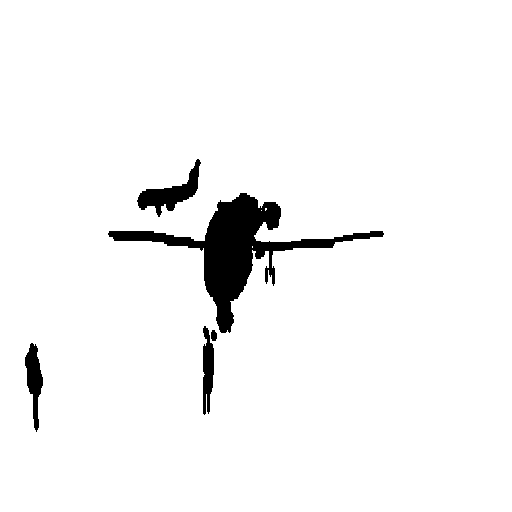

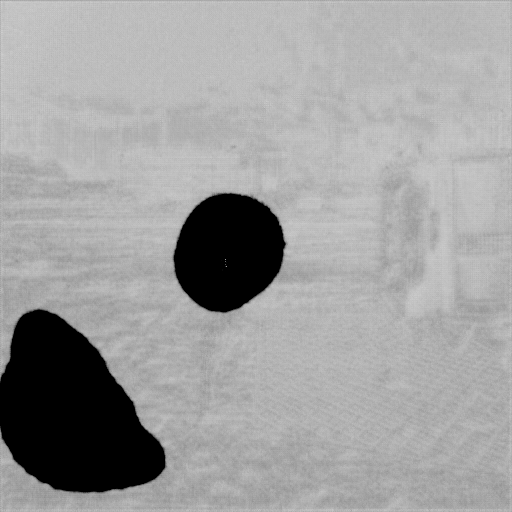

1 1
2 2
3 3
4 4
5 5
6 6
7 7
8 8
9 9
10 10
11 11
12 12
13 13
14 14
15 15
16 16
17 17
18 18
19 19
20 20
21 21
22 22
23 23
24 24
25 25
26 26
27 27
28 28
29 29
30 30
31 31
32 32
33 33
34 34
35 35
36 36
37 37
38 38
39 39
40 40
41 41
42 42
43 43
44 44
45 45
46 46
47 47
48 48
49 49
50 50
51 51
52 52
53 53
54 54
55 55
56 56
57 57
58 58
59 59
60 60
61 61
62 62
63 63
64 64
65 65
66 66
67 67
68 68
69 69
70 70
71 71
72 72
73 73
74 74
75 75
76 76
77 77
78 78
79 79
80 80
81 81
82 82
83 83
84 84
85 85
86 86
87 87
88 88
89 89
90 90
91 91
92 92
93 93
94 94
95 95
96 96
97 97
98 98
99 99
100 100
2007_006615


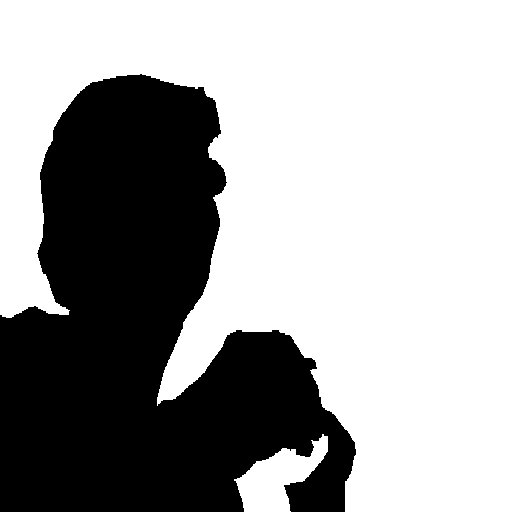

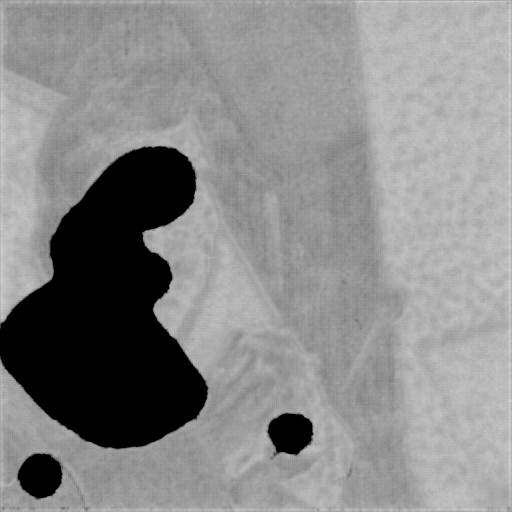

101 101
102 102
103 103
104 104
105 105
106 106
107 107
108 108
109 109
110 110
111 111
112 112
113 113
114 114
115 115
116 116
117 117
118 118
119 119
120 120
121 121
122 122
123 123
124 124
125 125
126 126
127 127
128 128
129 129
130 130
131 131
132 132
133 133
134 134
135 135
136 136
137 137
138 138
139 139
140 140
141 141
142 142
143 143
144 144
145 145
146 146
147 147
148 148
149 149
150 150
151 151
152 152
153 153
154 154
155 155
156 156
157 157
158 158
159 159
160 160
161 161
162 162
163 163
164 164
165 165
166 166
167 167
168 168
169 169
170 170
171 171
172 172
173 173
174 174
175 175
176 176
177 177
178 178
179 179
180 180
181 181
182 182
183 183
184 184
185 185
186 186
187 187
188 188
189 189
190 190
191 191
192 192
193 193
194 194
195 195
196 196
197 197
198 198
199 199
200 200
2008_001462


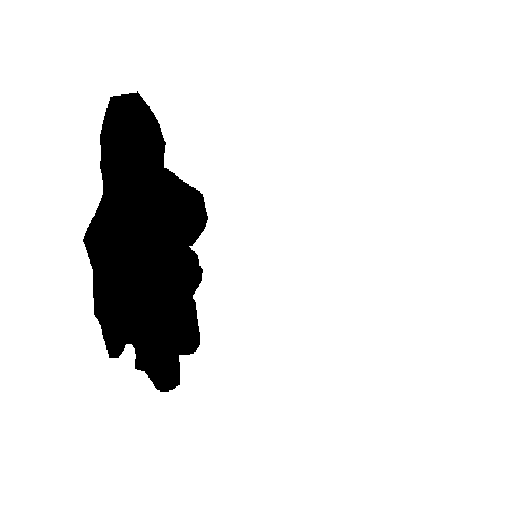

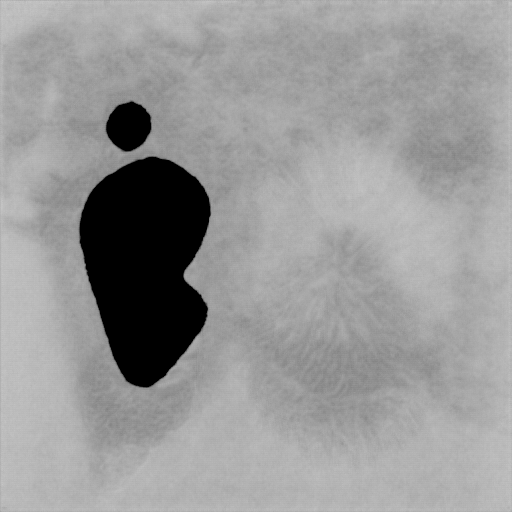

201 201
202 202
203 203
204 204
205 205
206 206
207 207
208 208
209 209
210 210
211 211
212 212
213 213
214 214
215 215
216 216
217 217
218 218
219 219
220 220
221 221
222 222
223 223
224 224
225 225
226 226
227 227
228 228
229 229
230 230
231 231
232 232
233 233
234 234
235 235
236 236
237 237
238 238
239 239
240 240
241 241
242 242
243 243
244 244
245 245
246 246
247 247
248 248
249 249
250 250
251 251
252 252
253 253
254 254
255 255
256 256
257 257
258 258
259 259
260 260
261 261
262 262
263 263
264 264
265 265
266 266
267 267
268 268
269 269
270 270
271 271
272 272
273 273
274 274
275 275
276 276
277 277
278 278
279 279
280 280
281 281
282 282
283 283
284 284
285 285
286 286
287 287
288 288
289 289
290 290
291 291
292 292
293 293
294 294
295 295
296 296
297 297
298 298
299 299
300 300
2008_007011


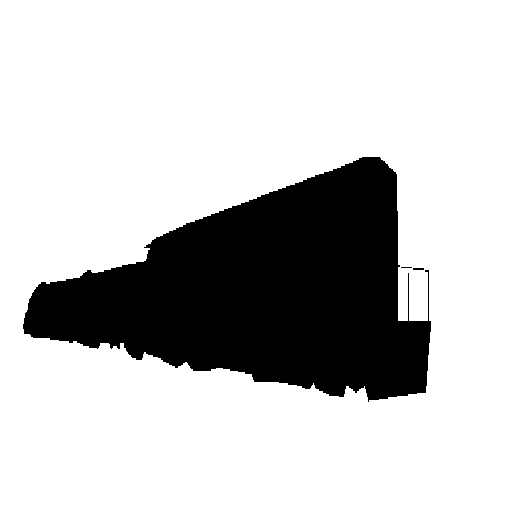

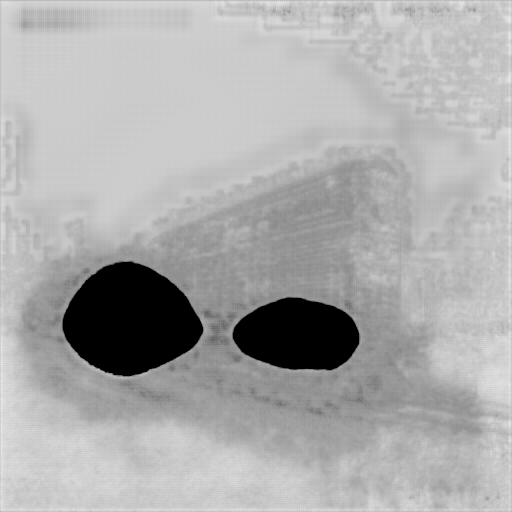

301 301
302 302
303 303
304 304
305 305
306 306
307 307
308 308
309 309
310 310
311 311
312 312
313 313
314 314
315 315
316 316
317 317
318 318
319 319
320 320
321 321
322 322
323 323
324 324
325 325
326 326
327 327
328 328
329 329
330 330
331 331
332 332
333 333
334 334
335 335
336 336
337 337
338 338
339 339
340 340
341 341
342 342
343 343
344 344
345 345
346 346
347 347
348 348
349 349
350 350
351 351
352 352
353 353
354 354
355 355
356 356
357 357
358 358
359 359
360 360
361 361
362 362
363 363
364 364
365 365
366 366
367 367
368 368
369 369
370 370
371 371
372 372
373 373
374 374
375 375
376 376
377 377
378 378
379 379
380 380
381 381
382 382
383 383
384 384
385 385
386 386
387 387
388 388
389 389
390 390
391 391
392 392
393 393
394 394
395 395
396 396
397 397
398 398
399 399
400 400
2009_002763


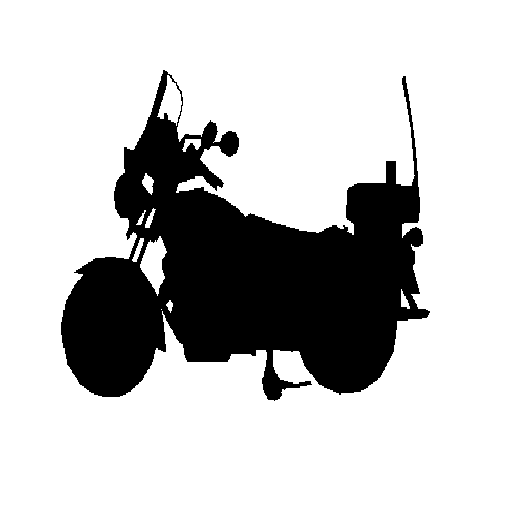

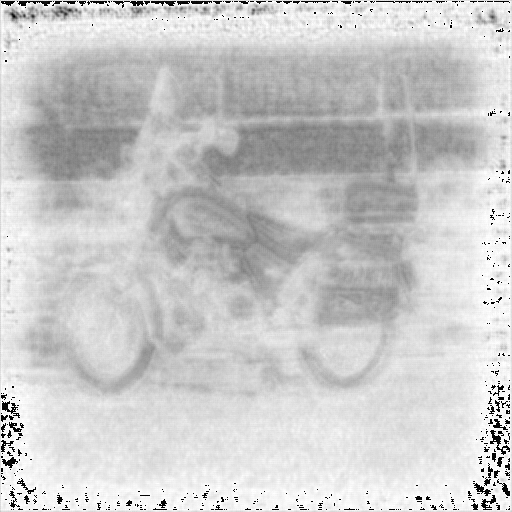

401 401
402 402
403 403
404 404
405 405
406 406
407 407
408 408
409 409
410 410
411 411
412 412
413 413
414 414
415 415
416 416
417 417
418 418
419 419
420 420
421 421
422 422
423 423
424 424
425 425
426 426
427 427
428 428
429 429
430 430
431 431
432 432
433 433
434 434
435 435
436 436
437 437
438 438
439 439
440 440
441 441
442 442
443 443
444 444
445 445
446 446
447 447
448 448
449 449
450 450
451 451
452 452
453 453
454 454
455 455
456 456
457 457
458 458
459 459
460 460
461 461
462 462
463 463
464 464
465 465
466 466
467 467
468 468
469 469
470 470
471 471
472 472
473 473
474 474
475 475
476 476
477 477
478 478
479 479
480 480
481 481
482 482
483 483
484 484
485 485
486 486
487 487
488 488
489 489
490 490
491 491
492 492
493 493
494 494
495 495
496 496
497 497
498 498
499 499
500 500
2010_001160


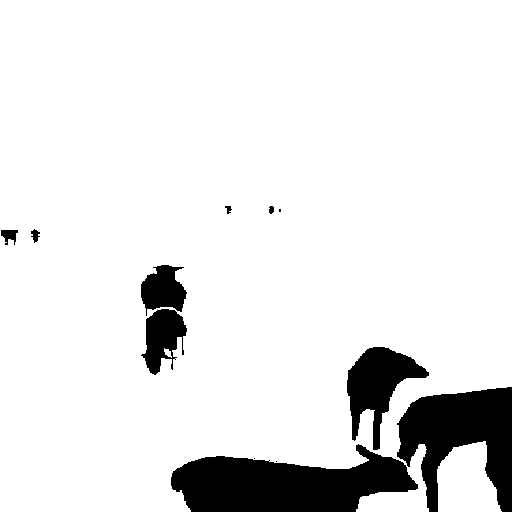

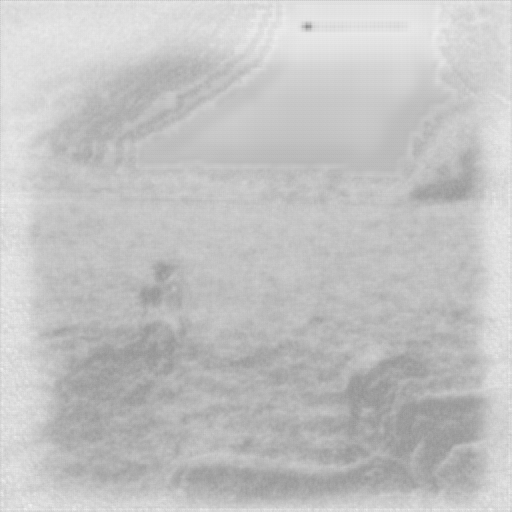

501 501
502 502
503 503
504 504
505 505
506 506
507 507
508 508
509 509
510 510
511 511
512 512
513 513
514 514
515 515
516 516
517 517
518 518
519 519
520 520
521 521
522 522
523 523
524 524
525 525
526 526
527 527
528 528
529 529
530 530
531 531
532 532
533 533
534 534
535 535
536 536
537 537
538 538
539 539
540 540
541 541
542 542
543 543
544 544
545 545
546 546
547 547
548 548
549 549
550 550
551 551
552 552
553 553
554 554
555 555
556 556
557 557
558 558
559 559
560 560
561 561
562 562
563 563
564 564
565 565
566 566
567 567
568 568
569 569
570 570
571 571
572 572
573 573
574 574
575 575
576 576
577 577
578 578
579 579
580 580
581 581
582 582
583 583
584 584
585 585
586 586
587 587
588 588
589 589
590 590
591 591
592 592
593 593
594 594
595 595
596 596
597 597
598 598
599 599
600 600
2010_004948


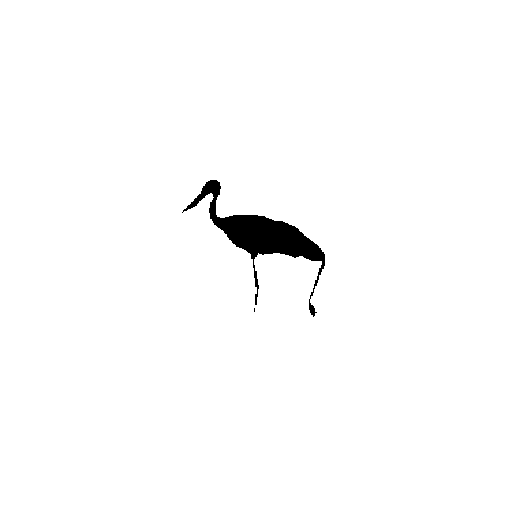

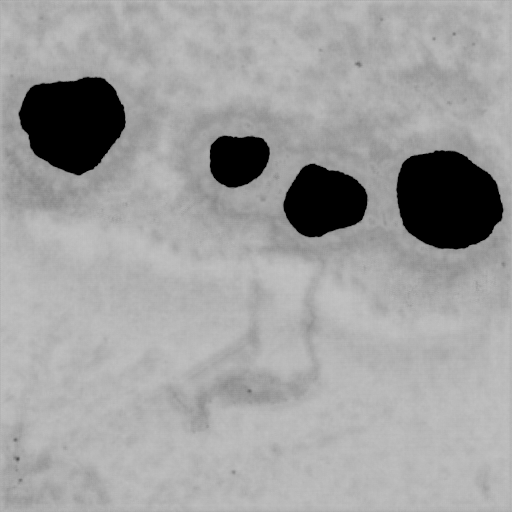

601 601
602 602
603 603
604 604
605 605
606 606
607 607
608 608
609 609
610 610
611 611
612 612
613 613
614 614
615 615
616 616
617 617
618 618
619 619
620 620
621 621
622 622
623 623
624 624
625 625
626 626
627 627
628 628
629 629
630 630
631 631
632 632
633 633
634 634
635 635
636 636
637 637
638 638
639 639
640 640
641 641
642 642
643 643
644 644
645 645
646 646
647 647
648 648
649 649
650 650
651 651
652 652
653 653
654 654
655 655
656 656
657 657
658 658
659 659
660 660
661 661
662 662
663 663
664 664
665 665
666 666
667 667
668 668
669 669
670 670
671 671
672 672
673 673
674 674
675 675
676 676
677 677
678 678
679 679
680 680
681 681
682 682
683 683
684 684
685 685
686 686
687 687
688 688
689 689
690 690
691 691
692 692
693 693
694 694
695 695
696 696
697 697
698 698
699 699
700 700
2011_002114


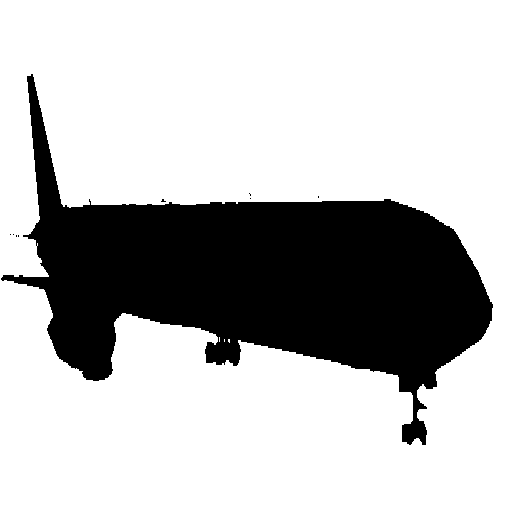

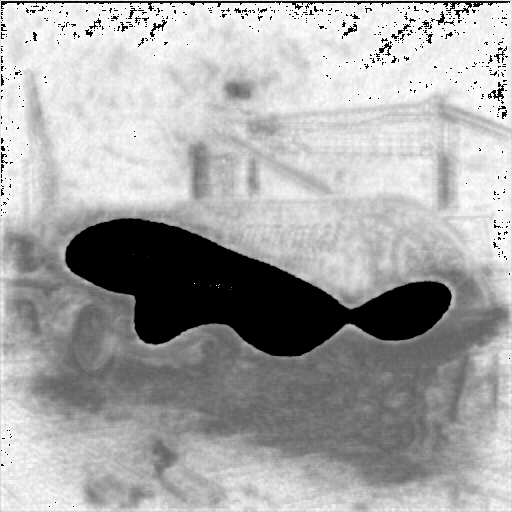

701 701
702 702
703 703
704 704
705 705
706 706
707 707
708 708
709 709
710 710
711 711
712 712
713 713
714 714
715 715
716 716
717 717
718 718
719 719
720 720
721 721
722 722
723 723
724 724
725 725
726 726
727 727
728 728
729 729
730 730
731 731
0 732
1 733
2 734
3 735
4 736
5 737
6 738
7 739
8 740
9 741
10 742
11 743
12 744
13 745
14 746
15 747
16 748
17 749
18 750
19 751
20 752
21 753
22 754
23 755
24 756
25 757
26 758
27 759
28 760
29 761
30 762
31 763
32 764
33 765
34 766
35 767
36 768
37 769
38 770
39 771
40 772
41 773
42 774
43 775
44 776
45 777
46 778
47 779
48 780
49 781
50 782
51 783
52 784
53 785
54 786
55 787
56 788
57 789
58 790
59 791
60 792
61 793
62 794
63 795
64 796
65 797
66 798
67 799
68 800
2007_004537


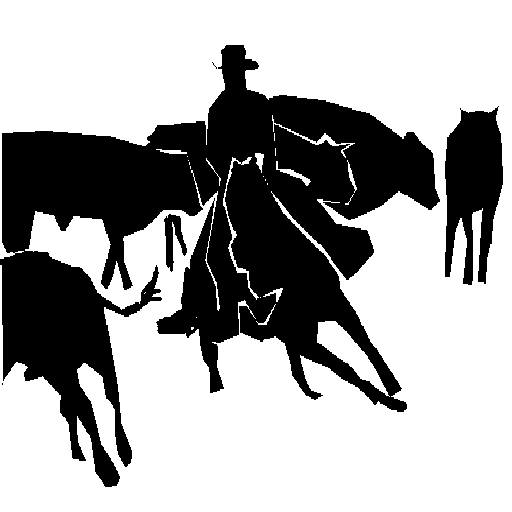

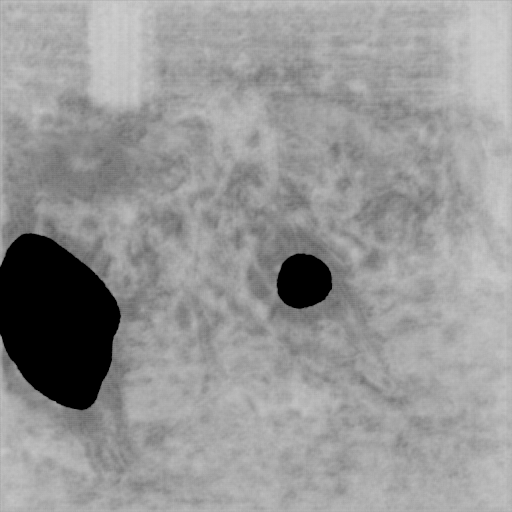

69 801
70 802
71 803
72 804
73 805
74 806
75 807
76 808
77 809
78 810
79 811
80 812
81 813
82 814
83 815
84 816
85 817
86 818
87 819
88 820
89 821
90 822
91 823
92 824
93 825
94 826
95 827
96 828
97 829
98 830
99 831
100 832
101 833
102 834
103 835
104 836
105 837
106 838
107 839
108 840
109 841
110 842
111 843
112 844
113 845
114 846
115 847
116 848
117 849
118 850
119 851
120 852
121 853
122 854
123 855
124 856
125 857
126 858
127 859
128 860
129 861
130 862
131 863
132 864
133 865
134 866
135 867
136 868
137 869
138 870
139 871
140 872
141 873
142 874
143 875
144 876
145 877
146 878
147 879
148 880
149 881
150 882
151 883
152 884
153 885
154 886
155 887
156 888
157 889
158 890
159 891
160 892
161 893
162 894
163 895
164 896
165 897
166 898
167 899
168 900
2008_000309


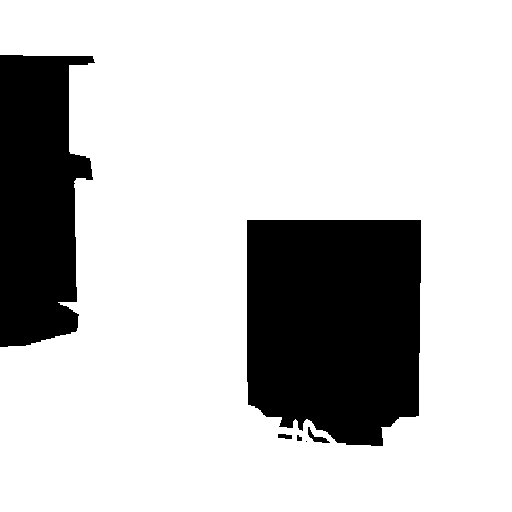

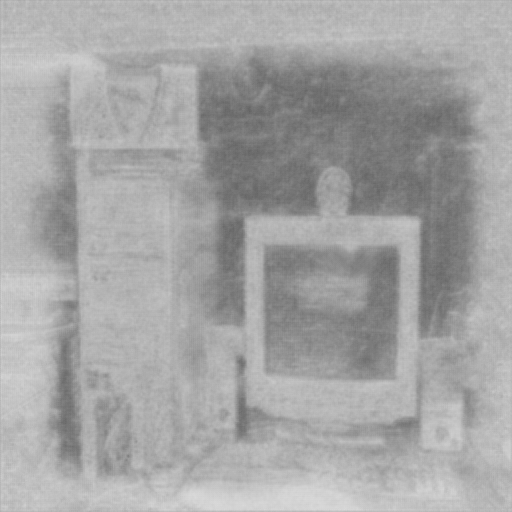

169 901
170 902
171 903
172 904
173 905
174 906
175 907
176 908
177 909
178 910
179 911
180 912
181 913
182 914
183 915
184 916
185 917
186 918
187 919
188 920
189 921
190 922
191 923
192 924
193 925
194 926
195 927
196 928
197 929
198 930
199 931
200 932
201 933
202 934
203 935
204 936
205 937
206 938
207 939
208 940
209 941
210 942
211 943
212 944
213 945
214 946
215 947
216 948
217 949
218 950
219 951
220 952
221 953
222 954
223 955
224 956
225 957
226 958
227 959
228 960
229 961
230 962
231 963
232 964
233 965
234 966
235 967
236 968
237 969
238 970
239 971
240 972
241 973
242 974
243 975
244 976
245 977
246 978
247 979
248 980
249 981
250 982
251 983
252 984
253 985
254 986
255 987
256 988
257 989
258 990
259 991
260 992
261 993
262 994
263 995
264 996
265 997
266 998
267 999
268 1000
2008_004983


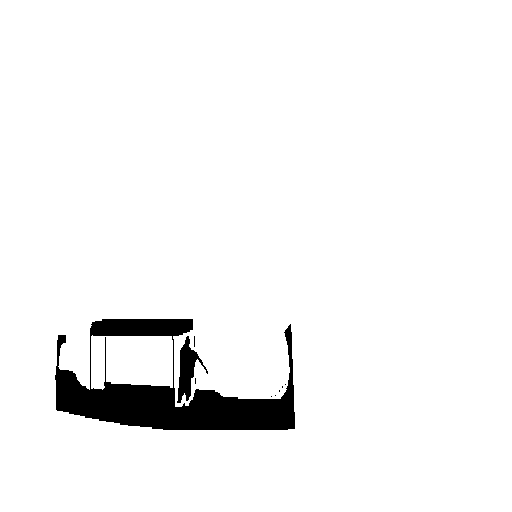

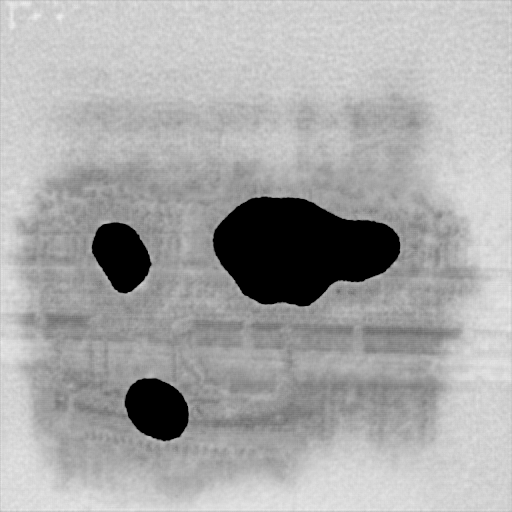

269 1001
270 1002
271 1003
272 1004
273 1005
274 1006
275 1007
276 1008
277 1009
278 1010
279 1011
280 1012
281 1013
282 1014
283 1015
284 1016
285 1017
286 1018
287 1019
288 1020
289 1021
290 1022
291 1023
292 1024
293 1025
294 1026
295 1027
296 1028
297 1029
298 1030
299 1031
300 1032
301 1033
302 1034
303 1035
304 1036
305 1037
306 1038
307 1039
308 1040
309 1041
310 1042
311 1043
312 1044
313 1045
314 1046
315 1047
316 1048
317 1049
318 1050
319 1051
320 1052
321 1053
322 1054
323 1055
324 1056
325 1057
326 1058
327 1059
328 1060
329 1061
330 1062
331 1063
332 1064
333 1065
334 1066
335 1067
336 1068
337 1069
338 1070
339 1071
340 1072
341 1073
342 1074
343 1075
344 1076
345 1077
346 1078
347 1079
348 1080
349 1081
350 1082
351 1083
352 1084
353 1085
354 1086
355 1087
356 1088
357 1089
358 1090
359 1091
360 1092
361 1093
362 1094
363 1095
364 1096
365 1097
366 1098
367 1099
368 1100
2009_001693


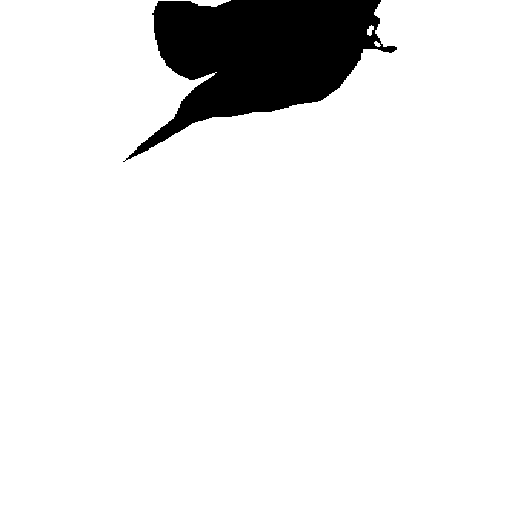

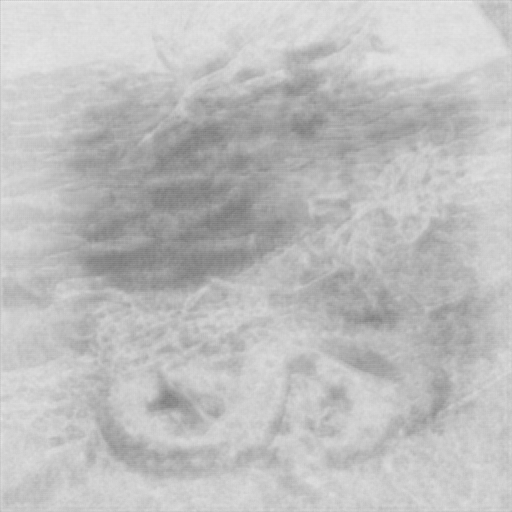

369 1101
370 1102
371 1103
372 1104
373 1105
374 1106
375 1107
376 1108
377 1109
378 1110
379 1111
380 1112
381 1113
382 1114
383 1115
384 1116
385 1117
386 1118
387 1119
388 1120
389 1121
390 1122
391 1123
392 1124
393 1125
394 1126
395 1127
396 1128
397 1129
398 1130
399 1131
400 1132
401 1133
402 1134
403 1135
404 1136
405 1137
406 1138
407 1139
408 1140
409 1141
410 1142
411 1143
412 1144
413 1145
414 1146
415 1147
416 1148
417 1149
418 1150
419 1151
420 1152
421 1153
422 1154
423 1155
424 1156
425 1157
426 1158
427 1159
428 1160
429 1161
430 1162
431 1163
432 1164
433 1165
434 1166
435 1167
436 1168
437 1169
438 1170
439 1171
440 1172
441 1173
442 1174
443 1175
444 1176
445 1177
446 1178
447 1179
448 1180
449 1181
450 1182
451 1183
452 1184
453 1185
454 1186
455 1187
456 1188
457 1189
458 1190
459 1191
460 1192
461 1193
462 1194
463 1195
464 1196
465 1197
466 1198
467 1199
468 1200
2009_005085


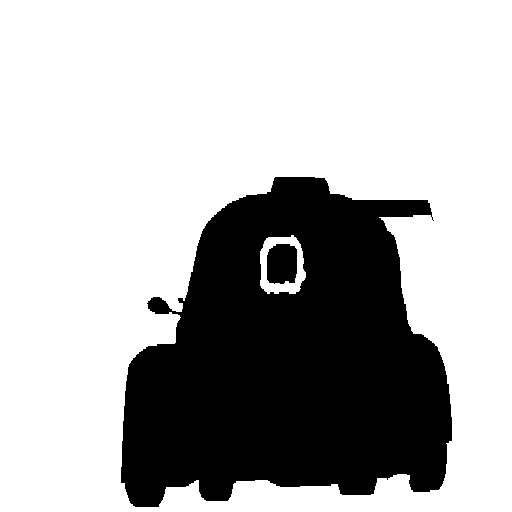

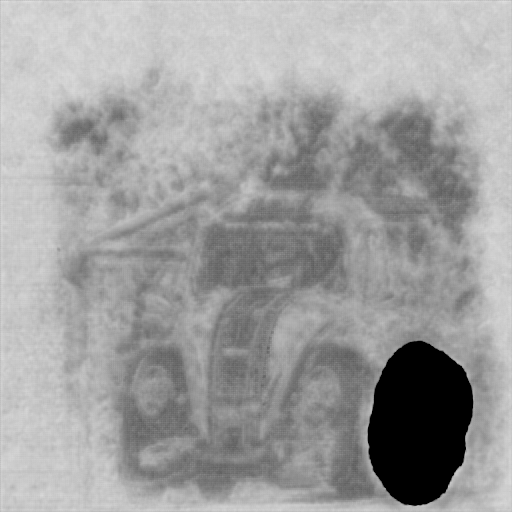

469 1201
470 1202
471 1203
472 1204
473 1205
474 1206
475 1207
476 1208
477 1209
478 1210
479 1211
480 1212
481 1213
482 1214
483 1215
484 1216
485 1217
486 1218
487 1219
488 1220
489 1221
490 1222
491 1223
492 1224
493 1225
494 1226
495 1227
496 1228
497 1229
498 1230
499 1231
500 1232
501 1233
502 1234
503 1235
504 1236
505 1237
506 1238
507 1239
508 1240
509 1241
510 1242
511 1243
512 1244
513 1245
514 1246
515 1247
516 1248
517 1249
518 1250
519 1251
520 1252
521 1253
522 1254
523 1255
524 1256
525 1257
526 1258
527 1259
528 1260
529 1261
530 1262
531 1263
532 1264
533 1265
534 1266
535 1267
536 1268
537 1269
538 1270
539 1271
540 1272
541 1273
542 1274
543 1275
544 1276
545 1277
546 1278
547 1279
548 1280
549 1281
550 1282
551 1283
552 1284
553 1285
554 1286
555 1287
556 1288
557 1289
558 1290
559 1291
560 1292
561 1293
562 1294
563 1295
564 1296
565 1297
566 1298
567 1299
568 1300
2010_003798


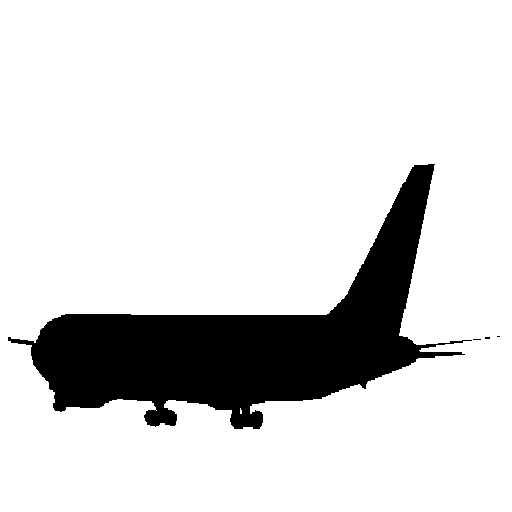

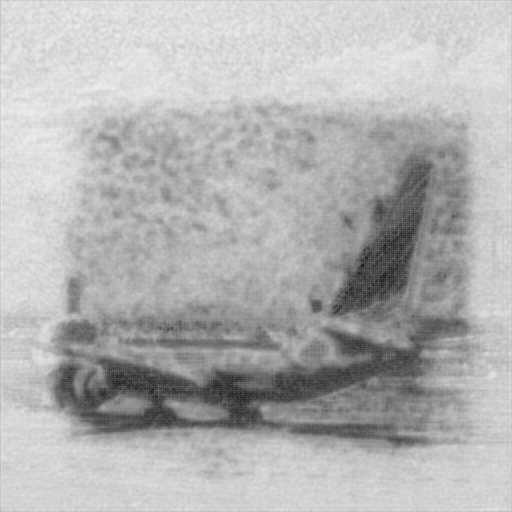

569 1301
570 1302
571 1303
572 1304
573 1305
574 1306
575 1307
576 1308
577 1309
578 1310
579 1311
580 1312
581 1313
582 1314
583 1315
584 1316
585 1317
586 1318
587 1319
588 1320
589 1321
590 1322
591 1323
592 1324
593 1325
594 1326
595 1327
596 1328
597 1329
598 1330
599 1331
600 1332
601 1333
602 1334
603 1335
604 1336
605 1337
606 1338
607 1339
608 1340
609 1341
610 1342
611 1343
612 1344
613 1345
614 1346
615 1347
616 1348
617 1349
618 1350
619 1351
620 1352
621 1353
622 1354
623 1355
624 1356
625 1357
626 1358
627 1359
628 1360
629 1361
630 1362
631 1363
632 1364
633 1365
634 1366
635 1367
636 1368
637 1369
638 1370
639 1371
640 1372
641 1373
642 1374
643 1375
644 1376
645 1377
646 1378
647 1379
648 1380
649 1381
650 1382
651 1383
652 1384
653 1385
654 1386
655 1387
656 1388
657 1389
658 1390
659 1391
660 1392
661 1393
662 1394
663 1395
664 1396
665 1397
666 1398
667 1399
668 1400
2011_000920


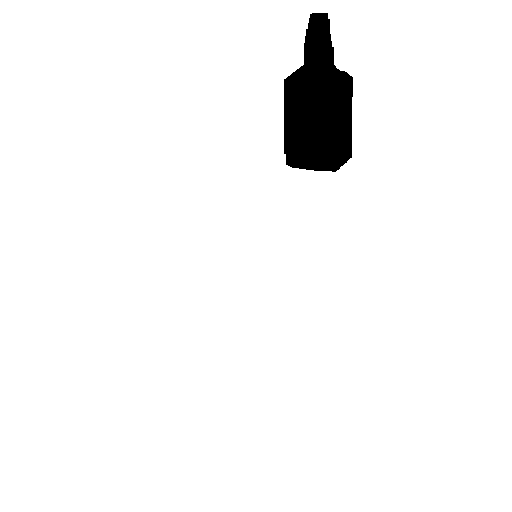

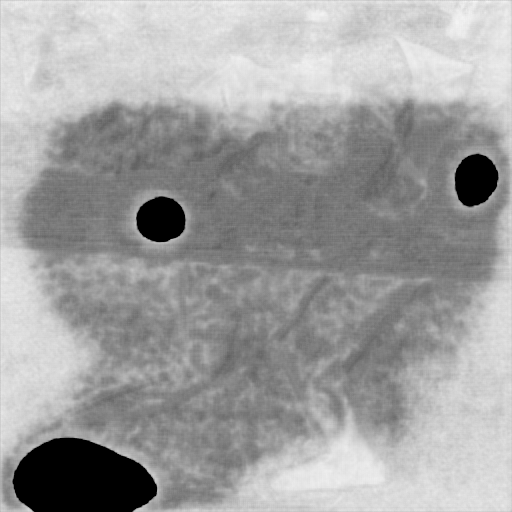

669 1401
670 1402
671 1403
672 1404
673 1405
674 1406
675 1407
676 1408
677 1409
678 1410
679 1411
680 1412
681 1413
682 1414
683 1415
684 1416
685 1417
686 1418
687 1419
688 1420
689 1421
690 1422
691 1423
692 1424
693 1425
694 1426
695 1427
696 1428
697 1429
698 1430
699 1431
700 1432
701 1433
702 1434
703 1435
704 1436
705 1437
706 1438
707 1439
708 1440
709 1441
710 1442
711 1443
712 1444
713 1445
714 1446
715 1447
716 1448
717 1449
718 1450
719 1451
720 1452
721 1453
722 1454
723 1455
724 1456
725 1457
726 1458
727 1459
728 1460
729 1461
730 1462
731 1463
0 1464
1 1465
2 1466
3 1467
4 1468
5 1469
6 1470
7 1471
8 1472
9 1473
10 1474
11 1475
12 1476
13 1477
14 1478
15 1479
16 1480
17 1481
18 1482
19 1483
20 1484
21 1485
22 1486
23 1487
24 1488
25 1489
26 1490
27 1491
28 1492
29 1493
30 1494
31 1495
32 1496
33 1497
34 1498
35 1499
36 1500
2007_002281


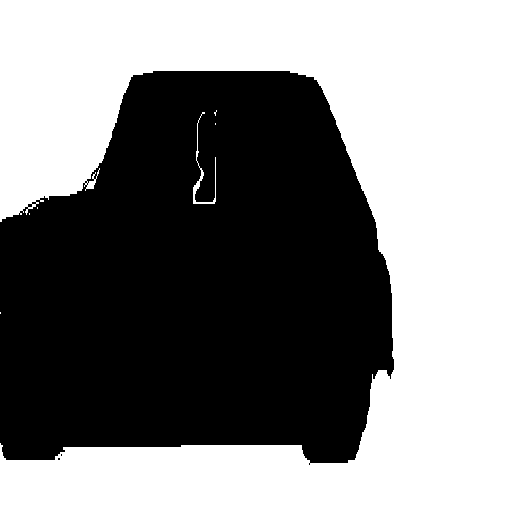

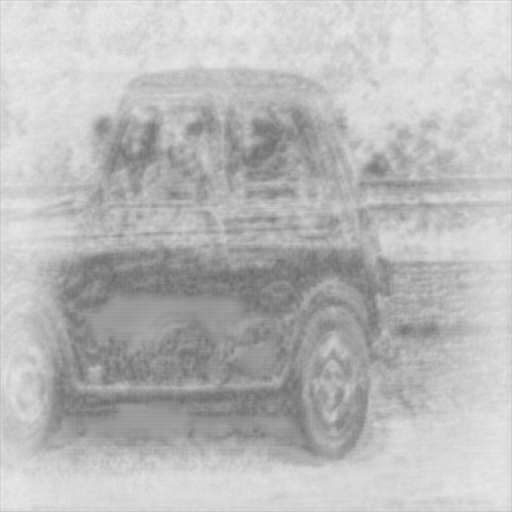

37 1501
38 1502
39 1503
40 1504
41 1505
42 1506
43 1507
44 1508
45 1509
46 1510
47 1511
48 1512
49 1513
50 1514
51 1515
52 1516
53 1517
54 1518
55 1519
56 1520
57 1521
58 1522
59 1523
60 1524
61 1525
62 1526
63 1527
64 1528
65 1529
66 1530
67 1531
68 1532
69 1533
70 1534
71 1535
72 1536
73 1537
74 1538
75 1539
76 1540
77 1541
78 1542
79 1543
80 1544
81 1545
82 1546
83 1547
84 1548
85 1549
86 1550
87 1551
88 1552
89 1553
90 1554
91 1555
92 1556
93 1557
94 1558
95 1559
96 1560
97 1561
98 1562
99 1563
100 1564
101 1565
102 1566
103 1567
104 1568
105 1569
106 1570
107 1571
108 1572
109 1573
110 1574
111 1575
112 1576
113 1577
114 1578
115 1579
116 1580
117 1581
118 1582
119 1583
120 1584
121 1585
122 1586
123 1587
124 1588
125 1589
126 1590
127 1591
128 1592
129 1593
130 1594
131 1595
132 1596
133 1597
134 1598
135 1599
136 1600
2007_009030


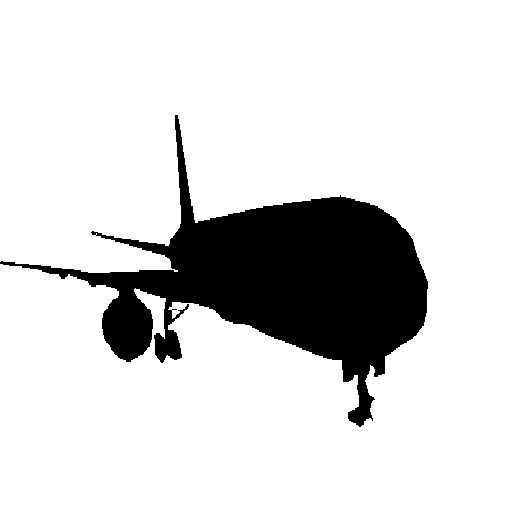

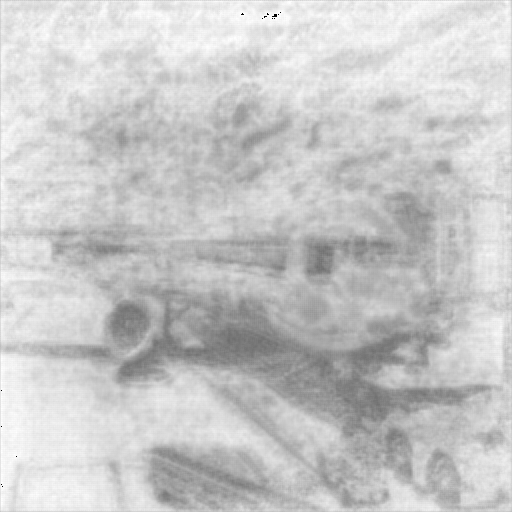

137 1601
138 1602
139 1603
140 1604
141 1605
142 1606
143 1607
144 1608
145 1609
146 1610
147 1611
148 1612
149 1613
150 1614
151 1615
152 1616
153 1617
154 1618
155 1619
156 1620
157 1621
158 1622
159 1623
160 1624
161 1625
162 1626
163 1627
164 1628
165 1629
166 1630
167 1631
168 1632
169 1633
170 1634
171 1635
172 1636
173 1637
174 1638
175 1639
176 1640
177 1641
178 1642
179 1643
180 1644
181 1645
182 1646
183 1647
184 1648
185 1649
186 1650
187 1651
188 1652
189 1653
190 1654
191 1655
192 1656
193 1657
194 1658
195 1659
196 1660
197 1661
198 1662
199 1663
200 1664
201 1665
202 1666
203 1667
204 1668
205 1669
206 1670
207 1671
208 1672
209 1673
210 1674
211 1675
212 1676
213 1677
214 1678
215 1679
216 1680
217 1681
218 1682
219 1683
220 1684
221 1685
222 1686
223 1687
224 1688
225 1689
226 1690
227 1691
228 1692
229 1693
230 1694
231 1695
232 1696
233 1697
234 1698
235 1699
236 1700
2008_003083


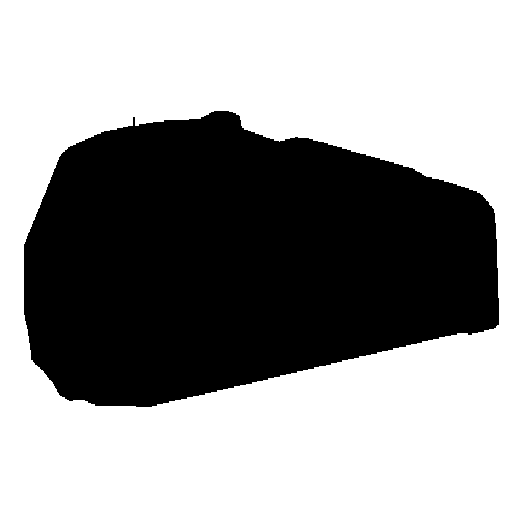

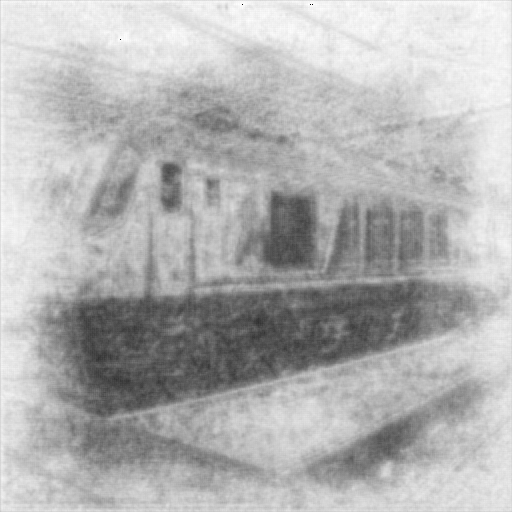

237 1701
238 1702
239 1703
240 1704
241 1705
242 1706
243 1707
244 1708
245 1709
246 1710
247 1711
248 1712
249 1713
250 1714
251 1715
252 1716
253 1717
254 1718
255 1719
256 1720
257 1721
258 1722
259 1723
260 1724
261 1725
262 1726
263 1727
264 1728
265 1729
266 1730
267 1731
268 1732
269 1733
270 1734
271 1735
272 1736
273 1737
274 1738
275 1739
276 1740
277 1741
278 1742
279 1743
280 1744
281 1745
282 1746
283 1747
284 1748
285 1749
286 1750
287 1751
288 1752
289 1753
290 1754
291 1755
292 1756
293 1757
294 1758
295 1759
296 1760
297 1761
298 1762
299 1763
300 1764
301 1765
302 1766
303 1767
304 1768
305 1769
306 1770
307 1771
308 1772
309 1773
310 1774
311 1775
312 1776
313 1777
314 1778
315 1779
316 1780
317 1781
318 1782
319 1783
320 1784
321 1785
322 1786
323 1787
324 1788
325 1789
326 1790
327 1791
328 1792
329 1793
330 1794
331 1795
332 1796
333 1797
334 1798
335 1799
336 1800
2009_000690


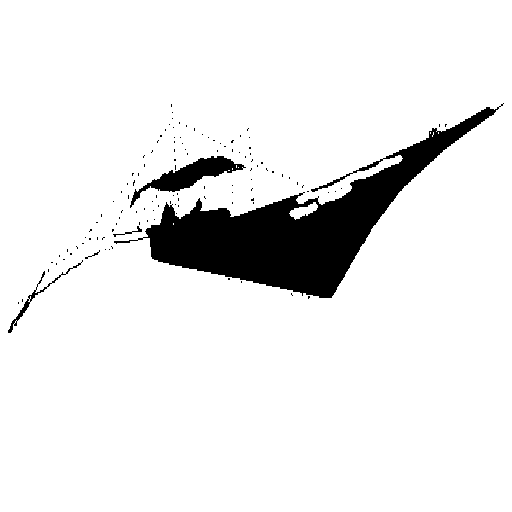

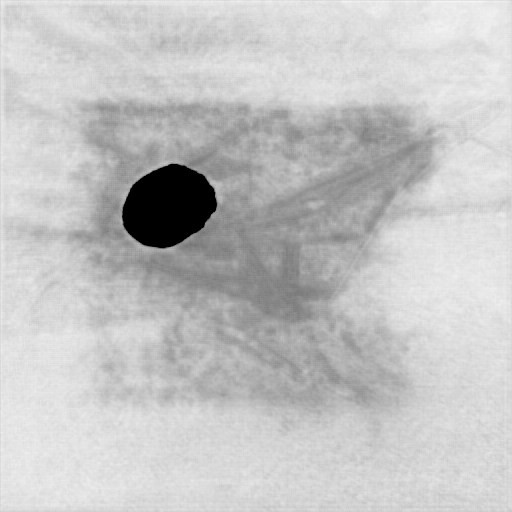

337 1801
338 1802
339 1803
340 1804
341 1805
342 1806
343 1807
344 1808
345 1809
346 1810
347 1811
348 1812
349 1813
350 1814
351 1815
352 1816
353 1817
354 1818
355 1819
356 1820
357 1821
358 1822
359 1823
360 1824
361 1825
362 1826
363 1827
364 1828
365 1829
366 1830
367 1831
368 1832
369 1833
370 1834
371 1835
372 1836
373 1837
374 1838
375 1839
376 1840
377 1841
378 1842
379 1843
380 1844
381 1845
382 1846
383 1847
384 1848
385 1849
386 1850
387 1851
388 1852
389 1853
390 1854
391 1855
392 1856
393 1857
394 1858
395 1859
396 1860
397 1861
398 1862
399 1863
400 1864
401 1865
402 1866
403 1867
404 1868
405 1869
406 1870
407 1871
408 1872
409 1873
410 1874
411 1875
412 1876
413 1877
414 1878
415 1879
416 1880
417 1881
418 1882
419 1883
420 1884
421 1885
422 1886
423 1887
424 1888
425 1889
426 1890
427 1891
428 1892
429 1893
430 1894
431 1895
432 1896
433 1897
434 1898
435 1899
436 1900
2009_003961


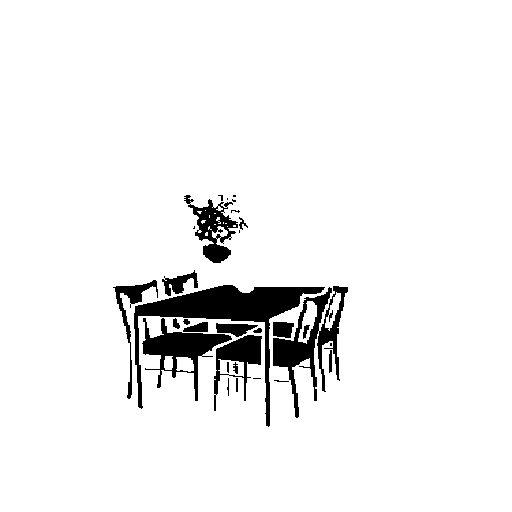

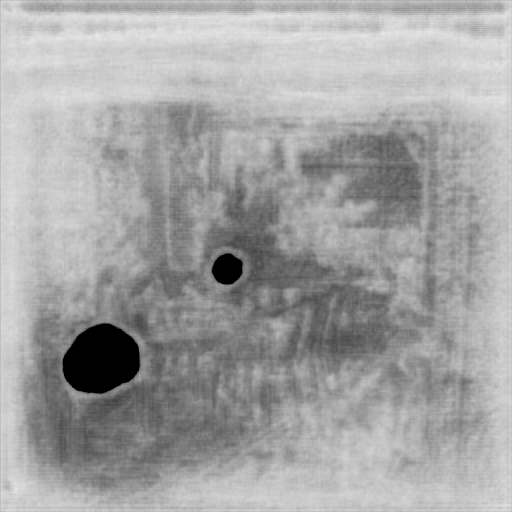

437 1901
438 1902
439 1903
440 1904
441 1905
442 1906
443 1907
444 1908
445 1909
446 1910
447 1911
448 1912
449 1913
450 1914
451 1915
452 1916
453 1917
454 1918
455 1919
456 1920
457 1921
458 1922
459 1923
460 1924
461 1925
462 1926
463 1927
464 1928
465 1929
466 1930
467 1931
468 1932
469 1933
470 1934
471 1935
472 1936
473 1937
474 1938
475 1939
476 1940
477 1941
478 1942
479 1943
480 1944
481 1945
482 1946
483 1947
484 1948
485 1949
486 1950
487 1951
488 1952
489 1953
490 1954
491 1955
492 1956
493 1957
494 1958
495 1959
496 1960
497 1961
498 1962
499 1963
500 1964
501 1965
502 1966
503 1967
504 1968
505 1969
506 1970
507 1971
508 1972
509 1973
510 1974
511 1975
512 1976
513 1977
514 1978
515 1979
516 1980
517 1981
518 1982
519 1983
520 1984
521 1985
522 1986
523 1987
524 1988
525 1989
526 1990
527 1991
528 1992
529 1993
530 1994
531 1995
532 1996
533 1997
534 1998
535 1999
536 2000
2010_002455


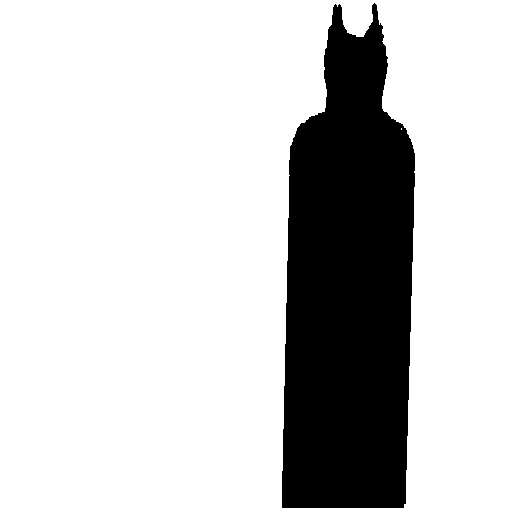

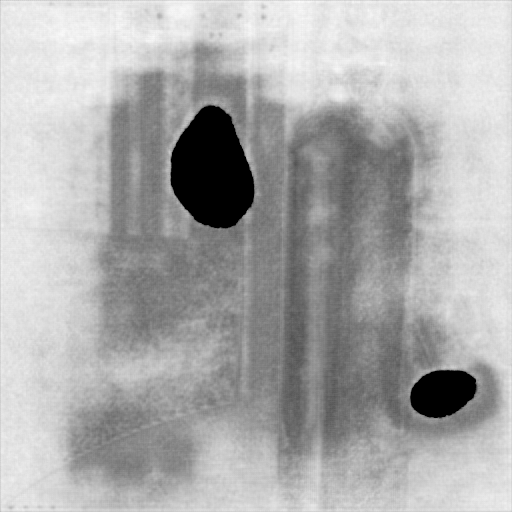

537 2001
538 2002
539 2003
540 2004
541 2005
542 2006
543 2007
544 2008
545 2009
546 2010
547 2011
548 2012
549 2013
550 2014
551 2015
552 2016
553 2017
554 2018
555 2019
556 2020
557 2021
558 2022
559 2023
560 2024
561 2025
562 2026
563 2027
564 2028
565 2029
566 2030
567 2031
568 2032
569 2033
570 2034
571 2035
572 2036
573 2037
574 2038
575 2039
576 2040
577 2041
578 2042
579 2043
580 2044
581 2045
582 2046
583 2047
584 2048
585 2049
586 2050
587 2051
588 2052
589 2053
590 2054
591 2055
592 2056
593 2057
594 2058
595 2059
596 2060
597 2061
598 2062
599 2063
600 2064
601 2065
602 2066
603 2067
604 2068
605 2069
606 2070
607 2071
608 2072
609 2073
610 2074
611 2075
612 2076
613 2077
614 2078
615 2079
616 2080
617 2081
618 2082
619 2083
620 2084
621 2085
622 2086
623 2087
624 2088
625 2089
626 2090
627 2091
628 2092
629 2093
630 2094
631 2095
632 2096
633 2097
634 2098
635 2099
636 2100
2011_000006


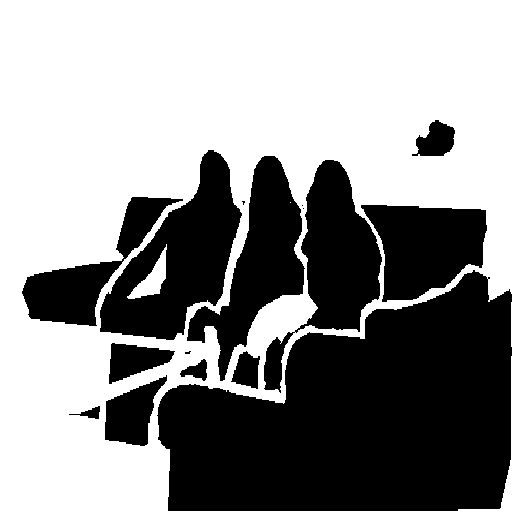

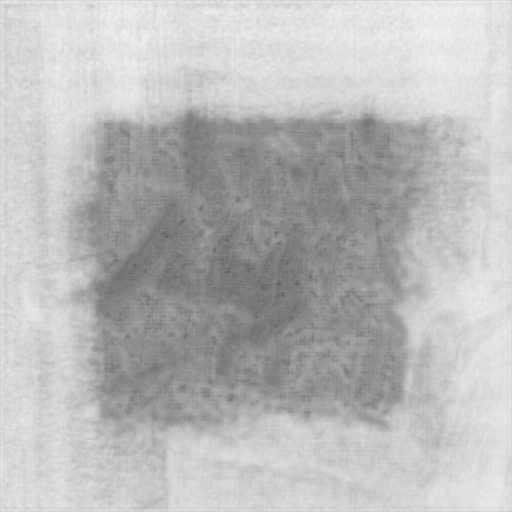

637 2101
638 2102
639 2103
640 2104
641 2105
642 2106
643 2107
644 2108
645 2109
646 2110
647 2111
648 2112
649 2113
650 2114
651 2115
652 2116
653 2117
654 2118
655 2119
656 2120
657 2121
658 2122
659 2123
660 2124
661 2125
662 2126
663 2127
664 2128
665 2129
666 2130
667 2131
668 2132
669 2133
670 2134
671 2135
672 2136
673 2137
674 2138
675 2139
676 2140
677 2141
678 2142
679 2143
680 2144
681 2145
682 2146
683 2147
684 2148
685 2149
686 2150
687 2151
688 2152
689 2153
690 2154
691 2155
692 2156
693 2157
694 2158
695 2159
696 2160
697 2161
698 2162
699 2163
700 2164
701 2165
702 2166
703 2167
704 2168
705 2169
706 2170
707 2171
708 2172
709 2173
710 2174
711 2175
712 2176
713 2177
714 2178
715 2179
716 2180
717 2181
718 2182
719 2183
720 2184
721 2185
722 2186
723 2187
724 2188
725 2189
726 2190
727 2191
728 2192
729 2193
730 2194
731 2195
0 2196
1 2197
2 2198
3 2199
4 2200
2007_000250


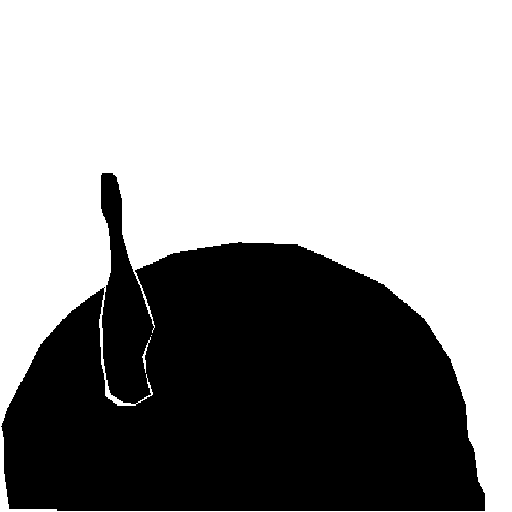

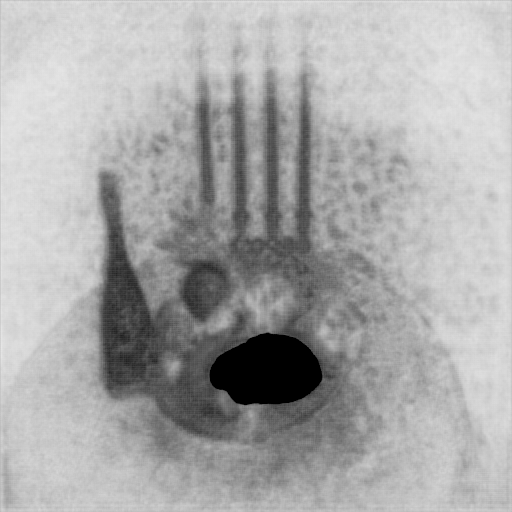

5 2201
6 2202
7 2203
8 2204
9 2205
10 2206
11 2207
12 2208
13 2209
14 2210
15 2211
16 2212
17 2213
18 2214
19 2215
20 2216
21 2217
22 2218
23 2219
24 2220
25 2221
26 2222
27 2223
28 2224
29 2225
30 2226
31 2227
32 2228
33 2229
34 2230
35 2231
36 2232
37 2233
38 2234
39 2235
40 2236
41 2237
42 2238
43 2239
44 2240
45 2241
46 2242
47 2243
48 2244
49 2245
50 2246
51 2247
52 2248
53 2249
54 2250
55 2251
56 2252
57 2253
58 2254
59 2255
60 2256
61 2257
62 2258
63 2259
64 2260
65 2261
66 2262
67 2263
68 2264
69 2265
70 2266
71 2267
72 2268
73 2269
74 2270
75 2271
76 2272
77 2273
78 2274
79 2275
80 2276
81 2277
82 2278
83 2279
84 2280
85 2281
86 2282
87 2283
88 2284
89 2285
90 2286
91 2287
92 2288
93 2289
94 2290
95 2291
96 2292
97 2293
98 2294
99 2295
100 2296
101 2297
102 2298
103 2299
104 2300
2007_006832


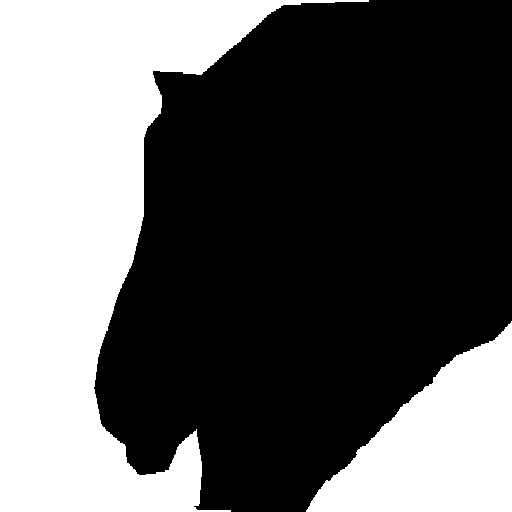

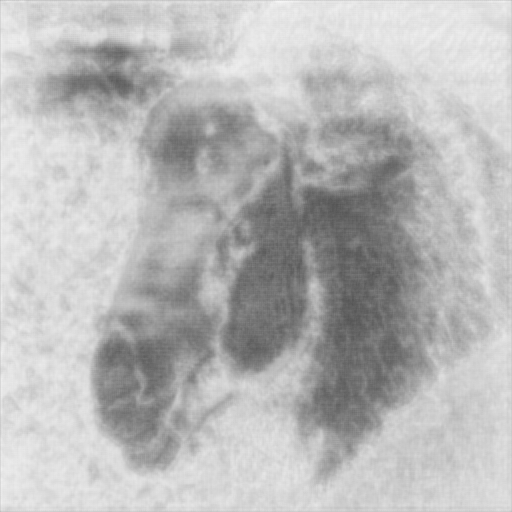

105 2301
106 2302
107 2303
108 2304
109 2305
110 2306
111 2307
112 2308
113 2309
114 2310
115 2311
116 2312
117 2313
118 2314
119 2315
120 2316
121 2317
122 2318
123 2319
124 2320
125 2321
126 2322
127 2323
128 2324
129 2325
130 2326
131 2327
132 2328
133 2329
134 2330
135 2331
136 2332
137 2333
138 2334
139 2335
140 2336
141 2337
142 2338
143 2339
144 2340
145 2341
146 2342
147 2343
148 2344
149 2345
150 2346
151 2347
152 2348
153 2349
154 2350
155 2351
156 2352
157 2353
158 2354
159 2355
160 2356
161 2357
162 2358
163 2359
164 2360
165 2361
166 2362
167 2363
168 2364
169 2365
170 2366
171 2367
172 2368
173 2369
174 2370
175 2371
176 2372
177 2373
178 2374
179 2375
180 2376
181 2377
182 2378
183 2379
184 2380
185 2381
186 2382
187 2383
188 2384
189 2385
190 2386
191 2387
192 2388
193 2389
194 2390
195 2391
196 2392
197 2393
198 2394
199 2395
200 2396
201 2397
202 2398
203 2399
204 2400
2008_001601


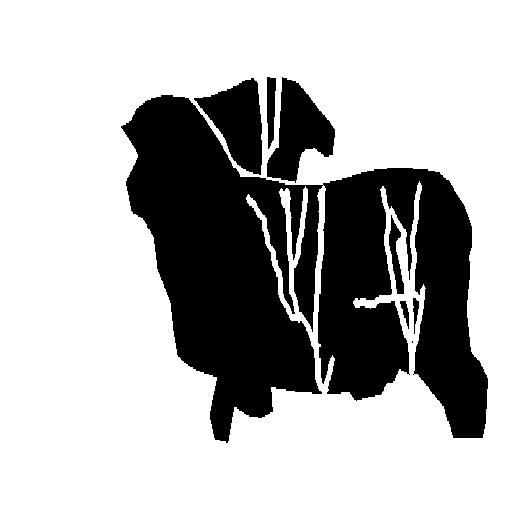

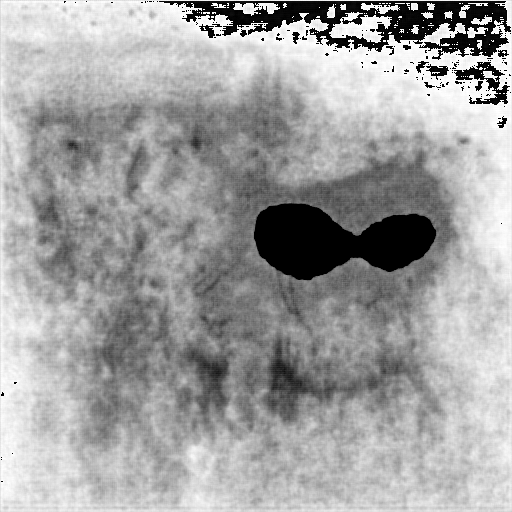

205 2401
206 2402
207 2403
208 2404
209 2405
210 2406
211 2407
212 2408
213 2409
214 2410
215 2411
216 2412
217 2413
218 2414
219 2415
220 2416
221 2417
222 2418
223 2419
224 2420
225 2421
226 2422
227 2423
228 2424
229 2425
230 2426
231 2427
232 2428
233 2429
234 2430
235 2431
236 2432
237 2433
238 2434
239 2435
240 2436
241 2437
242 2438
243 2439
244 2440
245 2441
246 2442
247 2443
248 2444
249 2445
250 2446
251 2447
252 2448
253 2449
254 2450
255 2451
256 2452
257 2453
258 2454
259 2455
260 2456
261 2457
262 2458
263 2459
264 2460
265 2461
266 2462
267 2463
268 2464
269 2465
270 2466
271 2467
272 2468
273 2469
274 2470
275 2471
276 2472
277 2473
278 2474
279 2475
280 2476
281 2477
282 2478
283 2479
284 2480
285 2481
286 2482
287 2483
288 2484
289 2485
290 2486
291 2487
292 2488
293 2489
294 2490
295 2491
296 2492
297 2493
298 2494
299 2495
300 2496
301 2497
302 2498
303 2499
304 2500
2008_007245


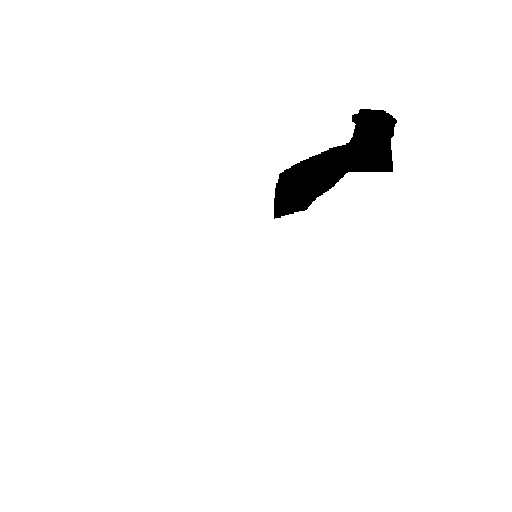

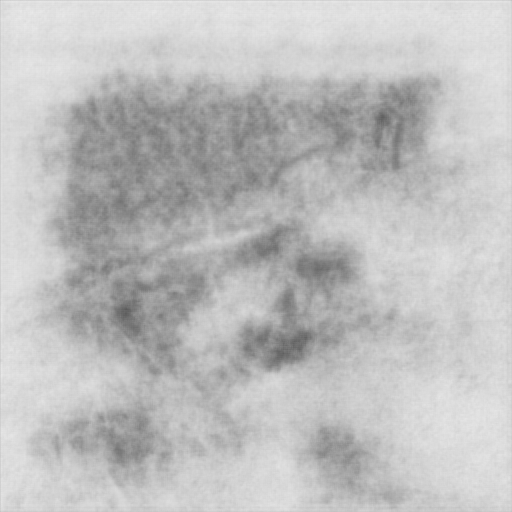

305 2501
306 2502
307 2503
308 2504
309 2505
310 2506
311 2507
312 2508
313 2509
314 2510
315 2511
316 2512
317 2513
318 2514
319 2515
320 2516
321 2517
322 2518
323 2519
324 2520
325 2521
326 2522
327 2523
328 2524
329 2525
330 2526
331 2527
332 2528
333 2529
334 2530
335 2531
336 2532
337 2533
338 2534
339 2535
340 2536
341 2537
342 2538
343 2539
344 2540
345 2541
346 2542
347 2543
348 2544
349 2545
350 2546
351 2547
352 2548
353 2549
354 2550
355 2551
356 2552
357 2553
358 2554
359 2555
360 2556
361 2557
362 2558
363 2559
364 2560
365 2561
366 2562
367 2563
368 2564
369 2565
370 2566
371 2567
372 2568
373 2569
374 2570
375 2571
376 2572
377 2573
378 2574
379 2575
380 2576
381 2577
382 2578
383 2579
384 2580
385 2581
386 2582
387 2583
388 2584
389 2585
390 2586
391 2587
392 2588
393 2589
394 2590
395 2591
396 2592
397 2593
398 2594
399 2595
400 2596
401 2597
402 2598
403 2599
404 2600
2009_002885


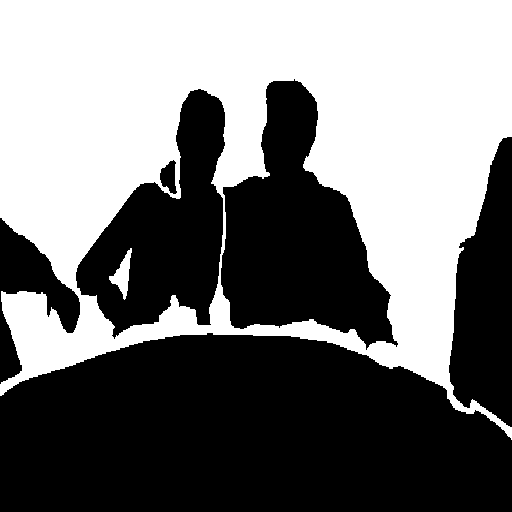

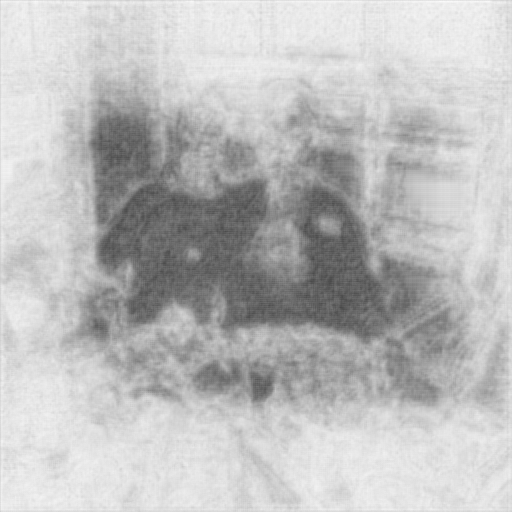

405 2601
406 2602
407 2603
408 2604
409 2605
410 2606
411 2607
412 2608
413 2609
414 2610
415 2611
416 2612
417 2613
418 2614
419 2615
420 2616
421 2617
422 2618
423 2619
424 2620
425 2621
426 2622
427 2623
428 2624
429 2625
430 2626
431 2627
432 2628
433 2629
434 2630
435 2631
436 2632
437 2633
438 2634
439 2635
440 2636
441 2637
442 2638
443 2639
444 2640
445 2641
446 2642
447 2643
448 2644
449 2645
450 2646
451 2647
452 2648
453 2649
454 2650
455 2651
456 2652
457 2653
458 2654
459 2655
460 2656
461 2657
462 2658
463 2659
464 2660
465 2661
466 2662
467 2663
468 2664
469 2665
470 2666
471 2667
472 2668
473 2669
474 2670
475 2671
476 2672
477 2673
478 2674
479 2675
480 2676
481 2677
482 2678
483 2679
484 2680
485 2681
486 2682
487 2683
488 2684
489 2685
490 2686
491 2687
492 2688
493 2689
494 2690
495 2691
496 2692
497 2693
498 2694
499 2695
500 2696
501 2697
502 2698
503 2699
504 2700
2010_001273


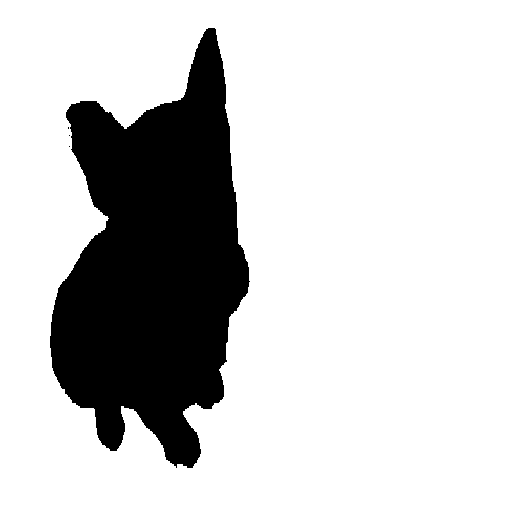

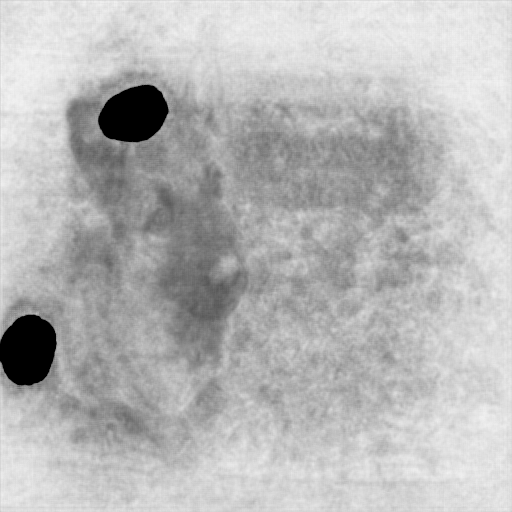

505 2701
506 2702
507 2703
508 2704
509 2705
510 2706
511 2707
512 2708
513 2709
514 2710
515 2711
516 2712
517 2713
518 2714
519 2715
520 2716
521 2717
522 2718
523 2719
524 2720
525 2721
526 2722
527 2723
528 2724
529 2725
530 2726
531 2727
532 2728
533 2729
534 2730
535 2731
536 2732
537 2733
538 2734
539 2735
540 2736
541 2737
542 2738
543 2739
544 2740
545 2741
546 2742
547 2743
548 2744
549 2745
550 2746
551 2747
552 2748
553 2749
554 2750
555 2751
556 2752
557 2753
558 2754
559 2755
560 2756
561 2757
562 2758
563 2759
564 2760
565 2761
566 2762
567 2763
568 2764
569 2765
570 2766
571 2767
572 2768
573 2769
574 2770
575 2771
576 2772
577 2773
578 2774
579 2775
580 2776
581 2777
582 2778
583 2779
584 2780
585 2781
586 2782
587 2783
588 2784
589 2785
590 2786
591 2787
592 2788
593 2789
594 2790
595 2791
596 2792
597 2793
598 2794
599 2795
600 2796
601 2797
602 2798
603 2799
604 2800
2010_005106


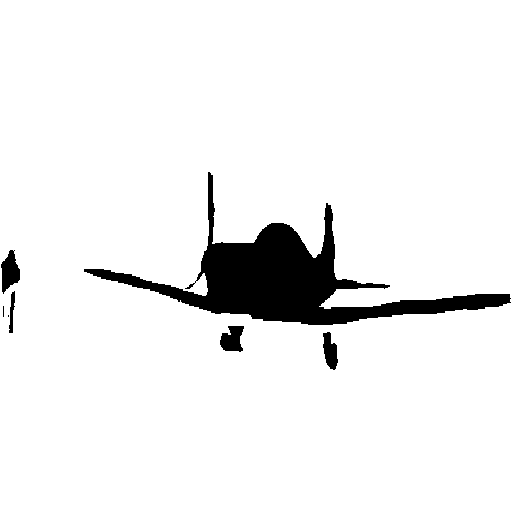

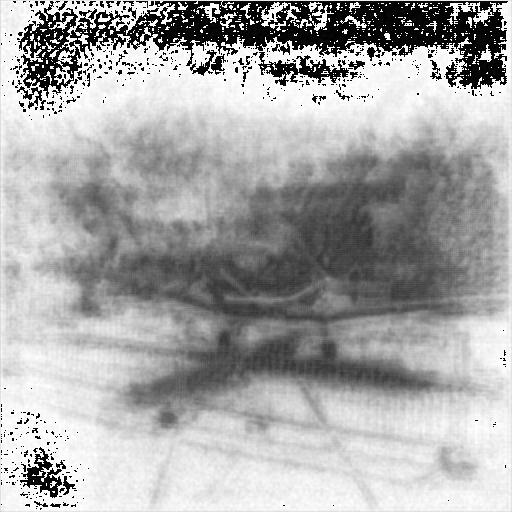

605 2801
606 2802
607 2803
608 2804
609 2805
610 2806
611 2807
612 2808
613 2809
614 2810
615 2811
616 2812
617 2813
618 2814
619 2815
620 2816
621 2817
622 2818
623 2819
624 2820
625 2821
626 2822
627 2823
628 2824
629 2825
630 2826
631 2827
632 2828
633 2829
634 2830
635 2831
636 2832
637 2833
638 2834
639 2835
640 2836
641 2837
642 2838
643 2839
644 2840
645 2841
646 2842
647 2843
648 2844
649 2845
650 2846
651 2847
652 2848
653 2849
654 2850
655 2851
656 2852
657 2853
658 2854
659 2855
660 2856
661 2857
662 2858
663 2859
664 2860
665 2861
666 2862
667 2863
668 2864
669 2865
670 2866
671 2867
672 2868
673 2869
674 2870
675 2871
676 2872
677 2873
678 2874
679 2875
680 2876
681 2877
682 2878
683 2879
684 2880
685 2881
686 2882
687 2883
688 2884
689 2885
690 2886
691 2887
692 2888
693 2889
694 2890
695 2891
696 2892
697 2893
698 2894
699 2895
700 2896
701 2897
702 2898
703 2899
704 2900
2011_002246


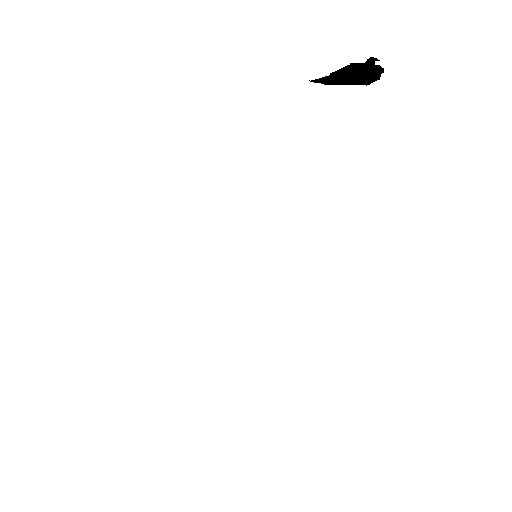

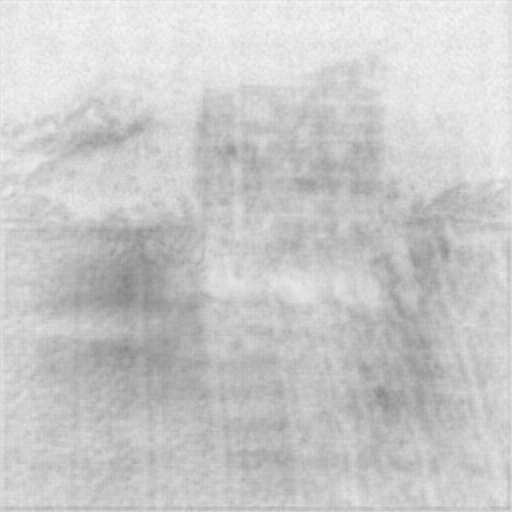

705 2901
706 2902
707 2903
708 2904
709 2905
710 2906
711 2907
712 2908
713 2909
714 2910
715 2911
716 2912
717 2913
718 2914
719 2915
720 2916
721 2917
722 2918
723 2919
724 2920
725 2921
726 2922
727 2923
728 2924
729 2925
730 2926
731 2927
0 2928
1 2929
2 2930
3 2931
4 2932
5 2933
6 2934
7 2935
8 2936
9 2937
10 2938
11 2939
12 2940
13 2941
14 2942
15 2943
16 2944
17 2945
18 2946
19 2947
20 2948
21 2949
22 2950
23 2951
24 2952
25 2953
26 2954
27 2955
28 2956
29 2957
30 2958
31 2959
32 2960
33 2961
34 2962
35 2963
36 2964
37 2965
38 2966
39 2967
40 2968
41 2969
42 2970
43 2971
44 2972
45 2973
46 2974
47 2975
48 2976
49 2977
50 2978
51 2979
52 2980
53 2981
54 2982
55 2983
56 2984
57 2985
58 2986
59 2987
60 2988
61 2989
62 2990
63 2991
64 2992
65 2993
66 2994
67 2995
68 2996
69 2997
70 2998
71 2999
72 3000
2007_004830


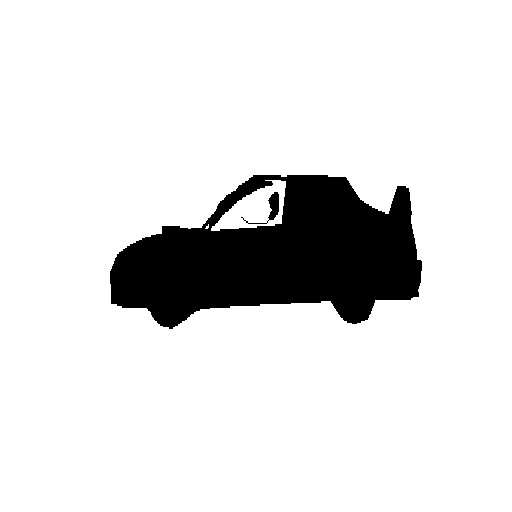

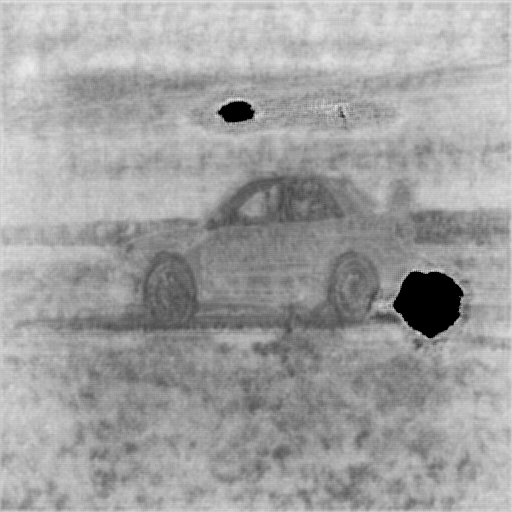

73 3001
74 3002
75 3003
76 3004
77 3005
78 3006
79 3007
80 3008
81 3009
82 3010
83 3011
84 3012
85 3013
86 3014
87 3015
88 3016
89 3017
90 3018
91 3019
92 3020
93 3021
94 3022
95 3023
96 3024
97 3025
98 3026
99 3027
100 3028
101 3029
102 3030
103 3031
104 3032
105 3033
106 3034
107 3035
108 3036
109 3037
110 3038
111 3039
112 3040
113 3041
114 3042
115 3043
116 3044
117 3045
118 3046
119 3047
120 3048
121 3049
122 3050
123 3051
124 3052
125 3053
126 3054
127 3055
128 3056
129 3057
130 3058
131 3059
132 3060
133 3061
134 3062
135 3063
136 3064
137 3065
138 3066
139 3067
140 3068
141 3069
142 3070
143 3071
144 3072
145 3073
146 3074
147 3075
148 3076
149 3077
150 3078
151 3079
152 3080
153 3081
154 3082
155 3083
156 3084
157 3085
158 3086
159 3087
160 3088
161 3089
162 3090
163 3091
164 3092
165 3093
166 3094
167 3095
168 3096
169 3097
170 3098
171 3099
172 3100
2008_000415


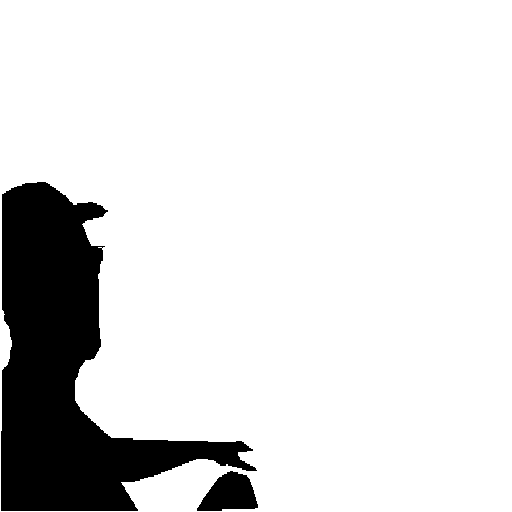

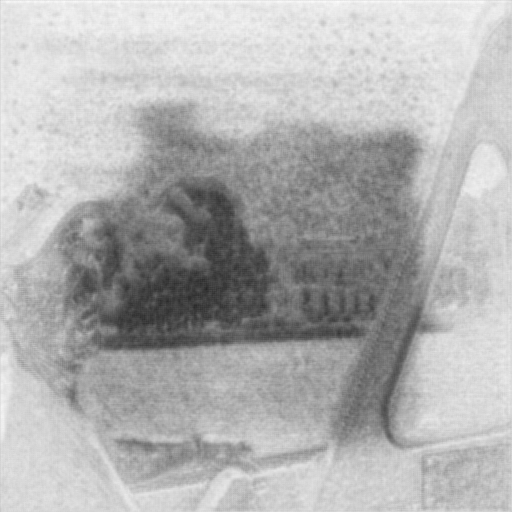

173 3101
174 3102
175 3103
176 3104
177 3105
178 3106
179 3107
180 3108
181 3109
182 3110
183 3111
184 3112
185 3113
186 3114
187 3115
188 3116
189 3117
190 3118
191 3119
192 3120
193 3121
194 3122
195 3123
196 3124
197 3125
198 3126
199 3127
200 3128
201 3129
202 3130
203 3131
204 3132
205 3133
206 3134
207 3135
208 3136
209 3137
210 3138
211 3139
212 3140
213 3141
214 3142
215 3143
216 3144
217 3145
218 3146
219 3147
220 3148
221 3149
222 3150
223 3151
224 3152
225 3153
226 3154
227 3155
228 3156
229 3157
230 3158
231 3159
232 3160
233 3161
234 3162
235 3163
236 3164
237 3165
238 3166
239 3167
240 3168
241 3169
242 3170
243 3171
244 3172
245 3173
246 3174
247 3175
248 3176
249 3177
250 3178
251 3179
252 3180
253 3181
254 3182
255 3183
256 3184
257 3185
258 3186
259 3187
260 3188
261 3189
262 3190
263 3191
264 3192
265 3193
266 3194
267 3195
268 3196
269 3197
270 3198
271 3199
272 3200
2008_005300


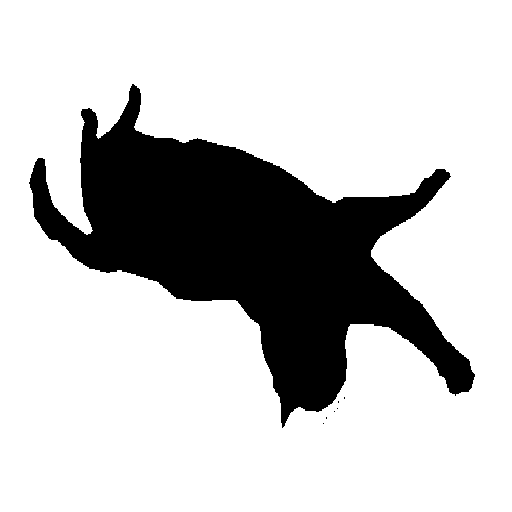

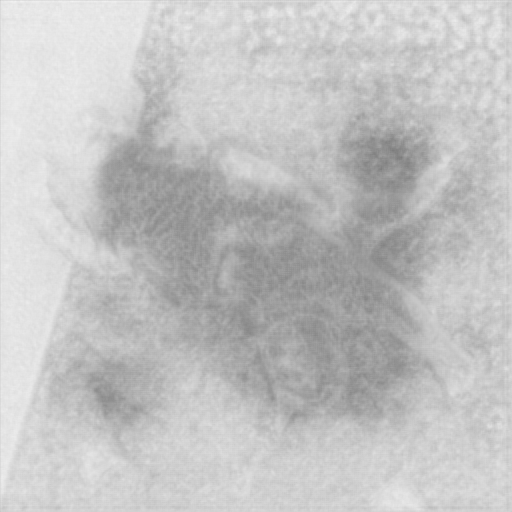

273 3201
274 3202
275 3203
276 3204
277 3205
278 3206
279 3207
280 3208
281 3209
282 3210
283 3211
284 3212
285 3213
286 3214
287 3215
288 3216
289 3217
290 3218
291 3219
292 3220
293 3221
294 3222
295 3223
296 3224
297 3225
298 3226
299 3227
300 3228
301 3229
302 3230
303 3231
304 3232
305 3233
306 3234
307 3235
308 3236
309 3237
310 3238
311 3239
312 3240
313 3241
314 3242
315 3243
316 3244
317 3245
318 3246
319 3247
320 3248
321 3249
322 3250
323 3251
324 3252
325 3253
326 3254
327 3255
328 3256
329 3257
330 3258
331 3259
332 3260
333 3261
334 3262
335 3263
336 3264
337 3265
338 3266
339 3267
340 3268
341 3269
342 3270
343 3271
344 3272
345 3273
346 3274
347 3275
348 3276
349 3277
350 3278
351 3279
352 3280
353 3281
354 3282
355 3283
356 3284
357 3285
358 3286
359 3287
360 3288
361 3289
362 3290
363 3291
364 3292
365 3293
366 3294
367 3295
368 3296
369 3297
370 3298
371 3299
372 3300
2009_001828


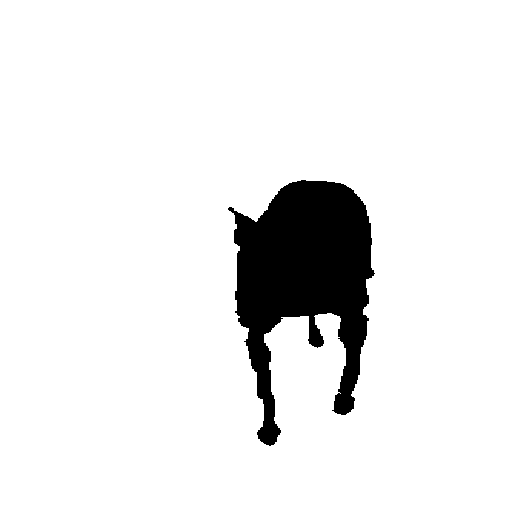

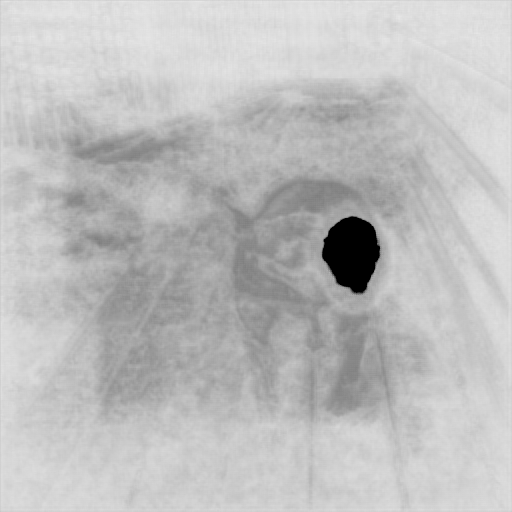

373 3301
374 3302
375 3303
376 3304
377 3305
378 3306
379 3307
380 3308
381 3309
382 3310
383 3311
384 3312
385 3313
386 3314
387 3315
388 3316
389 3317
390 3318
391 3319
392 3320
393 3321
394 3322
395 3323
396 3324
397 3325
398 3326
399 3327
400 3328
401 3329
402 3330
403 3331
404 3332
405 3333
406 3334
407 3335
408 3336
409 3337
410 3338
411 3339
412 3340
413 3341
414 3342
415 3343
416 3344
417 3345
418 3346
419 3347
420 3348
421 3349
422 3350
423 3351
424 3352
425 3353
426 3354
427 3355
428 3356
429 3357
430 3358
431 3359
432 3360
433 3361
434 3362
435 3363
436 3364
437 3365
438 3366
439 3367
440 3368
441 3369
442 3370
443 3371
444 3372
445 3373
446 3374
447 3375
448 3376
449 3377
450 3378
451 3379
452 3380
453 3381
454 3382
455 3383
456 3384
457 3385
458 3386
459 3387
460 3388
461 3389
462 3390
463 3391
464 3392
465 3393
466 3394
467 3395
468 3396
469 3397
470 3398
471 3399
472 3400
2009_005160


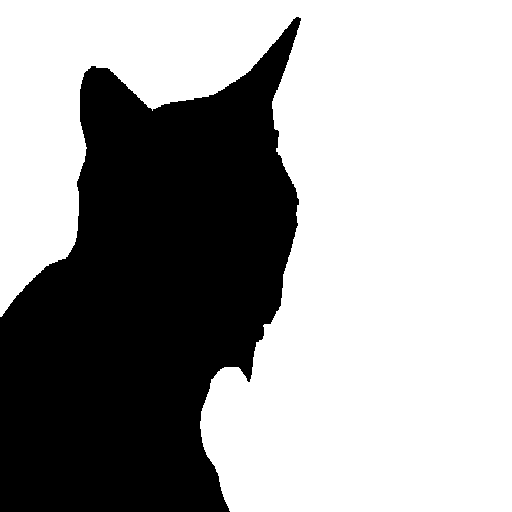

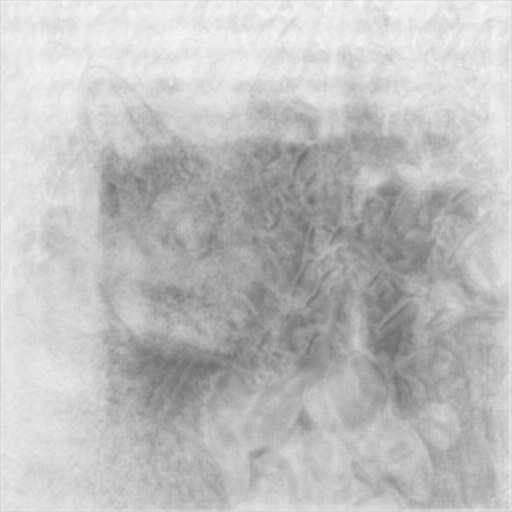

473 3401
474 3402
475 3403
476 3404
477 3405
478 3406
479 3407
480 3408
481 3409
482 3410
483 3411
484 3412
485 3413
486 3414
487 3415
488 3416
489 3417
490 3418
491 3419
492 3420
493 3421
494 3422
495 3423
496 3424
497 3425
498 3426
499 3427
500 3428
501 3429
502 3430
503 3431
504 3432
505 3433
506 3434
507 3435
508 3436
509 3437
510 3438
511 3439
512 3440
513 3441
514 3442
515 3443
516 3444
517 3445
518 3446
519 3447
520 3448
521 3449
522 3450
523 3451
524 3452
525 3453
526 3454
527 3455
528 3456
529 3457
530 3458
531 3459
532 3460
533 3461
534 3462
535 3463
536 3464
537 3465
538 3466
539 3467
540 3468
541 3469
542 3470
543 3471
544 3472
545 3473
546 3474
547 3475
548 3476
549 3477
550 3478
551 3479
552 3480
553 3481
554 3482
555 3483
556 3484
557 3485
558 3486
559 3487
560 3488
561 3489
562 3490
563 3491
564 3492
565 3493
566 3494
567 3495
568 3496
569 3497
570 3498
571 3499
572 3500
2010_003950


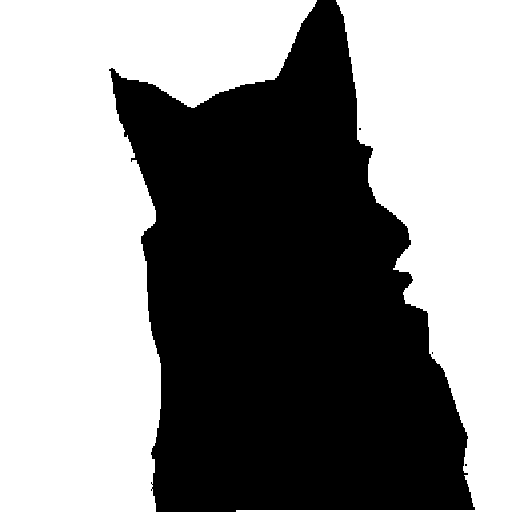

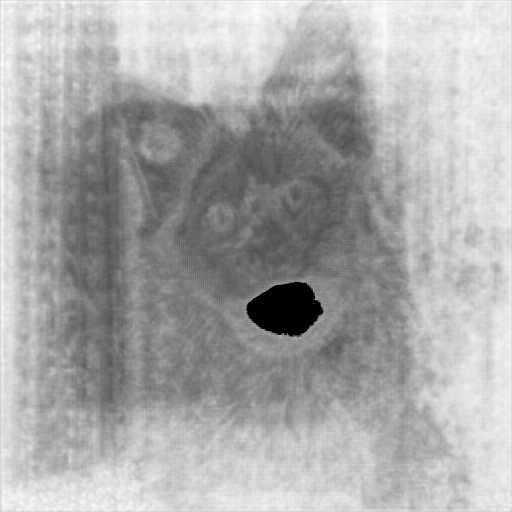

573 3501
574 3502
575 3503
576 3504
577 3505
578 3506
579 3507
580 3508
581 3509
582 3510
583 3511
584 3512
585 3513
586 3514
587 3515
588 3516
589 3517
590 3518
591 3519
592 3520
593 3521
594 3522
595 3523
596 3524
597 3525
598 3526
599 3527
600 3528
601 3529
602 3530
603 3531
604 3532
605 3533
606 3534
607 3535
608 3536
609 3537
610 3538
611 3539
612 3540
613 3541
614 3542
615 3543
616 3544
617 3545
618 3546
619 3547
620 3548
621 3549
622 3550
623 3551
624 3552
625 3553
626 3554
627 3555
628 3556
629 3557
630 3558
631 3559
632 3560
633 3561
634 3562
635 3563
636 3564
637 3565
638 3566
639 3567
640 3568
641 3569
642 3570
643 3571
644 3572
645 3573
646 3574
647 3575
648 3576
649 3577
650 3578
651 3579
652 3580
653 3581
654 3582
655 3583
656 3584
657 3585
658 3586
659 3587
660 3588
661 3589
662 3590
663 3591
664 3592
665 3593
666 3594
667 3595
668 3596
669 3597
670 3598
671 3599
672 3600
2011_001015


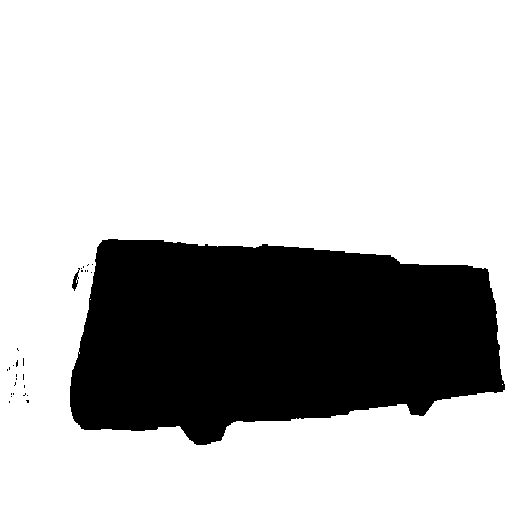

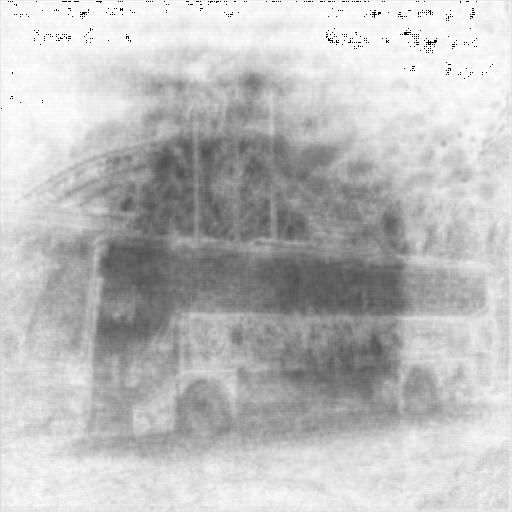

673 3601
674 3602
675 3603
676 3604
677 3605
678 3606
679 3607
680 3608
681 3609
682 3610
683 3611
684 3612
685 3613
686 3614
687 3615
688 3616
689 3617
690 3618
691 3619
692 3620
693 3621
694 3622
695 3623
696 3624
697 3625
698 3626
699 3627
700 3628
701 3629
702 3630
703 3631
704 3632
705 3633
706 3634
707 3635
708 3636
709 3637
710 3638
711 3639
712 3640
713 3641
714 3642
715 3643
716 3644
717 3645
718 3646
719 3647
720 3648
721 3649
722 3650
723 3651
724 3652
725 3653
726 3654
727 3655
728 3656
729 3657
730 3658
731 3659
0 3660
1 3661
2 3662
3 3663
4 3664
5 3665
6 3666
7 3667
8 3668
9 3669
10 3670
11 3671
12 3672
13 3673
14 3674
15 3675
16 3676
17 3677
18 3678
19 3679
20 3680
21 3681
22 3682
23 3683
24 3684
25 3685
26 3686
27 3687
28 3688
29 3689
30 3690
31 3691
32 3692
33 3693
34 3694
35 3695
36 3696
37 3697
38 3698
39 3699
40 3700
2007_002545


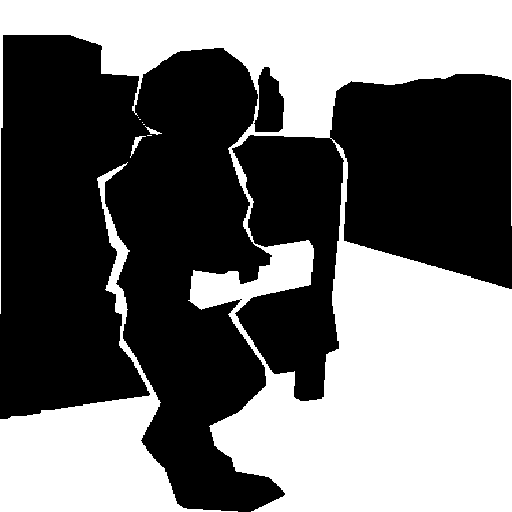

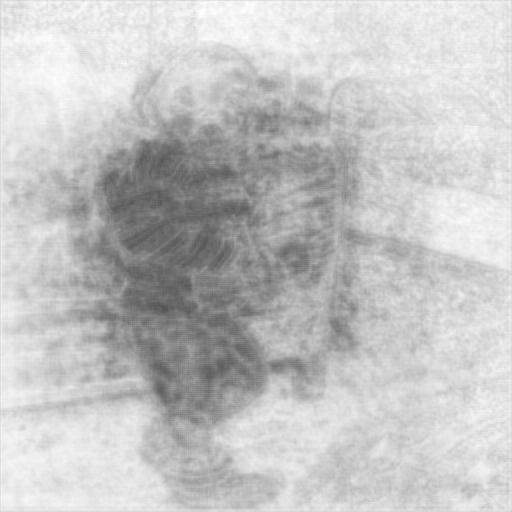

41 3701
42 3702
43 3703
44 3704
45 3705
46 3706
47 3707
48 3708
49 3709
50 3710
51 3711
52 3712
53 3713
54 3714
55 3715
56 3716
57 3717
58 3718
59 3719
60 3720
61 3721
62 3722
63 3723
64 3724
65 3725
66 3726
67 3727
68 3728
69 3729
70 3730
71 3731
72 3732
73 3733
74 3734
75 3735
76 3736
77 3737
78 3738
79 3739
80 3740
81 3741
82 3742
83 3743
84 3744
85 3745
86 3746
87 3747
88 3748
89 3749
90 3750
91 3751
92 3752
93 3753
94 3754
95 3755
96 3756
97 3757
98 3758
99 3759
100 3760
101 3761
102 3762
103 3763
104 3764
105 3765
106 3766
107 3767
108 3768
109 3769
110 3770
111 3771
112 3772
113 3773
114 3774
115 3775
116 3776
117 3777
118 3778
119 3779
120 3780
121 3781
122 3782
123 3783
124 3784
125 3785
126 3786
127 3787
128 3788
129 3789
130 3790
131 3791
132 3792
133 3793
134 3794
135 3795
136 3796
137 3797
138 3798
139 3799
140 3800
2007_009327


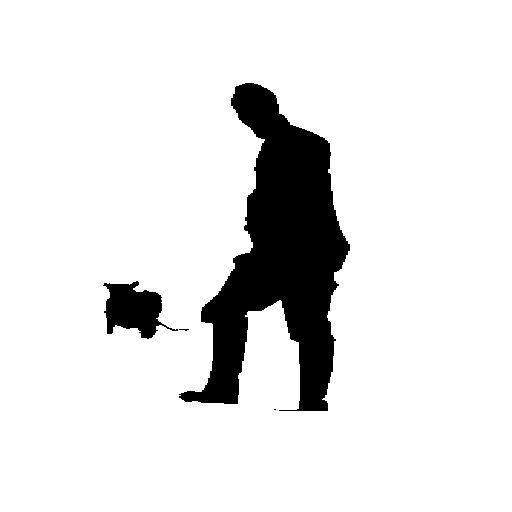

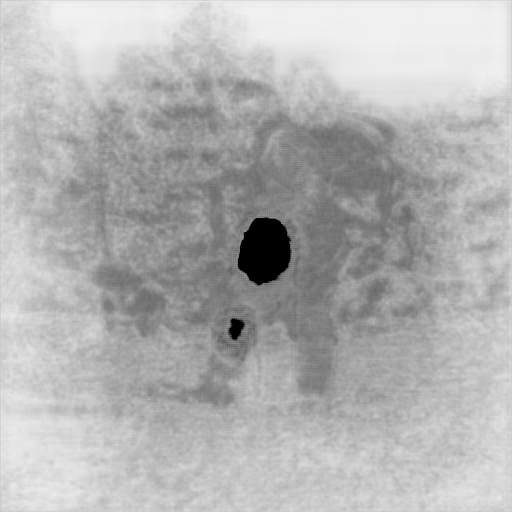

141 3801
142 3802
143 3803
144 3804
145 3805
146 3806
147 3807
148 3808
149 3809
150 3810
151 3811
152 3812
153 3813
154 3814
155 3815
156 3816
157 3817
158 3818
159 3819
160 3820
161 3821
162 3822
163 3823
164 3824
165 3825
166 3826
167 3827
168 3828
169 3829
170 3830
171 3831
172 3832
173 3833
174 3834
175 3835
176 3836
177 3837
178 3838
179 3839
180 3840
181 3841
182 3842
183 3843
184 3844
185 3845
186 3846
187 3847
188 3848
189 3849
190 3850
191 3851
192 3852
193 3853
194 3854
195 3855
196 3856
197 3857
198 3858
199 3859
200 3860
201 3861
202 3862
203 3863
204 3864
205 3865
206 3866
207 3867
208 3868
209 3869
210 3870
211 3871
212 3872
213 3873
214 3874
215 3875
216 3876
217 3877
218 3878
219 3879
220 3880
221 3881
222 3882
223 3883
224 3884
225 3885
226 3886
227 3887
228 3888
229 3889
230 3890
231 3891
232 3892
233 3893
234 3894
235 3895
236 3896
237 3897
238 3898
239 3899
240 3900
2008_003208


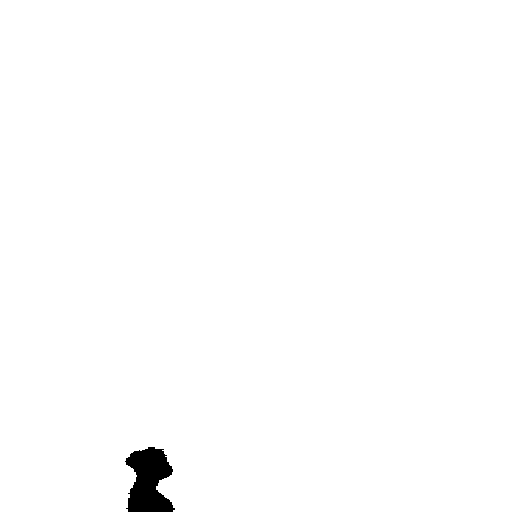

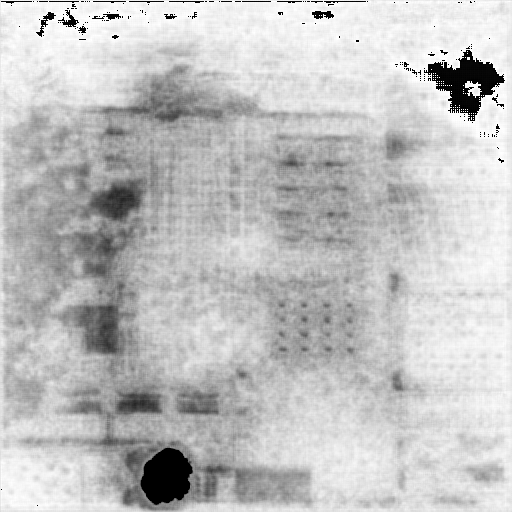

241 3901
242 3902
243 3903
244 3904
245 3905
246 3906
247 3907
248 3908
249 3909
250 3910
251 3911
252 3912
253 3913
254 3914
255 3915
256 3916
257 3917
258 3918
259 3919
260 3920
261 3921
262 3922
263 3923
264 3924
265 3925
266 3926
267 3927
268 3928
269 3929
270 3930
271 3931
272 3932
273 3933
274 3934
275 3935
276 3936
277 3937
278 3938
279 3939
280 3940
281 3941
282 3942
283 3943
284 3944
285 3945
286 3946
287 3947
288 3948
289 3949
290 3950
291 3951
292 3952
293 3953
294 3954
295 3955
296 3956
297 3957
298 3958
299 3959
300 3960
301 3961
302 3962
303 3963
304 3964
305 3965
306 3966
307 3967
308 3968
309 3969
310 3970
311 3971
312 3972
313 3973
314 3974
315 3975
316 3976
317 3977
318 3978
319 3979
320 3980
321 3981
322 3982
323 3983
324 3984
325 3985
326 3986
327 3987
328 3988
329 3989
330 3990
331 3991
332 3992
333 3993
334 3994
335 3995
336 3996
337 3997
338 3998
339 3999
340 4000
2009_000894


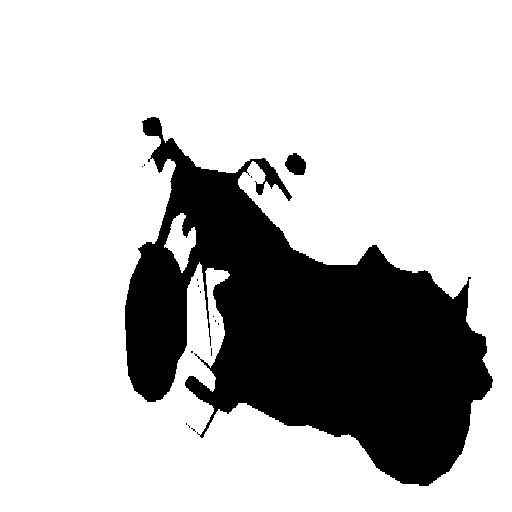

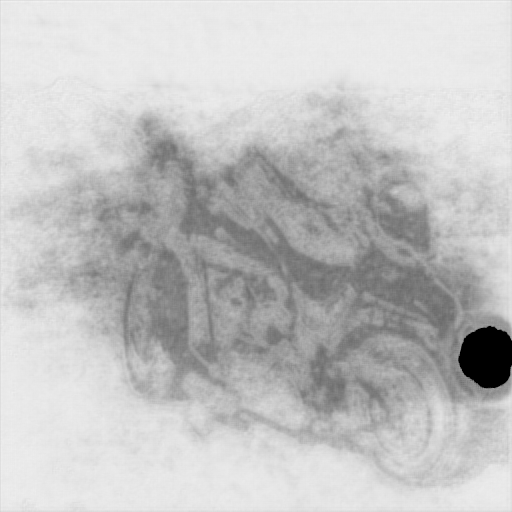

341 4001
342 4002
343 4003
344 4004
345 4005
346 4006
347 4007
348 4008
349 4009
350 4010
351 4011
352 4012
353 4013
354 4014
355 4015
356 4016
357 4017
358 4018
359 4019
360 4020
361 4021
362 4022
363 4023
364 4024
365 4025
366 4026
367 4027
368 4028
369 4029
370 4030
371 4031
372 4032
373 4033
374 4034
375 4035
376 4036
377 4037
378 4038
379 4039
380 4040
381 4041
382 4042
383 4043
384 4044
385 4045
386 4046
387 4047
388 4048
389 4049
390 4050
391 4051
392 4052
393 4053
394 4054
395 4055
396 4056
397 4057
398 4058
399 4059
400 4060
401 4061
402 4062
403 4063
404 4064
405 4065
406 4066
407 4067
408 4068
409 4069
410 4070
411 4071
412 4072
413 4073
414 4074
415 4075
416 4076
417 4077
418 4078
419 4079
420 4080
421 4081
422 4082
423 4083
424 4084
425 4085
426 4086
427 4087
428 4088
429 4089
430 4090
431 4091
432 4092
433 4093
434 4094
435 4095
436 4096
437 4097
438 4098
439 4099
440 4100
2009_004180


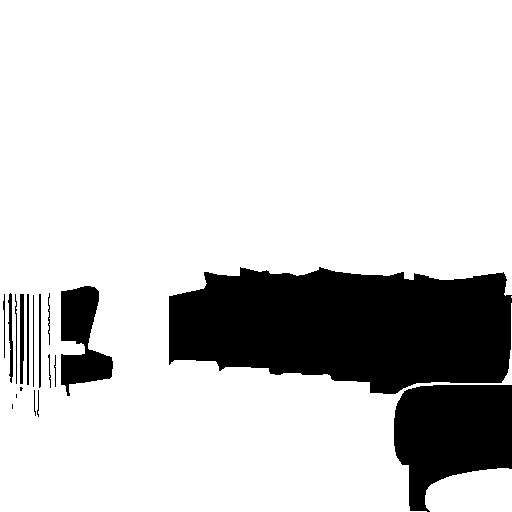

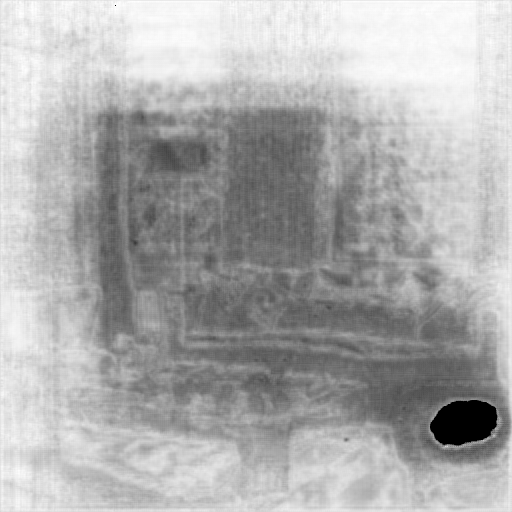

441 4101
442 4102
443 4103
444 4104
445 4105
446 4106
447 4107
448 4108
449 4109
450 4110
451 4111
452 4112
453 4113
454 4114
455 4115
456 4116
457 4117
458 4118
459 4119
460 4120
461 4121
462 4122
463 4123
464 4124
465 4125
466 4126
467 4127
468 4128
469 4129
470 4130
471 4131
472 4132
473 4133
474 4134
475 4135
476 4136
477 4137
478 4138
479 4139
480 4140
481 4141
482 4142
483 4143
484 4144
485 4145
486 4146
487 4147
488 4148
489 4149
490 4150
491 4151
492 4152
493 4153
494 4154
495 4155
496 4156
497 4157
498 4158
499 4159
500 4160
501 4161
502 4162
503 4163
504 4164
505 4165
506 4166
507 4167
508 4168
509 4169
510 4170
511 4171
512 4172
513 4173
514 4174
515 4175
516 4176
517 4177
518 4178
519 4179
520 4180
521 4181
522 4182
523 4183
524 4184
525 4185
526 4186
527 4187
528 4188
529 4189
530 4190
531 4191
532 4192
533 4193
534 4194
535 4195
536 4196
537 4197
538 4198
539 4199
540 4200
2010_002573


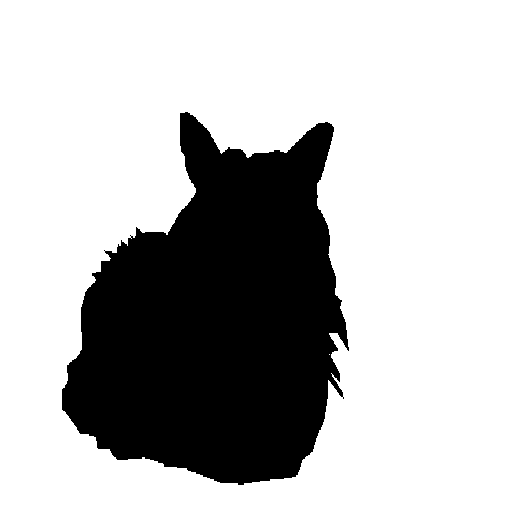

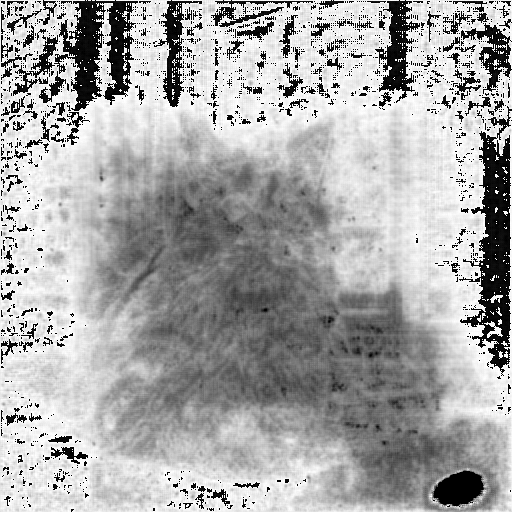

541 4201
542 4202
543 4203
544 4204
545 4205
546 4206
547 4207
548 4208
549 4209
550 4210
551 4211
552 4212
553 4213
554 4214
555 4215
556 4216
557 4217
558 4218
559 4219
560 4220
561 4221
562 4222
563 4223
564 4224
565 4225
566 4226
567 4227
568 4228
569 4229
570 4230
571 4231
572 4232
573 4233
574 4234
575 4235
576 4236
577 4237
578 4238
579 4239
580 4240
581 4241
582 4242
583 4243
584 4244
585 4245
586 4246
587 4247
588 4248
589 4249
590 4250
591 4251
592 4252
593 4253
594 4254
595 4255
596 4256
597 4257
598 4258
599 4259
600 4260
601 4261
602 4262
603 4263
604 4264
605 4265
606 4266
607 4267
608 4268
609 4269
610 4270
611 4271
612 4272
613 4273
614 4274
615 4275
616 4276
617 4277
618 4278
619 4279
620 4280
621 4281
622 4282
623 4283
624 4284
625 4285
626 4286
627 4287
628 4288
629 4289
630 4290
631 4291
632 4292
633 4293
634 4294
635 4295
636 4296
637 4297
638 4298
639 4299
640 4300
2011_000122


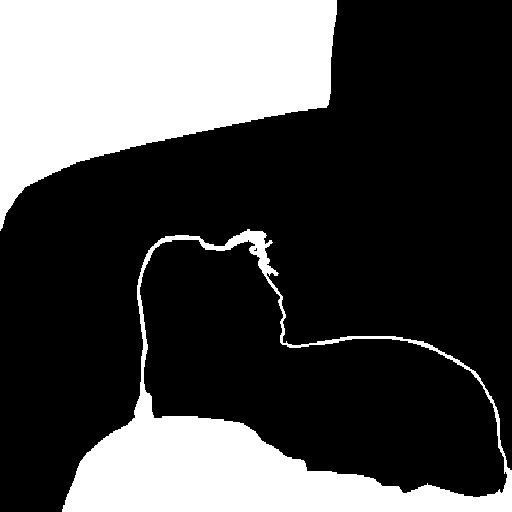

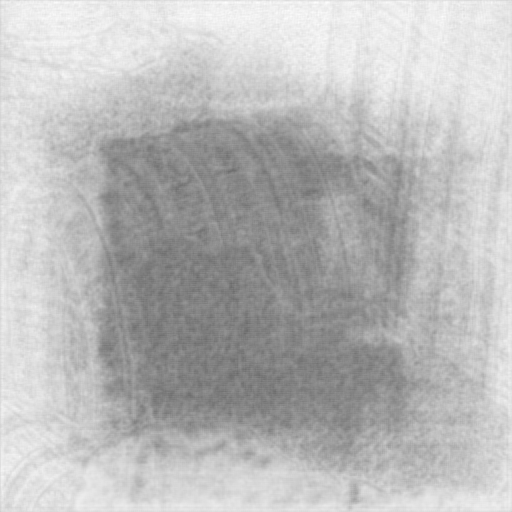

641 4301
642 4302
643 4303
644 4304
645 4305
646 4306
647 4307
648 4308
649 4309
650 4310
651 4311
652 4312
653 4313
654 4314
655 4315
656 4316
657 4317
658 4318
659 4319
660 4320
661 4321
662 4322
663 4323
664 4324
665 4325
666 4326
667 4327
668 4328
669 4329
670 4330
671 4331
672 4332
673 4333
674 4334
675 4335
676 4336
677 4337
678 4338
679 4339
680 4340
681 4341
682 4342
683 4343
684 4344
685 4345
686 4346
687 4347
688 4348
689 4349
690 4350
691 4351
692 4352
693 4353
694 4354
695 4355
696 4356
697 4357
698 4358
699 4359
700 4360
701 4361
702 4362
703 4363
704 4364
705 4365
706 4366
707 4367
708 4368
709 4369
710 4370
711 4371
712 4372
713 4373
714 4374
715 4375
716 4376
717 4377
718 4378
719 4379
720 4380
721 4381
722 4382
723 4383
724 4384
725 4385
726 4386
727 4387
728 4388
729 4389
730 4390
731 4391
0 4392
1 4393
2 4394
3 4395
4 4396
5 4397
6 4398
7 4399
8 4400
2007_000515


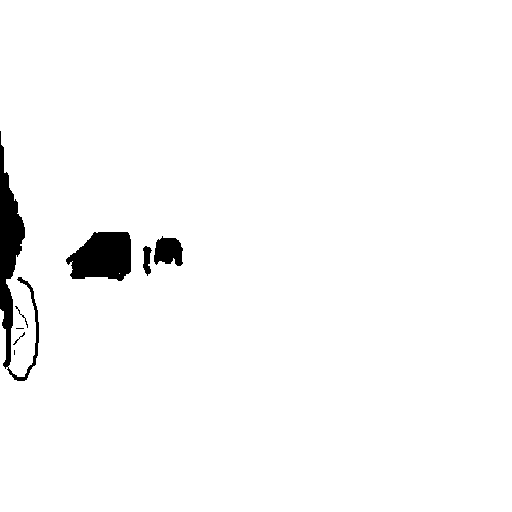

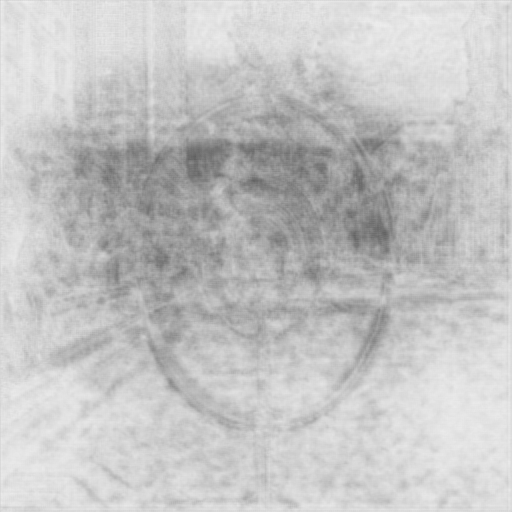

9 4401
10 4402
11 4403
12 4404
13 4405
14 4406
15 4407
16 4408
17 4409
18 4410
19 4411
20 4412
21 4413
22 4414
23 4415
24 4416
25 4417
26 4418
27 4419
28 4420
29 4421
30 4422
31 4423
32 4424
33 4425
34 4426
35 4427
36 4428
37 4429
38 4430
39 4431
40 4432
41 4433
42 4434
43 4435
44 4436
45 4437
46 4438
47 4439
48 4440
49 4441
50 4442
51 4443
52 4444
53 4445
54 4446
55 4447
56 4448
57 4449
58 4450
59 4451
60 4452
61 4453
62 4454
63 4455
64 4456
65 4457
66 4458
67 4459
68 4460
69 4461
70 4462
71 4463
72 4464
73 4465
74 4466
75 4467
76 4468
77 4469
78 4470
79 4471
80 4472
81 4473
82 4474
83 4475
84 4476
85 4477
86 4478
87 4479
88 4480
89 4481
90 4482
91 4483
92 4484
93 4485
94 4486
95 4487
96 4488
97 4489
98 4490
99 4491
100 4492
101 4493
102 4494
103 4495
104 4496
105 4497
106 4498
107 4499
108 4500
2007_007098


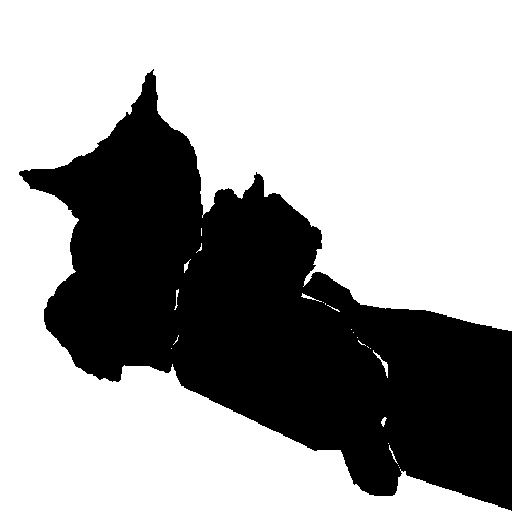

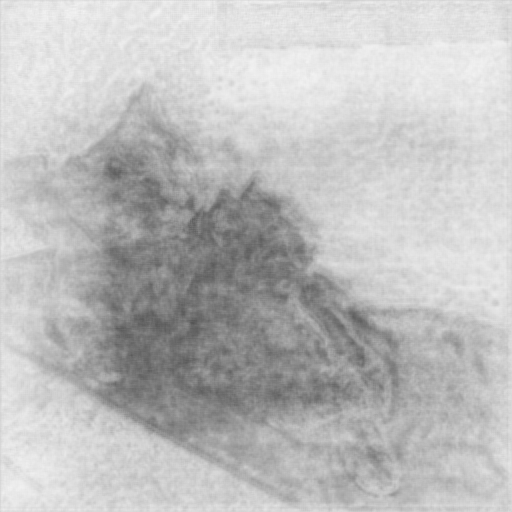

109 4501
110 4502
111 4503
112 4504
113 4505
114 4506
115 4507
116 4508
117 4509
118 4510
119 4511
120 4512
121 4513
122 4514
123 4515
124 4516
125 4517
126 4518
127 4519
128 4520
129 4521
130 4522
131 4523
132 4524
133 4525
134 4526
135 4527
136 4528
137 4529
138 4530
139 4531
140 4532
141 4533
142 4534
143 4535
144 4536
145 4537
146 4538
147 4539
148 4540
149 4541
150 4542
151 4543
152 4544
153 4545
154 4546
155 4547
156 4548
157 4549
158 4550
159 4551
160 4552
161 4553
162 4554
163 4555
164 4556
165 4557
166 4558
167 4559
168 4560
169 4561
170 4562
171 4563
172 4564
173 4565
174 4566
175 4567
176 4568
177 4569
178 4570
179 4571
180 4572
181 4573
182 4574
183 4575
184 4576
185 4577
186 4578
187 4579
188 4580
189 4581
190 4582
191 4583
192 4584
193 4585
194 4586
195 4587
196 4588
197 4589
198 4590
199 4591
200 4592
201 4593
202 4594
203 4595
204 4596
205 4597
206 4598
207 4599
208 4600
2008_001761


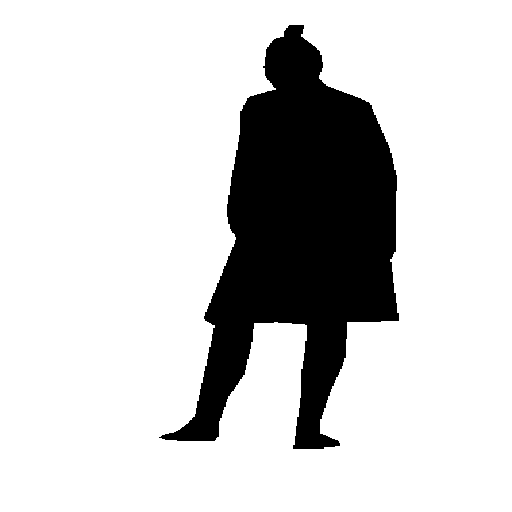

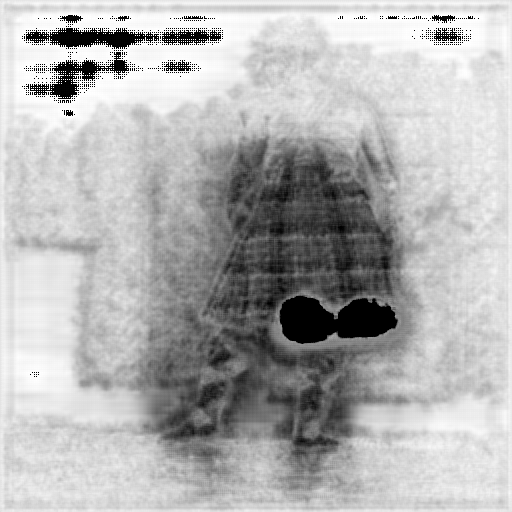

209 4601
210 4602
211 4603
212 4604
213 4605
214 4606
215 4607
216 4608
217 4609
218 4610
219 4611
220 4612
221 4613
222 4614
223 4615
224 4616
225 4617
226 4618
227 4619
228 4620
229 4621
230 4622
231 4623
232 4624
233 4625
234 4626
235 4627
236 4628
237 4629
238 4630
239 4631
240 4632
241 4633
242 4634
243 4635
244 4636
245 4637
246 4638
247 4639
248 4640
249 4641
250 4642
251 4643
252 4644
253 4645
254 4646
255 4647
256 4648
257 4649
258 4650
259 4651
260 4652
261 4653
262 4654
263 4655
264 4656
265 4657
266 4658
267 4659
268 4660
269 4661
270 4662
271 4663
272 4664
273 4665
274 4666
275 4667
276 4668
277 4669
278 4670
279 4671
280 4672
281 4673
282 4674
283 4675
284 4676
285 4677
286 4678
287 4679
288 4680
289 4681
290 4682
291 4683
292 4684
293 4685
294 4686
295 4687
296 4688
297 4689
298 4690
299 4691
300 4692
301 4693
302 4694
303 4695
304 4696
305 4697
306 4698
307 4699
308 4700
2008_007581


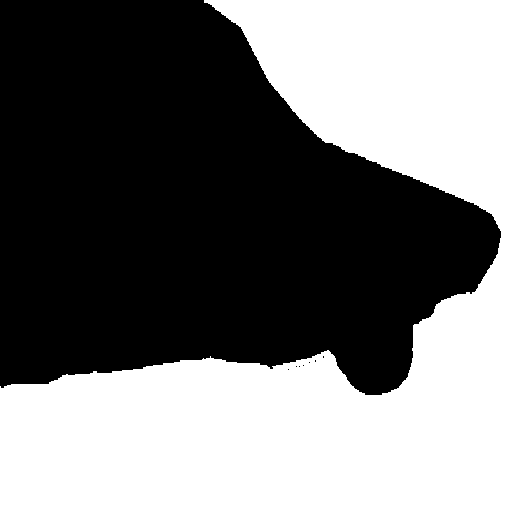

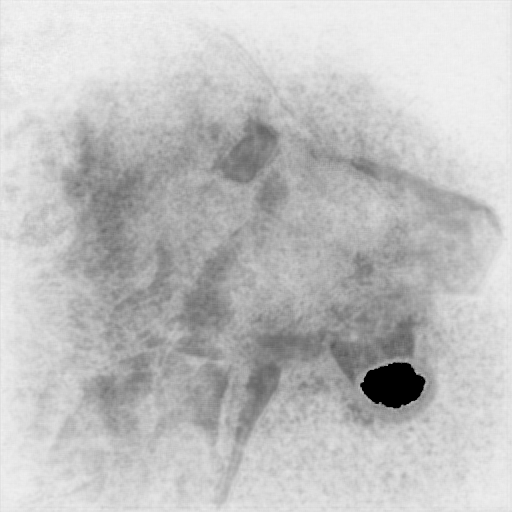

309 4701
310 4702
311 4703
312 4704
313 4705
314 4706
315 4707
316 4708
317 4709
318 4710
319 4711
320 4712
321 4713
322 4714
323 4715
324 4716
325 4717
326 4718
327 4719
328 4720
329 4721
330 4722
331 4723
332 4724
333 4725
334 4726
335 4727
336 4728
337 4729
338 4730
339 4731
340 4732
341 4733
342 4734
343 4735
344 4736
345 4737
346 4738
347 4739
348 4740
349 4741
350 4742
351 4743
352 4744
353 4745
354 4746
355 4747
356 4748
357 4749
358 4750
359 4751
360 4752
361 4753
362 4754
363 4755
364 4756
365 4757
366 4758
367 4759
368 4760
369 4761
370 4762
371 4763
372 4764
373 4765
374 4766
375 4767
376 4768
377 4769
378 4770
379 4771
380 4772
381 4773
382 4774
383 4775
384 4776
385 4777
386 4778
387 4779
388 4780
389 4781
390 4782
391 4783
392 4784
393 4785
394 4786
395 4787
396 4788
397 4789
398 4790
399 4791
400 4792
401 4793
402 4794
403 4795
404 4796
405 4797
406 4798
407 4799
408 4800
2009_002988


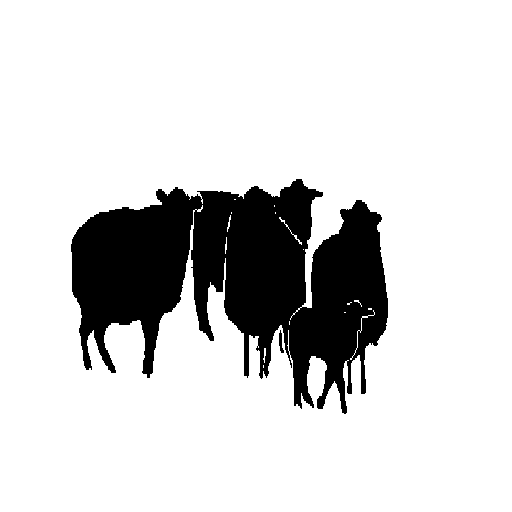

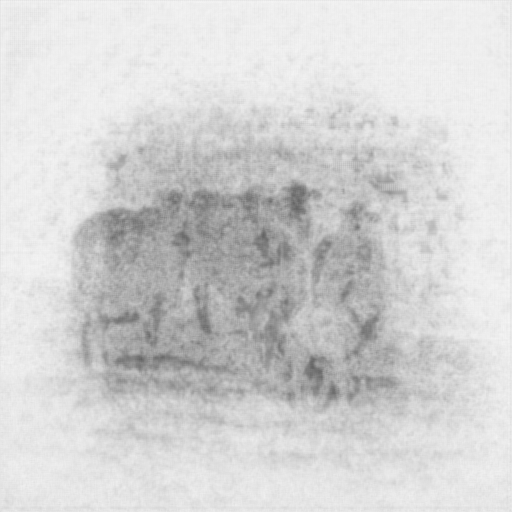

409 4801
410 4802
411 4803
412 4804
413 4805
414 4806
415 4807
416 4808
417 4809
418 4810
419 4811
420 4812
421 4813
422 4814
423 4815
424 4816
425 4817
426 4818
427 4819
428 4820
429 4821
430 4822
431 4823
432 4824
433 4825
434 4826
435 4827
436 4828
437 4829
438 4830
439 4831
440 4832
441 4833
442 4834
443 4835
444 4836
445 4837
446 4838
447 4839
448 4840
449 4841
450 4842
451 4843
452 4844
453 4845
454 4846
455 4847
456 4848
457 4849
458 4850
459 4851
460 4852
461 4853
462 4854
463 4855
464 4856
465 4857
466 4858
467 4859
468 4860
469 4861
470 4862
471 4863
472 4864
473 4865
474 4866
475 4867
476 4868
477 4869
478 4870
479 4871
480 4872
481 4873
482 4874
483 4875
484 4876
485 4877
486 4878
487 4879
488 4880
489 4881
490 4882
491 4883
492 4884
493 4885
494 4886
495 4887
496 4888
497 4889
498 4890
499 4891
500 4892
501 4893
502 4894
503 4895
504 4896
505 4897
506 4898
507 4899
508 4900
2010_001413


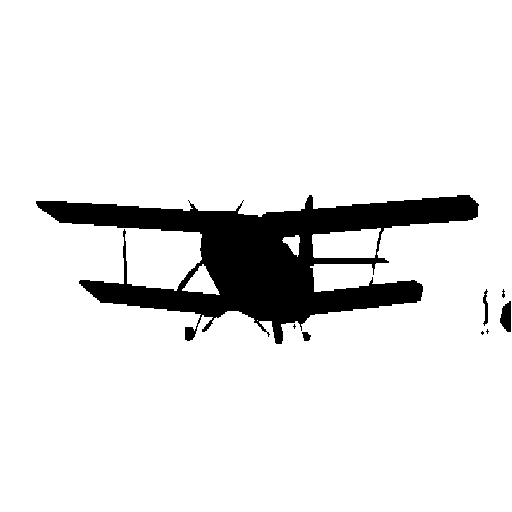

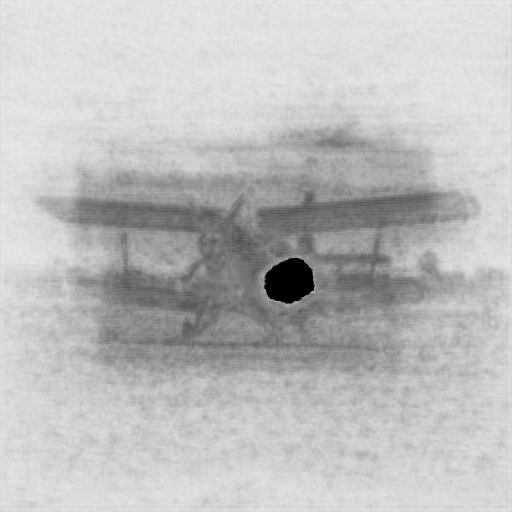

509 4901
510 4902
511 4903
512 4904
513 4905
514 4906
515 4907
516 4908
517 4909
518 4910
519 4911
520 4912
521 4913
522 4914
523 4915
524 4916
525 4917
526 4918
527 4919
528 4920
529 4921
530 4922
531 4923
532 4924
533 4925
534 4926
535 4927
536 4928
537 4929
538 4930
539 4931
540 4932
541 4933
542 4934
543 4935
544 4936
545 4937
546 4938
547 4939
548 4940
549 4941
550 4942
551 4943
552 4944
553 4945
554 4946
555 4947
556 4948
557 4949
558 4950
559 4951
560 4952
561 4953
562 4954
563 4955
564 4956
565 4957
566 4958
567 4959
568 4960
569 4961
570 4962
571 4963
572 4964
573 4965
574 4966
575 4967
576 4968
577 4969
578 4970
579 4971
580 4972
581 4973
582 4974
583 4975
584 4976
585 4977
586 4978
587 4979
588 4980
589 4981
590 4982
591 4983
592 4984
593 4985
594 4986
595 4987
596 4988
597 4989
598 4990
599 4991
600 4992
601 4993
602 4994
603 4995
604 4996
605 4997
606 4998
607 4999
608 5000
2010_005223


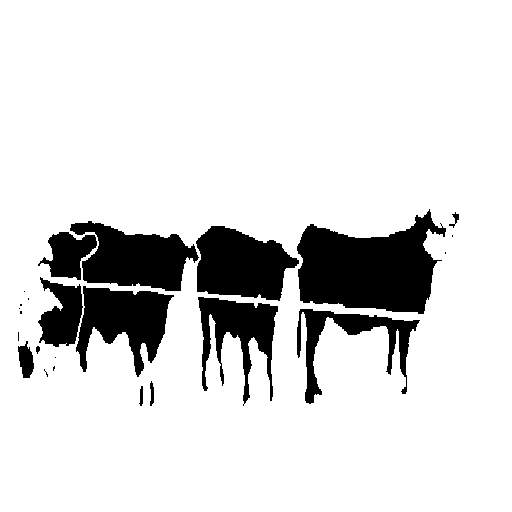

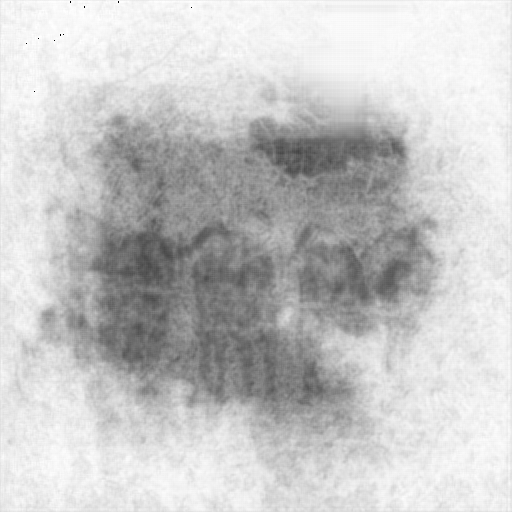

609 5001
610 5002
611 5003
612 5004
613 5005
614 5006
615 5007
616 5008
617 5009
618 5010
619 5011
620 5012
621 5013
622 5014
623 5015
624 5016
625 5017
626 5018
627 5019
628 5020
629 5021
630 5022
631 5023
632 5024
633 5025
634 5026
635 5027
636 5028
637 5029
638 5030
639 5031
640 5032
641 5033
642 5034
643 5035
644 5036
645 5037
646 5038
647 5039
648 5040
649 5041
650 5042
651 5043
652 5044
653 5045
654 5046
655 5047
656 5048
657 5049
658 5050
659 5051
660 5052
661 5053
662 5054
663 5055
664 5056
665 5057
666 5058
667 5059
668 5060
669 5061
670 5062
671 5063
672 5064
673 5065
674 5066
675 5067
676 5068
677 5069
678 5070
679 5071
680 5072
681 5073
682 5074
683 5075
684 5076
685 5077
686 5078
687 5079
688 5080
689 5081
690 5082
691 5083
692 5084
693 5085
694 5086
695 5087
696 5088
697 5089
698 5090
699 5091
700 5092
701 5093
702 5094
703 5095
704 5096
705 5097
706 5098
707 5099
708 5100
2011_002385


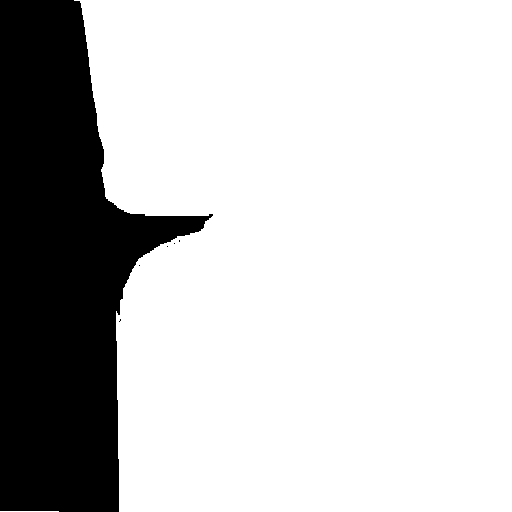

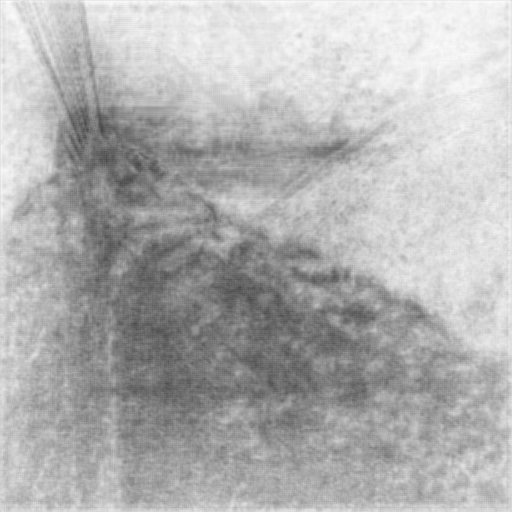

709 5101
710 5102
711 5103
712 5104
713 5105
714 5106
715 5107
716 5108
717 5109
718 5110
719 5111
720 5112
721 5113
722 5114
723 5115
724 5116
725 5117
726 5118
727 5119
728 5120
729 5121
730 5122
731 5123
0 5124
1 5125
2 5126
3 5127
4 5128
5 5129
6 5130
7 5131
8 5132
9 5133
10 5134
11 5135
12 5136
13 5137
14 5138
15 5139
16 5140
17 5141
18 5142
19 5143
20 5144
21 5145
22 5146
23 5147
24 5148
25 5149
26 5150
27 5151
28 5152
29 5153
30 5154
31 5155
32 5156
33 5157
34 5158
35 5159
36 5160
37 5161
38 5162
39 5163
40 5164
41 5165
42 5166
43 5167
44 5168
45 5169
46 5170
47 5171
48 5172
49 5173
50 5174
51 5175
52 5176
53 5177
54 5178
55 5179
56 5180
57 5181
58 5182
59 5183
60 5184
61 5185
62 5186
63 5187
64 5188
65 5189
66 5190
67 5191
68 5192
69 5193
70 5194
71 5195
72 5196
73 5197
74 5198
75 5199
76 5200
2007_005086


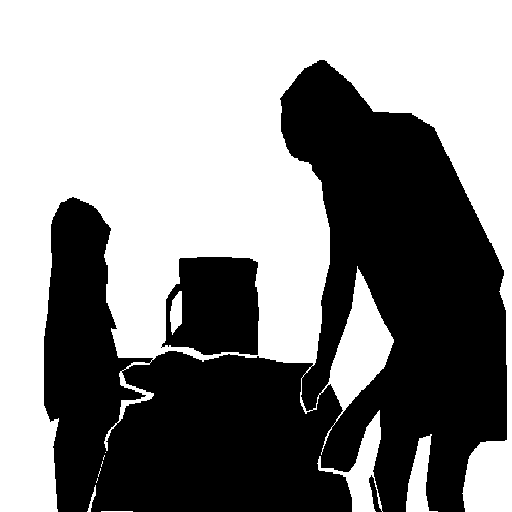

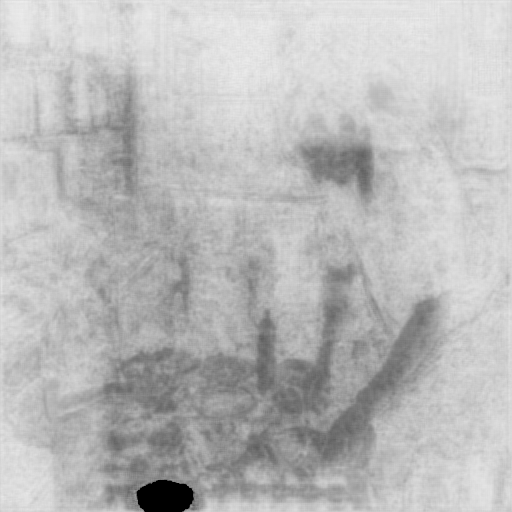

77 5201
78 5202
79 5203
80 5204
81 5205
82 5206
83 5207
84 5208
85 5209
86 5210
87 5211
88 5212
89 5213
90 5214
91 5215
92 5216
93 5217
94 5218
95 5219
96 5220
97 5221
98 5222
99 5223
100 5224
101 5225
102 5226
103 5227
104 5228
105 5229
106 5230
107 5231
108 5232
109 5233
110 5234
111 5235
112 5236
113 5237
114 5238
115 5239
116 5240
117 5241
118 5242
119 5243
120 5244
121 5245
122 5246
123 5247
124 5248
125 5249
126 5250
127 5251
128 5252
129 5253
130 5254
131 5255
132 5256
133 5257
134 5258
135 5259
136 5260
137 5261
138 5262
139 5263
140 5264
141 5265
142 5266
143 5267
144 5268
145 5269
146 5270
147 5271
148 5272
149 5273
150 5274
151 5275
152 5276
153 5277
154 5278
155 5279
156 5280
157 5281
158 5282
159 5283
160 5284
161 5285
162 5286
163 5287
164 5288
165 5289
166 5290
167 5291
168 5292
169 5293
170 5294
171 5295
172 5296
173 5297
174 5298
175 5299
176 5300
2008_000540


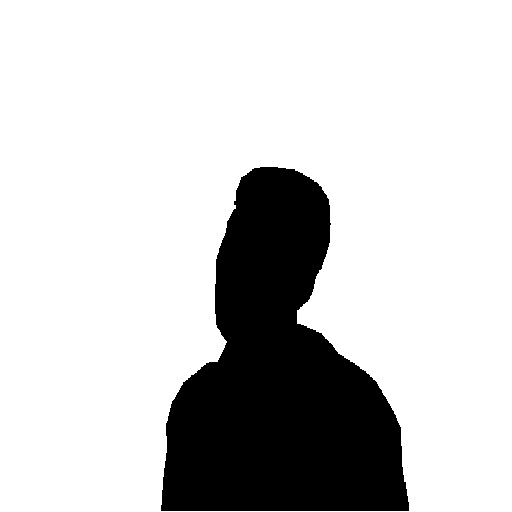

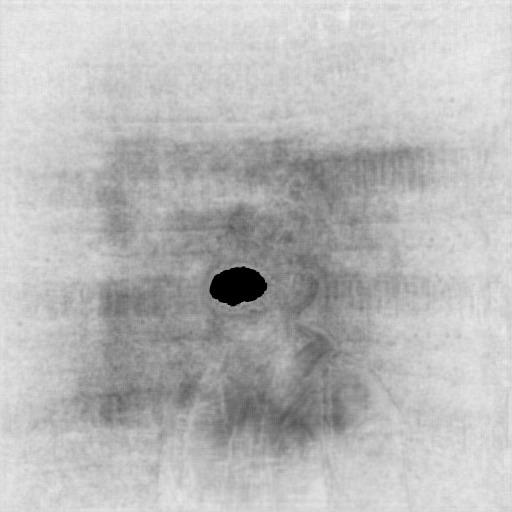

177 5301
178 5302
179 5303
180 5304
181 5305
182 5306
183 5307
184 5308
185 5309
186 5310
187 5311
188 5312
189 5313
190 5314
191 5315
192 5316
193 5317
194 5318
195 5319
196 5320
197 5321
198 5322
199 5323
200 5324
201 5325
202 5326
203 5327
204 5328
205 5329
206 5330
207 5331
208 5332
209 5333
210 5334
211 5335
212 5336
213 5337
214 5338
215 5339
216 5340
217 5341
218 5342
219 5343
220 5344
221 5345
222 5346
223 5347
224 5348
225 5349
226 5350
227 5351
228 5352
229 5353
230 5354
231 5355
232 5356
233 5357
234 5358
235 5359
236 5360
237 5361
238 5362
239 5363
240 5364
241 5365
242 5366
243 5367
244 5368
245 5369
246 5370
247 5371
248 5372
249 5373
250 5374
251 5375
252 5376
253 5377
254 5378
255 5379
256 5380
257 5381
258 5382
259 5383
260 5384
261 5385
262 5386
263 5387
264 5388
265 5389
266 5390
267 5391
268 5392
269 5393
270 5394
271 5395
272 5396
273 5397
274 5398
275 5399
276 5400
2008_005600


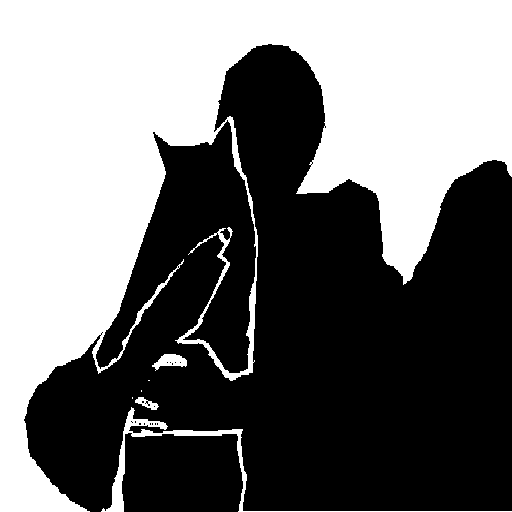

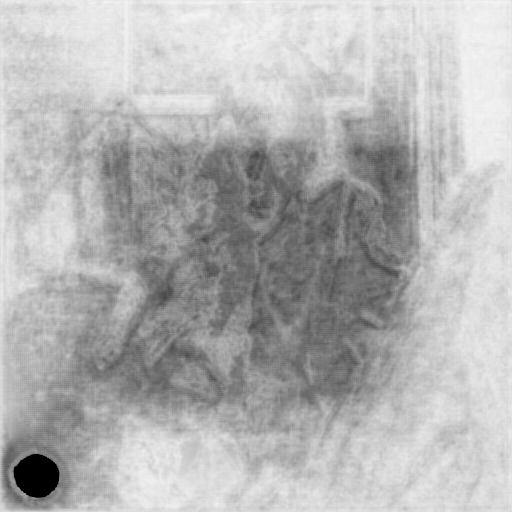

277 5401
278 5402
279 5403
280 5404
281 5405
282 5406
283 5407
284 5408
285 5409
286 5410
287 5411
288 5412
289 5413
290 5414
291 5415
292 5416
293 5417
294 5418
295 5419
296 5420
297 5421
298 5422
299 5423
300 5424
301 5425
302 5426
303 5427
304 5428
305 5429
306 5430
307 5431
308 5432
309 5433
310 5434
311 5435
312 5436
313 5437
314 5438
315 5439
316 5440
317 5441
318 5442
319 5443
320 5444
321 5445
322 5446
323 5447
324 5448
325 5449
326 5450
327 5451
328 5452
329 5453
330 5454
331 5455
332 5456
333 5457
334 5458
335 5459
336 5460
337 5461
338 5462
339 5463
340 5464
341 5465
342 5466
343 5467
344 5468
345 5469
346 5470
347 5471
348 5472
349 5473
350 5474
351 5475
352 5476
353 5477
354 5478
355 5479
356 5480
357 5481
358 5482
359 5483
360 5484
361 5485
362 5486
363 5487
364 5488
365 5489
366 5490
367 5491
368 5492
369 5493
370 5494
371 5495
372 5496
373 5497
374 5498
375 5499
376 5500
2009_001937


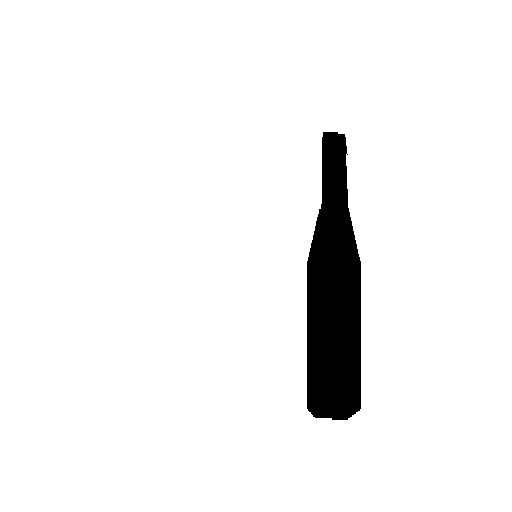

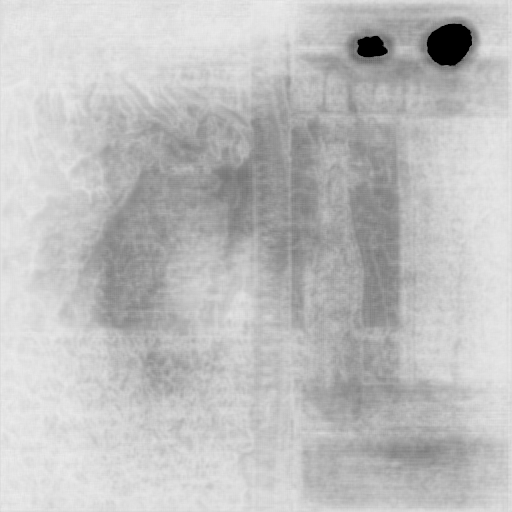

377 5501
378 5502
379 5503
380 5504
381 5505
382 5506
383 5507
384 5508
385 5509
386 5510
387 5511
388 5512
389 5513
390 5514
391 5515
392 5516
393 5517
394 5518
395 5519
396 5520
397 5521
398 5522
399 5523
400 5524
401 5525
402 5526
403 5527
404 5528
405 5529
406 5530
407 5531
408 5532
409 5533
410 5534
411 5535
412 5536
413 5537
414 5538
415 5539
416 5540
417 5541
418 5542
419 5543
420 5544
421 5545
422 5546
423 5547
424 5548
425 5549
426 5550
427 5551
428 5552
429 5553
430 5554
431 5555
432 5556
433 5557
434 5558
435 5559
436 5560
437 5561
438 5562
439 5563
440 5564
441 5565
442 5566
443 5567
444 5568
445 5569
446 5570
447 5571
448 5572
449 5573
450 5574
451 5575
452 5576
453 5577
454 5578
455 5579
456 5580
457 5581
458 5582
459 5583
460 5584
461 5585
462 5586
463 5587
464 5588
465 5589
466 5590
467 5591
468 5592
469 5593
470 5594
471 5595
472 5596
473 5597
474 5598
475 5599
476 5600
2010_000002


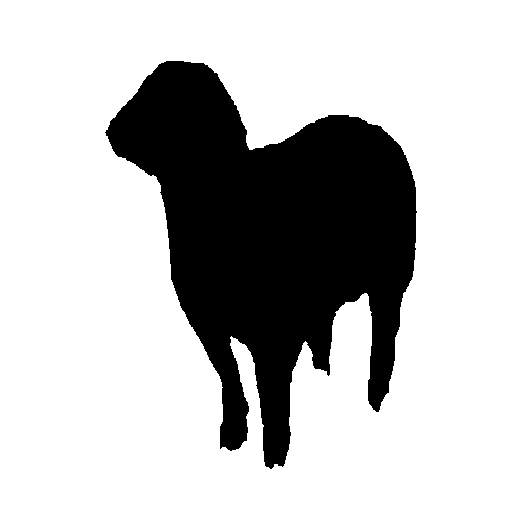

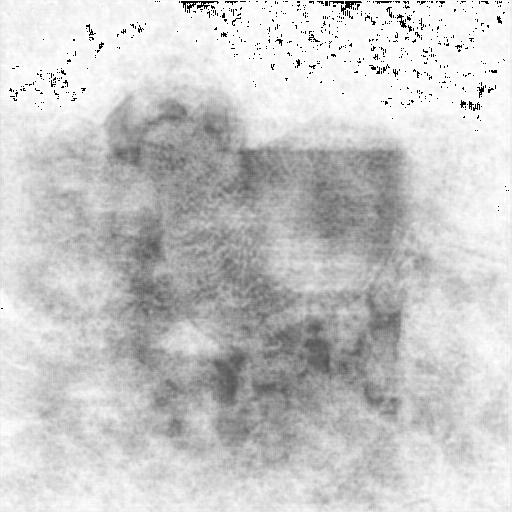

477 5601
478 5602
479 5603
480 5604
481 5605
482 5606
483 5607
484 5608
485 5609
486 5610
487 5611
488 5612
489 5613
490 5614
491 5615
492 5616
493 5617
494 5618
495 5619
496 5620
497 5621
498 5622
499 5623
500 5624
501 5625
502 5626
503 5627
504 5628
505 5629
506 5630
507 5631
508 5632
509 5633
510 5634
511 5635
512 5636
513 5637
514 5638
515 5639
516 5640
517 5641
518 5642
519 5643
520 5644
521 5645
522 5646
523 5647
524 5648
525 5649
526 5650
527 5651
528 5652
529 5653
530 5654
531 5655
532 5656
533 5657
534 5658
535 5659
536 5660
537 5661
538 5662
539 5663
540 5664
541 5665
542 5666
543 5667
544 5668
545 5669
546 5670
547 5671
548 5672
549 5673
550 5674
551 5675
552 5676
553 5677
554 5678
555 5679
556 5680
557 5681
558 5682
559 5683
560 5684
561 5685
562 5686
563 5687
564 5688
565 5689
566 5690
567 5691
568 5692
569 5693
570 5694
571 5695
572 5696
573 5697
574 5698
575 5699
576 5700
2010_004071


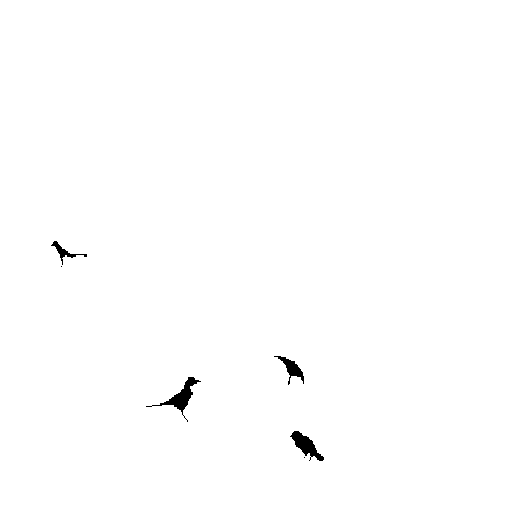

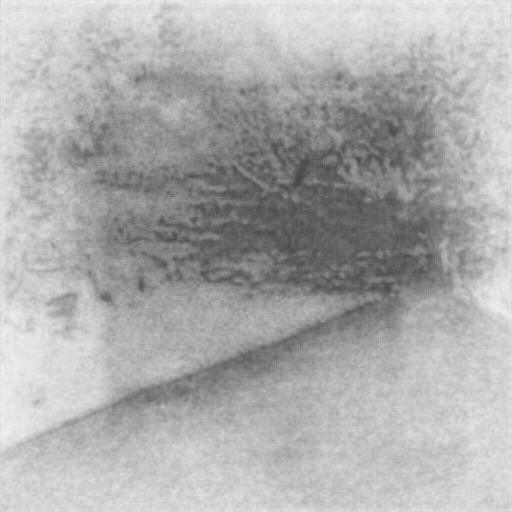

577 5701
578 5702
579 5703
580 5704
581 5705
582 5706
583 5707
584 5708
585 5709
586 5710
587 5711
588 5712
589 5713
590 5714
591 5715
592 5716
593 5717
594 5718
595 5719
596 5720
597 5721
598 5722
599 5723
600 5724
601 5725
602 5726
603 5727
604 5728
605 5729
606 5730
607 5731
608 5732
609 5733
610 5734
611 5735
612 5736
613 5737
614 5738
615 5739
616 5740
617 5741
618 5742
619 5743
620 5744
621 5745
622 5746
623 5747
624 5748
625 5749
626 5750
627 5751
628 5752
629 5753
630 5754
631 5755
632 5756
633 5757
634 5758
635 5759
636 5760
637 5761
638 5762
639 5763
640 5764
641 5765
642 5766
643 5767
644 5768
645 5769
646 5770
647 5771
648 5772
649 5773
650 5774
651 5775
652 5776
653 5777
654 5778
655 5779
656 5780
657 5781
658 5782
659 5783
660 5784
661 5785
662 5786
663 5787
664 5788
665 5789
666 5790
667 5791
668 5792
669 5793
670 5794
671 5795
672 5796
673 5797
674 5798
675 5799
676 5800
2011_001211


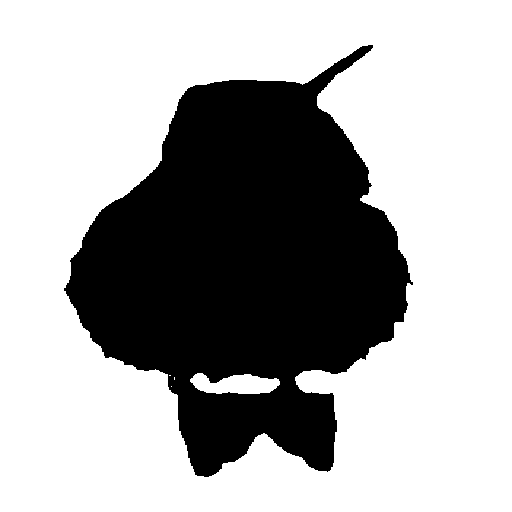

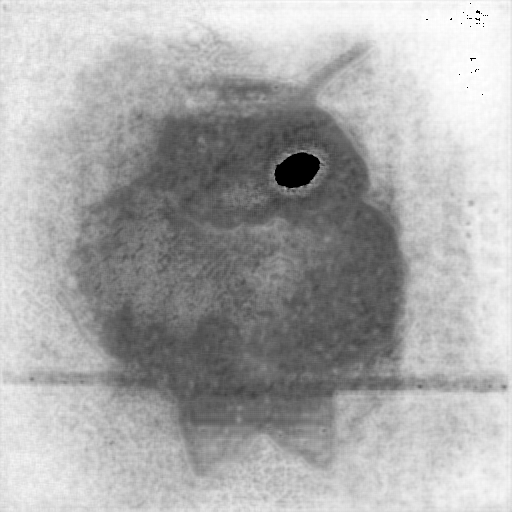

677 5801
678 5802
679 5803
680 5804
681 5805
682 5806
683 5807
684 5808
685 5809
686 5810
687 5811
688 5812
689 5813
690 5814
691 5815
692 5816
693 5817
694 5818
695 5819
696 5820
697 5821
698 5822
699 5823
700 5824
701 5825
702 5826
703 5827
704 5828
705 5829
706 5830
707 5831
708 5832
709 5833
710 5834
711 5835
712 5836
713 5837
714 5838
715 5839
716 5840
717 5841
718 5842
719 5843
720 5844
721 5845
722 5846
723 5847
724 5848
725 5849
726 5850
727 5851
728 5852
729 5853
730 5854
731 5855
0 5856
1 5857
2 5858
3 5859
4 5860
5 5861
6 5862
7 5863
8 5864
9 5865
10 5866
11 5867
12 5868
13 5869
14 5870
15 5871
16 5872
17 5873
22 5878
23 5879
24 5880
25 5881
26 5882
27 5883
28 5884
29 5885
30 5886
31 5887
32 5888
33 5889
34 5890
35 5891
36 5892
37 5893
38 5894
39 5895
40 5896
41 5897
42 5898
43 5899
44 5900
2007_002895


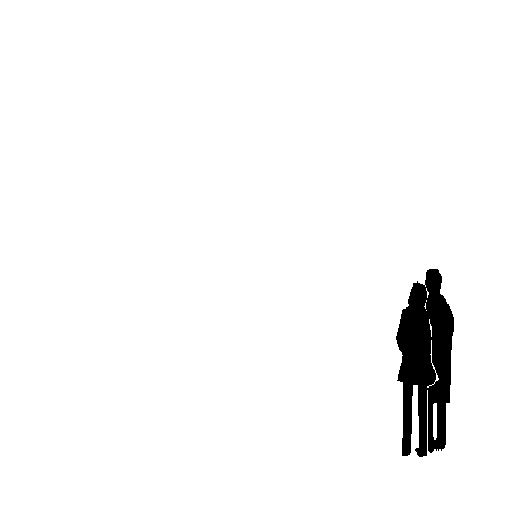

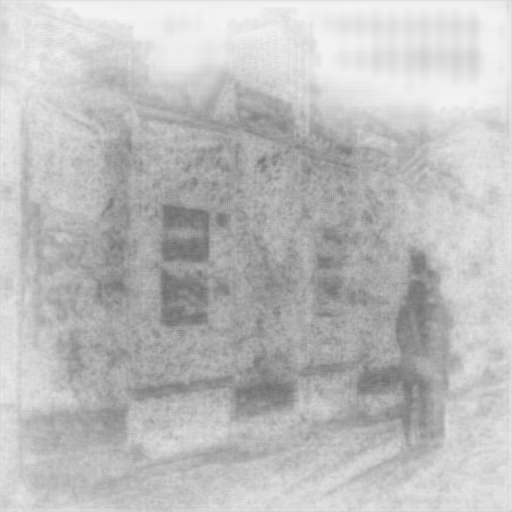

45 5901
46 5902
47 5903
48 5904
49 5905
50 5906
51 5907
52 5908
53 5909
54 5910
55 5911
56 5912
57 5913
58 5914
59 5915
60 5916
61 5917
62 5918
63 5919
64 5920
65 5921
66 5922
67 5923
68 5924
69 5925
70 5926
71 5927
72 5928
73 5929
74 5930
75 5931
76 5932
77 5933
78 5934
79 5935
80 5936
81 5937
82 5938
83 5939
84 5940
85 5941
86 5942
87 5943
88 5944
89 5945
90 5946
91 5947
92 5948
93 5949
94 5950
95 5951
96 5952
97 5953
98 5954
99 5955
100 5956
101 5957
102 5958
103 5959
104 5960
105 5961
106 5962
107 5963
108 5964
109 5965
110 5966
111 5967
112 5968
113 5969
114 5970
115 5971
116 5972
117 5973
118 5974
119 5975
120 5976
121 5977
122 5978
123 5979
124 5980
125 5981
126 5982
127 5983
128 5984
129 5985
130 5986
131 5987
132 5988
133 5989
134 5990
135 5991
136 5992
137 5993
138 5994
139 5995
140 5996
141 5997
142 5998
143 5999
144 6000
2007_009550


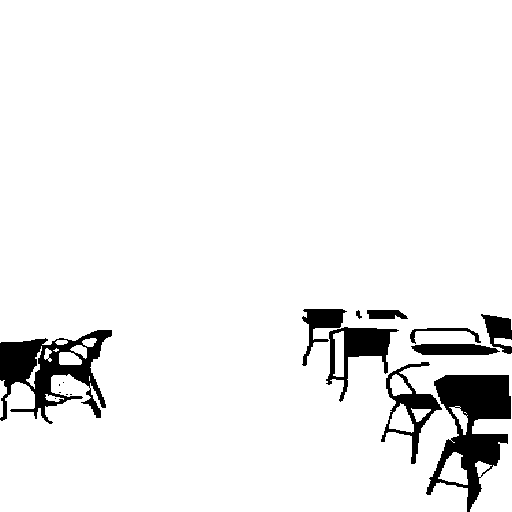

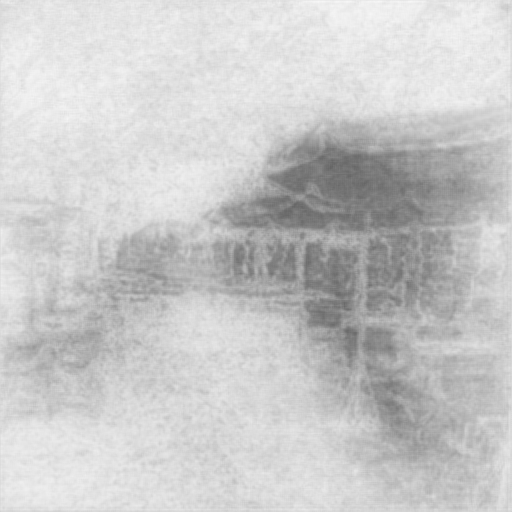

145 6001
146 6002
147 6003
148 6004
149 6005
150 6006
151 6007
152 6008
153 6009
154 6010
155 6011
156 6012
157 6013
158 6014
159 6015
160 6016
161 6017
162 6018
163 6019
164 6020
165 6021
166 6022
167 6023
168 6024
169 6025
170 6026
171 6027
172 6028
173 6029
174 6030
175 6031
176 6032
177 6033
178 6034
179 6035
180 6036
181 6037
182 6038
183 6039
184 6040
185 6041
186 6042
187 6043
188 6044
189 6045
190 6046
191 6047
192 6048
193 6049
194 6050
195 6051
196 6052
197 6053
198 6054
199 6055
200 6056
201 6057
202 6058
203 6059
204 6060
205 6061
206 6062
207 6063
208 6064
209 6065
210 6066
211 6067
212 6068
213 6069
214 6070
215 6071
216 6072
217 6073
218 6074
219 6075
220 6076
221 6077
222 6078
223 6079
224 6080
225 6081
226 6082
227 6083
228 6084
229 6085
230 6086
231 6087
232 6088
233 6089
234 6090
235 6091
236 6092
237 6093
238 6094
239 6095
240 6096
241 6097
242 6098
243 6099
244 6100
2008_003480


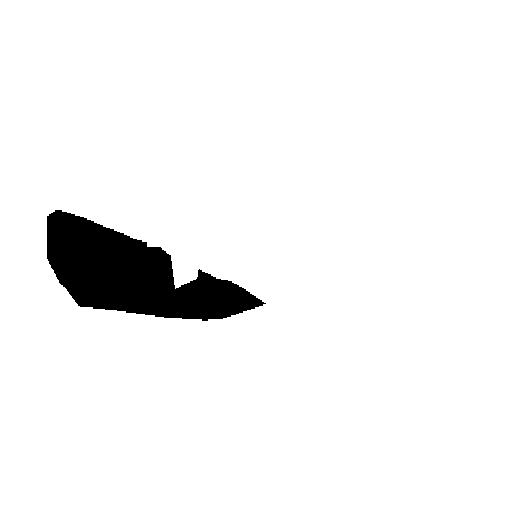

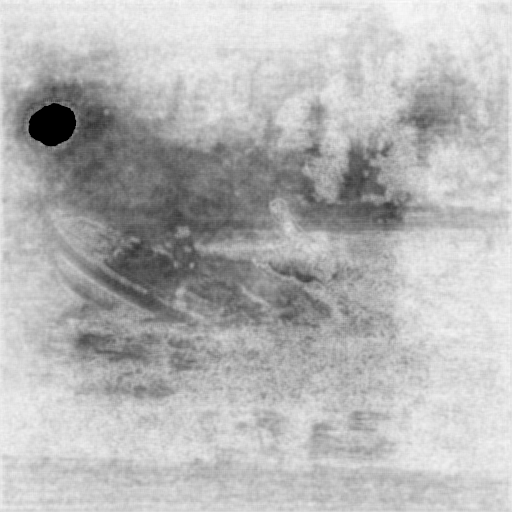

245 6101
246 6102
247 6103
248 6104
249 6105
250 6106
251 6107
252 6108
253 6109
254 6110
255 6111
256 6112
257 6113
258 6114
259 6115
260 6116
261 6117
262 6118
263 6119
264 6120
265 6121
266 6122
267 6123
268 6124
269 6125
270 6126
271 6127
272 6128
273 6129
274 6130
275 6131
276 6132
277 6133
278 6134
279 6135
280 6136
281 6137
282 6138
283 6139
284 6140
285 6141
286 6142
287 6143
288 6144
289 6145
290 6146
291 6147
292 6148
293 6149
294 6150
295 6151
296 6152
297 6153
298 6154
299 6155
300 6156
301 6157
302 6158
303 6159
304 6160
305 6161
306 6162
307 6163
308 6164
309 6165
310 6166
311 6167
312 6168
313 6169
314 6170
315 6171
316 6172
317 6173
318 6174
319 6175
320 6176
321 6177
322 6178
323 6179
324 6180
325 6181
326 6182
327 6183
328 6184
329 6185
330 6186
331 6187
332 6188
333 6189
334 6190
335 6191
336 6192
337 6193
338 6194
339 6195
340 6196
341 6197
342 6198
343 6199
344 6200
2009_001027


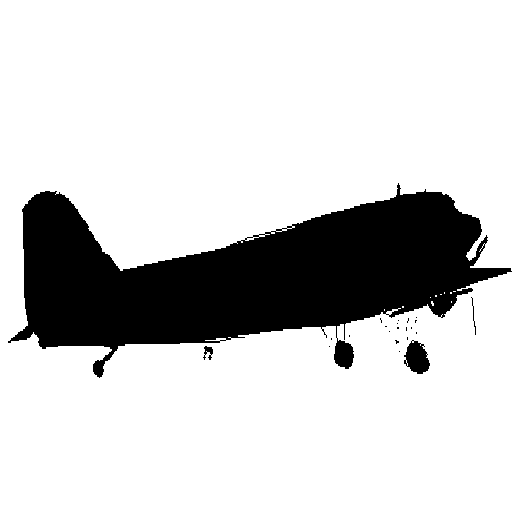

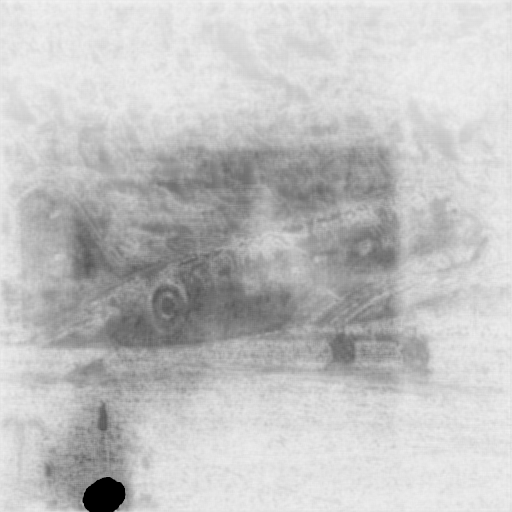

345 6201
346 6202
347 6203
348 6204
349 6205
350 6206
351 6207
352 6208
353 6209
354 6210
355 6211
356 6212
357 6213
358 6214
359 6215
360 6216
361 6217
362 6218
363 6219
364 6220
365 6221
366 6222
367 6223
368 6224
369 6225
370 6226
371 6227
372 6228
373 6229
374 6230
375 6231
376 6232
377 6233
378 6234
379 6235
380 6236
381 6237
382 6238
383 6239
384 6240
385 6241
386 6242
387 6243
388 6244
389 6245
390 6246
391 6247
392 6248
393 6249
394 6250
395 6251
396 6252
397 6253
398 6254
399 6255
400 6256
401 6257
402 6258
403 6259
404 6260
405 6261
406 6262
407 6263
408 6264
409 6265
410 6266
411 6267
412 6268
413 6269
414 6270
415 6271
416 6272
417 6273
418 6274
419 6275
420 6276
421 6277
422 6278
423 6279
424 6280
425 6281
426 6282
427 6283
428 6284
429 6285
430 6286
431 6287
432 6288
433 6289
434 6290
435 6291
436 6292
437 6293
438 6294
439 6295
440 6296
441 6297
442 6298
443 6299
444 6300
2009_004278


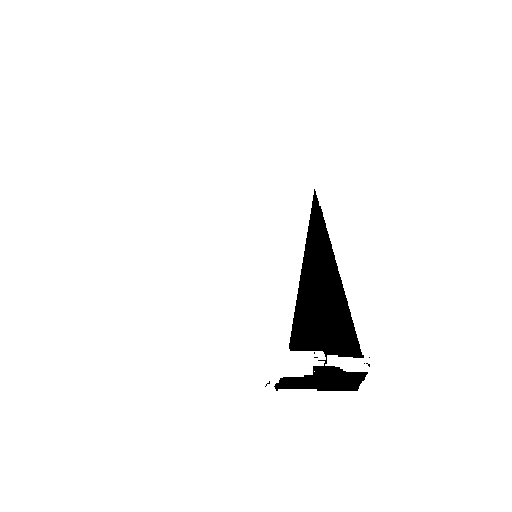

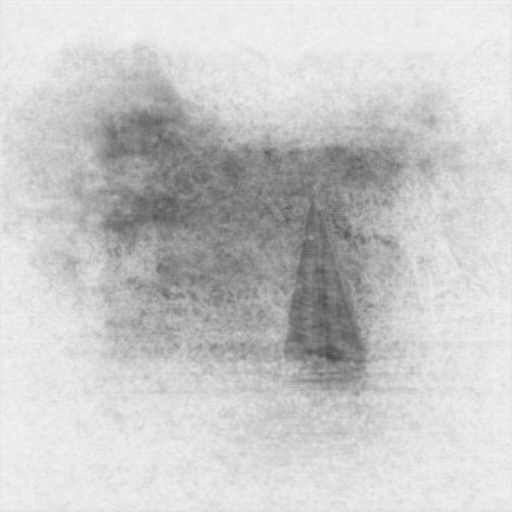

445 6301
446 6302
447 6303
448 6304
449 6305
450 6306
451 6307
452 6308
453 6309
454 6310
455 6311
456 6312
457 6313
458 6314
459 6315
460 6316
461 6317
462 6318
463 6319
464 6320
465 6321
466 6322
467 6323
468 6324
469 6325
470 6326
471 6327
472 6328
473 6329
474 6330
475 6331
476 6332
477 6333
478 6334
479 6335
480 6336
481 6337
482 6338
483 6339
484 6340
485 6341
486 6342
487 6343
488 6344
489 6345
490 6346
491 6347
492 6348
493 6349
494 6350
495 6351
496 6352
497 6353
498 6354
499 6355
500 6356
501 6357
502 6358
503 6359
504 6360
505 6361
506 6362
507 6363
508 6364
509 6365
510 6366
511 6367
512 6368
513 6369
514 6370
515 6371
516 6372
517 6373
518 6374
519 6375
520 6376
521 6377
522 6378
523 6379
524 6380
525 6381
526 6382
527 6383
528 6384
529 6385
530 6386
531 6387
532 6388
533 6389
534 6390
535 6391
536 6392
537 6393
538 6394
539 6395
540 6396
541 6397
542 6398
543 6399
544 6400
2010_002786


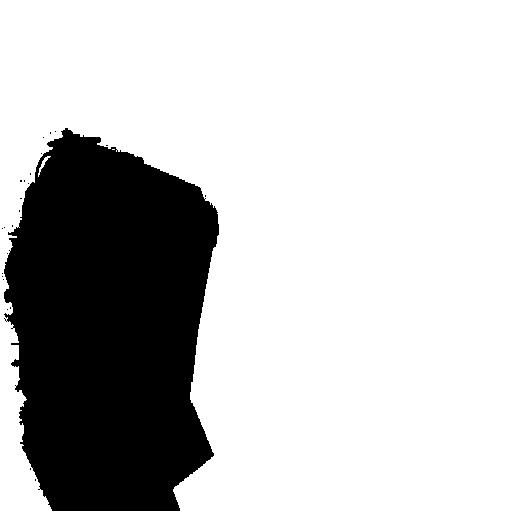

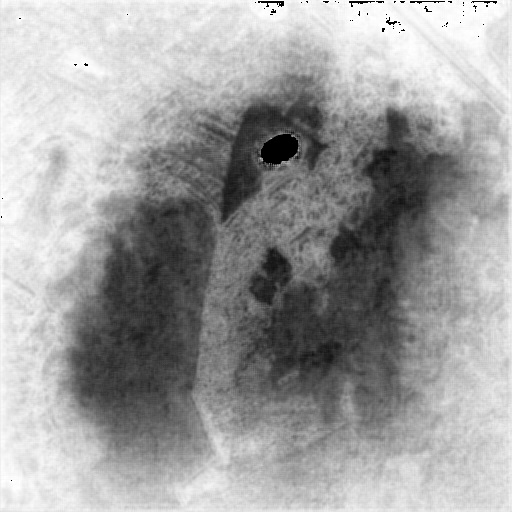

545 6401
546 6402
547 6403
548 6404
549 6405
550 6406
551 6407
552 6408
553 6409
554 6410
555 6411
556 6412
557 6413
558 6414
559 6415
560 6416
561 6417
562 6418
563 6419
564 6420
565 6421
566 6422
567 6423
568 6424
569 6425
570 6426
571 6427
572 6428
573 6429
574 6430
575 6431
576 6432
577 6433
578 6434
579 6435
580 6436
581 6437
582 6438
583 6439
584 6440
585 6441
586 6442
587 6443
588 6444
589 6445
590 6446
591 6447
592 6448
593 6449
594 6450
595 6451
596 6452
597 6453
598 6454
599 6455
600 6456
601 6457
602 6458
603 6459
604 6460
605 6461
606 6462
607 6463
608 6464
609 6465
610 6466
611 6467
612 6468
613 6469
614 6470
615 6471
616 6472
617 6473
618 6474
619 6475
620 6476
621 6477
622 6478
623 6479
624 6480
625 6481
626 6482
627 6483
628 6484
629 6485
630 6486
631 6487
632 6488
633 6489
634 6490
635 6491
636 6492
637 6493
638 6494
639 6495
640 6496
641 6497
642 6498
643 6499
644 6500
2011_000219


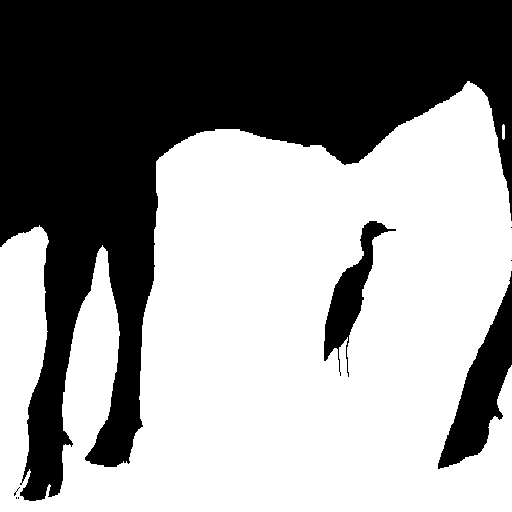

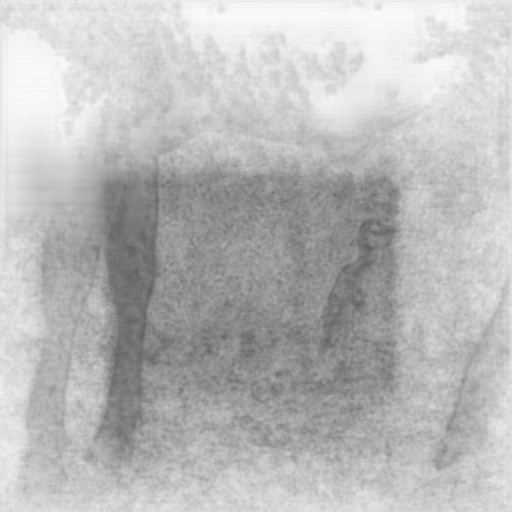

645 6501
646 6502
647 6503
648 6504
649 6505
650 6506
651 6507
652 6508
653 6509
654 6510
655 6511
656 6512
657 6513
658 6514
659 6515
660 6516
661 6517
662 6518
663 6519
664 6520
665 6521
666 6522
667 6523
668 6524
669 6525
670 6526
671 6527
672 6528
673 6529
674 6530
675 6531
676 6532
677 6533
678 6534
679 6535
680 6536
681 6537
682 6538
683 6539
684 6540
685 6541
686 6542
687 6543
688 6544
689 6545
690 6546
691 6547
692 6548
693 6549
694 6550
695 6551
696 6552
697 6553
698 6554
699 6555
700 6556
701 6557
702 6558
703 6559
704 6560
705 6561
706 6562
707 6563
708 6564
709 6565
710 6566
711 6567
712 6568
713 6569
714 6570
715 6571
716 6572
717 6573
718 6574
719 6575
720 6576
721 6577
722 6578
723 6579
724 6580
725 6581
726 6582
727 6583
728 6584
729 6585
730 6586
731 6587
0 6588
1 6589
2 6590
3 6591
4 6592
5 6593
6 6594
7 6595
8 6596
9 6597
10 6598
11 6599
12 6600
2007_000733


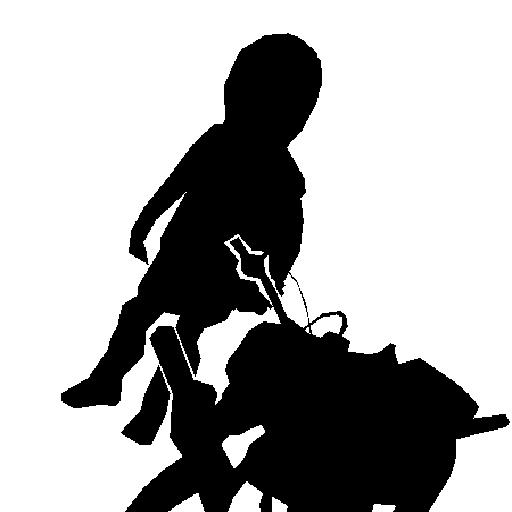

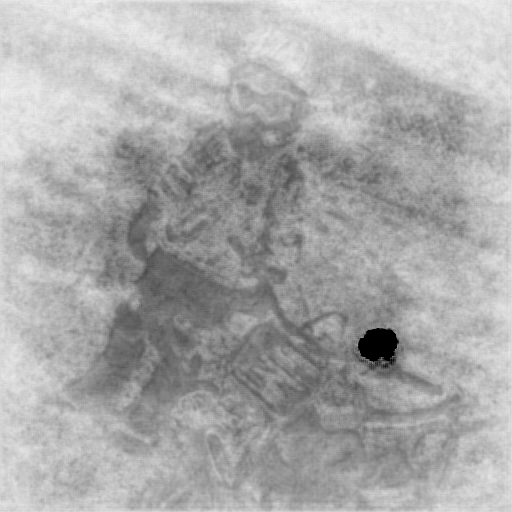

13 6601
14 6602
15 6603
16 6604
17 6605
18 6606
19 6607
20 6608
21 6609
22 6610
23 6611
24 6612
25 6613
26 6614
27 6615
28 6616
29 6617
30 6618
31 6619
32 6620
33 6621
34 6622
35 6623
36 6624
37 6625
38 6626
39 6627
40 6628
41 6629
42 6630
43 6631
44 6632
45 6633
46 6634
47 6635
48 6636
49 6637
50 6638
51 6639
52 6640
53 6641
54 6642
55 6643
56 6644
57 6645
58 6646
59 6647
60 6648
61 6649
62 6650
63 6651
64 6652
65 6653
66 6654
67 6655
68 6656
69 6657
70 6658
71 6659
72 6660
73 6661
74 6662
75 6663
76 6664
77 6665
78 6666
79 6667
80 6668
81 6669
82 6670
83 6671
84 6672
85 6673
86 6674
87 6675
88 6676
89 6677
90 6678
91 6679
92 6680
93 6681
94 6682
95 6683
96 6684
97 6685
98 6686
99 6687
100 6688
101 6689
102 6690
103 6691
104 6692
105 6693
106 6694
107 6695
108 6696
109 6697
110 6698
111 6699
112 6700
2007_007432


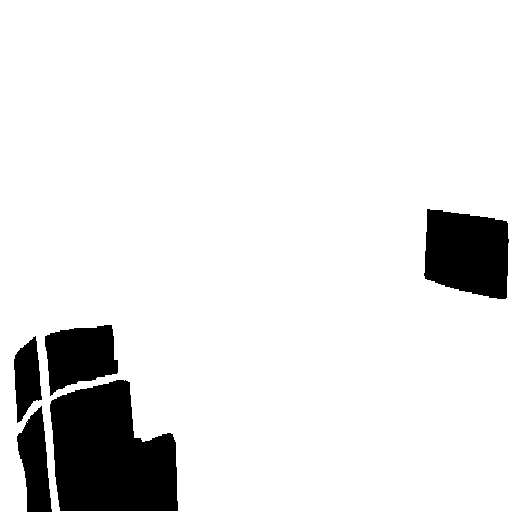

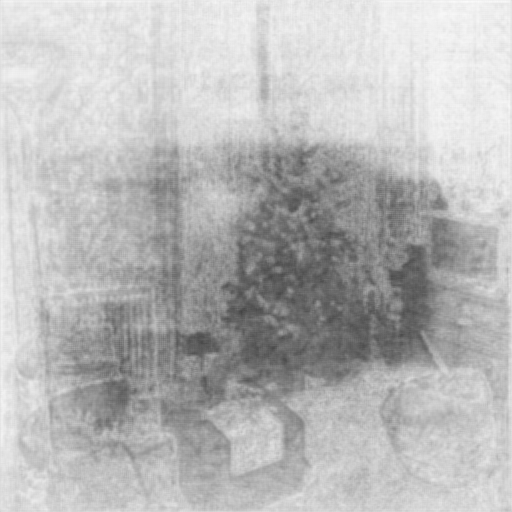

113 6701
114 6702
115 6703
116 6704
117 6705
118 6706
119 6707
120 6708
121 6709
122 6710
123 6711
124 6712
125 6713
126 6714
127 6715
128 6716
129 6717
130 6718
131 6719
132 6720
133 6721
134 6722
135 6723
136 6724
137 6725
138 6726
139 6727
140 6728
141 6729
142 6730
143 6731
144 6732
145 6733
146 6734
147 6735
148 6736
149 6737
150 6738
151 6739
152 6740
153 6741
154 6742
155 6743
156 6744
157 6745
158 6746
159 6747
160 6748
161 6749
162 6750
163 6751
164 6752
165 6753
166 6754
167 6755
168 6756
169 6757
170 6758
171 6759
172 6760
173 6761
174 6762
175 6763
176 6764
177 6765
178 6766
179 6767
180 6768
181 6769
182 6770
183 6771
184 6772
185 6773
186 6774
187 6775
188 6776
189 6777
190 6778
191 6779
192 6780
193 6781
194 6782
195 6783
196 6784
197 6785
198 6786
199 6787
200 6788
201 6789
202 6790
203 6791
204 6792
205 6793
206 6794
207 6795
208 6796
209 6797
210 6798
211 6799
212 6800
2008_002032


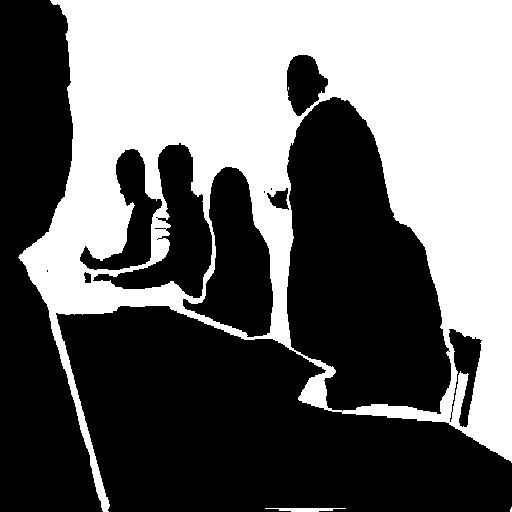

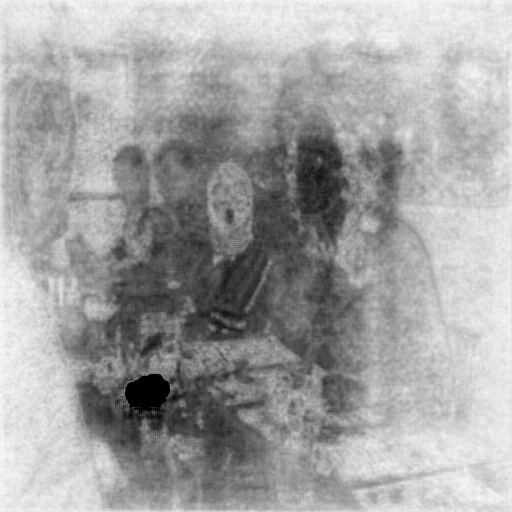

213 6801
214 6802
215 6803
216 6804
217 6805
218 6806
219 6807
220 6808
221 6809
222 6810
223 6811
224 6812
225 6813
226 6814
227 6815
228 6816
229 6817
230 6818
231 6819
232 6820
233 6821
234 6822
235 6823
236 6824
237 6825
238 6826
239 6827
240 6828
241 6829
242 6830
243 6831
244 6832
245 6833
246 6834
247 6835
248 6836
249 6837
250 6838
251 6839
252 6840
253 6841
254 6842
255 6843
256 6844
257 6845
258 6846
259 6847
260 6848
261 6849
262 6850
263 6851
264 6852
265 6853
266 6854
267 6855
268 6856
269 6857
270 6858
271 6859
272 6860
273 6861
274 6862
275 6863
276 6864
277 6865
278 6866
279 6867
280 6868
281 6869
282 6870
283 6871
284 6872
285 6873
286 6874
287 6875
288 6876
289 6877
290 6878
291 6879
292 6880
293 6881
294 6882
295 6883
296 6884
297 6885
298 6886
299 6887
300 6888
301 6889
302 6890
303 6891
304 6892
305 6893
306 6894
307 6895
308 6896
309 6897
310 6898
311 6899
312 6900
2008_008323


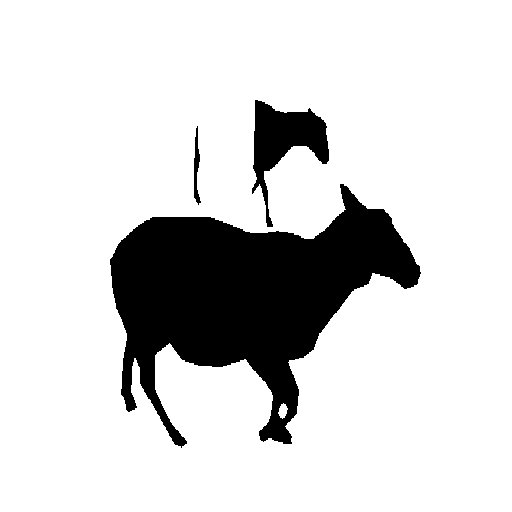

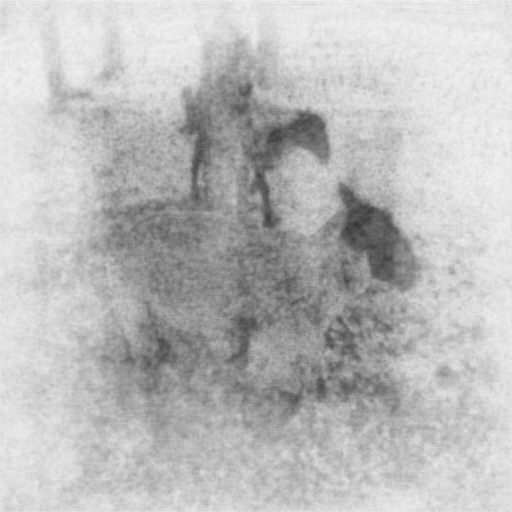

313 6901
314 6902
315 6903
316 6904
317 6905
318 6906
319 6907
320 6908
321 6909
322 6910
323 6911
324 6912
325 6913
326 6914
327 6915
328 6916
329 6917
330 6918
331 6919
332 6920
333 6921
334 6922
335 6923
336 6924
337 6925
338 6926
339 6927
340 6928
341 6929
342 6930
343 6931
344 6932
345 6933
346 6934
347 6935
348 6936
349 6937
350 6938
351 6939
352 6940
353 6941
354 6942
355 6943
356 6944
357 6945
358 6946
359 6947
360 6948
361 6949
362 6950
363 6951
364 6952
365 6953
366 6954
367 6955
368 6956
369 6957
370 6958
371 6959
372 6960
373 6961
374 6962
375 6963
376 6964
377 6965
378 6966
379 6967
380 6968
381 6969
382 6970
383 6971
384 6972
385 6973
386 6974
387 6975
388 6976
389 6977
390 6978
391 6979
392 6980
393 6981
394 6982
395 6983
396 6984
397 6985
398 6986
399 6987
400 6988
401 6989
402 6990
403 6991
404 6992
405 6993
406 6994
407 6995
408 6996
409 6997
410 6998
411 6999
412 7000
2009_003053


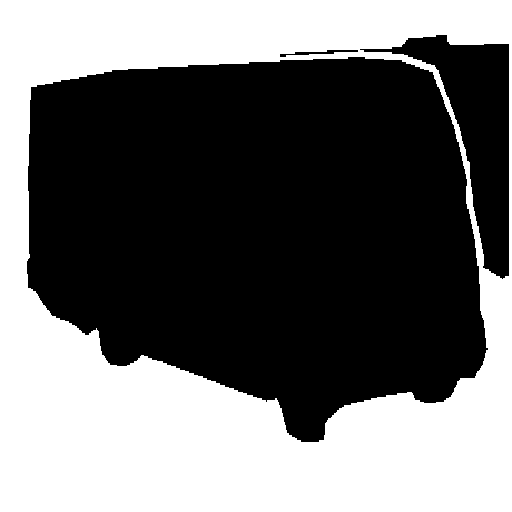

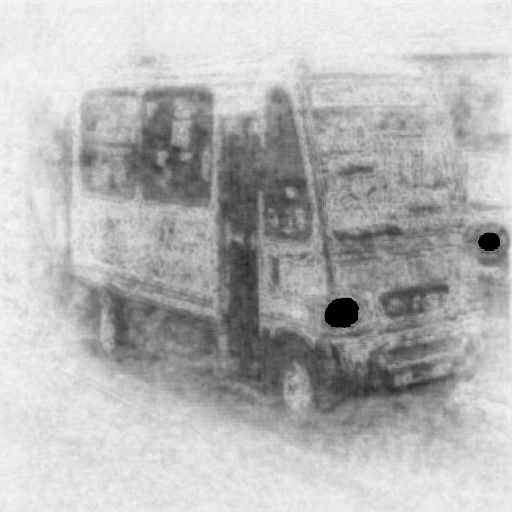

413 7001
414 7002
415 7003
416 7004
417 7005
418 7006
419 7007
420 7008
421 7009
422 7010
423 7011
424 7012
425 7013
426 7014
427 7015
428 7016
429 7017
430 7018
431 7019
432 7020
433 7021
434 7022
435 7023
436 7024
437 7025
438 7026
439 7027
440 7028
441 7029
442 7030
443 7031
444 7032
445 7033
446 7034
447 7035
448 7036
449 7037
450 7038
451 7039
452 7040
453 7041
454 7042
455 7043
456 7044
457 7045
458 7046
459 7047
460 7048
461 7049
462 7050
463 7051
464 7052
465 7053
466 7054
467 7055
468 7056
469 7057
470 7058
471 7059
472 7060
473 7061
474 7062
475 7063
476 7064
477 7065
478 7066
479 7067
480 7068
481 7069
482 7070
483 7071
484 7072
485 7073
486 7074
487 7075
488 7076
489 7077
490 7078
491 7079
492 7080
493 7081
494 7082
495 7083
496 7084
497 7085
498 7086
499 7087
500 7088
501 7089
502 7090
503 7091
504 7092
505 7093
506 7094
507 7095
508 7096
509 7097
510 7098
511 7099
512 7100
2010_001576


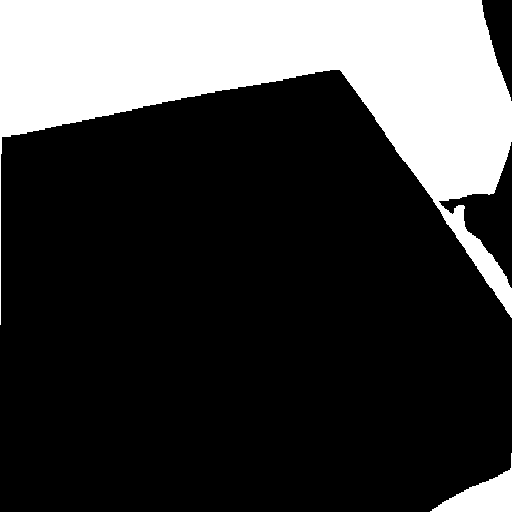

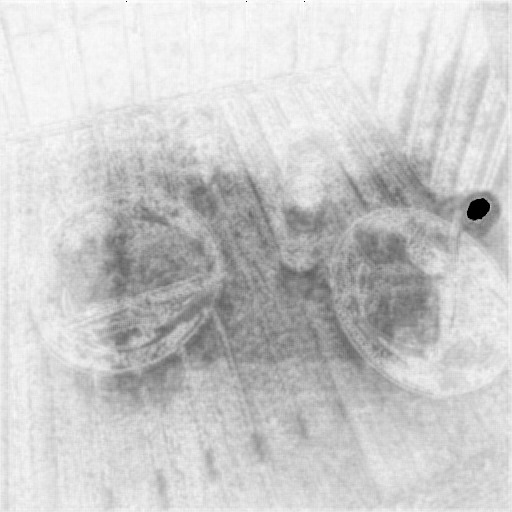

513 7101
514 7102
515 7103
516 7104
517 7105
518 7106
519 7107
520 7108
521 7109
522 7110
523 7111
524 7112
525 7113
526 7114
527 7115
528 7116
529 7117
530 7118
531 7119
532 7120
533 7121
534 7122
535 7123
536 7124
537 7125
538 7126
539 7127
540 7128
541 7129
542 7130
543 7131
544 7132
545 7133
546 7134
547 7135
548 7136
549 7137
550 7138
551 7139
552 7140
553 7141
554 7142
555 7143
556 7144
557 7145
558 7146
559 7147
560 7148
561 7149
562 7150
563 7151
564 7152
565 7153
566 7154
567 7155
568 7156
569 7157
570 7158
571 7159
572 7160
573 7161
574 7162
575 7163
576 7164
577 7165
578 7166
579 7167
580 7168
581 7169
582 7170
583 7171
584 7172
585 7173
586 7174
587 7175
588 7176
589 7177
590 7178
591 7179
592 7180
593 7181
594 7182
595 7183
596 7184
597 7185
598 7186
599 7187
600 7188
601 7189
602 7190
603 7191
604 7192
605 7193
606 7194
607 7195
608 7196
609 7197
610 7198
611 7199
612 7200
2010_005457


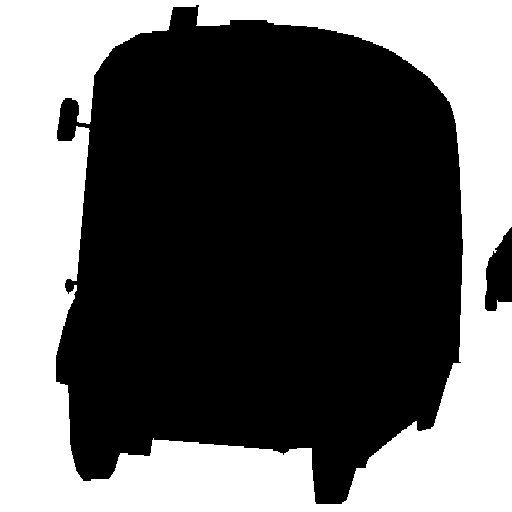

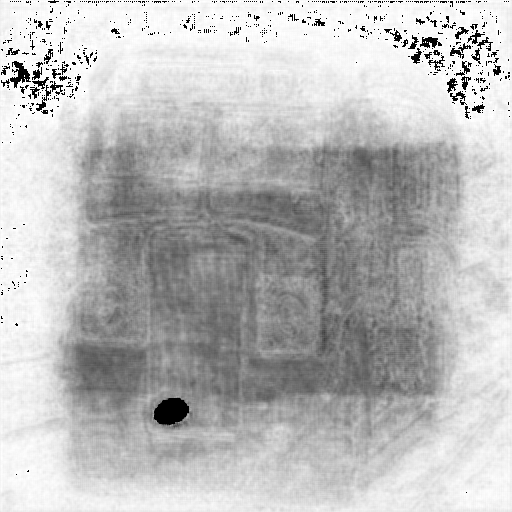

613 7201
614 7202
615 7203
616 7204
617 7205
618 7206
619 7207
620 7208
621 7209
622 7210
623 7211
624 7212
625 7213
626 7214
627 7215
628 7216
629 7217
630 7218
631 7219
632 7220
633 7221
634 7222
635 7223
636 7224
637 7225
638 7226
639 7227
640 7228
641 7229
642 7230
643 7231
644 7232
645 7233
646 7234
647 7235
648 7236
649 7237
650 7238
651 7239
652 7240
653 7241
654 7242
655 7243
656 7244
657 7245
658 7246
659 7247
660 7248
661 7249
662 7250
663 7251
664 7252
665 7253
666 7254
667 7255
668 7256
669 7257
670 7258
671 7259
672 7260
673 7261
674 7262
675 7263
676 7264
677 7265
678 7266
679 7267
680 7268
681 7269
682 7270
683 7271
684 7272
685 7273
686 7274
687 7275
688 7276
689 7277
690 7278
691 7279
692 7280
693 7281
694 7282
695 7283
696 7284
697 7285
698 7286
699 7287
700 7288
701 7289
702 7290
703 7291
704 7292
705 7293
706 7294
707 7295
708 7296
709 7297
710 7298
711 7299
712 7300
2011_002503


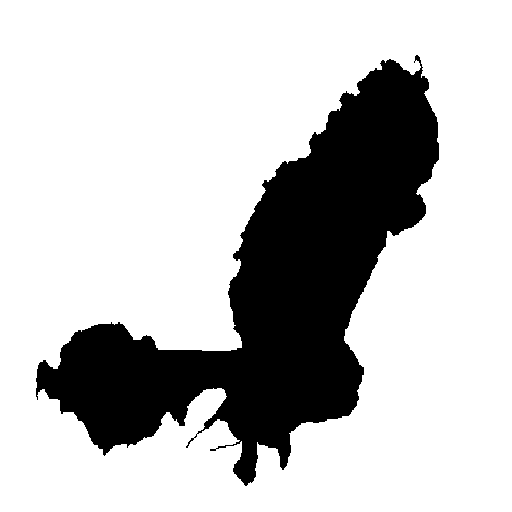

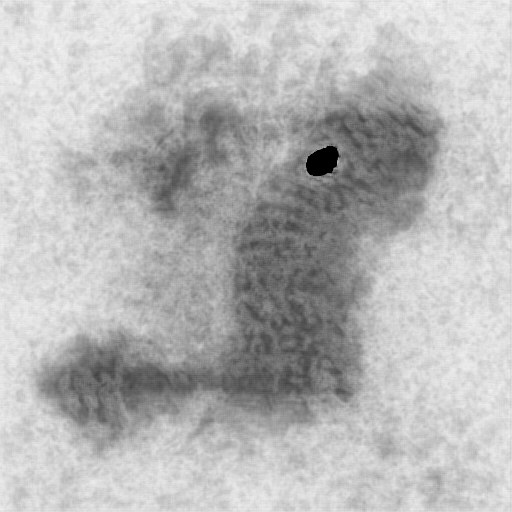

713 7301
714 7302
715 7303
716 7304
717 7305
718 7306
719 7307
720 7308
721 7309
722 7310
723 7311
724 7312
725 7313
726 7314
727 7315
728 7316
729 7317
730 7318
731 7319
0 7320
1 7321
2 7322
3 7323
4 7324
5 7325
6 7326
7 7327
8 7328
9 7329
10 7330
11 7331
12 7332
13 7333
14 7334
15 7335
16 7336
17 7337
18 7338
19 7339
20 7340
21 7341
22 7342
23 7343
24 7344
25 7345
26 7346
27 7347
28 7348
29 7349
30 7350
31 7351
32 7352
33 7353
34 7354
35 7355
36 7356
37 7357
38 7358
39 7359
40 7360
41 7361
42 7362
43 7363
44 7364
45 7365
46 7366
47 7367
48 7368
49 7369
50 7370
51 7371
52 7372
53 7373
54 7374
55 7375
56 7376
57 7377
58 7378
59 7379
60 7380
61 7381
62 7382
63 7383
64 7384
65 7385
66 7386
67 7387
68 7388
69 7389
70 7390
71 7391
72 7392
73 7393
74 7394
75 7395
76 7396
77 7397
78 7398
79 7399
80 7400
2007_005262


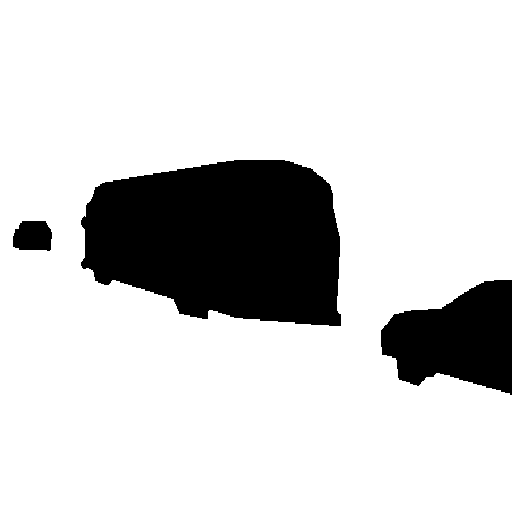

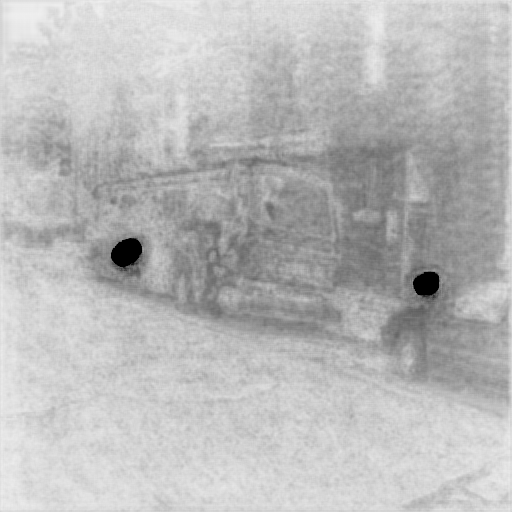

81 7401
82 7402
83 7403
84 7404
85 7405
86 7406
87 7407
88 7408
89 7409
90 7410
91 7411
92 7412
93 7413
94 7414
95 7415
96 7416
97 7417
98 7418
99 7419
100 7420
101 7421
102 7422
103 7423
104 7424
105 7425
106 7426
107 7427
108 7428
109 7429
110 7430
111 7431
112 7432
113 7433
114 7434
115 7435
116 7436
117 7437
118 7438
119 7439
120 7440
121 7441
122 7442
123 7443
124 7444
125 7445
126 7446
127 7447
128 7448
129 7449
130 7450
131 7451
132 7452
133 7453
134 7454
135 7455
136 7456
137 7457
138 7458
139 7459
140 7460
141 7461
142 7462
143 7463
144 7464
145 7465
146 7466
147 7467
148 7468
149 7469
150 7470
151 7471
152 7472
153 7473
154 7474
155 7475
156 7476
157 7477
158 7478
159 7479
160 7480
161 7481
162 7482
163 7483
164 7484
165 7485
166 7486
167 7487
168 7488
169 7489
170 7490
171 7491
172 7492
173 7493
174 7494
175 7495
176 7496
177 7497
178 7498
179 7499
180 7500
2008_000645


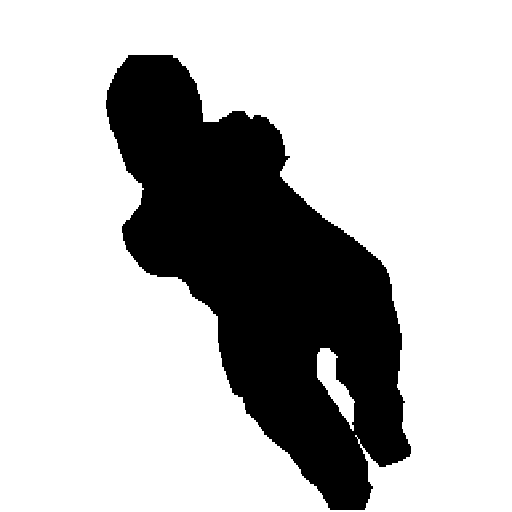

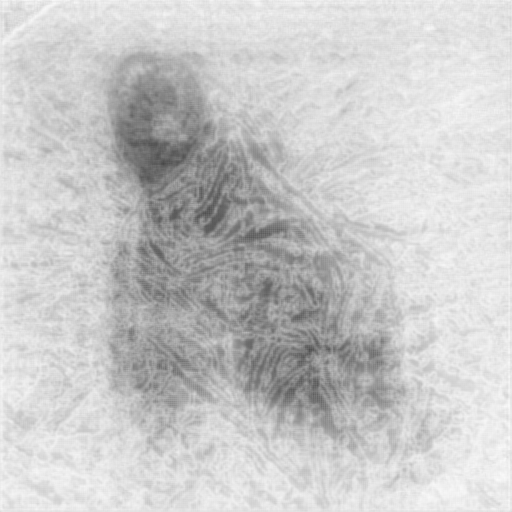

181 7501
182 7502
183 7503
184 7504
185 7505
186 7506
187 7507
188 7508
189 7509
190 7510
191 7511
192 7512
193 7513
194 7514
195 7515
196 7516
197 7517
198 7518
199 7519
200 7520
201 7521
202 7522
203 7523
204 7524
205 7525
206 7526
207 7527
208 7528
209 7529
210 7530
211 7531
212 7532
213 7533
214 7534
215 7535
216 7536
217 7537
218 7538
219 7539
220 7540
221 7541
222 7542
223 7543
224 7544
225 7545
226 7546
227 7547
228 7548
229 7549
230 7550
231 7551
232 7552
233 7553
234 7554
235 7555
236 7556
237 7557
238 7558
239 7559
240 7560
241 7561
242 7562
243 7563
244 7564
245 7565
246 7566
247 7567
248 7568
249 7569
250 7570
251 7571
252 7572
253 7573
254 7574
255 7575
256 7576
257 7577
258 7578
259 7579
260 7580
261 7581
262 7582
263 7583
264 7584
265 7585
266 7586
267 7587
268 7588
269 7589
270 7590
271 7591
272 7592
273 7593
274 7594
275 7595
276 7596
277 7597
278 7598
279 7599
280 7600
2008_005714


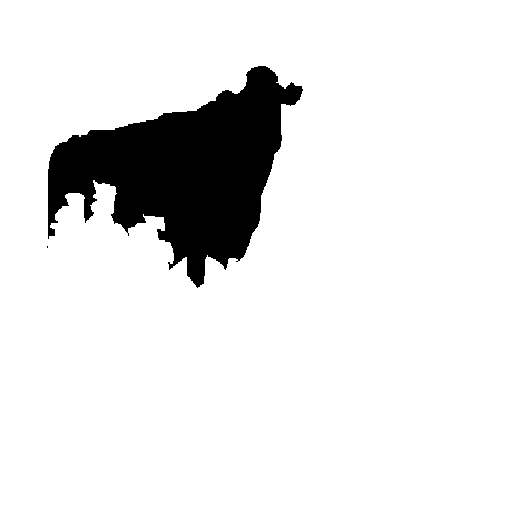

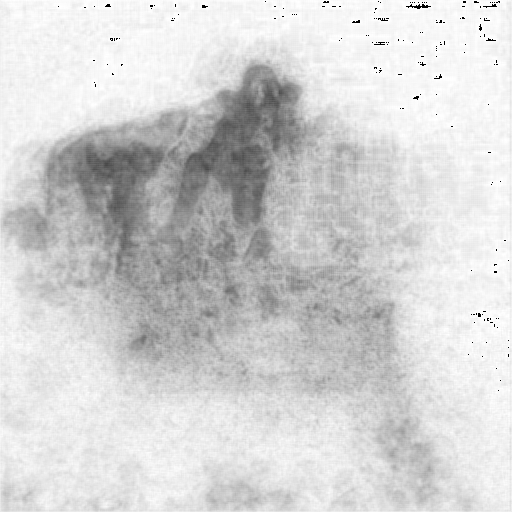

281 7601
282 7602
283 7603
284 7604
285 7605
286 7606
287 7607
288 7608
289 7609
290 7610
291 7611
292 7612
293 7613
294 7614
295 7615
296 7616
297 7617
298 7618
299 7619
300 7620
301 7621
302 7622
303 7623
304 7624
305 7625
306 7626
307 7627
308 7628
309 7629
310 7630
311 7631
312 7632
313 7633
314 7634
315 7635
316 7636
317 7637
318 7638
319 7639
320 7640
321 7641
322 7642
323 7643
324 7644
325 7645
326 7646
327 7647
328 7648
329 7649
330 7650
331 7651
332 7652
333 7653
334 7654
335 7655
336 7656
337 7657
338 7658
339 7659
340 7660
341 7661
342 7662
343 7663
344 7664
345 7665
346 7666
347 7667
348 7668
349 7669
350 7670
351 7671
352 7672
353 7673
354 7674
355 7675
356 7676
357 7677
358 7678
359 7679
360 7680
361 7681
362 7682
363 7683
364 7684
365 7685
366 7686
367 7687
368 7688
369 7689
370 7690
371 7691
372 7692
373 7693
374 7694
375 7695
376 7696
377 7697
378 7698
379 7699
380 7700
2009_002072


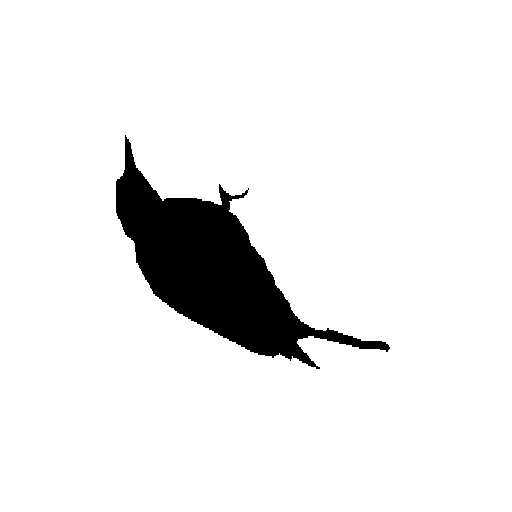

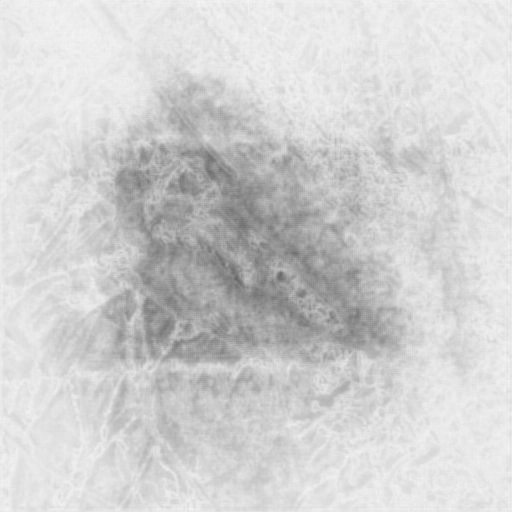

381 7701
382 7702
383 7703
384 7704
385 7705
386 7706
387 7707
388 7708
389 7709
390 7710
391 7711
392 7712
393 7713
394 7714
395 7715
396 7716
397 7717
398 7718
399 7719
400 7720
401 7721
402 7722
403 7723
404 7724
405 7725
406 7726
407 7727
408 7728
409 7729
410 7730
411 7731
412 7732
413 7733
414 7734
415 7735
416 7736
417 7737
418 7738
419 7739
420 7740
421 7741
422 7742
423 7743
424 7744
425 7745
426 7746
427 7747
428 7748
429 7749
430 7750
431 7751
432 7752
433 7753
434 7754
435 7755
436 7756
437 7757
438 7758
439 7759
440 7760
441 7761
442 7762
443 7763
444 7764
445 7765
446 7766
447 7767
448 7768
449 7769
450 7770
451 7771
452 7772
453 7773
454 7774
455 7775
456 7776
457 7777
458 7778
459 7779
460 7780
461 7781
462 7782
463 7783
464 7784
465 7785
466 7786
467 7787
468 7788
469 7789
470 7790
471 7791
472 7792
473 7793
474 7794
475 7795
476 7796
477 7797
478 7798
479 7799
480 7800
2010_000132


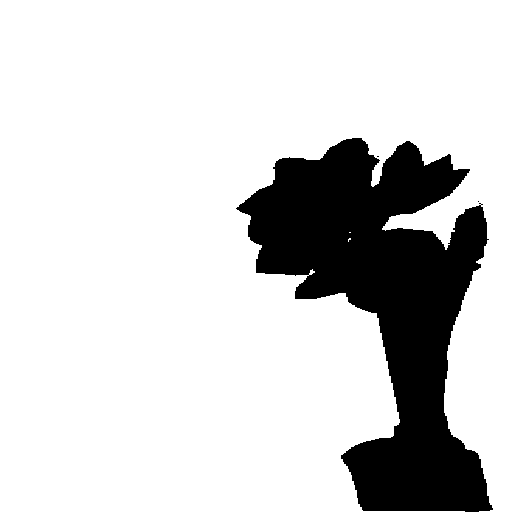

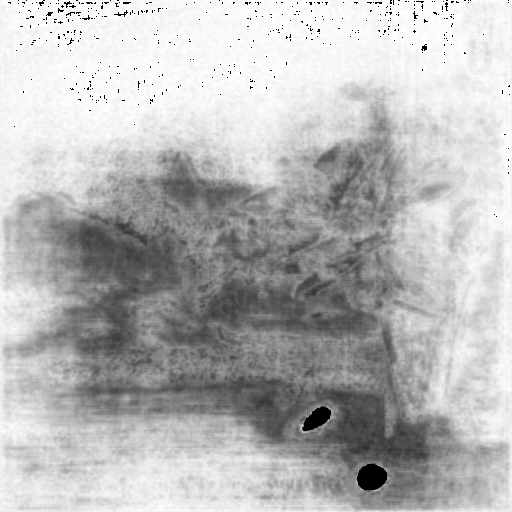

481 7801
482 7802
483 7803
484 7804
485 7805
486 7806
487 7807
488 7808
489 7809
490 7810
491 7811
492 7812
493 7813
494 7814
495 7815
496 7816
497 7817
498 7818
499 7819
500 7820
501 7821
502 7822
503 7823
504 7824
505 7825
506 7826
507 7827
508 7828
509 7829
510 7830
511 7831
512 7832
513 7833
514 7834
515 7835
516 7836
517 7837
518 7838
519 7839
520 7840
521 7841
522 7842
523 7843
524 7844
525 7845
526 7846
527 7847
528 7848
529 7849
530 7850
531 7851
532 7852
533 7853
534 7854
535 7855
536 7856
537 7857
538 7858
539 7859
540 7860
541 7861
542 7862
543 7863
544 7864
545 7865
546 7866
547 7867
548 7868
549 7869
550 7870
551 7871
552 7872
553 7873
554 7874
555 7875
556 7876
557 7877
558 7878
559 7879
560 7880
561 7881
562 7882
563 7883
564 7884
565 7885
566 7886
567 7887
568 7888
569 7889
570 7890
571 7891
572 7892
573 7893
574 7894
575 7895
576 7896
577 7897
578 7898
579 7899
580 7900
2010_004180


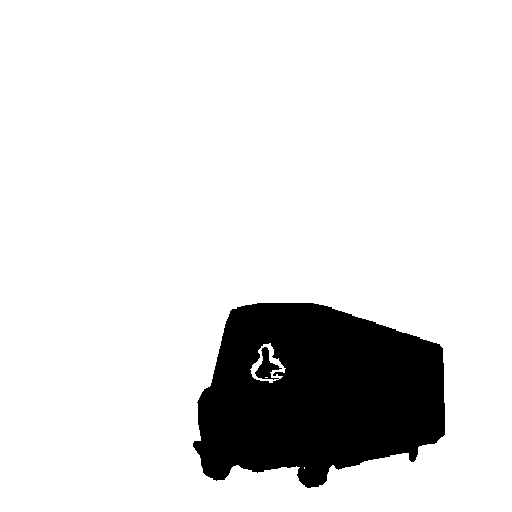

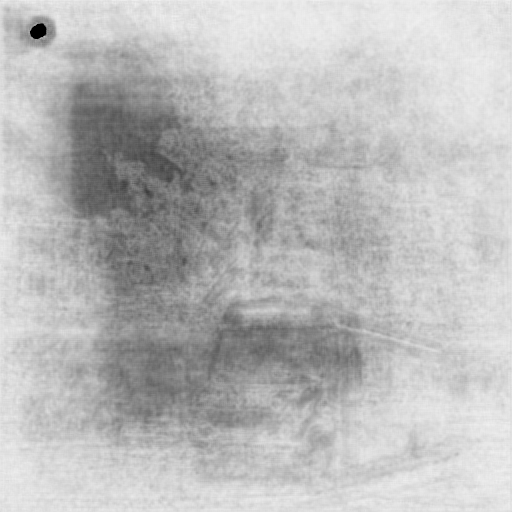

581 7901
582 7902
583 7903
584 7904
585 7905
586 7906
587 7907
588 7908
589 7909
590 7910
591 7911
592 7912
593 7913
594 7914
595 7915
596 7916
597 7917
598 7918
599 7919
600 7920
601 7921
602 7922
603 7923
604 7924
605 7925
606 7926
607 7927
608 7928
609 7929
610 7930
611 7931
612 7932
613 7933
614 7934
615 7935
616 7936
617 7937
618 7938
619 7939
620 7940
621 7941
622 7942
623 7943
624 7944
625 7945
626 7946
627 7947
628 7948
629 7949
630 7950
631 7951
632 7952
633 7953
634 7954
635 7955
636 7956
637 7957
638 7958
639 7959
640 7960
641 7961
642 7962
643 7963
644 7964
645 7965
646 7966
647 7967
648 7968
649 7969
650 7970
651 7971
652 7972
653 7973
654 7974
655 7975
656 7976
657 7977
658 7978
659 7979
660 7980
661 7981
662 7982
663 7983
664 7984
665 7985
666 7986
667 7987
668 7988
669 7989
670 7990
671 7991
672 7992
673 7993
674 7994
675 7995
676 7996
677 7997
678 7998
679 7999
680 8000
2011_001432


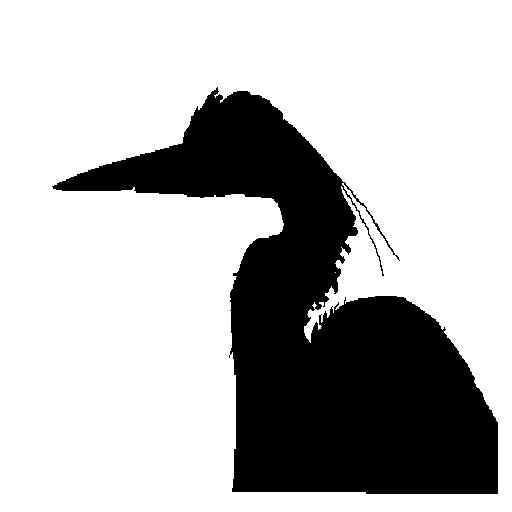

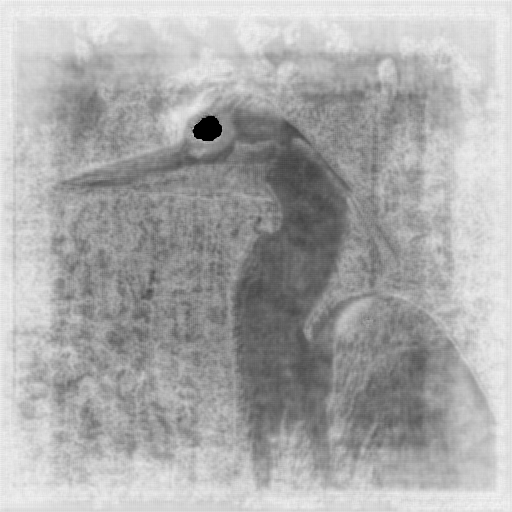

681 8001
682 8002
683 8003
684 8004
685 8005
686 8006
687 8007
688 8008
689 8009
690 8010
691 8011
692 8012
693 8013
694 8014
695 8015
696 8016
697 8017
698 8018
699 8019
700 8020
701 8021
702 8022
703 8023
704 8024
705 8025
706 8026
707 8027
708 8028
709 8029
710 8030
711 8031
712 8032
713 8033
714 8034
715 8035
716 8036
717 8037
718 8038
719 8039
720 8040
721 8041
722 8042
723 8043
724 8044
725 8045
726 8046
727 8047
728 8048
729 8049
730 8050
731 8051
0 8052
1 8053
2 8054
3 8055
4 8056
5 8057
6 8058
7 8059
8 8060
9 8061
10 8062
11 8063
12 8064
13 8065
14 8066
15 8067
16 8068
17 8069
18 8070
19 8071
20 8072
21 8073
22 8074
23 8075
24 8076
25 8077
26 8078
27 8079
28 8080
29 8081
30 8082
31 8083
32 8084
33 8085
34 8086
35 8087
36 8088
37 8089
38 8090
39 8091
40 8092
41 8093
42 8094
43 8095
44 8096
45 8097
46 8098
47 8099
48 8100
2007_003178


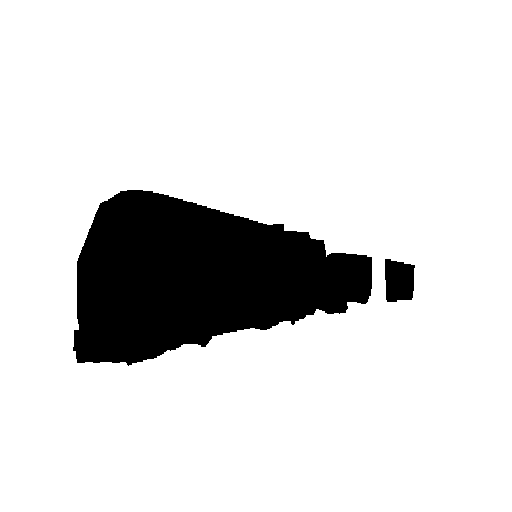

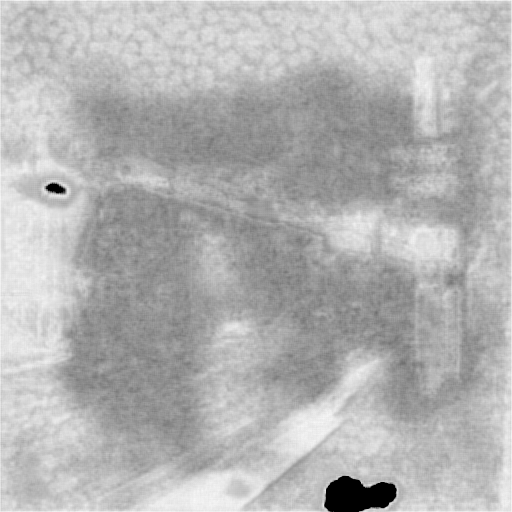

49 8101
50 8102
51 8103
52 8104
53 8105
54 8106
55 8107
56 8108
57 8109
58 8110
59 8111
60 8112
61 8113
62 8114
63 8115
64 8116
65 8117
66 8118
67 8119
68 8120
69 8121
70 8122
71 8123
72 8124
73 8125
74 8126
75 8127
76 8128
77 8129
78 8130
79 8131
80 8132
81 8133
82 8134
83 8135
84 8136
85 8137
86 8138
87 8139
88 8140
89 8141
90 8142
91 8143
92 8144
93 8145
94 8146
95 8147
96 8148
97 8149
98 8150
99 8151
100 8152
101 8153
102 8154
103 8155
104 8156
105 8157
106 8158
107 8159
108 8160
109 8161
110 8162
111 8163
112 8164
113 8165
114 8166
115 8167
116 8168
117 8169
118 8170
119 8171
120 8172
121 8173
122 8174
123 8175
124 8176
125 8177
126 8178
127 8179
128 8180
129 8181
130 8182
131 8183
132 8184
133 8185
134 8186
135 8187
136 8188
137 8189
138 8190
139 8191
140 8192
141 8193
142 8194
143 8195
144 8196
145 8197
146 8198
147 8199
148 8200
2007_009630


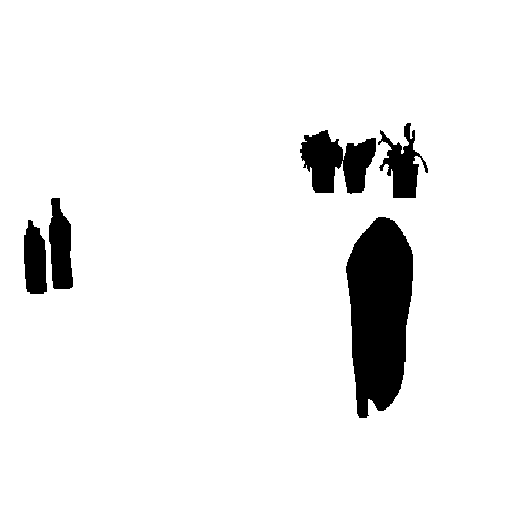

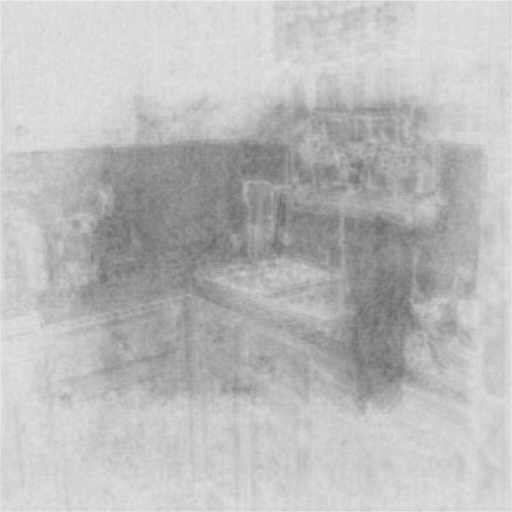

149 8201
150 8202
151 8203
152 8204
153 8205
154 8206
155 8207
156 8208
157 8209
158 8210
159 8211
160 8212
161 8213
162 8214
163 8215
164 8216
165 8217
166 8218
167 8219
168 8220
169 8221
170 8222
171 8223
172 8224
173 8225
174 8226
175 8227
176 8228
177 8229
178 8230
179 8231
180 8232
181 8233
182 8234
183 8235
184 8236
185 8237
186 8238
187 8239
188 8240
189 8241
190 8242
191 8243
192 8244
193 8245
194 8246
195 8247
196 8248
197 8249
198 8250
199 8251
200 8252
201 8253
202 8254
203 8255
204 8256
205 8257
206 8258
207 8259
208 8260
209 8261
210 8262
211 8263
212 8264
213 8265
214 8266
215 8267
216 8268
217 8269
218 8270
219 8271
220 8272
221 8273
222 8274
223 8275
224 8276
225 8277
226 8278
227 8279
228 8280
229 8281
230 8282
231 8283
232 8284
233 8285
234 8286
235 8287
236 8288
237 8289
238 8290
239 8291
240 8292
241 8293
242 8294
243 8295
244 8296
245 8297
246 8298
247 8299
248 8300
2008_003703


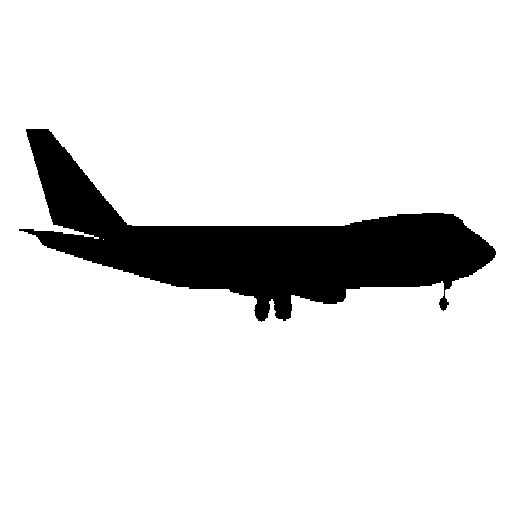

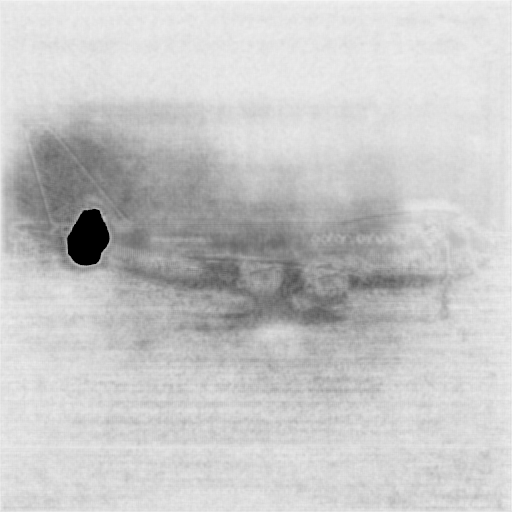

249 8301
250 8302
251 8303
252 8304
253 8305
254 8306
255 8307
256 8308
257 8309
258 8310
259 8311
260 8312
261 8313
262 8314
263 8315
264 8316
265 8317
266 8318
267 8319
268 8320
269 8321
270 8322
271 8323
272 8324
273 8325
274 8326
275 8327
276 8328
277 8329
278 8330
279 8331
280 8332
281 8333
282 8334
283 8335
284 8336
285 8337
286 8338
287 8339
288 8340
289 8341
290 8342
291 8343
292 8344
293 8345
294 8346
295 8347
296 8348
297 8349
298 8350
299 8351
300 8352
301 8353
302 8354
303 8355
304 8356
305 8357
306 8358
307 8359
308 8360
309 8361
310 8362
311 8363
312 8364
313 8365
314 8366
315 8367
316 8368
317 8369
318 8370
319 8371
320 8372
321 8373
322 8374
323 8375
324 8376
325 8377
326 8378
327 8379
328 8380
329 8381
330 8382
331 8383
332 8384
333 8385
334 8386
335 8387
336 8388
337 8389
338 8390
339 8391
340 8392
341 8393
342 8394
343 8395
344 8396
345 8397
346 8398
347 8399
348 8400
2009_001117


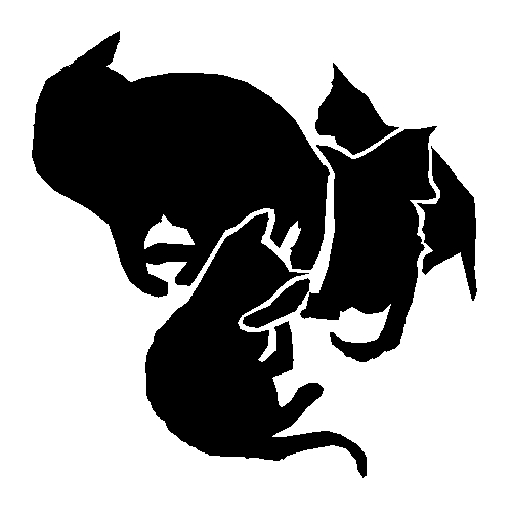

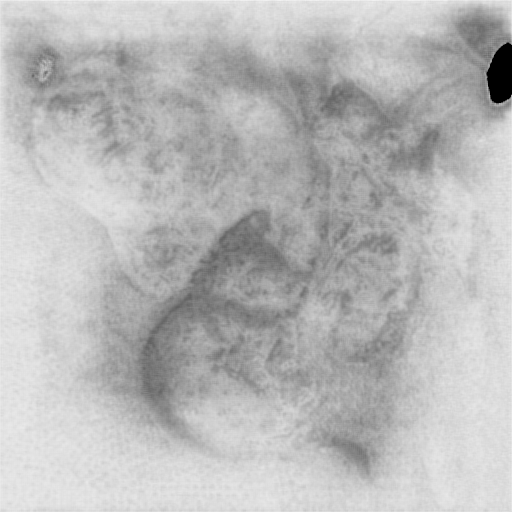

349 8401
350 8402
351 8403
352 8404
353 8405
354 8406
355 8407
356 8408
357 8409
358 8410
359 8411
360 8412
361 8413
362 8414
363 8415
364 8416
365 8417
366 8418
367 8419
368 8420
369 8421
370 8422
371 8423
372 8424
373 8425
374 8426
375 8427
376 8428
377 8429
378 8430
379 8431
380 8432
381 8433
382 8434
383 8435
384 8436
385 8437
386 8438
387 8439
388 8440
389 8441
390 8442
391 8443
392 8444
393 8445
394 8446
395 8447
396 8448
397 8449
398 8450
399 8451
400 8452
401 8453
402 8454
403 8455
404 8456
405 8457
406 8458
407 8459
408 8460
409 8461
410 8462
411 8463
412 8464
413 8465
414 8466
415 8467
416 8468
417 8469
418 8470
419 8471
420 8472
421 8473
422 8474
423 8475
424 8476
425 8477
426 8478
427 8479
428 8480
429 8481
430 8482
431 8483
432 8484
433 8485
434 8486
435 8487
436 8488
437 8489
438 8490
439 8491
440 8492
441 8493
442 8494
443 8495
444 8496
445 8497
446 8498
447 8499
448 8500
2009_004368


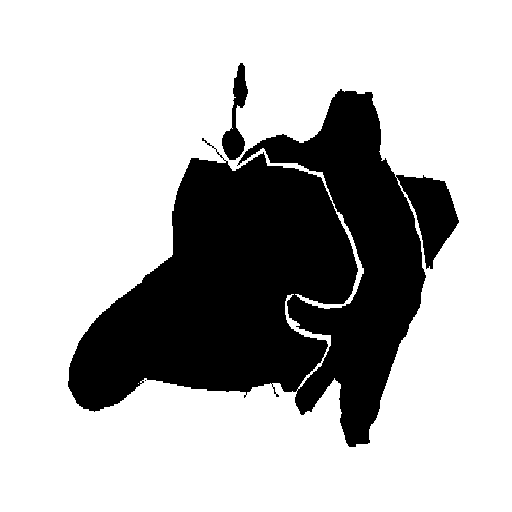

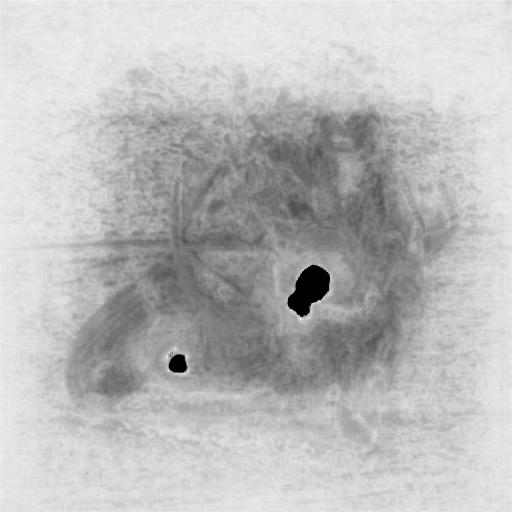

449 8501
450 8502
451 8503
452 8504
453 8505
454 8506
455 8507
456 8508
457 8509
458 8510
459 8511
460 8512
461 8513
462 8514
463 8515
464 8516
465 8517
466 8518
467 8519
468 8520
469 8521
470 8522
471 8523
472 8524
473 8525
474 8526
475 8527
476 8528
477 8529
478 8530
479 8531
480 8532
481 8533
482 8534
483 8535
484 8536
485 8537
486 8538
487 8539
488 8540
489 8541
490 8542
491 8543
492 8544
493 8545
494 8546
495 8547
496 8548
497 8549
498 8550
499 8551
500 8552
501 8553
502 8554
503 8555
504 8556
505 8557
506 8558
507 8559
508 8560
509 8561
510 8562
511 8563
512 8564
513 8565
514 8566
515 8567
516 8568
517 8569
518 8570
519 8571
520 8572
521 8573
522 8574
523 8575
524 8576
525 8577
526 8578
527 8579
528 8580
529 8581
530 8582
531 8583
532 8584
533 8585
534 8586
535 8587
536 8588
537 8589
538 8590
539 8591
540 8592
541 8593
542 8594
543 8595
544 8596
545 8597
546 8598
547 8599
548 8600
2010_002907


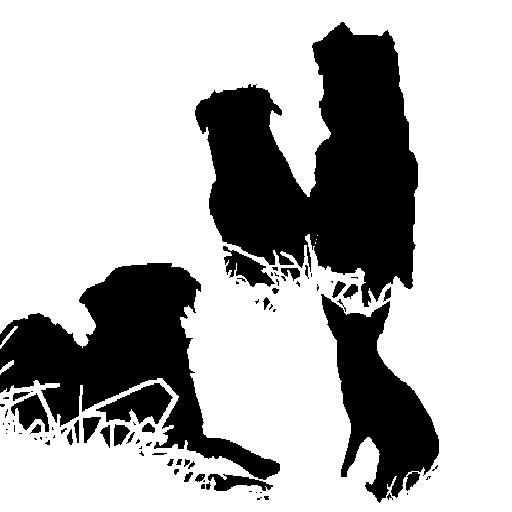

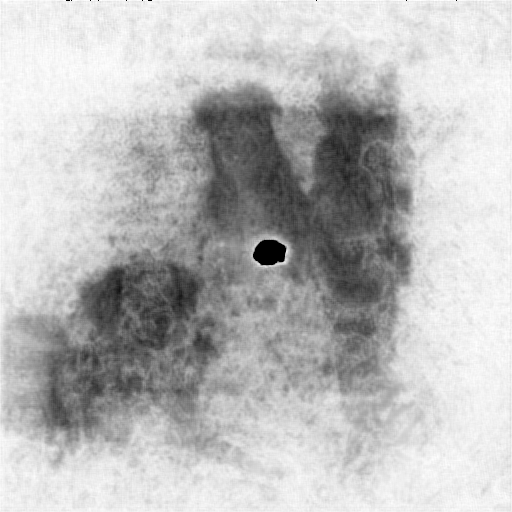

549 8601
550 8602
551 8603
552 8604
553 8605
554 8606
555 8607
556 8608
557 8609
558 8610
559 8611
560 8612
561 8613
562 8614
563 8615
564 8616
565 8617
566 8618
567 8619
568 8620
569 8621
570 8622
571 8623
572 8624
573 8625
574 8626
575 8627
576 8628
577 8629
578 8630
579 8631
580 8632
581 8633
582 8634
583 8635
584 8636
585 8637
586 8638
587 8639
588 8640
589 8641
590 8642
591 8643
592 8644
593 8645
594 8646
595 8647
596 8648
597 8649
598 8650
599 8651
600 8652
601 8653
602 8654
603 8655
604 8656
605 8657
606 8658
607 8659
608 8660
609 8661
610 8662
611 8663
612 8664
613 8665
614 8666
615 8667
616 8668
617 8669
618 8670
619 8671
620 8672
621 8673
622 8674
623 8675
624 8676
625 8677
626 8678
627 8679
628 8680
629 8681
630 8682
631 8683
632 8684
633 8685
634 8686
635 8687
636 8688
637 8689
638 8690
639 8691
640 8692
641 8693
642 8694
643 8695
644 8696
645 8697
646 8698
647 8699
648 8700
2011_000277


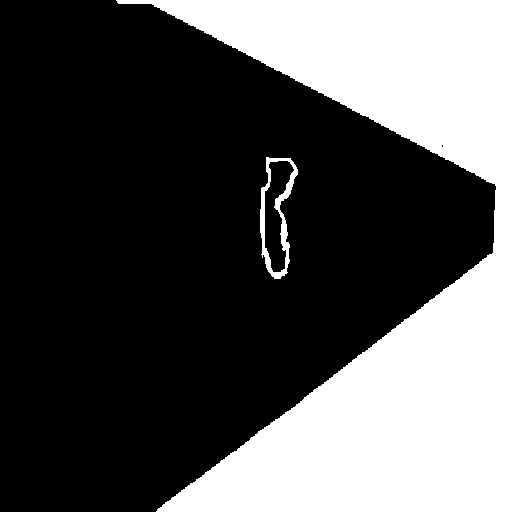

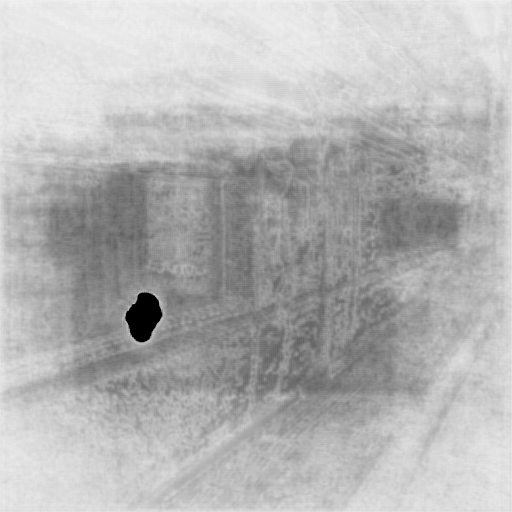

649 8701
650 8702
651 8703
652 8704
653 8705
654 8706
655 8707
656 8708
657 8709
658 8710
659 8711
660 8712
661 8713
662 8714
663 8715
664 8716
665 8717
666 8718
667 8719
668 8720
669 8721
670 8722
671 8723
672 8724
673 8725
674 8726
675 8727
676 8728
677 8729
678 8730
679 8731
680 8732
681 8733
682 8734
683 8735
684 8736
685 8737
686 8738
687 8739
688 8740
689 8741
690 8742
691 8743
692 8744
693 8745
694 8746
695 8747
696 8748
697 8749
698 8750
699 8751
700 8752
701 8753
702 8754
703 8755
704 8756
705 8757
706 8758
707 8759
708 8760
709 8761
710 8762
711 8763
712 8764
713 8765
714 8766
715 8767
716 8768
717 8769
718 8770
719 8771
720 8772
721 8773
722 8774
723 8775
724 8776
725 8777
726 8778
727 8779
728 8780
729 8781
730 8782
731 8783
0 8784
1 8785
2 8786
3 8787
4 8788
5 8789
6 8790
7 8791
8 8792
9 8793
10 8794
11 8795
12 8796
13 8797
14 8798
15 8799
16 8800
2007_001027


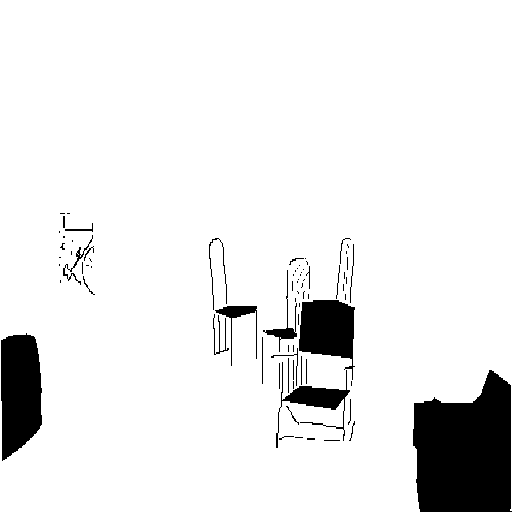

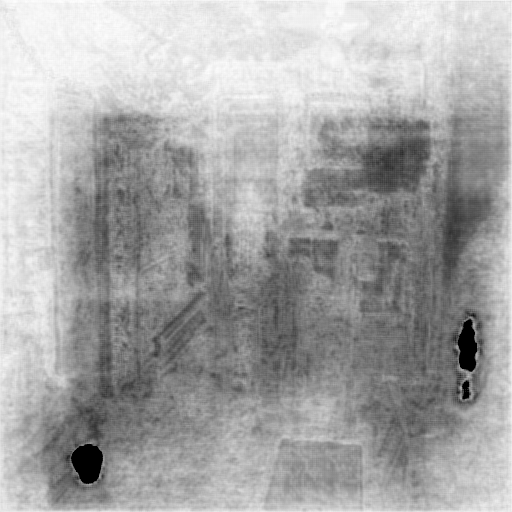

17 8801
18 8802
19 8803
20 8804
21 8805
22 8806
23 8807
24 8808
25 8809
26 8810
27 8811
28 8812
29 8813
30 8814
31 8815
32 8816
33 8817
34 8818
35 8819
36 8820
37 8821
38 8822
39 8823
40 8824
41 8825
42 8826
43 8827
44 8828
45 8829
46 8830
47 8831
48 8832
49 8833
50 8834
51 8835
52 8836
53 8837
54 8838
55 8839
56 8840
57 8841
58 8842
59 8843
60 8844
61 8845
62 8846
63 8847
64 8848
65 8849
66 8850
67 8851
68 8852
69 8853
70 8854
71 8855
72 8856
73 8857
74 8858
75 8859
76 8860
77 8861
78 8862
79 8863
80 8864
81 8865
82 8866
83 8867
84 8868
85 8869
86 8870
87 8871
88 8872
89 8873
90 8874
91 8875
92 8876
93 8877
94 8878
95 8879
96 8880
97 8881
98 8882
99 8883
100 8884
101 8885
102 8886
103 8887
104 8888
105 8889
106 8890
107 8891
108 8892
109 8893
110 8894
111 8895
112 8896
113 8897
114 8898
115 8899
116 8900
2007_007621


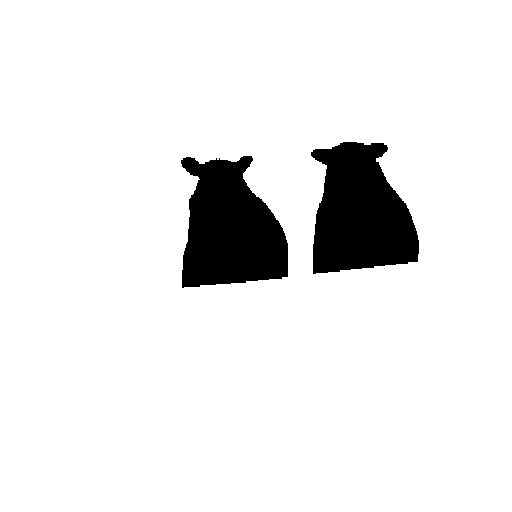

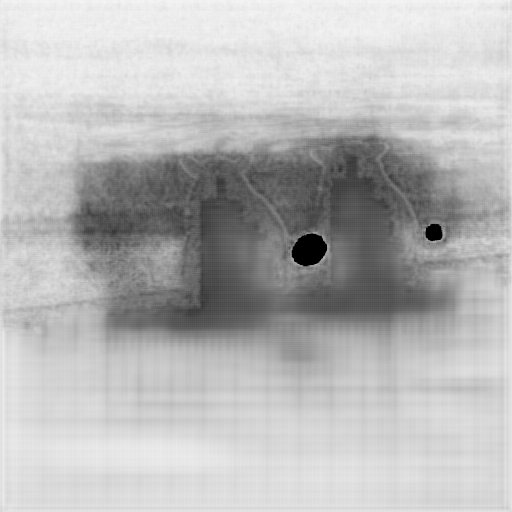

117 8901
118 8902
119 8903
120 8904
121 8905
122 8906
123 8907
124 8908
125 8909
126 8910
127 8911
128 8912
129 8913
130 8914
131 8915
132 8916
133 8917
134 8918
135 8919
136 8920
137 8921
138 8922
139 8923
140 8924
141 8925
142 8926
143 8927
144 8928
145 8929
146 8930
147 8931
148 8932
149 8933
150 8934
151 8935
152 8936
153 8937
154 8938
155 8939
156 8940
157 8941
158 8942
159 8943
160 8944
161 8945
162 8946
163 8947
164 8948
165 8949
166 8950
167 8951
168 8952
169 8953
170 8954
171 8955
172 8956
173 8957
174 8958
175 8959
176 8960
177 8961
178 8962
179 8963
180 8964
181 8965
182 8966
183 8967
184 8968
185 8969
186 8970
187 8971
188 8972
189 8973
190 8974
191 8975
192 8976
193 8977
194 8978
195 8979
196 8980
197 8981
198 8982
199 8983
200 8984
201 8985
202 8986
203 8987
204 8988
205 8989
206 8990
207 8991
208 8992
209 8993
210 8994
211 8995
212 8996
213 8997
214 8998
215 8999
216 9000
2008_002160


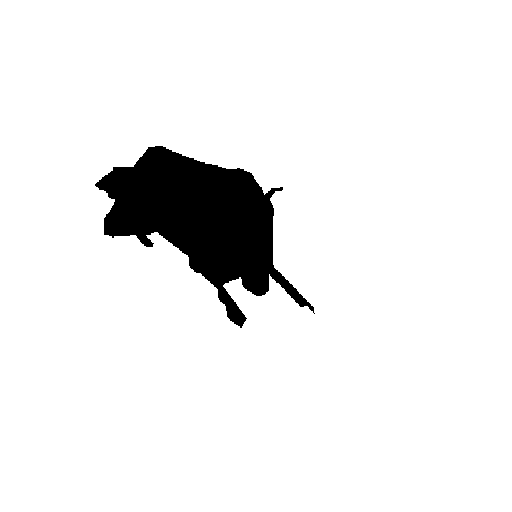

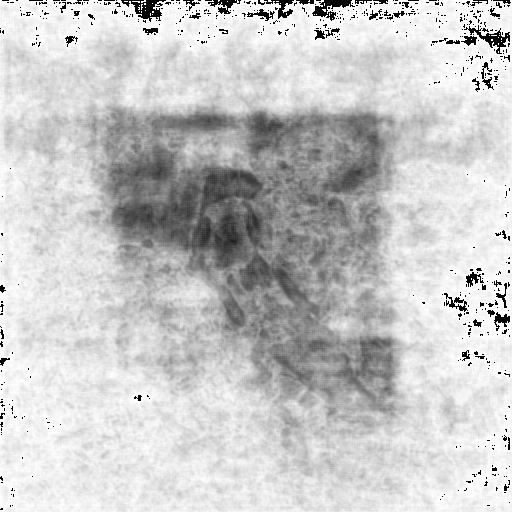

217 9001
218 9002
219 9003
220 9004
221 9005
222 9006
223 9007
224 9008
225 9009
226 9010
227 9011
228 9012
229 9013
230 9014
231 9015
232 9016
233 9017
234 9018
235 9019
236 9020
237 9021
238 9022
239 9023
240 9024
241 9025
242 9026
243 9027
244 9028
245 9029
246 9030
247 9031
248 9032
249 9033
250 9034
251 9035
252 9036
253 9037
254 9038
255 9039
256 9040
257 9041
258 9042
259 9043
260 9044
261 9045
262 9046
263 9047
264 9048
265 9049
266 9050
267 9051
268 9052
269 9053
270 9054
271 9055
272 9056
273 9057
274 9058
275 9059
276 9060
277 9061
278 9062
279 9063
280 9064
281 9065
282 9066
283 9067
284 9068
285 9069
286 9070
287 9071
288 9072
289 9073
290 9074
291 9075
292 9076
293 9077
294 9078
295 9079
296 9080
297 9081
298 9082
299 9083
300 9084
301 9085
302 9086
303 9087
304 9088
305 9089
306 9090
307 9091
308 9092
309 9093
310 9094
311 9095
312 9096
313 9097
314 9098
315 9099
316 9100
2008_008541


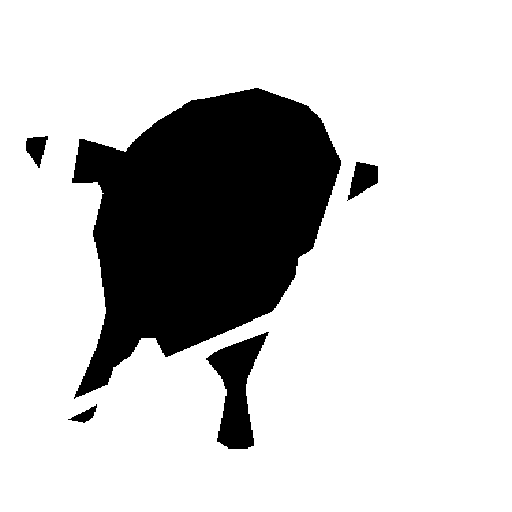

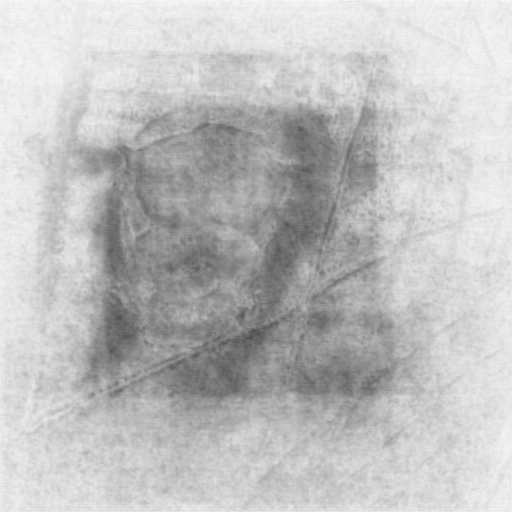

317 9101
318 9102
319 9103
320 9104
321 9105
322 9106
323 9107
324 9108
325 9109
326 9110
327 9111
328 9112
329 9113
330 9114
331 9115
332 9116
333 9117
334 9118
335 9119
336 9120
337 9121
338 9122
339 9123
340 9124
341 9125
342 9126
343 9127
344 9128
345 9129
346 9130
347 9131
348 9132
349 9133
350 9134
351 9135
352 9136
353 9137
354 9138
355 9139
356 9140
357 9141
358 9142
359 9143
360 9144
361 9145
362 9146
363 9147
364 9148
365 9149
366 9150
367 9151
368 9152
369 9153
370 9154
371 9155
372 9156
373 9157
374 9158
375 9159
376 9160
377 9161
378 9162
379 9163
380 9164
381 9165
382 9166
383 9167
384 9168
385 9169
386 9170
387 9171
388 9172
389 9173
390 9174
391 9175
392 9176
393 9177
394 9178
395 9179
396 9180
397 9181
398 9182
399 9183
400 9184
401 9185
402 9186
403 9187
404 9188
405 9189
406 9190
407 9191
408 9192
409 9193
410 9194
411 9195
412 9196
413 9197
414 9198
415 9199
416 9200
2009_003147


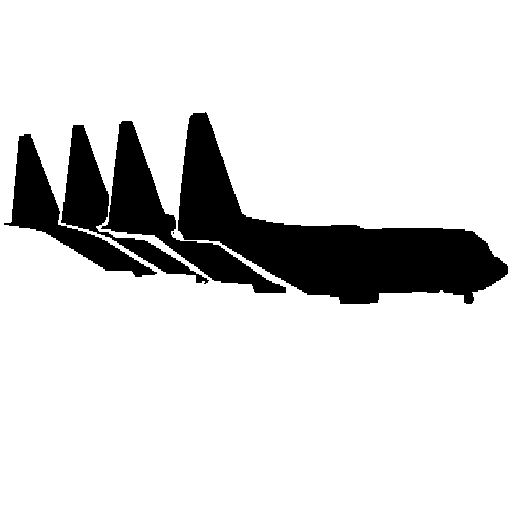

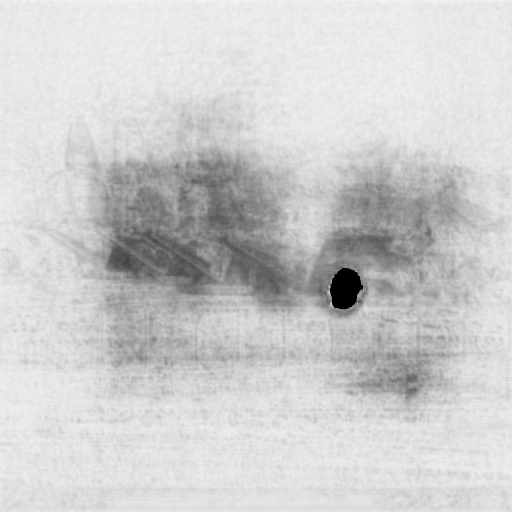

417 9201
418 9202
419 9203
420 9204
421 9205
422 9206
423 9207
424 9208
425 9209
426 9210
427 9211
428 9212
429 9213
430 9214
431 9215
432 9216
433 9217
434 9218
435 9219
436 9220
437 9221
438 9222
439 9223
440 9224
441 9225
442 9226
443 9227
444 9228
445 9229
446 9230
447 9231
448 9232
449 9233
450 9234
451 9235
452 9236
453 9237
454 9238
455 9239
456 9240
457 9241
458 9242
459 9243
460 9244
461 9245
462 9246
463 9247
464 9248
465 9249
466 9250
467 9251
468 9252
469 9253
470 9254
471 9255
472 9256
473 9257
474 9258
475 9259
476 9260
477 9261
478 9262
479 9263
480 9264
481 9265
482 9266
483 9267
484 9268
485 9269
486 9270
487 9271
488 9272
489 9273
490 9274
491 9275
492 9276
493 9277
494 9278
495 9279
496 9280
497 9281
498 9282
499 9283
500 9284
501 9285
502 9286
503 9287
504 9288
505 9289
506 9290
507 9291
508 9292
509 9293
510 9294
511 9295
512 9296
513 9297
514 9298
515 9299
516 9300
2010_001706


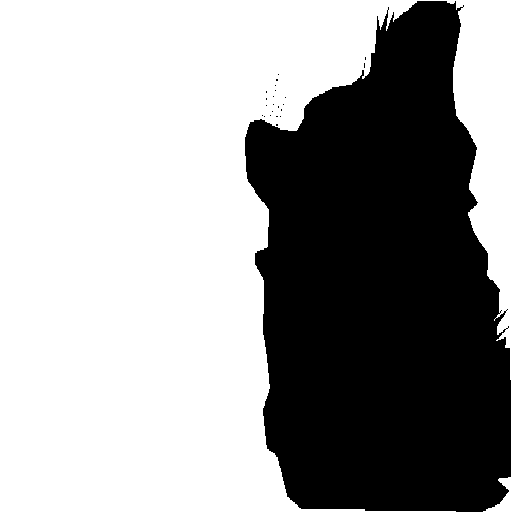

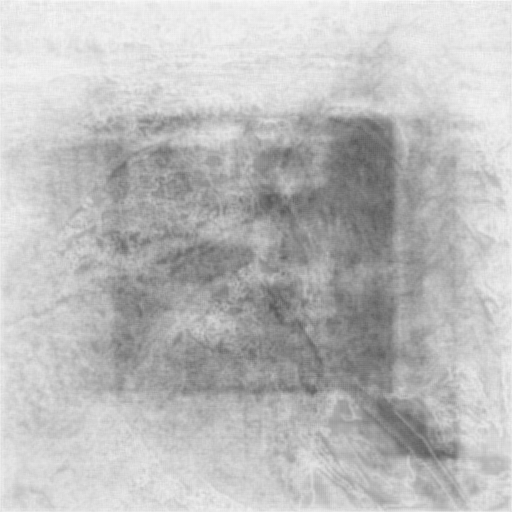

517 9301
518 9302
519 9303
520 9304
521 9305
522 9306
523 9307
524 9308
525 9309
526 9310
527 9311
528 9312
529 9313
530 9314
531 9315
532 9316
533 9317
534 9318
535 9319
536 9320
537 9321
538 9322
539 9323
540 9324
541 9325
542 9326
543 9327
544 9328
545 9329
546 9330
547 9331
548 9332
549 9333
550 9334
551 9335
552 9336
553 9337
554 9338
555 9339
556 9340
557 9341
558 9342
559 9343
560 9344
561 9345
562 9346
563 9347
564 9348
565 9349
566 9350
567 9351
568 9352
569 9353
570 9354
571 9355
572 9356
573 9357
574 9358
575 9359
576 9360
577 9361
578 9362
579 9363
580 9364
581 9365
582 9366
583 9367
584 9368
585 9369
586 9370
587 9371
588 9372
589 9373
590 9374
591 9375
592 9376
593 9377
594 9378
595 9379
596 9380
597 9381
598 9382
599 9383
600 9384
601 9385
602 9386
603 9387
604 9388
605 9389
606 9390
607 9391
608 9392
609 9393
610 9394
611 9395
612 9396
613 9397
614 9398
615 9399
616 9400
2010_005519


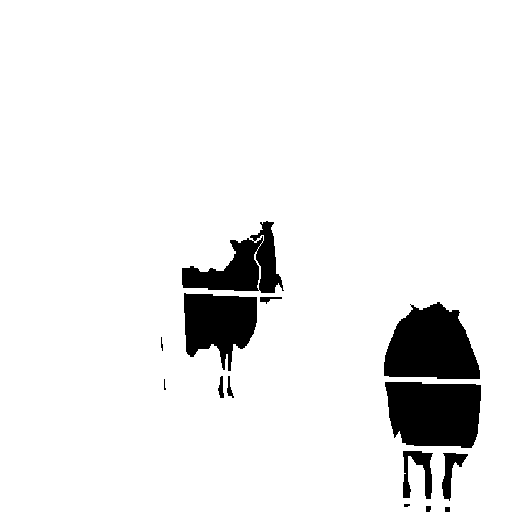

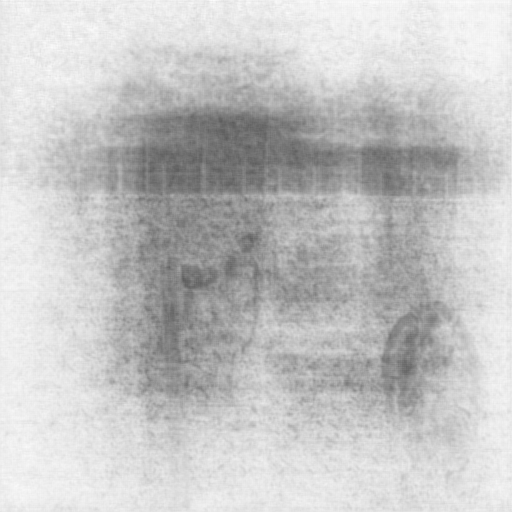

617 9401
618 9402
619 9403
620 9404
621 9405
622 9406
623 9407
624 9408
625 9409
626 9410
627 9411
628 9412
629 9413
630 9414
631 9415
632 9416
633 9417
634 9418
635 9419
636 9420
637 9421
638 9422
639 9423
640 9424
641 9425
642 9426
643 9427
644 9428
645 9429
646 9430
647 9431
648 9432
649 9433
650 9434
651 9435
652 9436
653 9437
654 9438
655 9439
656 9440
657 9441
658 9442
659 9443
660 9444
661 9445
662 9446
663 9447
664 9448
665 9449
666 9450
667 9451
668 9452
669 9453
670 9454
671 9455
672 9456
673 9457
674 9458
675 9459
676 9460
677 9461
678 9462
679 9463
680 9464
681 9465
682 9466
683 9467
684 9468
685 9469
686 9470
687 9471
688 9472
689 9473
690 9474
691 9475
692 9476
693 9477
694 9478
695 9479
696 9480
697 9481
698 9482
699 9483
700 9484
701 9485
702 9486
703 9487
704 9488
705 9489
706 9490
707 9491
708 9492
709 9493
710 9494
711 9495
712 9496
713 9497
714 9498
715 9499
716 9500
2011_002590


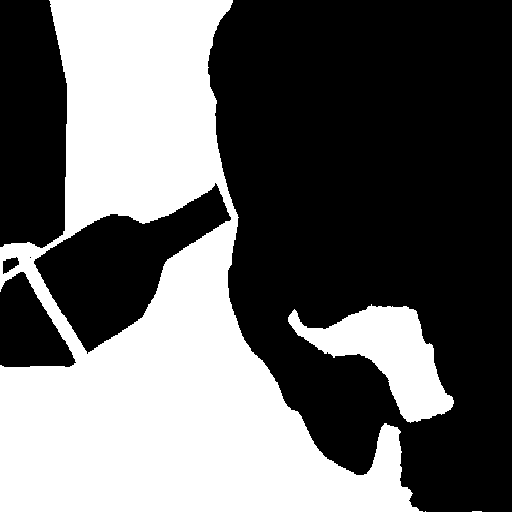

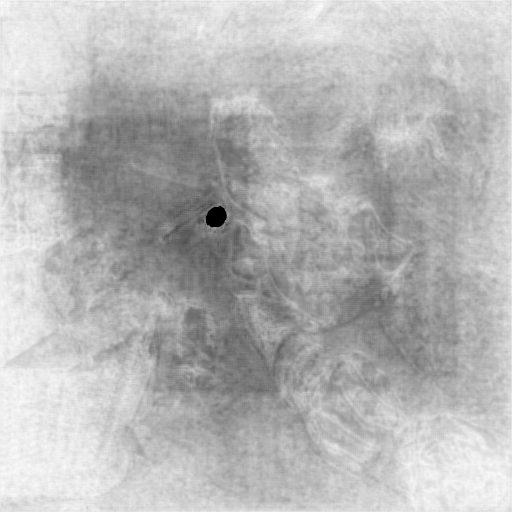

717 9501
718 9502
719 9503
720 9504
721 9505
722 9506
723 9507
724 9508
725 9509
726 9510
727 9511
728 9512
729 9513
730 9514
731 9515
0 9516
1 9517
2 9518
3 9519
4 9520
5 9521
6 9522
7 9523
8 9524
9 9525
10 9526
11 9527
12 9528
13 9529
14 9530
15 9531
16 9532
17 9533
18 9534
19 9535
20 9536
21 9537
22 9538
23 9539
24 9540
25 9541
26 9542
27 9543
28 9544
29 9545
30 9546
31 9547
32 9548
33 9549
34 9550
35 9551
36 9552
37 9553
38 9554
39 9555
40 9556
41 9557
42 9558
43 9559
44 9560
45 9561
46 9562
47 9563
48 9564
49 9565
50 9566
51 9567
52 9568
53 9569
54 9570
55 9571
56 9572
57 9573
58 9574
59 9575
60 9576
61 9577
62 9578
63 9579
64 9580
65 9581
66 9582
67 9583
68 9584
69 9585
70 9586
71 9587
72 9588
73 9589
74 9590
75 9591
76 9592
77 9593
78 9594
79 9595
80 9596
81 9597
82 9598
83 9599
84 9600
2007_005647


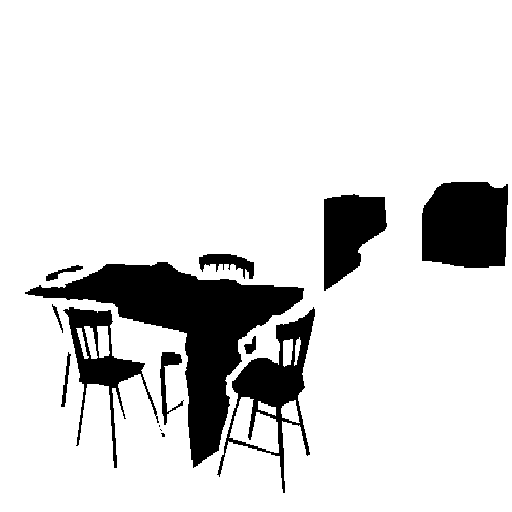

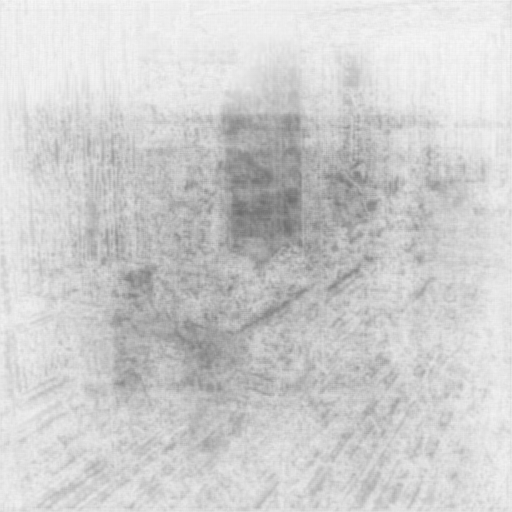

85 9601
86 9602
87 9603
88 9604
89 9605
90 9606
91 9607
92 9608
93 9609
94 9610
95 9611
96 9612
97 9613
98 9614
99 9615
100 9616
101 9617
102 9618
103 9619
104 9620
105 9621
106 9622
107 9623
108 9624
109 9625
110 9626
111 9627
112 9628
113 9629
114 9630
115 9631
116 9632
117 9633
118 9634
119 9635
120 9636
121 9637
122 9638
123 9639
124 9640
125 9641
126 9642
127 9643
128 9644
129 9645
130 9646
131 9647
132 9648
133 9649
134 9650
135 9651
136 9652
137 9653
138 9654
139 9655
140 9656
141 9657
142 9658
143 9659
144 9660
145 9661
146 9662
147 9663
148 9664
149 9665
150 9666
151 9667
152 9668
153 9669
154 9670
155 9671
156 9672
157 9673
158 9674
159 9675
160 9676
161 9677
162 9678
163 9679
164 9680
165 9681
166 9682
167 9683
168 9684
169 9685
170 9686
171 9687
172 9688
173 9689
174 9690
175 9691
176 9692
177 9693
178 9694
179 9695
180 9696
181 9697
182 9698
183 9699
184 9700
2008_000778


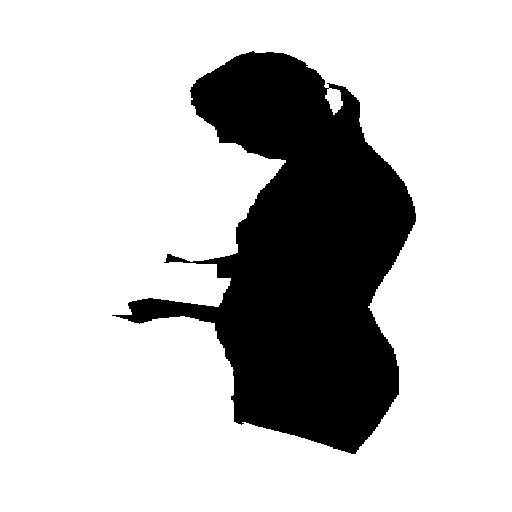

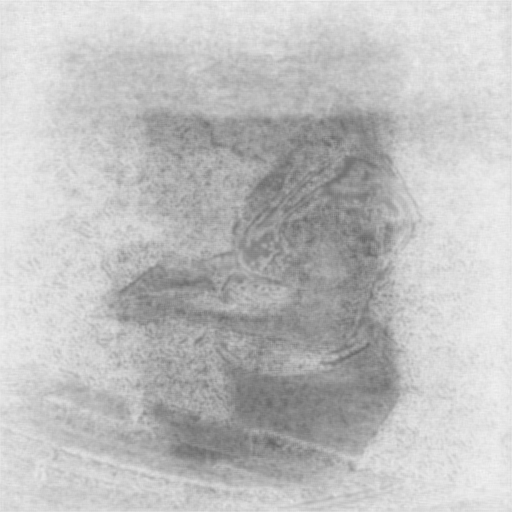

185 9701
186 9702
187 9703
188 9704
189 9705
190 9706
191 9707
192 9708
193 9709
194 9710
195 9711
196 9712
197 9713
198 9714
199 9715
200 9716
201 9717
202 9718
203 9719
204 9720
205 9721
206 9722
207 9723
208 9724
209 9725
210 9726
211 9727
212 9728
213 9729
214 9730
215 9731
216 9732
217 9733
218 9734
219 9735
220 9736
221 9737
222 9738
227 9743
228 9744
229 9745
230 9746
231 9747
232 9748
233 9749
234 9750
235 9751
236 9752
237 9753
238 9754
239 9755
240 9756
241 9757
242 9758
243 9759
244 9760
245 9761
246 9762
247 9763
248 9764
249 9765
250 9766
251 9767
252 9768
253 9769
254 9770
255 9771
256 9772
257 9773
258 9774
259 9775
260 9776
261 9777
262 9778
263 9779
264 9780
265 9781
266 9782
267 9783
268 9784
269 9785
270 9786
271 9787
272 9788
273 9789
274 9790
275 9791
276 9792
277 9793
278 9794
279 9795
280 9796
281 9797
282 9798
283 9799
284 9800
2008_005926


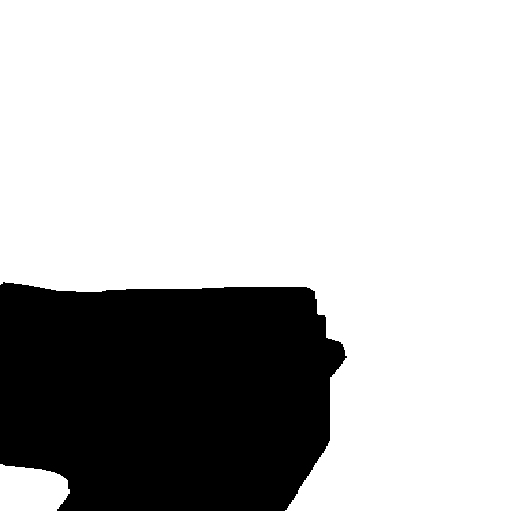

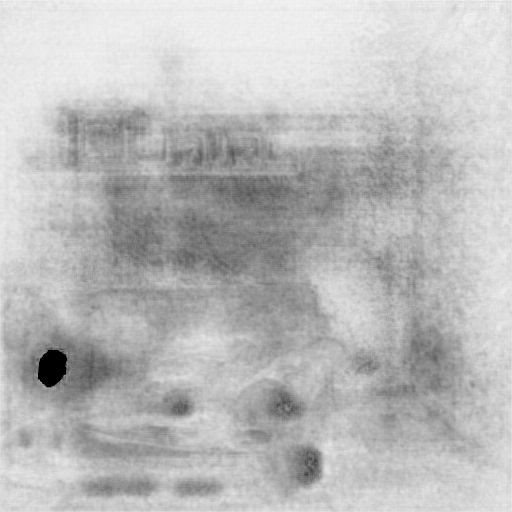

285 9801
286 9802
287 9803
288 9804
289 9805
290 9806
291 9807
292 9808
293 9809
294 9810
295 9811
296 9812
297 9813
298 9814
299 9815
300 9816
301 9817
302 9818
303 9819
304 9820
305 9821
306 9822
307 9823
308 9824
309 9825
310 9826
311 9827
312 9828
313 9829
314 9830
315 9831
316 9832
317 9833
318 9834
319 9835
320 9836
321 9837
322 9838
323 9839
324 9840
325 9841
326 9842
327 9843
328 9844
329 9845
330 9846
331 9847
332 9848
333 9849
334 9850
335 9851
336 9852
337 9853
338 9854
339 9855
340 9856
341 9857
342 9858
343 9859
344 9860
345 9861
346 9862
347 9863
348 9864
349 9865
350 9866
351 9867
352 9868
353 9869
354 9870
355 9871
356 9872
357 9873
358 9874
359 9875
360 9876
361 9877
362 9878
363 9879
364 9880
365 9881
366 9882
367 9883
368 9884
369 9885
370 9886
371 9887
372 9888
373 9889
374 9890
375 9891
376 9892
377 9893
378 9894
379 9895
380 9896
381 9897
382 9898
383 9899
384 9900
2009_002262


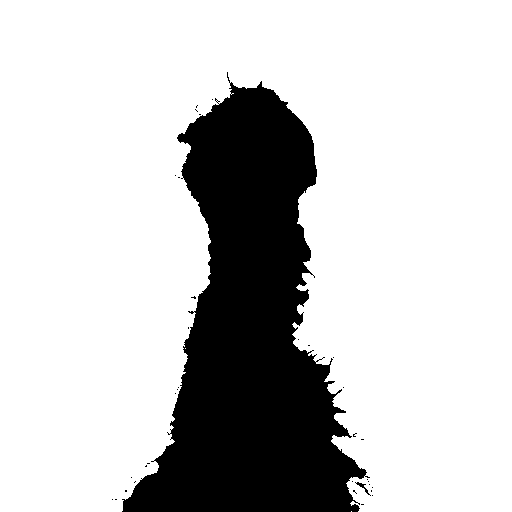

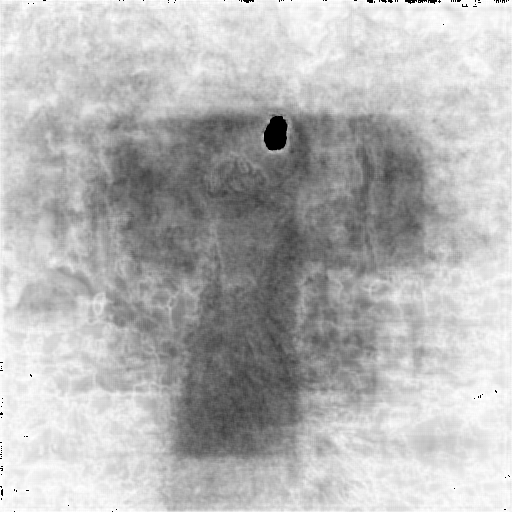

385 9901
386 9902
387 9903
388 9904
389 9905
390 9906
391 9907
392 9908
393 9909
394 9910
395 9911
396 9912
397 9913
398 9914
399 9915
400 9916
401 9917
402 9918
403 9919
404 9920
405 9921
406 9922
407 9923
408 9924
409 9925
410 9926
411 9927
412 9928
413 9929
414 9930
415 9931
416 9932
417 9933
418 9934
419 9935
420 9936
421 9937
422 9938
423 9939
424 9940
425 9941
426 9942
427 9943
428 9944
429 9945
430 9946
431 9947
432 9948
433 9949
434 9950
435 9951
436 9952
437 9953
438 9954
439 9955
440 9956
441 9957
442 9958
443 9959
444 9960
445 9961
446 9962
447 9963
448 9964
449 9965
450 9966
451 9967
452 9968
453 9969
454 9970
455 9971
456 9972
457 9973
458 9974
459 9975
460 9976
461 9977
462 9978
463 9979
464 9980
465 9981
466 9982
467 9983
468 9984
469 9985
470 9986
471 9987
472 9988
473 9989
474 9990
475 9991
476 9992
477 9993
478 9994
479 9995
480 9996
481 9997
482 9998
483 9999
484 10000
2010_000392


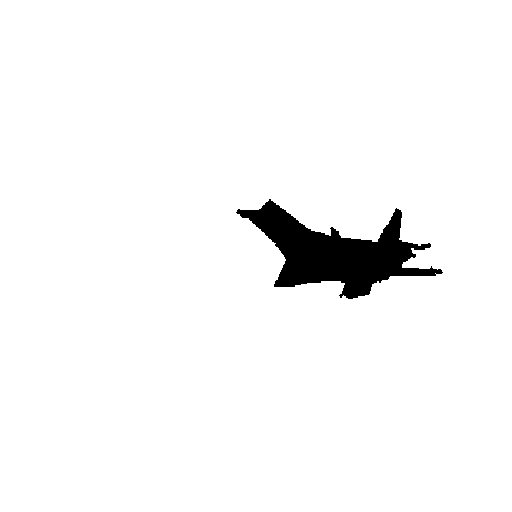

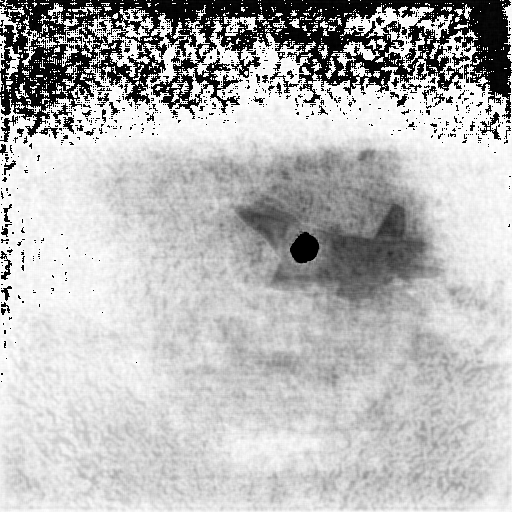

485 10001
486 10002
487 10003
488 10004
489 10005
490 10006
491 10007
492 10008
493 10009
494 10010
495 10011
496 10012
497 10013
498 10014
499 10015
500 10016
501 10017
502 10018
503 10019
504 10020
505 10021
506 10022
507 10023
508 10024
509 10025
510 10026
511 10027
512 10028
513 10029
514 10030
515 10031
516 10032
517 10033
518 10034
519 10035
520 10036
521 10037
522 10038
523 10039
524 10040
525 10041
526 10042
527 10043
528 10044
529 10045
530 10046
531 10047
532 10048
533 10049
534 10050
535 10051
536 10052
537 10053
538 10054
539 10055
540 10056
541 10057
542 10058
543 10059
544 10060
545 10061
546 10062
547 10063
548 10064
549 10065
550 10066
551 10067
552 10068
553 10069
554 10070
555 10071
556 10072
557 10073
558 10074
559 10075
560 10076
561 10077
562 10078
563 10079
564 10080
565 10081
566 10082
567 10083
568 10084
569 10085
570 10086
571 10087
572 10088
573 10089
574 10090
575 10091
576 10092
577 10093
578 10094
579 10095
580 10096
581 10097
582 10098
583 10099
584 10100


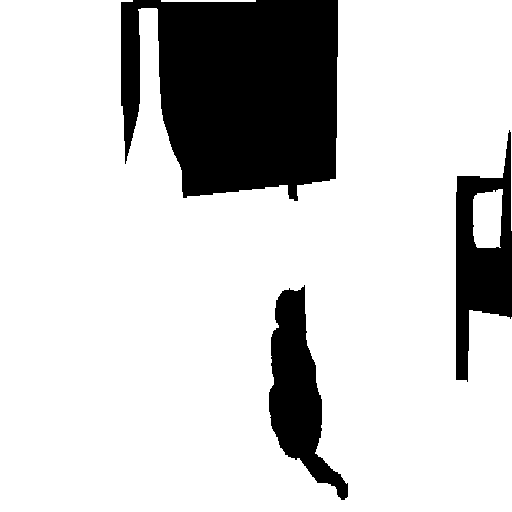

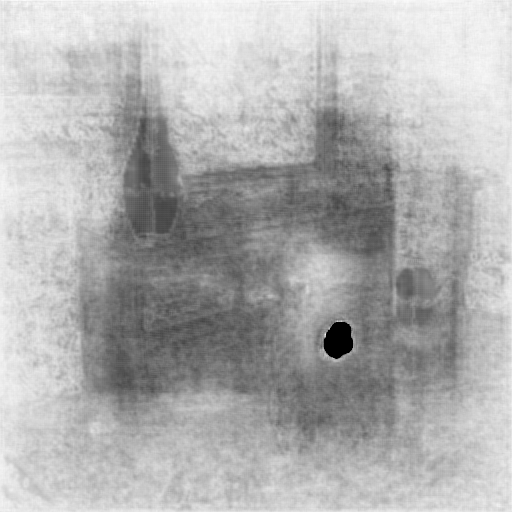

585 10101
586 10102
587 10103
588 10104
589 10105
590 10106
591 10107
592 10108
593 10109
594 10110
595 10111
596 10112
597 10113
598 10114
599 10115
600 10116
601 10117
602 10118
603 10119
604 10120
605 10121
606 10122
607 10123
608 10124
609 10125
610 10126
611 10127
612 10128
613 10129
614 10130
615 10131
616 10132
617 10133
618 10134
619 10135
620 10136
621 10137
622 10138
623 10139
624 10140
625 10141
626 10142
627 10143
628 10144
629 10145
630 10146
631 10147
632 10148
633 10149
634 10150
635 10151
636 10152
637 10153
638 10154
639 10155
640 10156
641 10157
642 10158
643 10159
644 10160
645 10161
646 10162
647 10163
648 10164
649 10165
650 10166
651 10167
652 10168
653 10169
654 10170
655 10171
656 10172
657 10173
658 10174
659 10175
660 10176
661 10177
662 10178
663 10179
664 10180
665 10181
666 10182
667 10183
668 10184
669 10185
670 10186
671 10187
672 10188
673 10189
674 10190
675 10191
676 10192
677 10193
678 10194
679 10195
680 10196
681 10197
682 10198
683 10199
684 10200


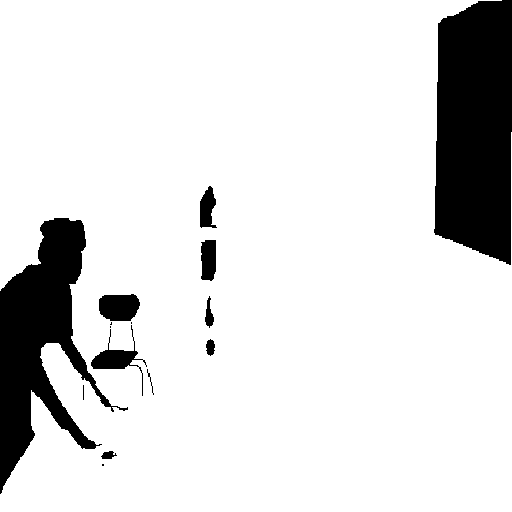

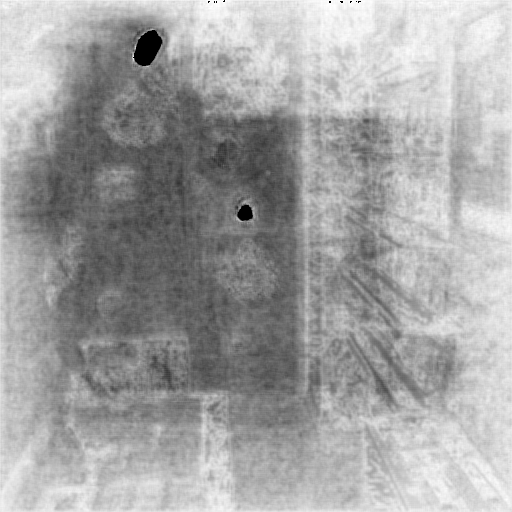

685 10201
686 10202
687 10203
688 10204
689 10205
690 10206
691 10207
692 10208
693 10209
694 10210
695 10211
696 10212
697 10213
698 10214
699 10215
700 10216
701 10217
702 10218
703 10219
704 10220
705 10221
706 10222
707 10223
708 10224
709 10225
710 10226
711 10227
712 10228
713 10229
714 10230
715 10231
716 10232
717 10233
718 10234
719 10235
720 10236
721 10237
722 10238
723 10239
724 10240
725 10241
726 10242
727 10243
728 10244
729 10245
730 10246
731 10247
0 10248
1 10249
2 10250
3 10251
4 10252
5 10253
6 10254
7 10255
8 10256
9 10257
10 10258
11 10259
12 10260
13 10261
14 10262
15 10263
16 10264
17 10265
18 10266
19 10267
20 10268
21 10269
22 10270
23 10271
24 10272
25 10273
26 10274
27 10275
28 10276
29 10277
30 10278
31 10279
32 10280
33 10281
34 10282
35 10283
36 10284
37 10285
38 10286
39 10287
40 10288
41 10289
42 10290
43 10291
44 10292
45 10293
46 10294
47 10295
48 10296
49 10297
50 10298
51 10299
52 10300
2007_003286


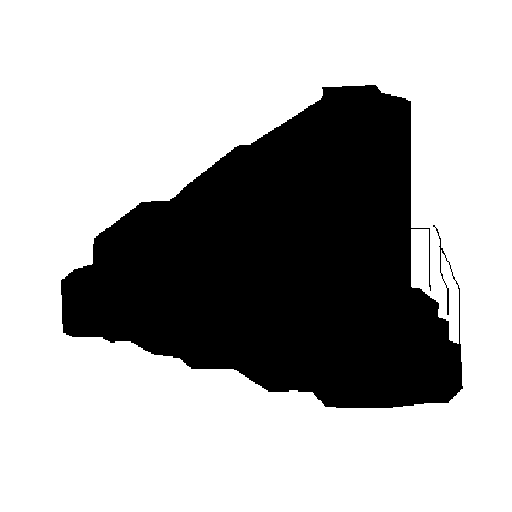

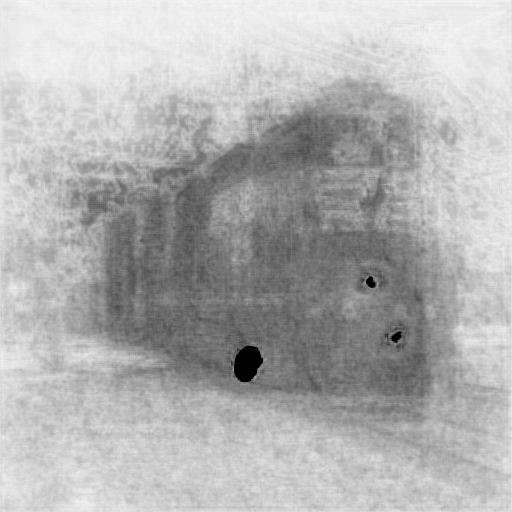

53 10301
54 10302
55 10303
56 10304
57 10305
58 10306
59 10307
60 10308
61 10309
62 10310
63 10311
64 10312
65 10313
66 10314
67 10315
68 10316
69 10317
70 10318
71 10319
72 10320
73 10321
74 10322
75 10323
76 10324
77 10325
78 10326
79 10327
80 10328
81 10329
82 10330
83 10331
84 10332
85 10333
86 10334
87 10335
88 10336
89 10337
90 10338
91 10339
92 10340
93 10341
94 10342
95 10343
96 10344
97 10345
98 10346
99 10347
100 10348
101 10349
102 10350
103 10351
104 10352
105 10353
106 10354
107 10355
108 10356
109 10357
110 10358
111 10359
112 10360
113 10361
114 10362
115 10363
116 10364
117 10365
118 10366
119 10367
120 10368
121 10369
122 10370
123 10371
124 10372
125 10373
126 10374
127 10375
128 10376
129 10377
130 10378
131 10379
132 10380
133 10381
134 10382
135 10383
136 10384
137 10385
138 10386
139 10387
140 10388
141 10389
142 10390
143 10391
144 10392
145 10393
146 10394
147 10395
148 10396
149 10397
150 10398
151 10399
152 10400
2007_009807


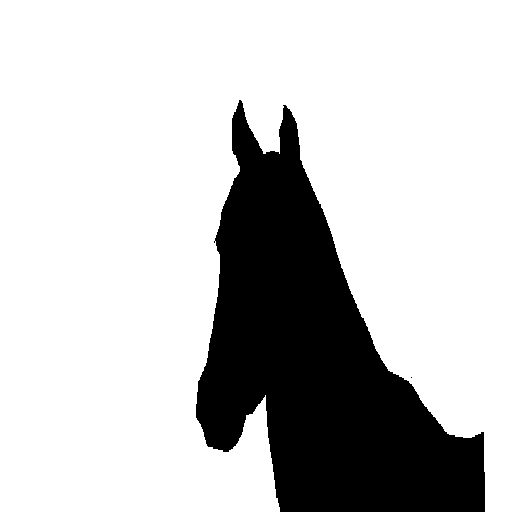

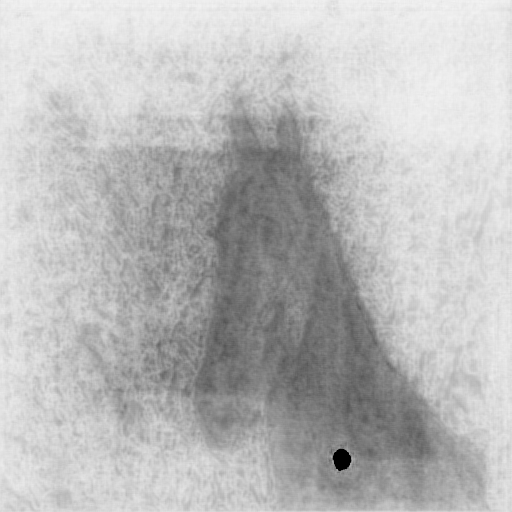

153 10401
154 10402
155 10403
156 10404
157 10405
158 10406
159 10407
160 10408
161 10409
162 10410
163 10411
164 10412
165 10413
166 10414
167 10415
168 10416
169 10417
170 10418
171 10419
172 10420
173 10421
174 10422
175 10423
176 10424
177 10425
178 10426
179 10427
180 10428
181 10429
182 10430
183 10431
184 10432
185 10433
186 10434
187 10435
188 10436
189 10437
190 10438
191 10439
192 10440
193 10441
194 10442
195 10443
196 10444
197 10445
198 10446
199 10447
200 10448
201 10449
202 10450
203 10451
204 10452
205 10453
206 10454
207 10455
208 10456
209 10457
210 10458
211 10459
212 10460
213 10461
214 10462
215 10463
216 10464
217 10465
218 10466
219 10467
220 10468
221 10469
222 10470
223 10471
224 10472
225 10473
226 10474
227 10475
228 10476
229 10477
230 10478
231 10479
232 10480
233 10481
234 10482
235 10483
236 10484
237 10485
238 10486
239 10487
240 10488
241 10489
242 10490
243 10491
244 10492
245 10493
246 10494
247 10495
248 10496
249 10497
250 10498
251 10499
252 10500


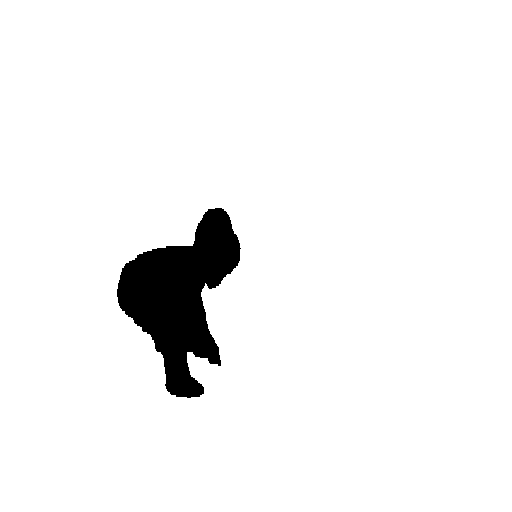

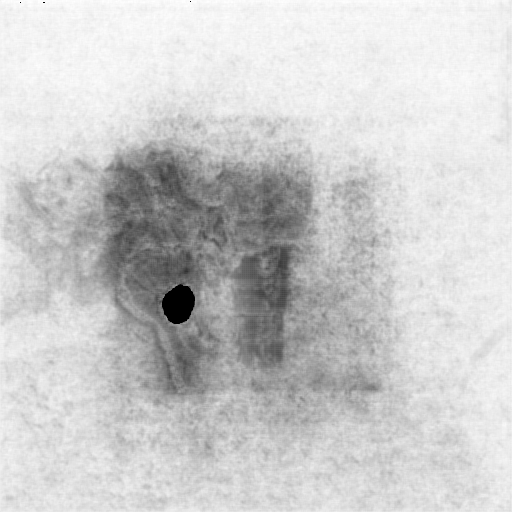

253 10501
254 10502
255 10503
256 10504
257 10505
258 10506
259 10507
260 10508
261 10509
262 10510
263 10511
264 10512
265 10513
266 10514
267 10515
268 10516
269 10517
270 10518
271 10519
272 10520
273 10521
274 10522
275 10523
276 10524
277 10525
278 10526
279 10527
280 10528
281 10529
282 10530
283 10531
284 10532
285 10533
286 10534
287 10535
288 10536
289 10537
290 10538
291 10539
292 10540
293 10541
294 10542
295 10543
296 10544
297 10545
298 10546
299 10547
300 10548
301 10549
302 10550
303 10551
304 10552
305 10553
306 10554
307 10555
308 10556
309 10557
310 10558
311 10559
312 10560
313 10561
314 10562
315 10563
316 10564
317 10565
318 10566
319 10567
320 10568
321 10569
322 10570
323 10571
324 10572
325 10573
326 10574
327 10575
328 10576
329 10577
330 10578
331 10579
332 10580
333 10581
334 10582
335 10583
336 10584
337 10585
338 10586
339 10587
340 10588
341 10589
342 10590
343 10591
344 10592
345 10593
346 10594
347 10595
348 10596
349 10597
350 10598
351 10599
352 10600


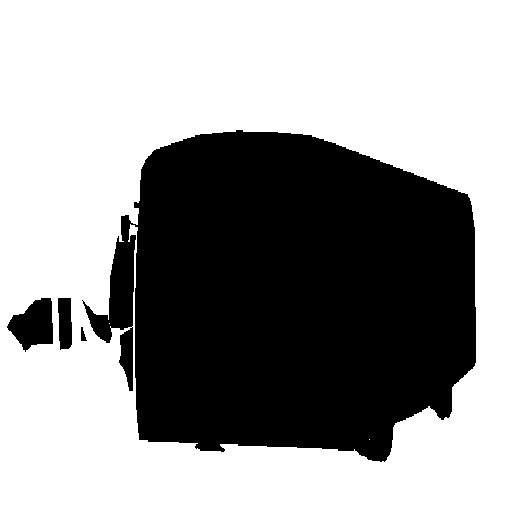

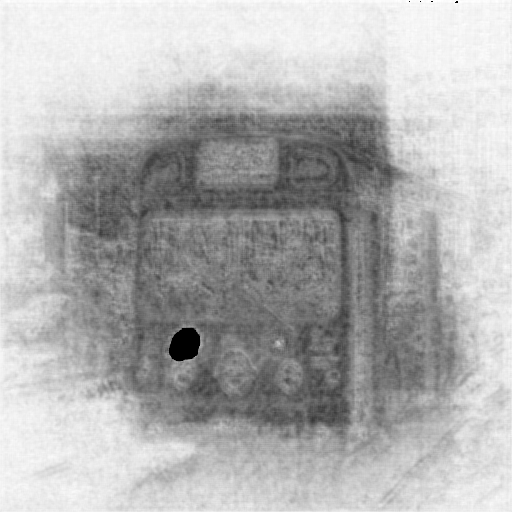

353 10601
354 10602
355 10603
356 10604
357 10605
358 10606
359 10607
360 10608
361 10609
362 10610
363 10611
364 10612
365 10613
366 10614
367 10615
368 10616
369 10617
370 10618
371 10619
372 10620
373 10621
374 10622
375 10623
376 10624
377 10625
378 10626
379 10627
380 10628
381 10629
382 10630
383 10631
384 10632
385 10633
386 10634
387 10635
388 10636
389 10637
390 10638
391 10639
392 10640
393 10641
394 10642
395 10643
396 10644
397 10645
398 10646
399 10647
400 10648
401 10649
402 10650
403 10651
404 10652
405 10653
406 10654
407 10655
408 10656
409 10657
410 10658
411 10659
412 10660
413 10661
414 10662
415 10663
416 10664
417 10665
418 10666
419 10667
420 10668
421 10669
422 10670
423 10671
424 10672
425 10673
426 10674
427 10675
428 10676
429 10677
430 10678
431 10679
432 10680
433 10681
434 10682
435 10683
436 10684
437 10685
438 10686
439 10687
440 10688
441 10689
442 10690
443 10691
444 10692
445 10693
446 10694
447 10695
448 10696
449 10697
450 10698
451 10699
452 10700


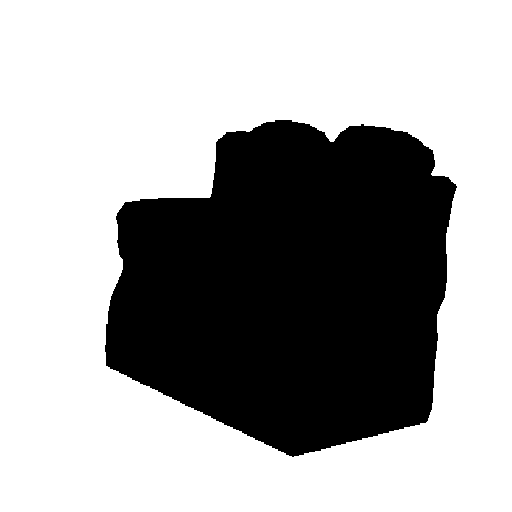

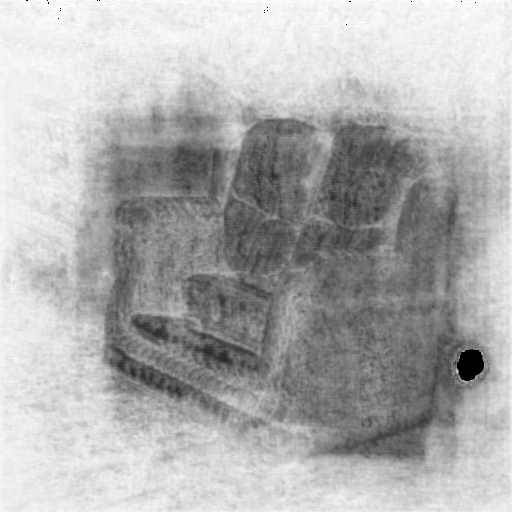

453 10701
454 10702
455 10703
456 10704
457 10705
458 10706
459 10707
460 10708
461 10709
462 10710
463 10711
464 10712
465 10713
466 10714
467 10715
468 10716
469 10717
470 10718
471 10719
472 10720
473 10721
474 10722
475 10723
476 10724
477 10725
478 10726
479 10727
480 10728
481 10729
482 10730
483 10731
484 10732
485 10733
486 10734
487 10735
488 10736
489 10737
490 10738
491 10739
492 10740
493 10741
494 10742
495 10743
496 10744
497 10745
498 10746
499 10747
500 10748
501 10749
502 10750
503 10751
504 10752
505 10753
506 10754
507 10755
508 10756
509 10757
510 10758
511 10759
512 10760
513 10761
514 10762
515 10763
516 10764
517 10765
518 10766
519 10767
520 10768
521 10769
522 10770
523 10771
524 10772
525 10773
526 10774
527 10775
528 10776
529 10777
530 10778
531 10779
532 10780
533 10781
534 10782
535 10783
536 10784
537 10785
538 10786
539 10787
540 10788
541 10789
542 10790
543 10791
544 10792
545 10793
546 10794
547 10795
548 10796
549 10797
550 10798
551 10799
552 10800


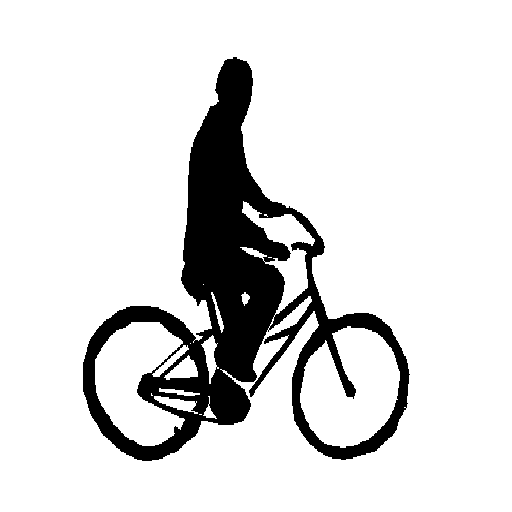

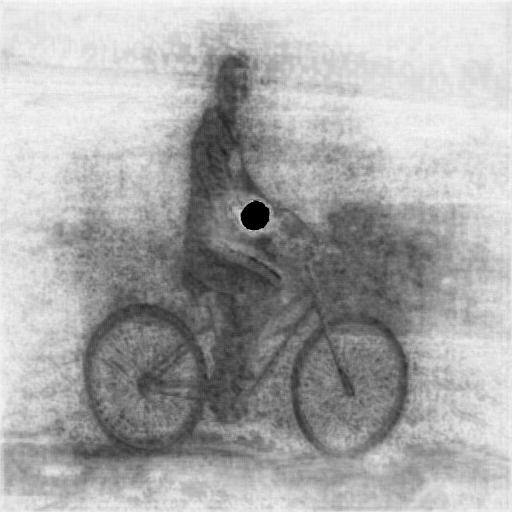

553 10801
554 10802
555 10803
556 10804
557 10805
558 10806
559 10807
560 10808
561 10809
562 10810
563 10811
564 10812
565 10813
566 10814
567 10815
568 10816
569 10817
570 10818
571 10819
572 10820
573 10821
574 10822
575 10823
576 10824
577 10825
578 10826
579 10827
580 10828
581 10829
582 10830
583 10831
584 10832
585 10833
586 10834
587 10835
588 10836
589 10837
590 10838
591 10839
592 10840
593 10841
594 10842
595 10843
596 10844
597 10845
598 10846
599 10847
600 10848
601 10849
602 10850
603 10851
604 10852
605 10853
606 10854
607 10855
608 10856
609 10857
610 10858
611 10859
612 10860
613 10861
614 10862
615 10863
616 10864
617 10865
618 10866
619 10867
620 10868
621 10869
622 10870
623 10871
624 10872
625 10873
626 10874
627 10875
628 10876
629 10877
630 10878
631 10879
632 10880
633 10881
634 10882
635 10883
636 10884
637 10885
638 10886
639 10887
640 10888
641 10889
642 10890
643 10891
644 10892
645 10893
646 10894
647 10895
648 10896
649 10897
650 10898
651 10899
652 10900


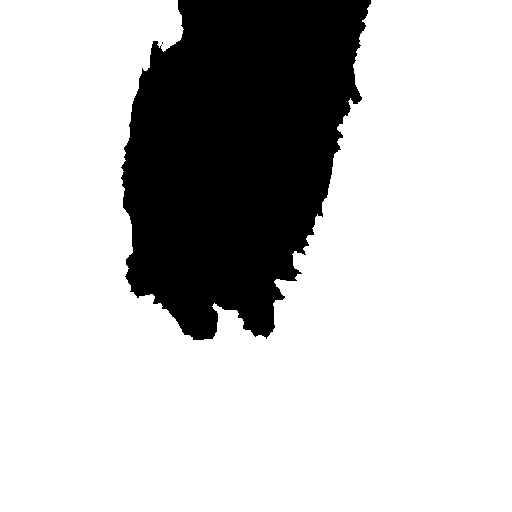

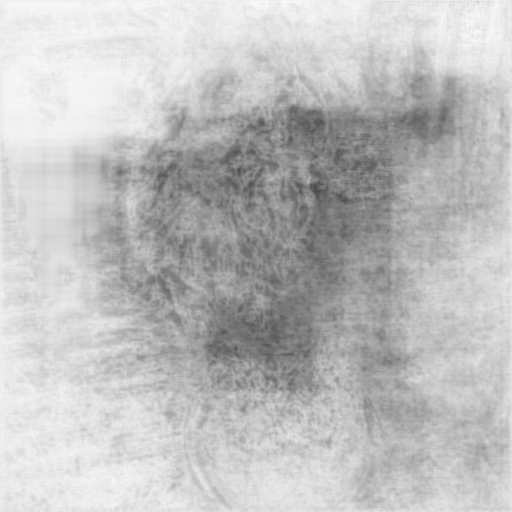

653 10901
654 10902
655 10903
656 10904
657 10905
658 10906
659 10907
660 10908
661 10909
662 10910
663 10911
664 10912
665 10913
666 10914
667 10915
668 10916
669 10917
670 10918
671 10919
672 10920
673 10921
674 10922
675 10923
676 10924
677 10925
678 10926
679 10927
680 10928
681 10929
682 10930
683 10931
684 10932
685 10933
686 10934
687 10935
688 10936
689 10937
690 10938
691 10939
692 10940
693 10941
694 10942
695 10943
696 10944
697 10945
698 10946
699 10947
700 10948
701 10949
702 10950
703 10951
704 10952
705 10953
706 10954
707 10955
708 10956
709 10957
710 10958
711 10959
712 10960
713 10961
714 10962
715 10963
716 10964
717 10965
718 10966
719 10967
720 10968
721 10969
722 10970
723 10971
724 10972
725 10973
726 10974
727 10975
728 10976
729 10977
730 10978
731 10979
0 10980
1 10981
2 10982
3 10983
4 10984
5 10985
6 10986
7 10987
8 10988
9 10989
10 10990
11 10991
12 10992
13 10993
14 10994
15 10995
16 10996
17 10997
18 10998
19 10999
20 11000
2007_001420


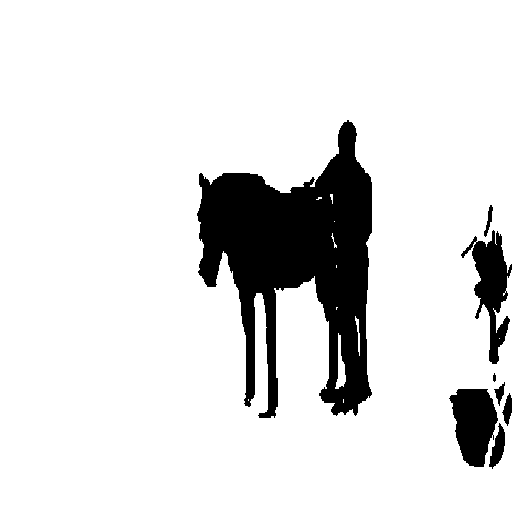

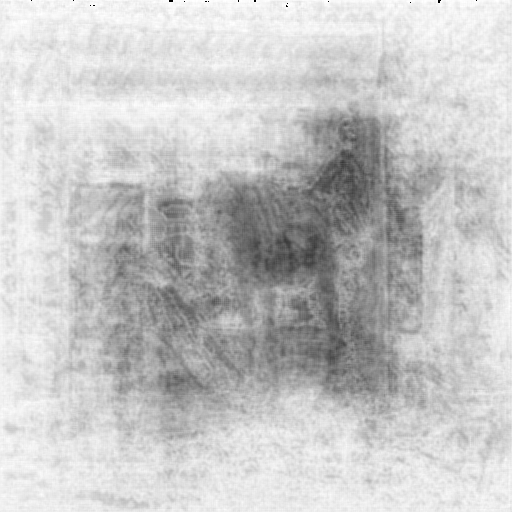

21 11001
22 11002
23 11003
24 11004
25 11005
26 11006
27 11007
28 11008
29 11009
30 11010
31 11011
32 11012
33 11013
34 11014
35 11015
36 11016
37 11017
38 11018
39 11019
40 11020
41 11021
42 11022
43 11023
44 11024
45 11025
46 11026
47 11027
48 11028
49 11029
50 11030
51 11031
52 11032
53 11033
54 11034
55 11035
56 11036
57 11037
58 11038
59 11039
60 11040
61 11041
62 11042
63 11043
64 11044
65 11045
66 11046
67 11047
68 11048
69 11049
70 11050
71 11051
72 11052
73 11053
74 11054
75 11055
76 11056
77 11057
78 11058
79 11059
80 11060
81 11061
82 11062
83 11063
84 11064
85 11065
86 11066
87 11067
88 11068
89 11069
90 11070
91 11071
92 11072
93 11073
94 11074
95 11075
96 11076
97 11077
98 11078
99 11079
100 11080
101 11081
102 11082
103 11083
104 11084
105 11085
106 11086
107 11087
108 11088
109 11089
110 11090
111 11091
112 11092
113 11093
114 11094
115 11095
116 11096
117 11097
118 11098
119 11099
120 11100
2007_007890


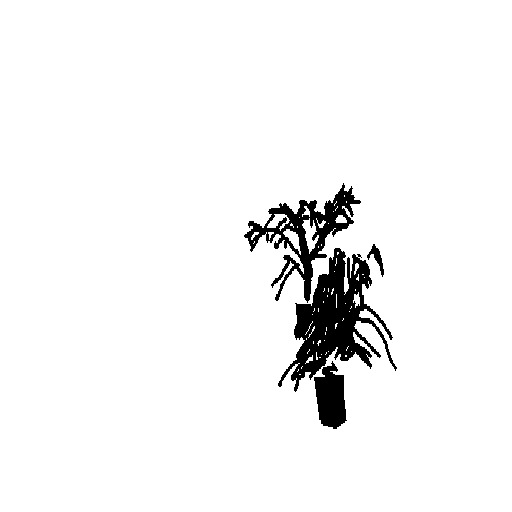

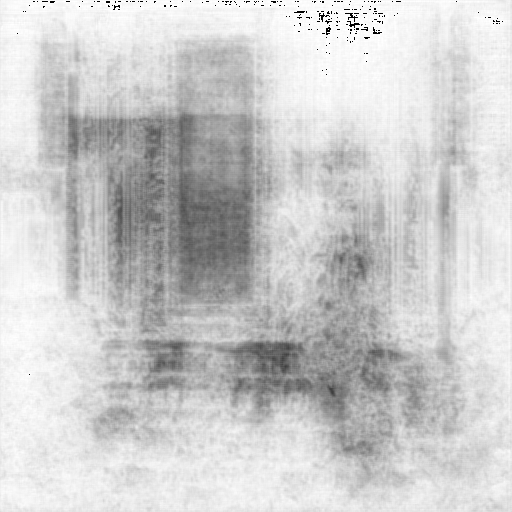

121 11101
122 11102
123 11103
124 11104
125 11105
126 11106
127 11107
128 11108
129 11109
130 11110
131 11111
132 11112
133 11113
134 11114
135 11115
136 11116
137 11117
138 11118
139 11119
140 11120
141 11121
142 11122
143 11123
144 11124
145 11125
146 11126
147 11127
148 11128
149 11129
150 11130
151 11131
152 11132
153 11133
154 11134
155 11135
156 11136
157 11137
158 11138
159 11139
160 11140
161 11141
162 11142
163 11143
164 11144
165 11145
166 11146
167 11147
168 11148
169 11149
170 11150
171 11151
172 11152
173 11153
174 11154
175 11155
176 11156
177 11157
178 11158
179 11159
180 11160
181 11161
182 11162
183 11163
184 11164
185 11165
186 11166
187 11167
188 11168
189 11169
190 11170
191 11171
192 11172
193 11173
194 11174
195 11175
196 11176
197 11177
198 11178
199 11179
200 11180
201 11181
202 11182
203 11183
204 11184
205 11185
206 11186
207 11187
208 11188
209 11189
210 11190
211 11191
212 11192
213 11193
214 11194
215 11195
216 11196
217 11197
218 11198
219 11199
220 11200


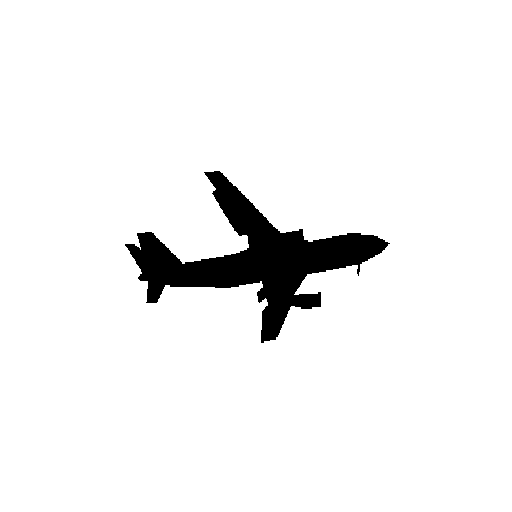

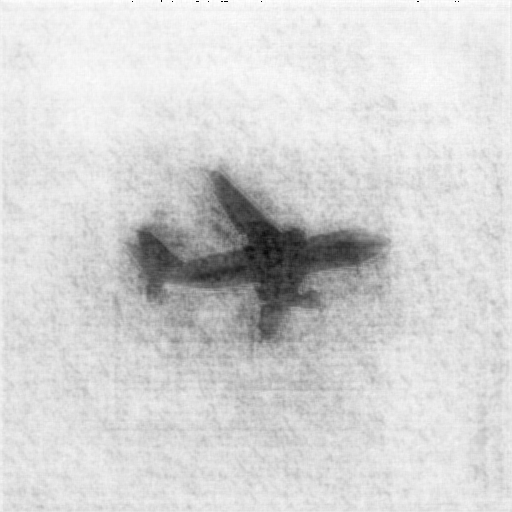

221 11201
222 11202
223 11203
224 11204
225 11205
226 11206
227 11207
228 11208
229 11209
230 11210
231 11211
232 11212
233 11213
234 11214
235 11215
236 11216
237 11217
238 11218
239 11219
240 11220
241 11221
242 11222
243 11223
244 11224
245 11225
246 11226
247 11227
248 11228
249 11229
250 11230
251 11231
252 11232
253 11233
254 11234
255 11235
256 11236
257 11237
258 11238
259 11239
260 11240
261 11241
262 11242
263 11243
264 11244
265 11245
266 11246
267 11247
268 11248
269 11249
270 11250
271 11251
272 11252
273 11253
274 11254
275 11255
276 11256
277 11257
278 11258
279 11259
280 11260
281 11261
282 11262
283 11263
284 11264
285 11265
286 11266
287 11267
288 11268
289 11269
290 11270
291 11271
292 11272
293 11273
294 11274
295 11275
296 11276
297 11277
298 11278
299 11279
300 11280
301 11281
302 11282
303 11283
304 11284
305 11285
306 11286
307 11287
308 11288
309 11289
310 11290
311 11291
312 11292
313 11293
314 11294
315 11295
316 11296
317 11297
318 11298
319 11299
320 11300


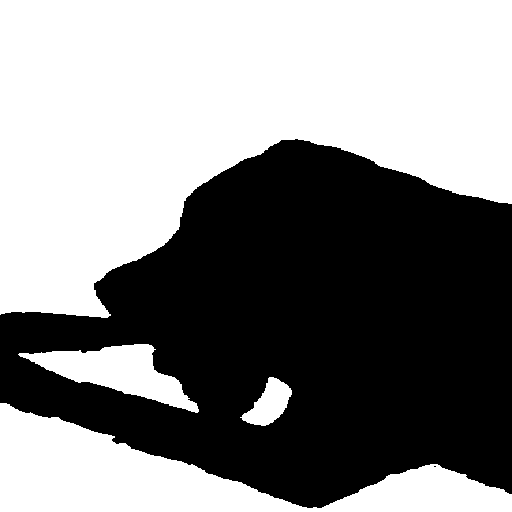

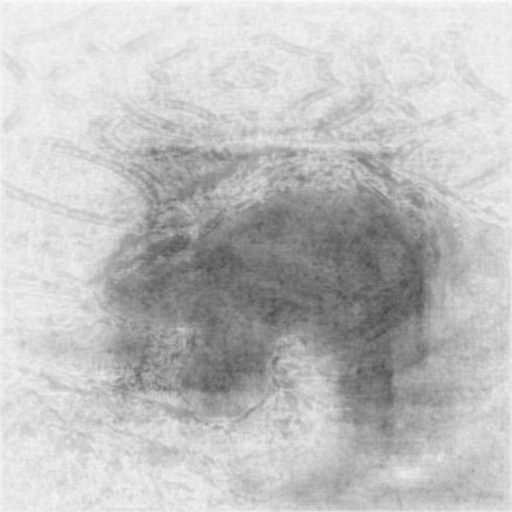

321 11301
322 11302
323 11303
324 11304
325 11305
326 11306
327 11307
328 11308
329 11309
330 11310
331 11311
332 11312
333 11313
334 11314
335 11315
336 11316
337 11317
338 11318
339 11319
340 11320
341 11321
342 11322
343 11323
344 11324
345 11325
346 11326
347 11327
348 11328
349 11329
350 11330
351 11331
352 11332
353 11333
354 11334
355 11335
356 11336
357 11337
358 11338
359 11339
360 11340
361 11341
362 11342
363 11343
364 11344
365 11345
366 11346
367 11347
368 11348
369 11349
370 11350
371 11351
372 11352
373 11353
374 11354
375 11355
376 11356
377 11357
378 11358
379 11359
380 11360
381 11361
382 11362
383 11363
384 11364
385 11365
386 11366
387 11367
388 11368
389 11369
390 11370
391 11371
392 11372
393 11373
394 11374
395 11375
396 11376
397 11377
398 11378
399 11379
400 11380
401 11381
402 11382
403 11383
404 11384
405 11385
406 11386
407 11387
408 11388
409 11389
410 11390
411 11391
412 11392
413 11393
414 11394
415 11395
416 11396
417 11397
418 11398
419 11399
420 11400


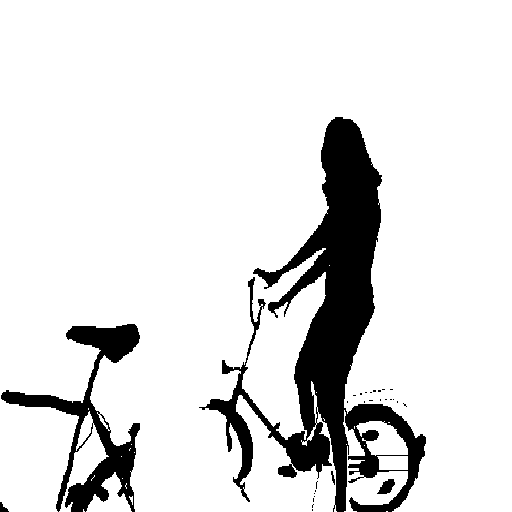

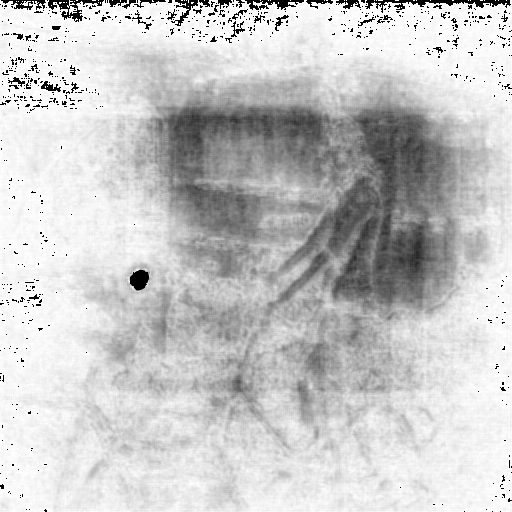

421 11401
422 11402
423 11403
424 11404
425 11405
426 11406
427 11407
428 11408
429 11409
430 11410
431 11411
432 11412
433 11413
434 11414
435 11415
436 11416
437 11417
438 11418
439 11419
440 11420
441 11421
442 11422
443 11423
444 11424
445 11425
446 11426
447 11427
448 11428
449 11429
450 11430
451 11431
452 11432
453 11433
454 11434
455 11435
456 11436
457 11437
458 11438
459 11439
460 11440
461 11441
462 11442
463 11443
464 11444
465 11445
466 11446
467 11447
468 11448
469 11449
470 11450
471 11451
472 11452
473 11453
474 11454
475 11455
476 11456
477 11457
478 11458
479 11459
480 11460
481 11461
482 11462
483 11463
484 11464
485 11465
486 11466
487 11467
488 11468
489 11469
490 11470
491 11471
492 11472
493 11473
494 11474
495 11475
496 11476
497 11477
498 11478
499 11479
500 11480
501 11481
502 11482
503 11483
504 11484
505 11485
506 11486
507 11487
508 11488
509 11489
510 11490
511 11491
512 11492
513 11493
514 11494
515 11495
516 11496
517 11497
518 11498
519 11499
520 11500


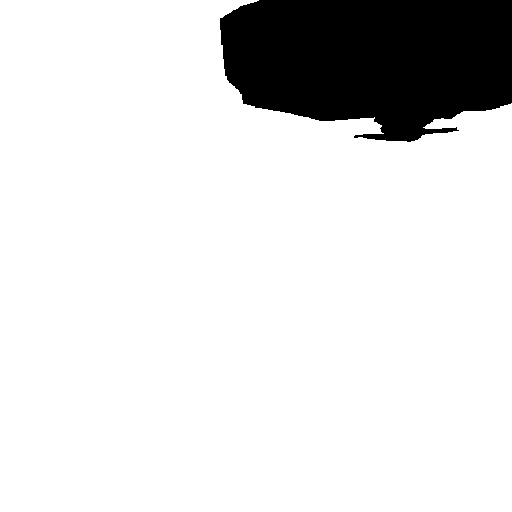

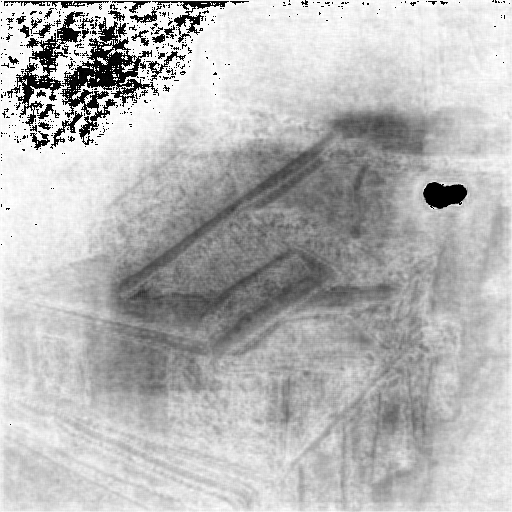

521 11501
522 11502
523 11503
524 11504
525 11505
526 11506
527 11507
528 11508
529 11509
530 11510
531 11511
532 11512
533 11513
534 11514
535 11515
536 11516
537 11517
538 11518
539 11519
540 11520
541 11521
542 11522
543 11523
544 11524
545 11525
546 11526
547 11527
548 11528
549 11529
550 11530
551 11531
552 11532
553 11533
554 11534
555 11535
556 11536
557 11537
558 11538
559 11539
560 11540
561 11541
562 11542
563 11543
564 11544
565 11545
566 11546
567 11547
568 11548
569 11549
570 11550
571 11551
572 11552
573 11553
574 11554
575 11555
576 11556
577 11557
578 11558
579 11559
580 11560
581 11561
582 11562
583 11563
584 11564
585 11565
586 11566
587 11567
588 11568
589 11569
590 11570
591 11571
592 11572
593 11573
594 11574
595 11575
596 11576
597 11577
598 11578
599 11579
600 11580
601 11581
602 11582
603 11583
604 11584
605 11585
606 11586
607 11587
608 11588
609 11589
610 11590
611 11591
612 11592
613 11593
614 11594
615 11595
616 11596
617 11597
618 11598
619 11599
620 11600


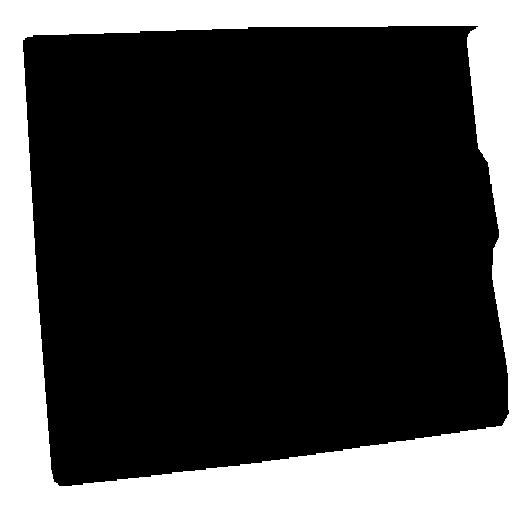

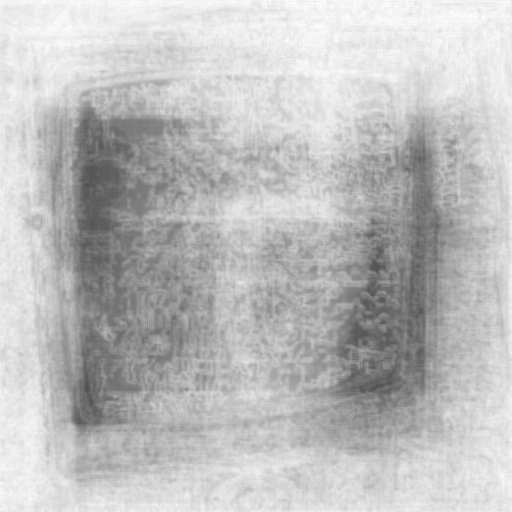

621 11601
622 11602
623 11603
624 11604
625 11605
626 11606
627 11607
628 11608
629 11609
630 11610
631 11611
632 11612
633 11613
634 11614
635 11615
636 11616
637 11617
638 11618
639 11619
640 11620
641 11621
642 11622
643 11623
644 11624
645 11625
646 11626
647 11627
648 11628
649 11629
650 11630
651 11631
652 11632
653 11633
654 11634
655 11635
656 11636
657 11637
658 11638
659 11639
660 11640
661 11641
662 11642
663 11643
664 11644
665 11645
666 11646
667 11647
668 11648
669 11649
670 11650
671 11651
672 11652
673 11653
674 11654
675 11655
676 11656
677 11657
678 11658
679 11659
680 11660
681 11661
682 11662
683 11663
684 11664
685 11665
686 11666
687 11667
688 11668
689 11669
690 11670
691 11671
692 11672
693 11673
694 11674
695 11675
696 11676
697 11677
698 11678
699 11679
700 11680
701 11681
702 11682
703 11683
704 11684
705 11685
706 11686
707 11687
708 11688
709 11689
710 11690
711 11691
712 11692
713 11693
714 11694
715 11695
716 11696
717 11697
718 11698
719 11699
720 11700


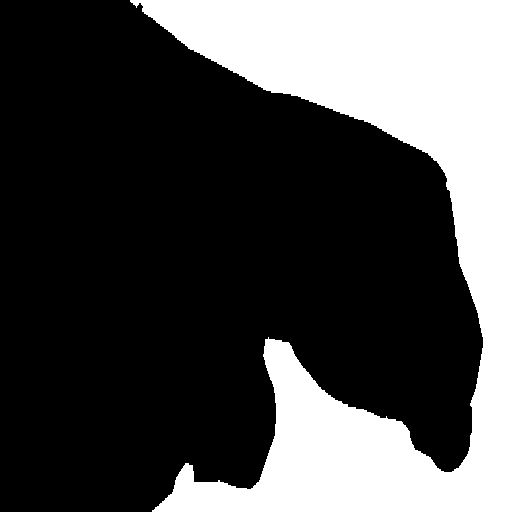

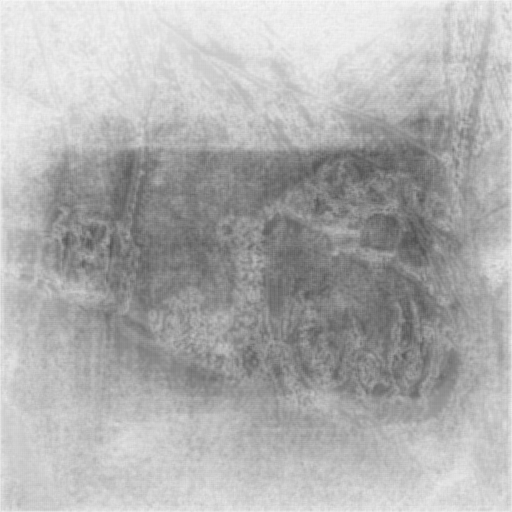

721 11701
722 11702
723 11703
724 11704
725 11705
726 11706
727 11707
728 11708
729 11709
730 11710
731 11711
0 11712
1 11713
2 11714
3 11715
4 11716
5 11717
6 11718
7 11719
8 11720
9 11721
10 11722
11 11723
12 11724
13 11725
14 11726
15 11727
16 11728
17 11729
18 11730
19 11731
20 11732
21 11733
22 11734
23 11735
24 11736
25 11737
26 11738
27 11739
28 11740
29 11741
30 11742
31 11743
32 11744
33 11745
34 11746
35 11747
36 11748
37 11749
38 11750
39 11751
40 11752
41 11753
42 11754
43 11755
44 11756
45 11757
46 11758
47 11759
48 11760
49 11761
50 11762
51 11763
52 11764
53 11765
54 11766
55 11767
56 11768
57 11769
58 11770
59 11771
60 11772
61 11773
62 11774
63 11775
64 11776
65 11777
66 11778
67 11779
68 11780
69 11781
70 11782
71 11783
72 11784
73 11785
74 11786
75 11787
76 11788
77 11789
78 11790
79 11791
80 11792
81 11793
82 11794
83 11795
84 11796
85 11797
86 11798
87 11799
88 11800
2007_005951


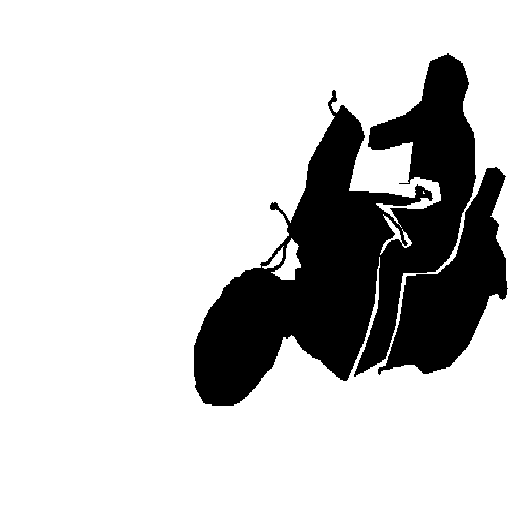

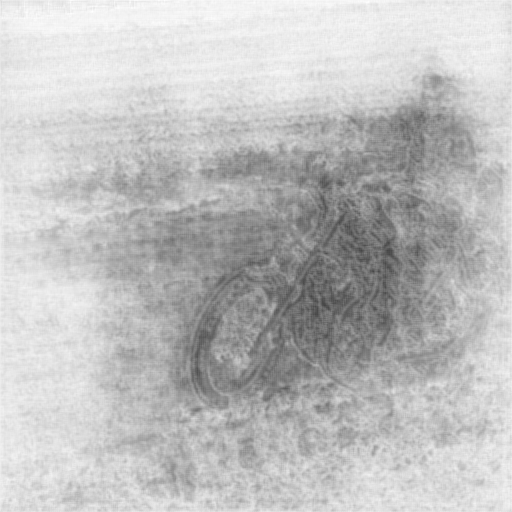

89 11801
90 11802
91 11803
92 11804
93 11805
94 11806
95 11807
96 11808
97 11809
98 11810
99 11811
100 11812
101 11813
102 11814
103 11815
104 11816
105 11817
106 11818
107 11819
108 11820
109 11821
110 11822
111 11823
112 11824
113 11825
114 11826
115 11827
116 11828
117 11829
118 11830
119 11831
120 11832
121 11833
122 11834
123 11835
124 11836
125 11837
126 11838
127 11839
128 11840
129 11841
130 11842
131 11843
132 11844
133 11845
134 11846
135 11847
136 11848
137 11849
138 11850
139 11851
140 11852
141 11853
142 11854
143 11855
144 11856
145 11857
146 11858
147 11859
148 11860
149 11861
150 11862
151 11863
152 11864
153 11865
154 11866
155 11867
156 11868
157 11869
158 11870
159 11871
160 11872
161 11873
162 11874
163 11875
164 11876
165 11877
166 11878
167 11879
168 11880
169 11881
170 11882
171 11883
172 11884
173 11885
174 11886
175 11887
176 11888
177 11889
178 11890
179 11891
180 11892
181 11893
182 11894
183 11895
184 11896
185 11897
186 11898
187 11899
188 11900
2008_001030

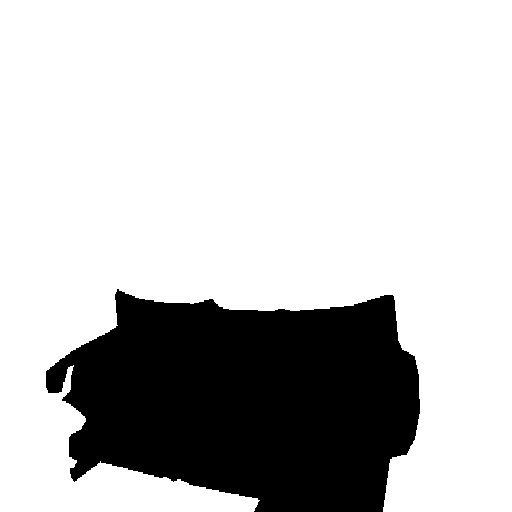

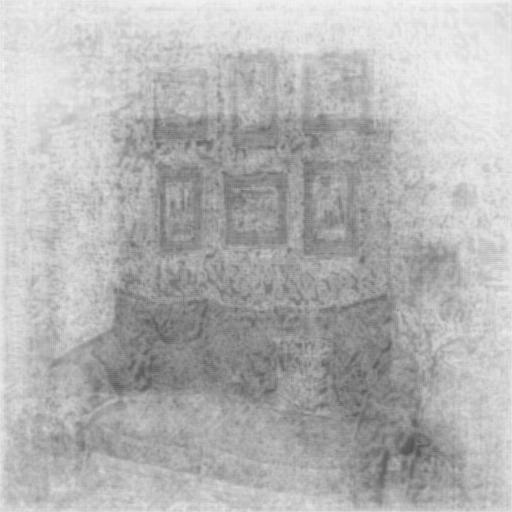

189 11901
190 11902
191 11903
192 11904
193 11905
194 11906
195 11907
196 11908
197 11909
198 11910
199 11911
200 11912
201 11913
202 11914
203 11915
204 11916
205 11917
206 11918
207 11919
208 11920
209 11921
210 11922
211 11923
212 11924
213 11925
214 11926
215 11927
216 11928
217 11929
218 11930
219 11931
220 11932
221 11933
222 11934
223 11935
224 11936
225 11937
226 11938
227 11939
228 11940
229 11941
230 11942
231 11943
232 11944
233 11945
234 11946
235 11947
236 11948
237 11949
238 11950
239 11951
240 11952
241 11953
242 11954
243 11955
244 11956
245 11957
246 11958
247 11959
248 11960
249 11961
250 11962
251 11963
252 11964
253 11965
254 11966
255 11967
256 11968
257 11969
258 11970
259 11971
260 11972
261 11973
262 11974
263 11975
264 11976
265 11977
266 11978
267 11979
268 11980
269 11981
270 11982
271 11983
272 11984
273 11985
274 11986
275 11987
276 11988
277 11989
278 11990
279 11991
280 11992
281 11993
282 11994
283 11995
284 11996
285 11997
286 11998
287 11999
288 12000


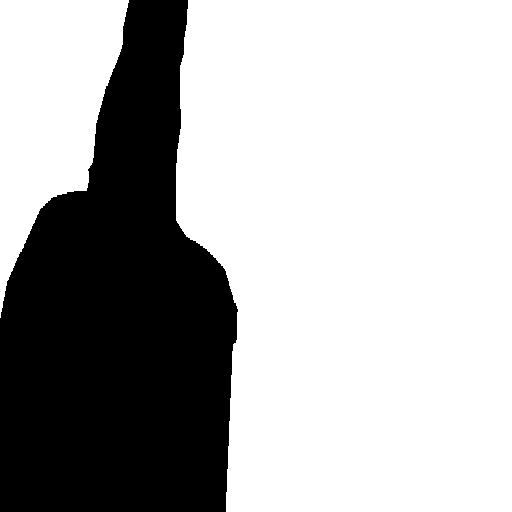

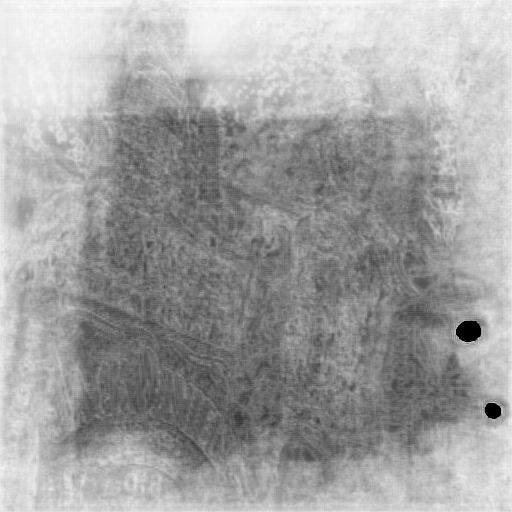

289 12001
290 12002
291 12003
292 12004
293 12005
294 12006
295 12007
296 12008
297 12009
298 12010
299 12011
300 12012
301 12013
302 12014
303 12015
304 12016
305 12017
306 12018
307 12019
308 12020
309 12021
310 12022
311 12023
312 12024
313 12025
314 12026
315 12027
316 12028
317 12029
318 12030
319 12031
320 12032
321 12033
322 12034
323 12035
324 12036
325 12037
326 12038
327 12039
328 12040
329 12041
330 12042
331 12043
332 12044
333 12045
334 12046
335 12047
336 12048
337 12049
338 12050
339 12051
340 12052
341 12053
342 12054
343 12055
344 12056
345 12057
346 12058
347 12059
348 12060
349 12061
350 12062
351 12063
352 12064
353 12065
354 12066
355 12067
356 12068
357 12069
358 12070
359 12071
360 12072
361 12073
362 12074
363 12075
364 12076
365 12077
366 12078
367 12079
368 12080
369 12081
370 12082
371 12083
372 12084
373 12085
374 12086
375 12087
376 12088
377 12089
378 12090
379 12091
380 12092
381 12093
382 12094
383 12095
384 12096
385 12097
386 12098
387 12099
388 12100


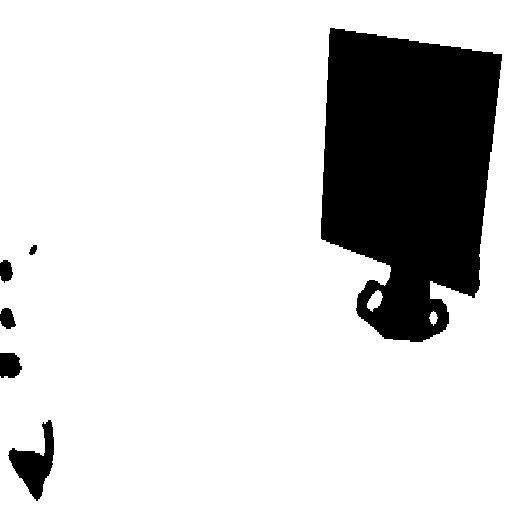

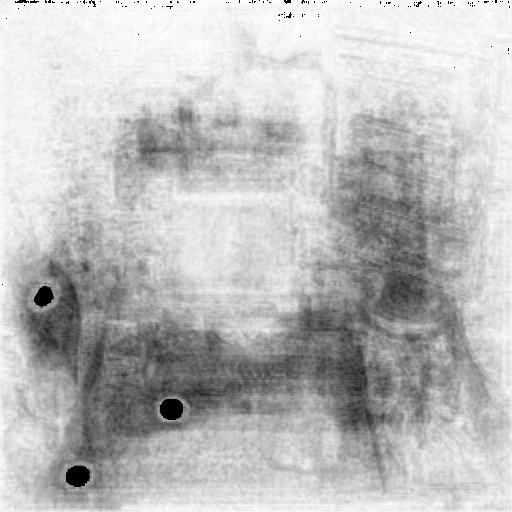

389 12101
390 12102
391 12103
392 12104
393 12105
394 12106
395 12107
396 12108
397 12109
398 12110
399 12111
400 12112
401 12113
402 12114
403 12115
404 12116
405 12117
406 12118
407 12119
408 12120
409 12121
410 12122
411 12123
412 12124
413 12125
414 12126
415 12127
416 12128
417 12129
418 12130
419 12131
420 12132
421 12133
422 12134
423 12135
424 12136
425 12137
426 12138
427 12139
428 12140
429 12141
430 12142
431 12143
432 12144
433 12145
434 12146
435 12147
436 12148
437 12149
438 12150
439 12151
440 12152
441 12153
442 12154
443 12155
444 12156
445 12157
446 12158
447 12159
448 12160
449 12161
450 12162
451 12163
452 12164
453 12165
454 12166
455 12167
456 12168
457 12169
458 12170
459 12171
460 12172
461 12173
462 12174
463 12175
464 12176
465 12177
466 12178
467 12179
468 12180
469 12181
470 12182
471 12183
472 12184
473 12185
474 12186
475 12187
476 12188
477 12189
478 12190
479 12191
480 12192
481 12193
482 12194
483 12195
484 12196
485 12197
486 12198
487 12199
488 12200


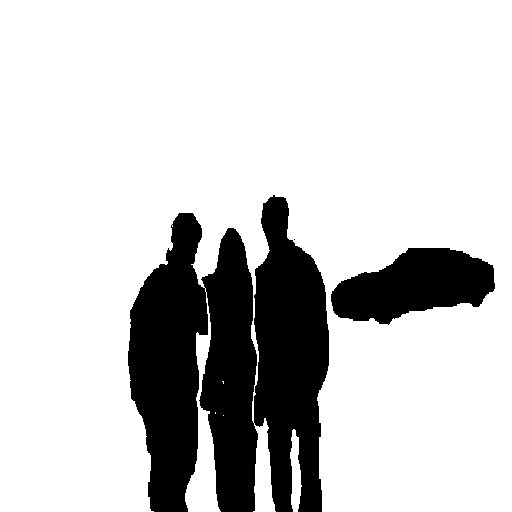

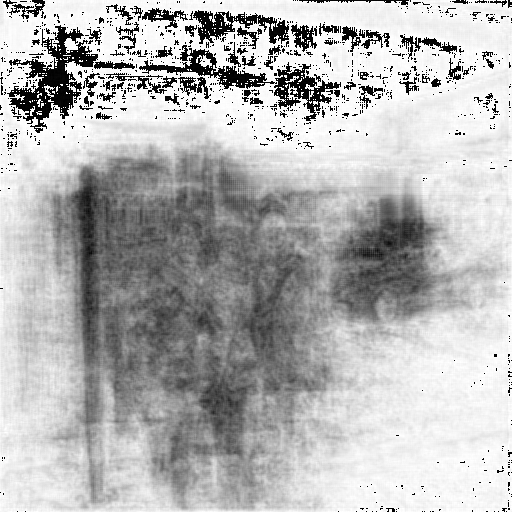

489 12201
490 12202
491 12203
492 12204
493 12205
494 12206
495 12207
496 12208
497 12209
498 12210
499 12211
500 12212
501 12213
502 12214
503 12215
504 12216
505 12217
506 12218
507 12219
508 12220
509 12221
510 12222
511 12223
512 12224
513 12225
514 12226
515 12227
516 12228
517 12229
518 12230
519 12231
520 12232
521 12233
522 12234
523 12235
524 12236
525 12237
526 12238
527 12239
528 12240
529 12241
530 12242
531 12243
532 12244
533 12245
534 12246
535 12247
536 12248
537 12249
538 12250
539 12251
540 12252
541 12253
542 12254
543 12255
544 12256
545 12257
546 12258
547 12259
548 12260
549 12261
550 12262
551 12263
552 12264
553 12265
554 12266
555 12267
556 12268
557 12269
558 12270
559 12271
560 12272
561 12273
562 12274
563 12275
564 12276
565 12277
566 12278
567 12279
568 12280
569 12281
570 12282
571 12283
572 12284
573 12285
574 12286
575 12287
576 12288
577 12289
578 12290
579 12291
580 12292
581 12293
582 12294
583 12295
584 12296
585 12297
586 12298
587 12299
588 12300


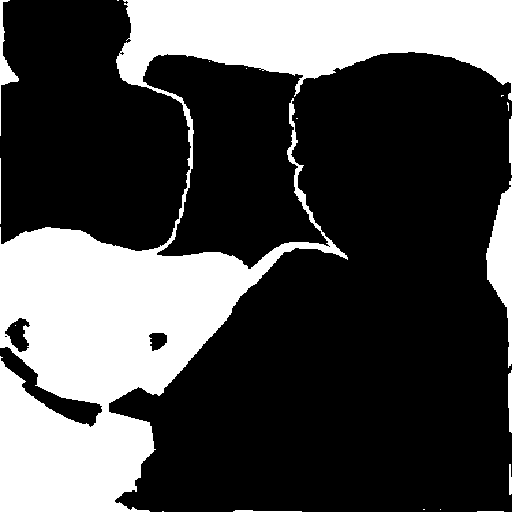

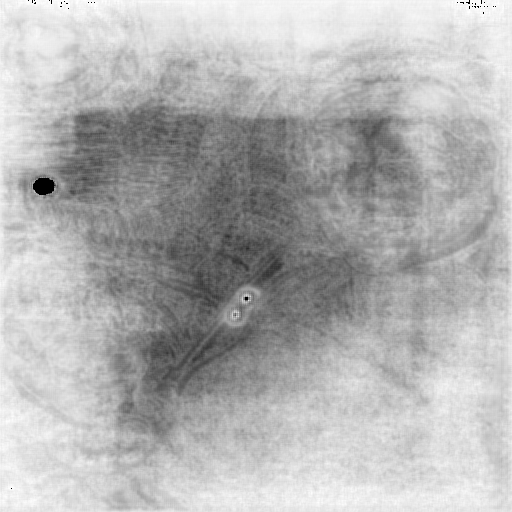

589 12301
590 12302
591 12303
592 12304
593 12305
594 12306
595 12307
596 12308
597 12309
598 12310
599 12311
600 12312
601 12313
602 12314
603 12315
604 12316
605 12317
606 12318
607 12319
608 12320
609 12321
610 12322
611 12323
612 12324
613 12325
614 12326
615 12327
616 12328
617 12329
618 12330
619 12331
620 12332
621 12333
622 12334
623 12335
624 12336
625 12337
626 12338
627 12339
628 12340
629 12341
630 12342
631 12343
632 12344
633 12345
634 12346
635 12347
636 12348
637 12349
638 12350
639 12351
640 12352
641 12353
642 12354
643 12355
644 12356
645 12357
646 12358
647 12359
648 12360
649 12361
650 12362
651 12363
652 12364
653 12365
654 12366
655 12367
656 12368
657 12369
658 12370
659 12371
660 12372
661 12373
662 12374
663 12375
664 12376
665 12377
666 12378
667 12379
668 12380
669 12381
670 12382
671 12383
672 12384
673 12385
674 12386
675 12387
676 12388
677 12389
678 12390
679 12391
680 12392
681 12393
682 12394
683 12395
684 12396
685 12397
686 12398
687 12399
688 12400


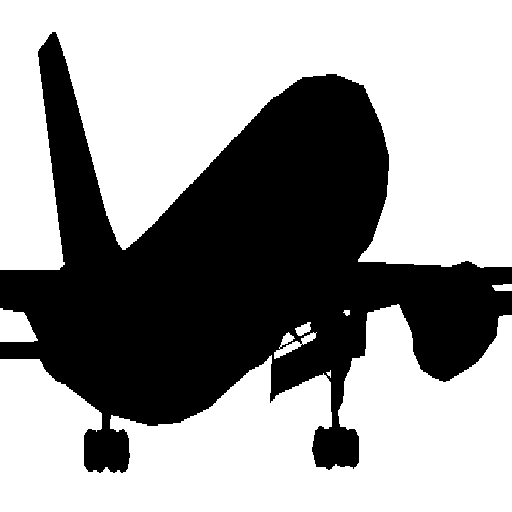

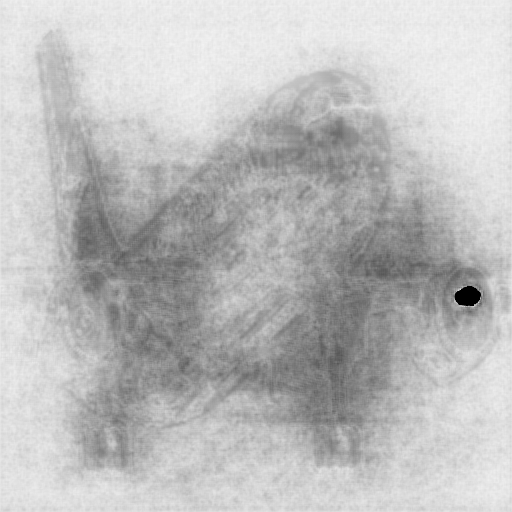

689 12401
690 12402
691 12403
692 12404
693 12405
694 12406
695 12407
696 12408
697 12409
698 12410
699 12411
700 12412
701 12413
702 12414
703 12415
704 12416
705 12417
706 12418
707 12419
708 12420
709 12421
710 12422
711 12423
712 12424
713 12425
714 12426
715 12427
716 12428
717 12429
718 12430
719 12431
720 12432
721 12433
722 12434
723 12435
724 12436
725 12437
726 12438
727 12439
728 12440
729 12441
730 12442
731 12443
0 12444
1 12445
2 12446
3 12447
4 12448
5 12449
6 12450
7 12451
8 12452
9 12453
10 12454
11 12455
12 12456
13 12457
14 12458
15 12459
16 12460
17 12461
18 12462
19 12463
20 12464
21 12465
22 12466
23 12467
24 12468
25 12469
26 12470
27 12471
28 12472
29 12473
30 12474
31 12475
32 12476
33 12477
34 12478
35 12479
36 12480
37 12481
38 12482
39 12483
40 12484
41 12485
42 12486
43 12487
44 12488
45 12489
46 12490
47 12491
48 12492
49 12493
50 12494
51 12495
52 12496
53 12497
54 12498
55 12499
56 12500
2007_003580


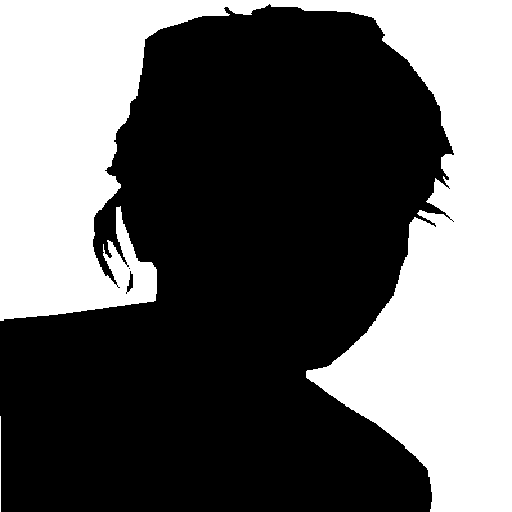

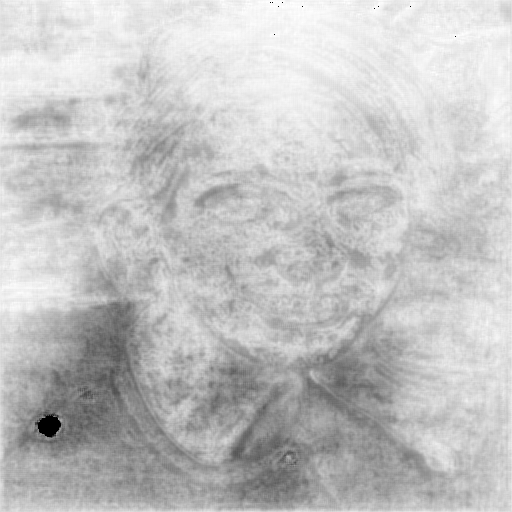

57 12501
58 12502
59 12503
60 12504
61 12505
62 12506
63 12507
64 12508
65 12509
66 12510
67 12511
68 12512
69 12513
70 12514
71 12515
72 12516
73 12517
74 12518
75 12519
76 12520
77 12521
78 12522
79 12523
80 12524
81 12525
82 12526
83 12527
84 12528
85 12529
86 12530
87 12531
88 12532
89 12533
90 12534
91 12535
92 12536
93 12537
94 12538
95 12539
96 12540
97 12541
98 12542
99 12543
100 12544
101 12545
102 12546
103 12547
104 12548
105 12549
106 12550
107 12551
108 12552
109 12553
110 12554
111 12555
112 12556
113 12557
114 12558
115 12559
116 12560
117 12561
118 12562
119 12563
120 12564
121 12565
122 12566
123 12567
124 12568
125 12569
126 12570
127 12571
128 12572
129 12573
130 12574
131 12575
132 12576
133 12577
134 12578
135 12579
136 12580
137 12581
138 12582
139 12583
140 12584
141 12585
142 12586
143 12587
144 12588
145 12589
146 12590
147 12591
148 12592
149 12593
150 12594
151 12595
152 12596
153 12597
154 12598
155 12599
156 12600
2008_000019


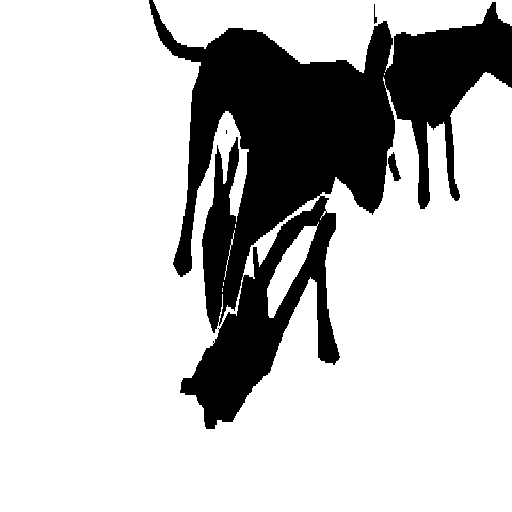

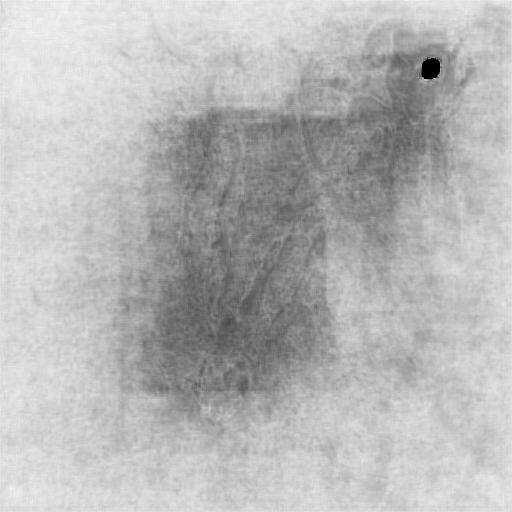

157 12601
158 12602
159 12603
160 12604
161 12605
162 12606
163 12607
164 12608
165 12609
166 12610
167 12611
168 12612
169 12613
170 12614
171 12615
172 12616
173 12617
174 12618
175 12619
176 12620
177 12621
178 12622
179 12623
180 12624
181 12625
182 12626
183 12627
184 12628
185 12629
186 12630
187 12631
188 12632
189 12633
190 12634
191 12635
192 12636
193 12637
194 12638
195 12639
196 12640
197 12641
198 12642
199 12643
200 12644
201 12645
202 12646
203 12647
204 12648
205 12649
206 12650
207 12651
208 12652
209 12653
210 12654
211 12655
212 12656
213 12657
214 12658
215 12659
216 12660
217 12661
218 12662
219 12663
220 12664
221 12665
222 12666
223 12667
224 12668
225 12669
226 12670
227 12671
228 12672
229 12673
230 12674
231 12675
232 12676
233 12677
234 12678
235 12679
236 12680
237 12681
238 12682
239 12683
240 12684
241 12685
242 12686
243 12687
244 12688
245 12689
246 12690
247 12691
248 12692
249 12693
250 12694
251 12695
252 12696
253 12697
254 12698
255 12699
256 12700


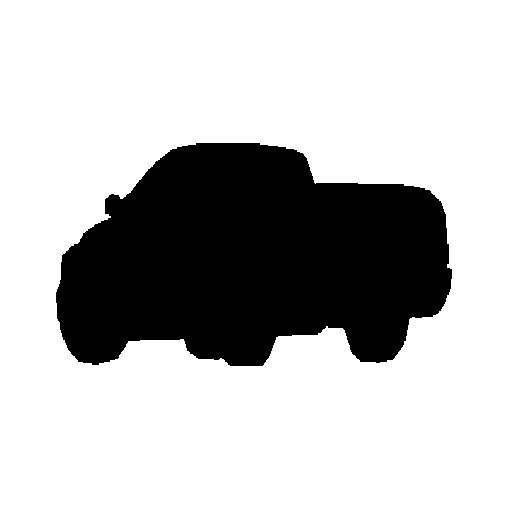

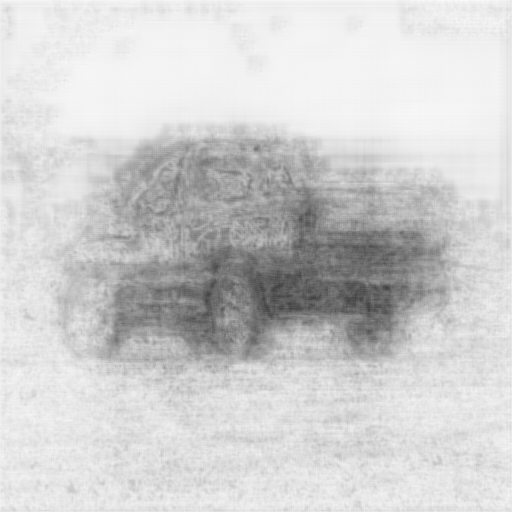

257 12701
258 12702
259 12703
260 12704
261 12705
262 12706
263 12707
264 12708
265 12709
266 12710
267 12711
268 12712
269 12713
270 12714
271 12715
272 12716
273 12717
274 12718
275 12719
276 12720
277 12721
278 12722
279 12723
280 12724
281 12725
282 12726
283 12727
284 12728
285 12729
286 12730
287 12731
288 12732
289 12733
290 12734
291 12735
292 12736
293 12737
294 12738
295 12739
296 12740
297 12741
298 12742
299 12743
300 12744
301 12745
302 12746
303 12747
304 12748
305 12749
306 12750
307 12751
308 12752
309 12753
310 12754
311 12755
312 12756
313 12757
314 12758
315 12759
316 12760
317 12761
318 12762
319 12763
320 12764
321 12765
322 12766
323 12767
324 12768
325 12769
326 12770
327 12771
328 12772
329 12773
330 12774
331 12775
332 12776
333 12777
334 12778
335 12779
336 12780
337 12781
338 12782
339 12783
340 12784
341 12785
342 12786
343 12787
344 12788
345 12789
346 12790
347 12791
348 12792
349 12793
350 12794
351 12795
352 12796
353 12797
354 12798
355 12799
356 12800


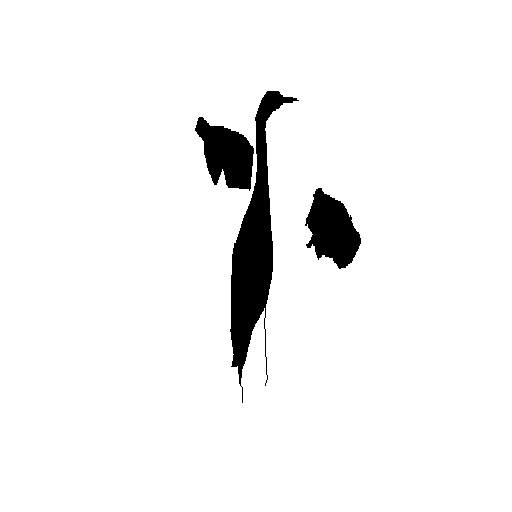

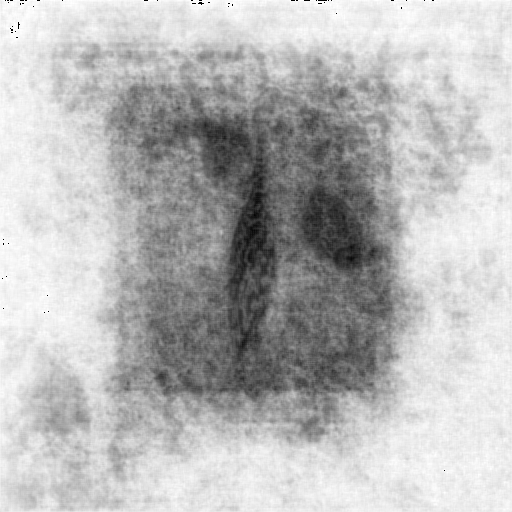

357 12801
358 12802
359 12803
360 12804
361 12805
362 12806
363 12807
364 12808
365 12809
366 12810
367 12811
368 12812
369 12813
370 12814
371 12815
372 12816
373 12817
374 12818
375 12819
376 12820
377 12821
378 12822
379 12823
380 12824
381 12825
382 12826
383 12827
384 12828
385 12829
386 12830
387 12831
388 12832
389 12833
390 12834
391 12835
392 12836
393 12837
394 12838
395 12839
396 12840
397 12841
398 12842
399 12843
400 12844
401 12845
402 12846
403 12847
404 12848
405 12849
406 12850
407 12851
408 12852
409 12853
410 12854
411 12855
412 12856
413 12857
414 12858
415 12859
416 12860
417 12861
418 12862
419 12863
420 12864
421 12865
422 12866
423 12867
424 12868
425 12869
426 12870
427 12871
428 12872
429 12873
430 12874
431 12875
432 12876
433 12877
434 12878
435 12879
436 12880
437 12881
438 12882
439 12883
440 12884
441 12885
442 12886
443 12887
444 12888
445 12889
446 12890
447 12891
448 12892
449 12893
450 12894
451 12895
452 12896
453 12897
454 12898
455 12899
456 12900


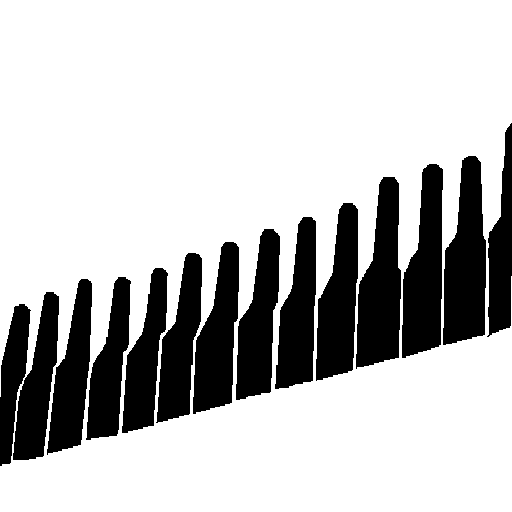

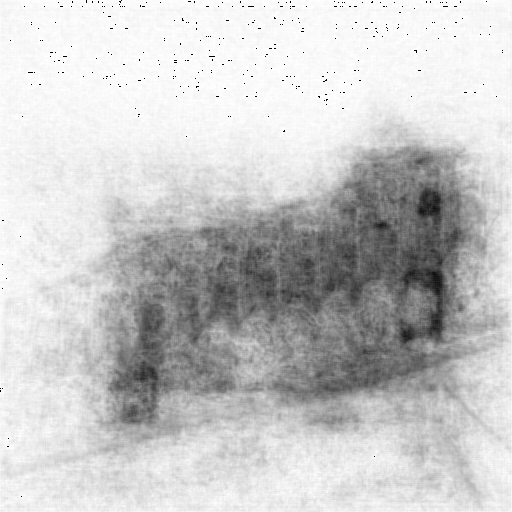

457 12901
458 12902
459 12903
460 12904
461 12905
462 12906
463 12907
464 12908
465 12909
466 12910
467 12911
468 12912
469 12913
470 12914
471 12915
472 12916
473 12917
474 12918
475 12919
476 12920
477 12921
478 12922
479 12923
480 12924
481 12925
482 12926
483 12927
484 12928
485 12929
486 12930
487 12931
488 12932
489 12933
490 12934
491 12935
492 12936
493 12937
494 12938
495 12939
496 12940
497 12941
498 12942
499 12943
500 12944
501 12945
502 12946
503 12947
504 12948
505 12949
506 12950
507 12951
508 12952
509 12953
510 12954
511 12955
512 12956
513 12957
514 12958
515 12959
516 12960
517 12961
518 12962
519 12963
520 12964
521 12965
522 12966
523 12967
524 12968
525 12969
526 12970
527 12971
528 12972
529 12973
530 12974
531 12975
532 12976
533 12977
534 12978
535 12979
536 12980
537 12981
538 12982
539 12983
540 12984
541 12985
542 12986
543 12987
544 12988
545 12989
546 12990
547 12991
548 12992
549 12993
550 12994
551 12995
552 12996
553 12997
554 12998
555 12999
556 13000


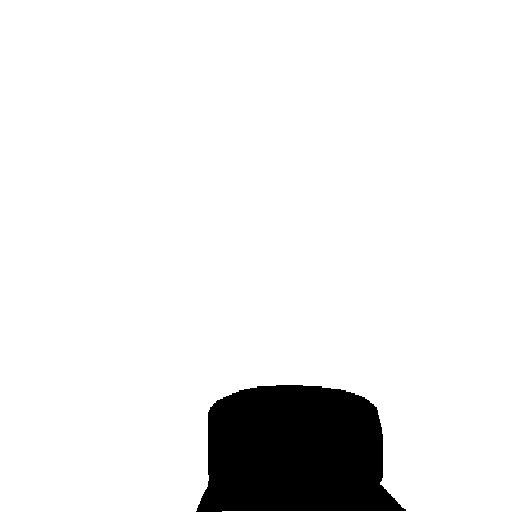

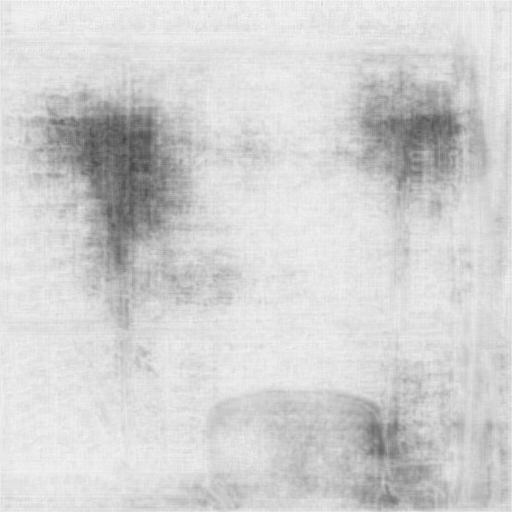

557 13001
558 13002
559 13003
560 13004
561 13005
562 13006
563 13007
564 13008
565 13009
566 13010
567 13011
568 13012
569 13013
570 13014
571 13015
572 13016
573 13017
574 13018
575 13019
576 13020
577 13021
578 13022
579 13023
580 13024
581 13025
582 13026
583 13027
584 13028
585 13029
586 13030
587 13031
588 13032
589 13033
590 13034
591 13035
592 13036
593 13037
594 13038
595 13039
596 13040
597 13041
598 13042
599 13043
600 13044
601 13045
602 13046
603 13047
604 13048
605 13049
606 13050
607 13051
608 13052
609 13053
610 13054
611 13055
612 13056
613 13057
614 13058
615 13059
616 13060
617 13061
618 13062
619 13063
620 13064
621 13065
622 13066
623 13067
624 13068
625 13069
626 13070
627 13071
628 13072
629 13073
630 13074
631 13075
632 13076
633 13077
634 13078
635 13079
636 13080
637 13081
638 13082
639 13083
640 13084
641 13085
642 13086
643 13087
644 13088
645 13089
646 13090
647 13091
648 13092
649 13093
650 13094
651 13095
652 13096
653 13097
654 13098
655 13099
656 13100


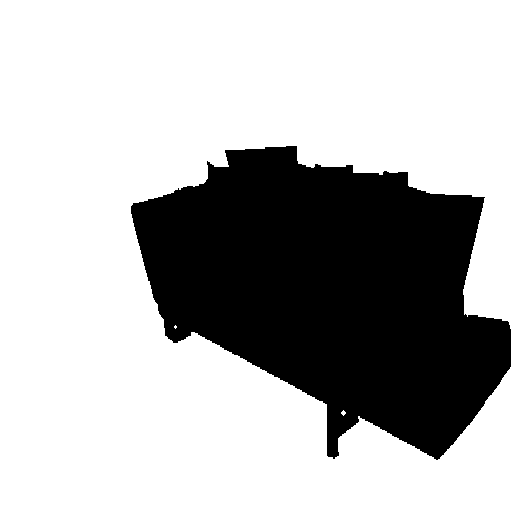

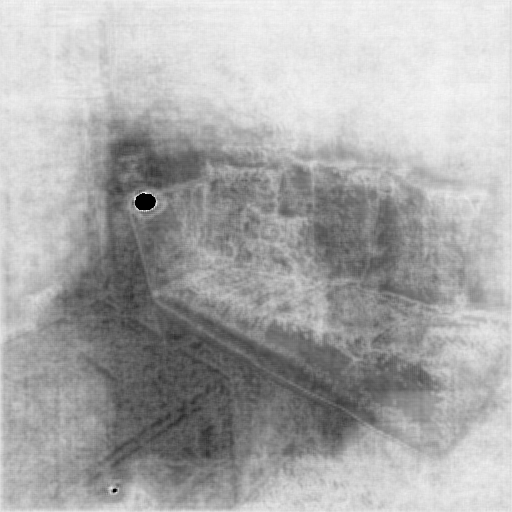

657 13101
658 13102
659 13103
660 13104
661 13105
662 13106
663 13107
664 13108
665 13109
666 13110
667 13111
668 13112
669 13113
670 13114
671 13115
672 13116
673 13117
674 13118
675 13119
676 13120
677 13121
678 13122
679 13123
680 13124
681 13125
682 13126
683 13127
684 13128
685 13129
686 13130
687 13131
688 13132
689 13133
690 13134
691 13135
692 13136
693 13137
694 13138
695 13139
696 13140
697 13141
698 13142
699 13143
700 13144
701 13145
702 13146
703 13147
704 13148
705 13149
706 13150
707 13151
708 13152
709 13153
710 13154
711 13155
712 13156
713 13157
714 13158
715 13159
716 13160
717 13161
718 13162
719 13163
720 13164
721 13165
722 13166
723 13167
724 13168
725 13169
726 13170
727 13171
728 13172
729 13173
730 13174
731 13175
0 13176
1 13177
2 13178
3 13179
4 13180
5 13181
6 13182
7 13183
8 13184
9 13185
10 13186
11 13187
12 13188
13 13189
14 13190
15 13191
16 13192
17 13193
18 13194
19 13195
20 13196
21 13197
22 13198
23 13199
24 13200
2007_001709


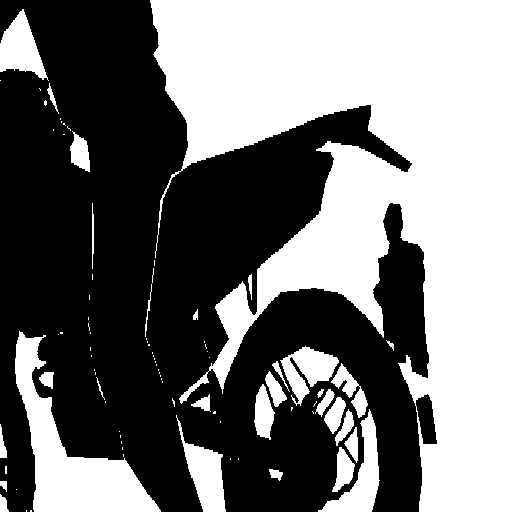

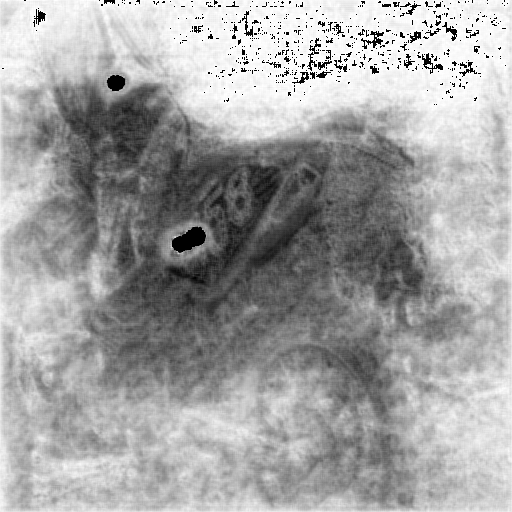

25 13201
26 13202
27 13203
28 13204
29 13205
30 13206
31 13207
32 13208
33 13209
34 13210
35 13211
36 13212
37 13213
38 13214
39 13215
40 13216
41 13217
42 13218
43 13219
44 13220
45 13221
46 13222
47 13223
48 13224
49 13225
50 13226
51 13227
52 13228
53 13229
54 13230
55 13231
56 13232
57 13233
58 13234
59 13235
60 13236
61 13237
62 13238
63 13239
64 13240
65 13241
66 13242
67 13243
68 13244
69 13245
70 13246
71 13247
72 13248
73 13249
74 13250
75 13251
76 13252
77 13253
78 13254
79 13255
80 13256
81 13257
82 13258
83 13259
84 13260
85 13261
86 13262
87 13263
88 13264
89 13265
90 13266
91 13267
92 13268
93 13269
94 13270
95 13271
96 13272
97 13273
98 13274
99 13275
100 13276
101 13277
102 13278
103 13279
104 13280
105 13281
106 13282
107 13283
108 13284
109 13285
110 13286
111 13287
112 13288
113 13289
114 13290
115 13291
116 13292
117 13293
118 13294
119 13295
120 13296
121 13297
122 13298
123 13299
124 13300
2007_008072


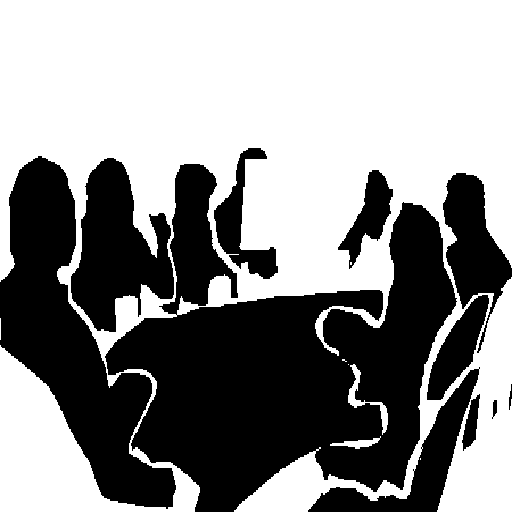

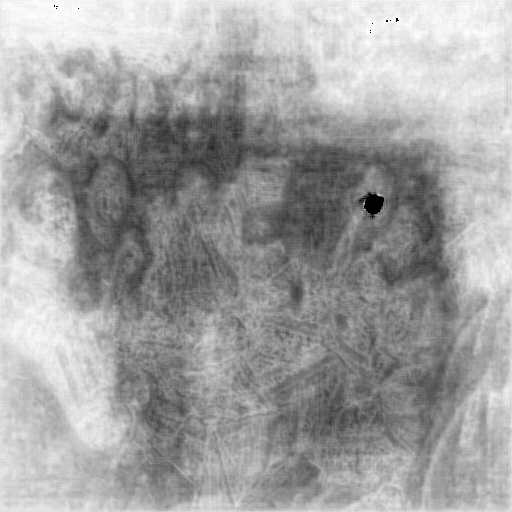

125 13301
126 13302
127 13303
128 13304
129 13305
130 13306
131 13307
132 13308
133 13309
134 13310
135 13311
136 13312
137 13313
138 13314
139 13315
140 13316
141 13317
142 13318
143 13319
144 13320
145 13321
146 13322
147 13323
148 13324
149 13325
150 13326
151 13327
152 13328
153 13329
154 13330
155 13331
156 13332
157 13333
158 13334
159 13335
160 13336
161 13337
162 13338
163 13339
164 13340
165 13341
166 13342
167 13343
168 13344
169 13345
170 13346
171 13347
172 13348
173 13349
174 13350
175 13351
176 13352
177 13353
178 13354
179 13355
180 13356
181 13357
182 13358
183 13359
184 13360
185 13361
186 13362
187 13363
188 13364
189 13365
190 13366
191 13367
192 13368
193 13369
194 13370
195 13371
196 13372
197 13373
198 13374
199 13375
200 13376
201 13377
202 13378
203 13379
204 13380
205 13381
206 13382
207 13383
208 13384
209 13385
210 13386
211 13387
212 13388
213 13389
214 13390
215 13391
216 13392
217 13393
218 13394
219 13395
220 13396
221 13397
222 13398
223 13399
224 13400


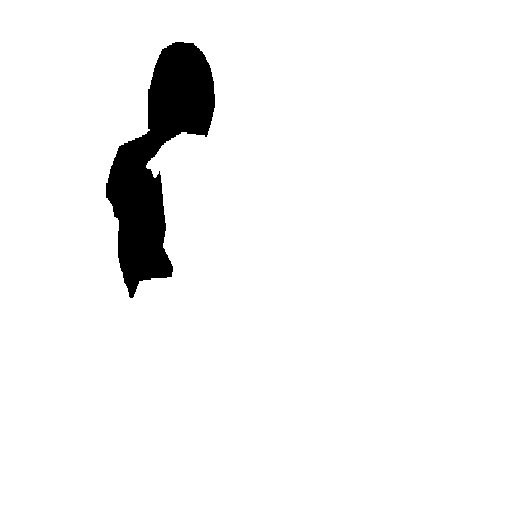

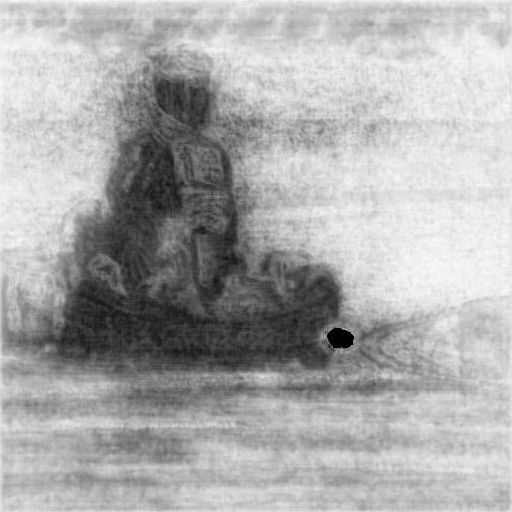

225 13401
226 13402
227 13403
228 13404
229 13405
230 13406
231 13407
232 13408
233 13409
234 13410
235 13411
236 13412
237 13413
238 13414
239 13415
240 13416
241 13417
242 13418
243 13419
244 13420
245 13421
246 13422
247 13423
248 13424
249 13425
250 13426
251 13427
252 13428
253 13429
254 13430
255 13431
256 13432
257 13433
258 13434
259 13435
260 13436
261 13437
262 13438
263 13439
264 13440
265 13441
266 13442
267 13443
268 13444
269 13445
270 13446
271 13447
272 13448
273 13449
274 13450
275 13451
276 13452
277 13453
278 13454
279 13455
280 13456
281 13457
282 13458
283 13459
284 13460
285 13461
286 13462
287 13463
288 13464
289 13465
290 13466
291 13467
292 13468
293 13469
294 13470
295 13471
296 13472
297 13473
298 13474
299 13475
300 13476
301 13477
302 13478
303 13479
304 13480
305 13481
306 13482
307 13483
308 13484
309 13485
310 13486
311 13487
312 13488
313 13489
314 13490
315 13491
316 13492
317 13493
318 13494
319 13495
320 13496
321 13497
322 13498
323 13499
324 13500


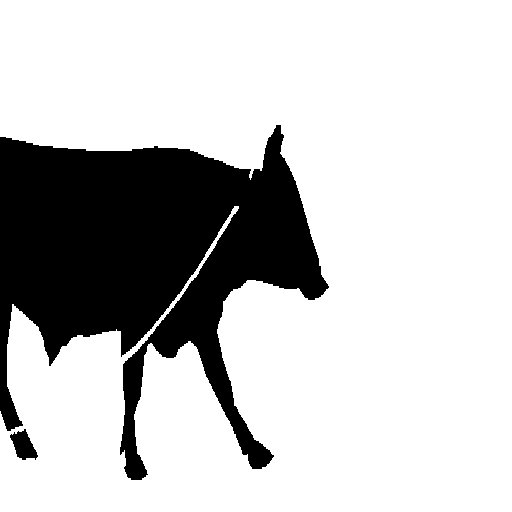

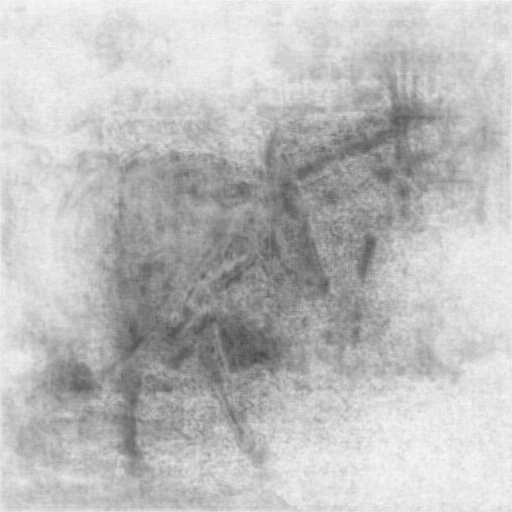

325 13501
326 13502
327 13503
328 13504
329 13505
330 13506
331 13507
332 13508
333 13509
334 13510
335 13511
336 13512
337 13513
338 13514
339 13515
340 13516
341 13517
342 13518
343 13519
344 13520
345 13521
346 13522
347 13523
348 13524
349 13525
350 13526
351 13527
352 13528
353 13529
354 13530
355 13531
356 13532
357 13533
358 13534
359 13535
360 13536
361 13537
362 13538
363 13539
364 13540
365 13541
366 13542
367 13543
368 13544
369 13545
370 13546
371 13547
372 13548
373 13549
374 13550
375 13551
376 13552
377 13553
378 13554
379 13555
380 13556
381 13557
382 13558
383 13559
384 13560
385 13561
386 13562
387 13563
388 13564
389 13565
390 13566
391 13567
392 13568
393 13569
394 13570
395 13571
396 13572
397 13573
398 13574
399 13575
400 13576
401 13577
402 13578
403 13579
404 13580
405 13581
406 13582
407 13583
408 13584
409 13585
410 13586
411 13587
412 13588
413 13589
414 13590
415 13591
416 13592
417 13593
418 13594
419 13595
420 13596
421 13597
422 13598
423 13599
424 13600


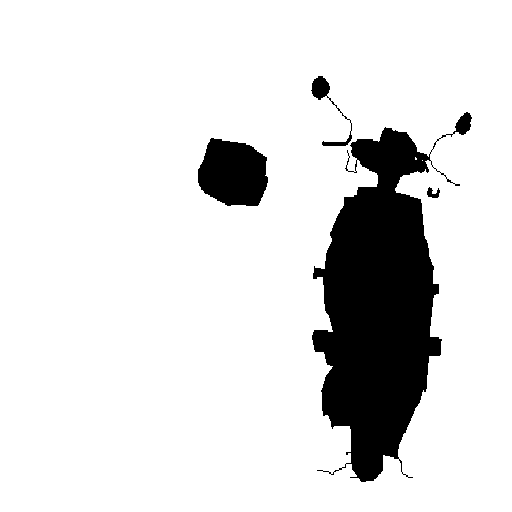

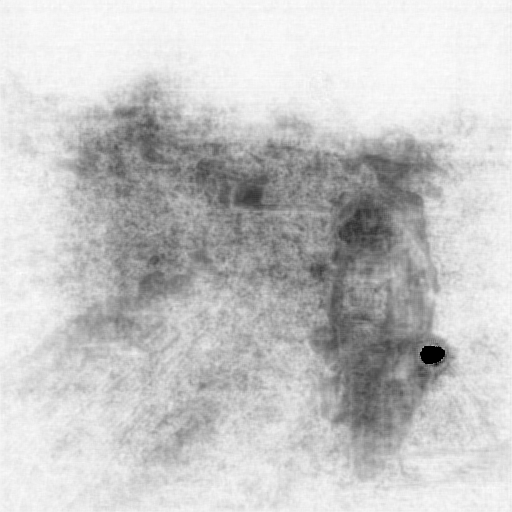

425 13601
426 13602
427 13603
428 13604
429 13605
430 13606
431 13607
432 13608
433 13609
434 13610
435 13611
436 13612
437 13613
438 13614
439 13615
440 13616
441 13617
442 13618
443 13619
444 13620
445 13621
446 13622
447 13623
448 13624
449 13625
450 13626
451 13627
452 13628
453 13629
454 13630
455 13631
456 13632
457 13633
458 13634
459 13635
460 13636
461 13637
462 13638
463 13639
464 13640
465 13641
466 13642
467 13643
468 13644
469 13645
470 13646
471 13647
472 13648
473 13649
474 13650
475 13651
476 13652
477 13653
478 13654
479 13655
480 13656
481 13657
482 13658
483 13659
484 13660
485 13661
486 13662
487 13663
488 13664
489 13665
490 13666
491 13667
492 13668
493 13669
494 13670
495 13671
496 13672
497 13673
498 13674
499 13675
500 13676
501 13677
502 13678
503 13679
504 13680
505 13681
506 13682
507 13683
508 13684
509 13685
510 13686
511 13687
512 13688
513 13689
514 13690
515 13691
516 13692
517 13693
518 13694
519 13695
520 13696
521 13697
522 13698
523 13699
524 13700


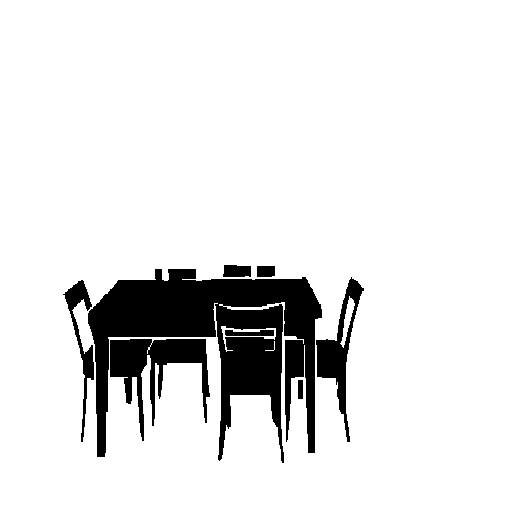

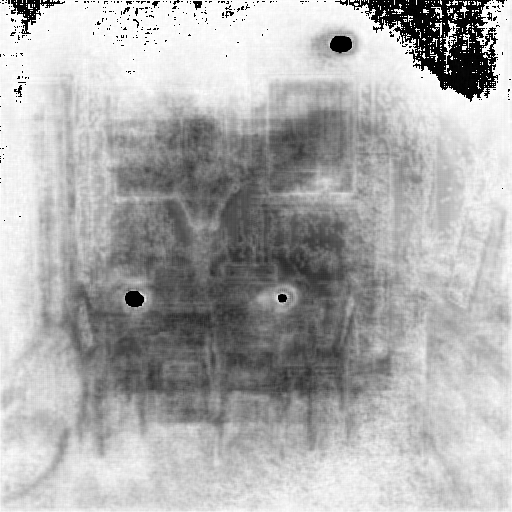

525 13701
526 13702
527 13703
528 13704
529 13705
530 13706
531 13707
532 13708
533 13709
534 13710
535 13711
536 13712
537 13713
538 13714
539 13715
540 13716
541 13717
542 13718
543 13719
544 13720
545 13721
546 13722
547 13723
548 13724
549 13725
550 13726
551 13727
552 13728
553 13729
554 13730
555 13731
556 13732
557 13733
558 13734
559 13735
560 13736
561 13737
562 13738
563 13739
564 13740
565 13741
566 13742
567 13743
568 13744
569 13745
570 13746
571 13747
572 13748
573 13749
574 13750
575 13751
576 13752
577 13753
578 13754
579 13755
580 13756
581 13757
582 13758
583 13759
584 13760
585 13761
586 13762
587 13763
588 13764
589 13765
590 13766
591 13767
592 13768
593 13769
594 13770
595 13771
596 13772
597 13773
598 13774
599 13775
600 13776
601 13777
602 13778
603 13779
604 13780
605 13781
606 13782
607 13783
608 13784
609 13785
610 13786
611 13787
612 13788
613 13789
614 13790
615 13791
616 13792
617 13793
618 13794
619 13795
620 13796
621 13797
622 13798
623 13799
624 13800


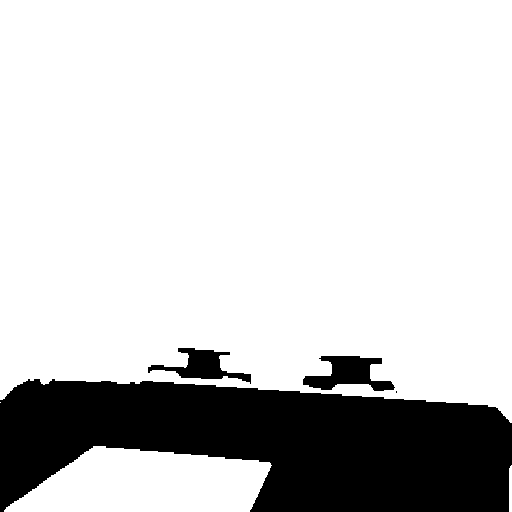

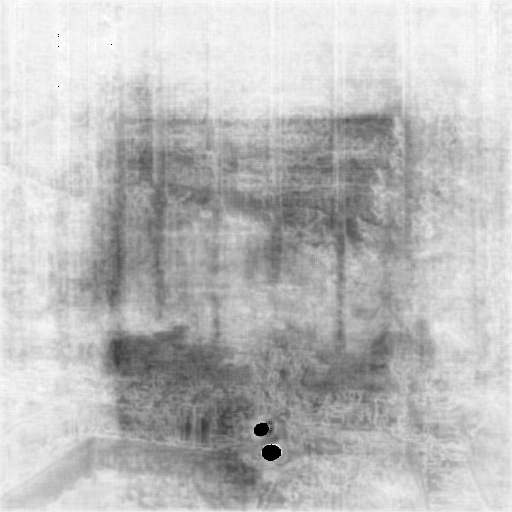

625 13801
626 13802
627 13803
628 13804
629 13805
630 13806
631 13807
632 13808
633 13809
634 13810
635 13811
636 13812
637 13813
638 13814
639 13815
640 13816
641 13817
642 13818
643 13819
644 13820
645 13821
646 13822
647 13823
648 13824
649 13825
650 13826
651 13827
652 13828
653 13829
654 13830
655 13831
656 13832
657 13833
658 13834
659 13835
660 13836
661 13837
662 13838
663 13839
664 13840
665 13841
666 13842
667 13843
668 13844
669 13845
670 13846
671 13847
672 13848
673 13849
674 13850
675 13851
676 13852
677 13853
678 13854
679 13855
680 13856
681 13857
682 13858
683 13859
684 13860
685 13861
686 13862
687 13863
688 13864
689 13865
690 13866
691 13867
692 13868
693 13869
694 13870
695 13871
696 13872
697 13873
698 13874
699 13875
700 13876
701 13877
702 13878
703 13879
704 13880
705 13881
706 13882
707 13883
708 13884
709 13885
710 13886
711 13887
712 13888
713 13889
714 13890
715 13891
716 13892
717 13893
718 13894
719 13895
720 13896
721 13897
722 13898
723 13899
724 13900


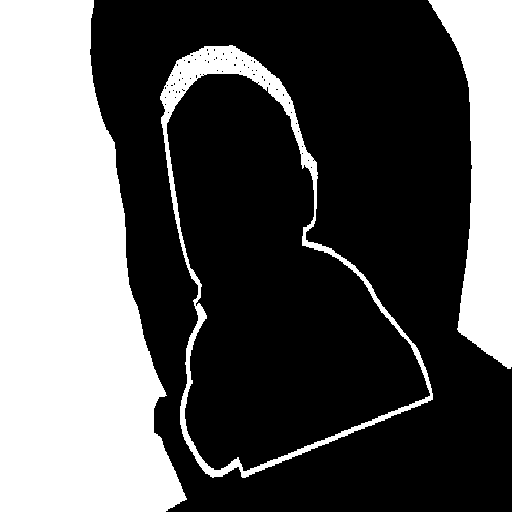

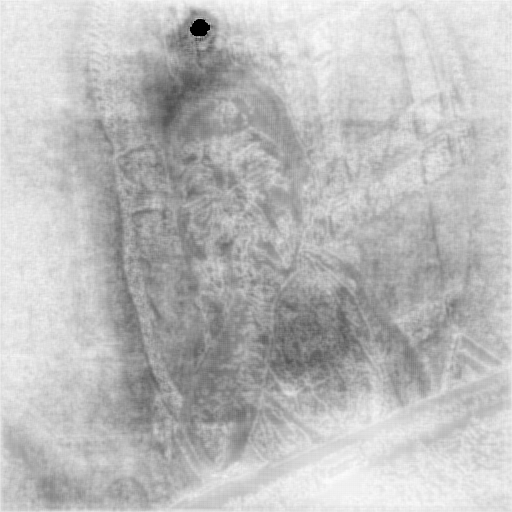

725 13901
726 13902
727 13903
728 13904
729 13905
730 13906
731 13907
0 13908
1 13909
2 13910
3 13911
4 13912
5 13913
6 13914
7 13915
8 13916
9 13917
10 13918
11 13919
12 13920
13 13921
14 13922
15 13923
16 13924
17 13925
18 13926
19 13927
20 13928
21 13929
22 13930
23 13931
24 13932
25 13933
26 13934
27 13935
28 13936
29 13937
30 13938
31 13939
32 13940
33 13941
34 13942
35 13943
36 13944
37 13945
38 13946
39 13947
40 13948
41 13949
42 13950
43 13951
44 13952
45 13953
46 13954
47 13955
48 13956
49 13957
50 13958
51 13959
52 13960
53 13961
54 13962
55 13963
56 13964
57 13965
58 13966
59 13967
60 13968
61 13969
62 13970
63 13971
64 13972
65 13973
66 13974
67 13975
68 13976
69 13977
70 13978
71 13979
72 13980
73 13981
74 13982
75 13983
76 13984
77 13985
78 13986
79 13987
80 13988
81 13989
82 13990
83 13991
84 13992
85 13993
86 13994
87 13995
88 13996
89 13997
90 13998
91 13999
92 14000
2007_006212


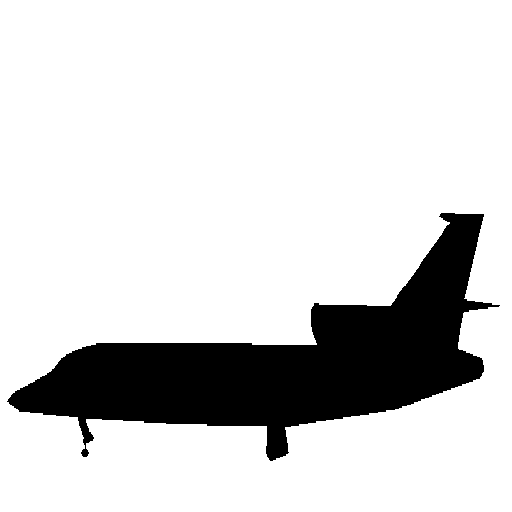

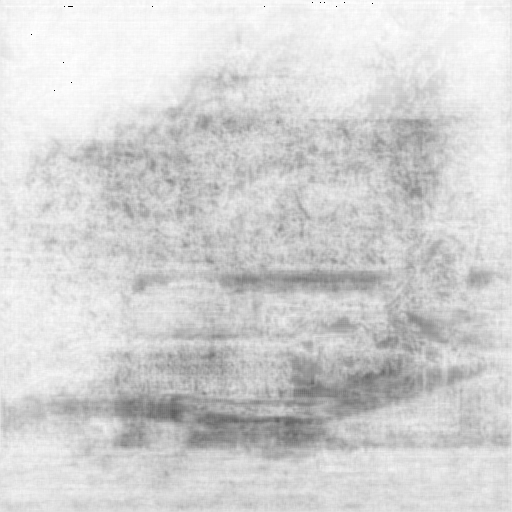

93 14001
94 14002
95 14003
96 14004
97 14005
98 14006
99 14007
100 14008
101 14009
102 14010
103 14011
104 14012
105 14013
106 14014
107 14015
108 14016
109 14017
110 14018
111 14019
112 14020
113 14021
114 14022
115 14023
116 14024
117 14025
118 14026
119 14027
120 14028
121 14029
122 14030
123 14031
124 14032
125 14033
126 14034
127 14035
128 14036
129 14037
130 14038
131 14039
132 14040
133 14041
134 14042
135 14043
136 14044
137 14045
138 14046
139 14047
140 14048
141 14049
142 14050
143 14051
144 14052
145 14053
146 14054
147 14055
148 14056
149 14057
150 14058
151 14059
152 14060
153 14061
154 14062
155 14063
156 14064
157 14065
158 14066
159 14067
160 14068
161 14069
162 14070
163 14071
164 14072
165 14073
166 14074
167 14075
168 14076
169 14077
170 14078
171 14079
172 14080
173 14081
174 14082
175 14083
176 14084
177 14085
178 14086
179 14087
180 14088
181 14089
182 14090
183 14091
184 14092
185 14093
186 14094
187 14095
188 14096
189 14097
190 14098
191 14099
192 14100
2008_00

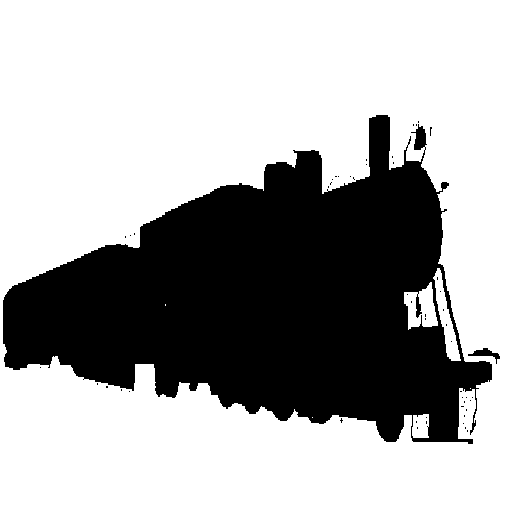

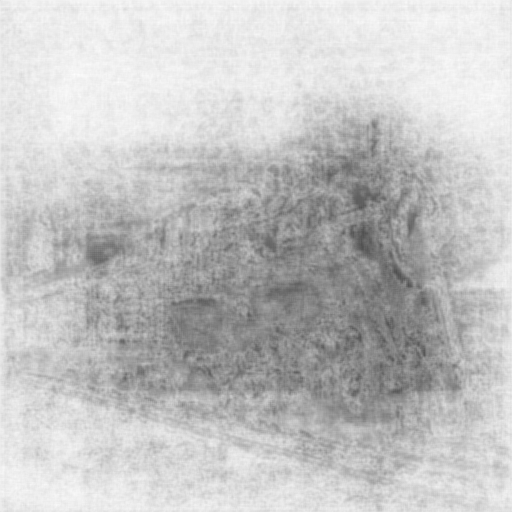

193 14101
194 14102
195 14103
196 14104
197 14105
198 14106
199 14107
200 14108
201 14109
202 14110
203 14111
204 14112
205 14113
206 14114
207 14115
208 14116
209 14117
210 14118
211 14119
212 14120
213 14121
214 14122
215 14123
216 14124
217 14125
218 14126
219 14127
220 14128
221 14129
222 14130
223 14131
224 14132
225 14133
226 14134
227 14135
228 14136
229 14137
230 14138
231 14139
232 14140
233 14141
234 14142
235 14143
236 14144
237 14145
238 14146
239 14147
240 14148
241 14149
242 14150
243 14151
244 14152
245 14153
246 14154
247 14155
248 14156
249 14157
250 14158
251 14159
252 14160
253 14161
254 14162
255 14163
256 14164
257 14165
258 14166
259 14167
260 14168
261 14169
262 14170
263 14171
264 14172
265 14173
266 14174
267 14175
268 14176
269 14177
270 14178
271 14179
272 14180
273 14181
274 14182
275 14183
276 14184
277 14185
278 14186
279 14187
280 14188
281 14189
282 14190
283 14191
284 14192
285 14193
286 14194
287 14195
288 14196
289 14197
290 14198
291 14199
292 14200


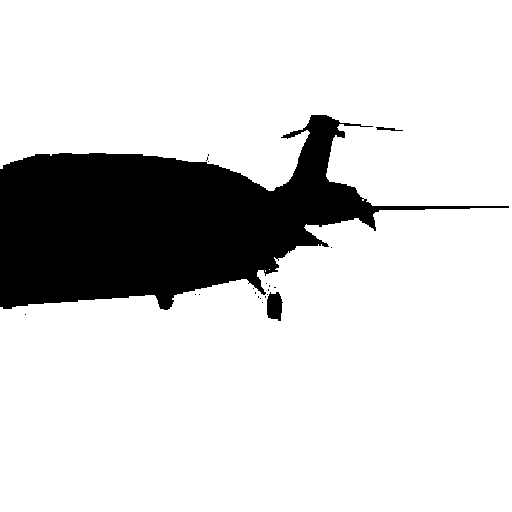

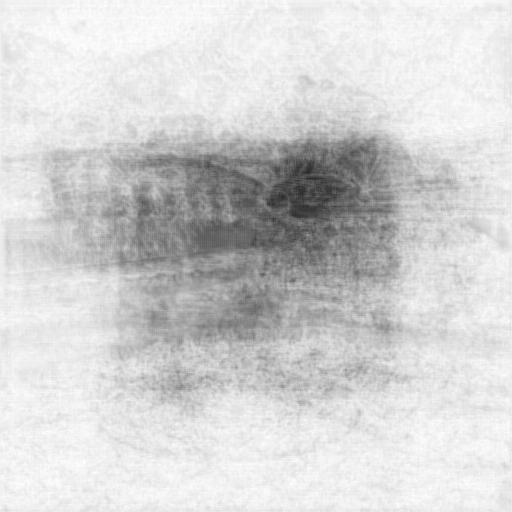

293 14201


In [ ]:

loss = None
count = 0

#error()
for _ in range(2000):
    
    
    for i, (inputs, targets) in enumerate(trainloader):
        #if loss != None and i % 50 == 0:
        print(i, count)
        inputs = inputs.to(device)
        targets = targets.to(device)
        

        opt.zero_grad()
        outputs = model(inputs)
        loss = criterion(outputs, targets)
        loss.backward()
        opt.step()  
        
        if count % 100 == 0:
            torch.save(model, "unet2.model")
            print(dst.files[dst.split][i * bs])
            display(transforms.ToPILImage()(targets[0][0].cpu() ))
            display(transforms.ToPILImage()(outputs[0][0].cpu() ))
            #display(transforms.ToPILImage()(outputs[0][1].cpu() ))
            #display(transforms.ToPILImage()(outputs[0][6].cpu() ))
            #display(transforms.ToPILImage()(outputs[0][15].cpu() ))
        count+=1
            
        
         
#error()

### 1.7 Evaluate your model(1.5 points)
In this section you have to implement the evaluation metrics for your model. Calculate the values of F1-score, dice coefficient and AUC-ROC score on the data you used for training. You can use external packages like scikit-learn to compute above metrics.

In [ ]:
def evaluate(ground_truth, predictions):
    
    return f1_score, auc_score, dice_coeeficient

### 1.8 Plot the evaluation metrics against epochs(1.0)
In section 1.6 we saved the weights of the model after each epoch. In this section, you have to calculate the evaluation metrics after each epoch of training by loading the weights for each epoch. Once you have calculated the evaluation metrics for each epoch, plot them against the epochs.

In [14]:
import torch
torch.cuda.empty_cache() 

### 1.9 Visualize results(0.5 points)
For any 10 images in the dataset, show the images along the with their segmentation mask.

In [80]:
!shutdown /s

In [ ]:

class Segnet(nn.Module):
  
    def __init__(self):
        super(Segnet, self).__init__()
        self.conv1 = self.layer(3, 1, 3)
        self.conv2 = self.layer(1, 1, 3)
        self.conv3 = self.layer(1, 1, 3)
        #self.pool = nn.MaxPool2d(2, 2)
        #self.conv2 = nn.Conv2d(6, 16, 5)
        #self.fc1 = nn.Linear(16 * 5 * 5, 120)
        #self.fc2 = nn.Linear(120, 84)
        #self.fc3 = nn.Linear(84, 10)
        
        #self.lin = nn.Linear(200 * 200 * 3, 2)
        
    def layer(self, input, output, kernel):
        conv = nn.Conv2d(input, output, kernel, 1, kernel // 2 )
        relu = nn.Sequential(conv, nn.ReLU(inplace=True))
        
        return relu

    def forward(self, x):
        #x = self.pool(F.relu(self.conv1(x)))
        #x = self.pool(F.relu(self.conv2(x)))
        #x = x.view(-1, 16 * 5 * 5)
        #x = F.relu(self.fc1(x))
        #x = F.relu(self.fc2(x))
        #x = self.fc3(x)
        #x = x.view(-1, self.num_flat_features(x))
        
        x = self.conv1(x)
        x = self.conv2(x)
        x = self.conv3(x)
        
        return x
        #return self.lin(x)
    
    
    def num_flat_features(self, x):
        size = x.size()[0:]  # all dimensions except the batch dimension
        num_features = 1
        for s in size:
            num_features *= s
            
        
        
        return num_features

    

In [ ]:
import torch.nn as nn
import torch
    
class default_layer(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(default_layer, self).__init__()
        self.seq = nn.Sequential(
            nn.Conv2d(in_channels, out_channels, 3,1,1),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True)
        )

    def forward(self, x):
        return self.seq(x)  
    
class up_layer(nn.Module):
    def __init__(self,in_channels,out_channels):
        super(up_layer,self).__init__()
        self.upsample = nn.Upsample(scale_factor=2)
        self.layer = default_layer(in_channels, out_channels)
        
    def forward(self,x):
        return self.layer(self.upsample(x))

class recurrent_layer(nn.Module):
    def __init__(self, channels):
        super(recurrent_layer, self).__init__()
        self.layer = default_layer(channels, channels)

    def forward(self, x):
        return self.layer(x + self.layer(x))  
    
class recurrent_block(nn.Module):
    def __init__(self,  in_channels, out_channels):
        super(recurrent_block, self).__init__()
        self.r2c = nn.Sequential(
            recurrent_layer(out_channels),
            recurrent_layer(out_channels)
        )
        self.conv1x1 = nn.Conv2d(in_channels,out_channels,1)
        
    def forward(self, x):
        return self.r2c(self.conv1x1(x))
    
class down_block(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(down_block, self).__init__()
        self.r2c = recurrent_block(in_channels,out_channels)
        self.maxpool = nn.MaxPool2d(2,2)

    def forward(self, x):
        x = self.r2c(x)
        return self.maxpool(x), x
    
class up_block(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(up_block, self).__init__()
        self.in_channels = in_channels
        self.up_layer = up_layer(in_channels, out_channels)
        self.r2c = recurrent_block(in_channels,out_channels)

    def forward(self, x, attachment):
        x = self.up_layer(x)
        
        x = torch.cat((attachment,x),dim=1)
        x = self.r2c( x)
        
        return x
    
class Segnet(nn.Module):
    def __init__(self):
        super(Segnet, self).__init__()
        
        self.down_rcl1 = down_block(3, 64)
        self.down_rcl2 = down_block(64, 128)
        self.down_rcl3 = down_block(128, 256)
        self.down_rcl4 = down_block(256, 512)
        
        self.down_rcl5 = recurrent_block(512, 1024)
        
        self.up_rcl1 = up_block(1024, 512)
        self.up_rcl2 = up_block(512, 256)
        self.up_rcl3 = up_block(256, 128)
        self.up_rcl4 = up_block(128, 64)
        self.conv1x1 = nn.Conv2d(64,21,1)

    def forward(self, x):
        x, a = self.down_rcl1(x)
        x, b = self.down_rcl2(x)
        x, c = self.down_rcl3(x)
        x, d = self.down_rcl4(x)
        x = self.down_rcl5(x)
        
        x = self.up_rcl1(x, d)
        x = self.up_rcl2(x, c)
        x = self.up_rcl3(x, b)
        x = self.up_rcl4(x, a)
        x = self.conv1x1(x)
        
        return x

In [ ]:
import torch.nn as nn

class Segnet(nn.Module):
    def __init__(self, stepSize, downs, ups):
        super(Segnet, self).__init__()
        self.stepSize = stepSize
        self.downs = nn.ModuleList([stepDown(*down) for down in downs])
        self.ups = nn.ModuleList([stepUp(*up) for up in ups])

    def forward(self, x):
        values = [None] * self.stepSize
        for i, down in enumerate(self.downs):
            x, *values[i] = down(x)
            
        
        for i, up in zip(range(self.stepSize - 1, -1, -1), self.ups):
            x = up(x, *values[i])

        return x
    

downs = [
    (3, 64, 2),
    (64, 128, 2),
    (128, 256, 3),
    (256, 512, 3),
    (512, 512, 3),
]

ups = [
    (512, 512, 3),
    (512, 256, 3),
    (256, 128, 3),
    (128, 64, 2),
    (64, 21, 2),
]

model = Segnet(5, downs, ups).cuda()

In [ ]:
display(modelOutput.shape)

display(transforms.ToPILImage()(modelOutput[0][i] ))

for i in range(21):
    print(i)
    display(transforms.ToPILImage()(modelOutput[0][i] ))

batch = dst[1]

input = batch[0]
target = batch[1]

for input, target in trainloader:
    modelInput = input
    modelOutput = model(input)
    #display(transforms.ToPILImage()(modelInput))
    for i in range(21):
        display(transforms.ToPILImage()(modelOutput[0][i])
    break


#display(transforms.ToPILImage()((target == 0).float()))

#dst = pascalVOCDataset(local_path, is_transform= True)
#modelOutput = model(input.unsqueeze(0).cuda()).squeeze()
#modelOutput = model(input).squeeze()

'''target = pascalVOCDataset.decode_segmap(target)
output = pascalVOCDataset.decode_segmap(modelOutput )

display(transforms.ToPILImage()(input))
display(transforms.ToPILImage()(target ))
display(transforms.ToPILImage()(output ))'''


display(target.shape)
display(input.shape)

def error():

    val = 0
    for inputs, targets in batches[:1]:
        inputs = inputs.cuda()
        targets = targets.cuda()

        outputs = model(inputs)
        val += criterion(outputs, targets)

        del inputs
        del targets
        torch.cuda.empty_cache() 
        
    print(val)